#Calsium Image Data: Cell Tracking and Groupings  
Initialize dependence libraries:

In [1]:
from processTools import dbscan, preprocessed_df, show_prediction, reduce_dimensions, relu, simplePrint, AdvancedPrint
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from Graphs import Graph, loss
import imageM
from PIL import Image, ImageColor
import random
import ChowLiu
import dataWrapping

Full data concentration

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3338: DtypeWarning: Columns (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


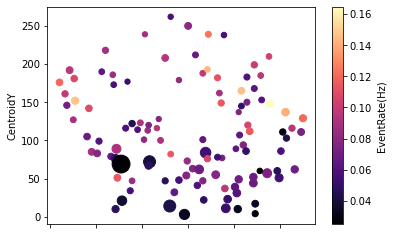

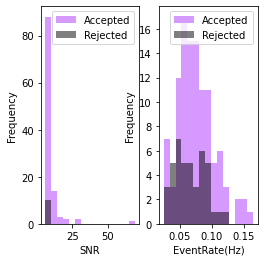

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3338: DtypeWarning: Columns (2,3,5,6,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,56,57,58,59,61,62,63,64,65,67,68,69,70,71,72,73,74,76,77,78,79,80,81,82,83,84,86,87,88,89,90,91,92,94,95,96,97,98,100,102,103,104,106,107,108,109,110,111,112,114,115,116,121,123,126,132,133,143,144,145) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


In [2]:
df, loc = preprocessed_df(["data/04042014_2/CellTracing.csv", "data/04042014_2/CellTracing-props.csv"], ['data/04042014_2/events.csv', 'data/04042014_2/events-props.csv'], loc = True)

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3338: DtypeWarning: Columns (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


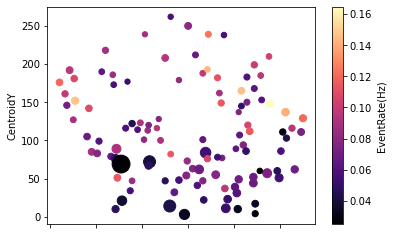

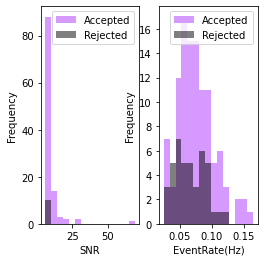

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3338: DtypeWarning: Columns (2,3,5,6,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,56,57,58,59,61,62,63,64,65,67,68,69,70,71,72,73,74,76,77,78,79,80,81,82,83,84,86,87,88,89,90,91,92,94,95,96,97,98,100,102,103,104,106,107,108,109,110,111,112,114,115,116,121,123,126,132,133,143,144,145) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


[0, 9930, 0.10616683963849538, 0.11972350326663125, 0.1208112028921353, 0.8059733160086942, 0.7174359508014859]


In [3]:
df, loc = preprocessed_df(["data/04042014_2/CellTracing.csv", "data/04042014_2/CellTracing-props.csv"], ['data/04042014_2/events.csv', 'data/04042014_2/events-props.csv'], loc = True)
myGraph = Graph(df, [0, 9930, 0.10616683963849538, 0.11972350326663125, 0.1208112028921353, 0.8059733160086942, 0.7174359508014859])
myGraph.create()
#graphs = myGraph.graph
#groups = myGraph.grouping(graphs)
#reducedGroups = myGraph.reduceGroups(groups)
#cells = myGraph.mmap()
#cellGroups = myGraph.toCells(reducedGroups, cells)
#info = myGraph.maxInfo()
#reducedGroupsInfo = myGraph.reduceGroups(info)
#chowLiu = myGraph.ChowLiu()

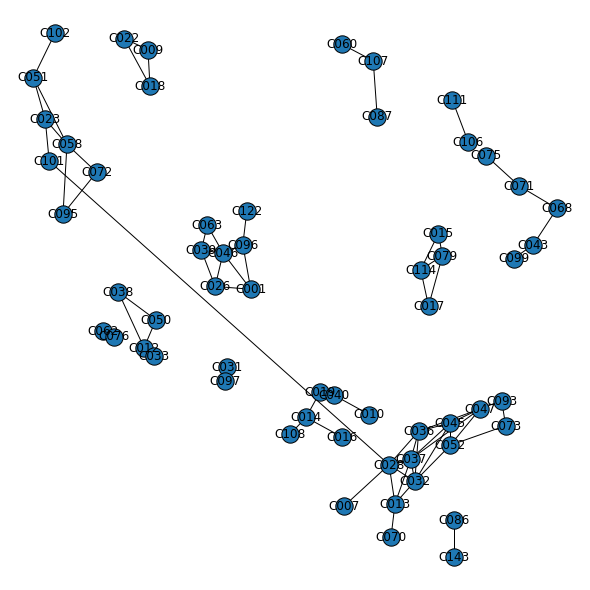

In [3]:
chowliu = ChowLiu.ChowLiu(df)
model, groups = chowliu.run("forest", loc, threshold = .4)

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3418: DtypeWarning: Columns (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


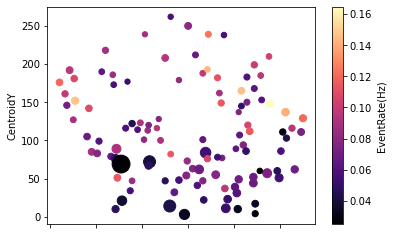

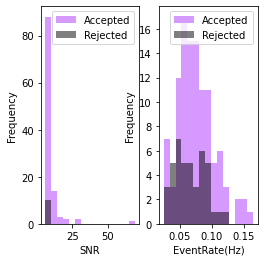

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3418: DtypeWarning: Columns (2,3,5,6,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,56,57,58,59,61,62,63,64,65,67,68,69,70,71,72,73,74,76,77,78,79,80,81,82,83,84,86,87,88,89,90,91,92,94,95,96,97,98,100,102,103,104,106,107,108,109,110,111,112,114,115,116,121,123,126,132,133,143,144,145) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)
C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3418: DtypeWarning: Columns (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,

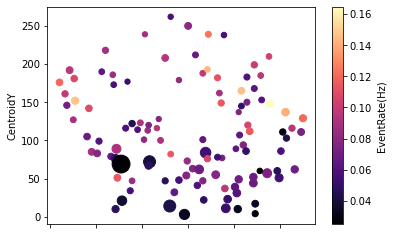

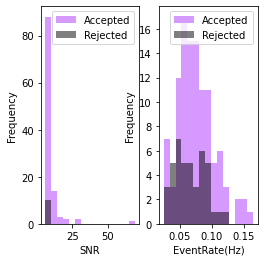

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3418: DtypeWarning: Columns (2,3,5,6,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,56,57,58,59,61,62,63,64,65,67,68,69,70,71,72,73,74,76,77,78,79,80,81,82,83,84,86,87,88,89,90,91,92,94,95,96,97,98,100,102,103,104,106,107,108,109,110,111,112,114,115,116,121,123,126,132,133,143,144,145) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [4]:
wrapped = dataWrapping.wrappedData(groups, [["data/04042014_2/CellTracing.csv", "data/04042014_2/CellTracing-props.csv"], ['data/04042014_2/events.csv', 'data/04042014_2/events-props.csv']])
#patterns = wrapped.findPatterns()


In [12]:
df

,C001,C002,C004,C005,C007,C008,C009,C010,C011,C012,...,C114,C115,C120,C122,C125,C131,C132,C142,C143,C144
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24167,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
24168,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
24169,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
24170,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [7]:
groups

[['C001', 'C026', 'C046', 'C096'],
 ['C013', 'C028', 'C032', 'C037', 'C070'],
 ['C014', 'C016', 'C019', 'C108'],
 ['C015', 'C079', 'C114'],
 ['C017', 'C079', 'C114'],
 ['C009', 'C018', 'C022'],
 ['C014', 'C019', 'C040'],
 ['C023', 'C051', 'C058', 'C101'],
 ['C001', 'C026', 'C039', 'C046'],
 ['C007', 'C013', 'C028', 'C032', 'C036', 'C037', 'C101'],
 ['C031', 'C097'],
 ['C013', 'C028', 'C032', 'C036', 'C037', 'C045', 'C052'],
 ['C028', 'C032', 'C036', 'C037', 'C045', 'C047'],
 ['C013', 'C028', 'C032', 'C036', 'C037', 'C045', 'C047'],
 ['C012', 'C038', 'C050'],
 ['C026', 'C039', 'C046', 'C063'],
 ['C043', 'C068', 'C099'],
 ['C007', 'C028'],
 ['C032', 'C036', 'C037', 'C045', 'C047', 'C052'],
 ['C001', 'C026', 'C039', 'C046', 'C063', 'C096'],
 ['C036', 'C037', 'C045', 'C047', 'C052', 'C093'],
 ['C023', 'C051', 'C058', 'C102'],
 ['C032', 'C045', 'C047', 'C052', 'C073'],
 ['C023', 'C051', 'C058', 'C072', 'C095'],
 ['C060', 'C107'],
 ['C062', 'C076'],
 ['C043', 'C068', 'C071'],
 ['C068', 'C071

In [3]:
groups =[['C001', 'C026', 'C046', 'C096'],
 ['C013', 'C028', 'C032', 'C037', 'C070'],
 ['C014', 'C016', 'C019', 'C108'],
 ['C015', 'C079', 'C114'],
 ['C017', 'C079', 'C114'],
 ['C009', 'C018', 'C022'],
 ['C014', 'C019', 'C040'],
 ['C023', 'C051', 'C058', 'C101'],
 ['C001', 'C026', 'C039', 'C046'],
 ['C007', 'C013', 'C028', 'C032', 'C036', 'C037', 'C101'],
 ['C031', 'C097'],
 ['C013', 'C028', 'C032', 'C036', 'C037', 'C045', 'C052'],
 ['C028', 'C032', 'C036', 'C037', 'C045', 'C047'],
 ['C013', 'C028', 'C032', 'C036', 'C037', 'C045', 'C047'],
 ['C012', 'C038', 'C050'],
 ['C026', 'C039', 'C046', 'C063'],
 ['C043', 'C068', 'C099'],
 ['C007', 'C028'],
 ['C032', 'C036', 'C037', 'C045', 'C047', 'C052'],
 ['C001', 'C026', 'C039', 'C046', 'C063', 'C096'],
 ['C036', 'C037', 'C045', 'C047', 'C052', 'C093'],
 ['C023', 'C051', 'C058', 'C102'],
 ['C032', 'C045', 'C047', 'C052', 'C073'],
 ['C023', 'C051', 'C058', 'C072', 'C095'],
 ['C060', 'C107'],
 ['C062', 'C076'],
 ['C043', 'C068', 'C071'],
 ['C068', 'C071', 'C075'],
 ['C058', 'C072', 'C095'],
 ['C052', 'C073', 'C093'],
 ['C010', 'C040'],
 ['C015', 'C017', 'C079', 'C114'],
 ['C086', 'C143'],
 ['C087', 'C107'],
 ['C001', 'C046', 'C096', 'C122'],
 ['C012', 'C033', 'C038', 'C050'],
 ['C106', 'C111']]

In [5]:
partialGroups = []
for group in groups:
    partialGroup = []
    for i, e1 in enumerate(group):
        g = [e1]
        for j, e2 in enumerate(group):
            if i >= j:
                continue
            g.append(e2)
        if len(g) > 1:
            partialGroup.append(g)
    partialGroups.append(partialGroup)
            

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


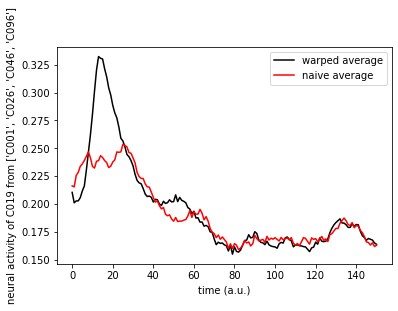

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.47it/s]


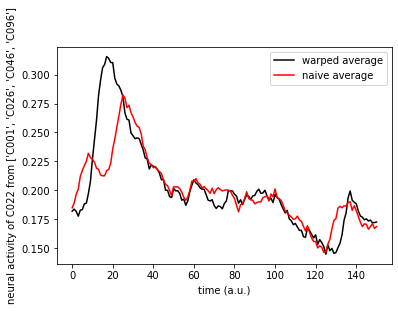

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 659.65it/s]


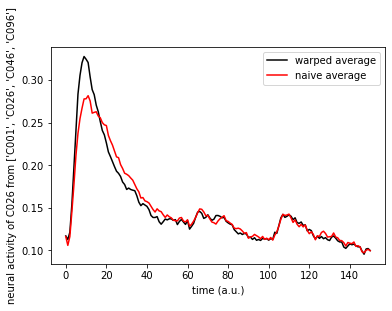

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.48it/s]


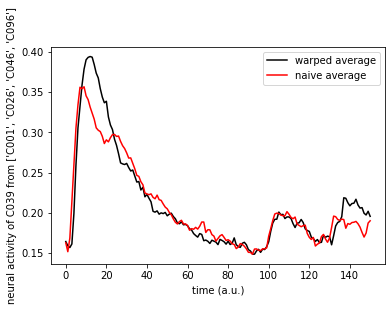

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 771.56it/s]


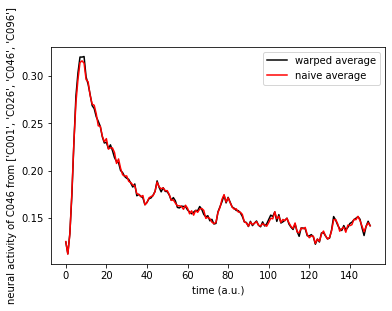

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


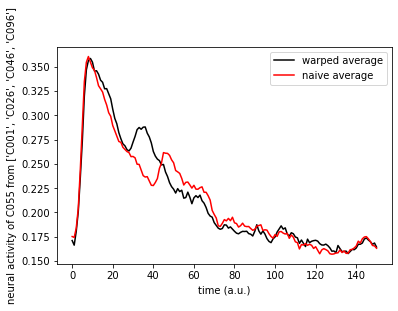

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.53it/s]


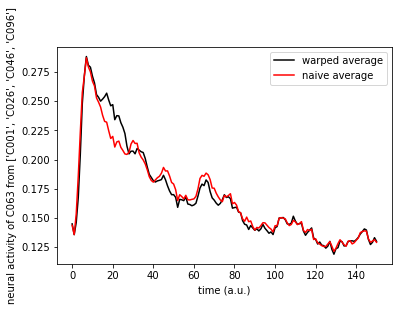

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.58it/s]


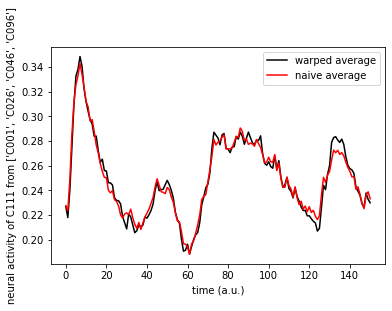

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.89it/s]


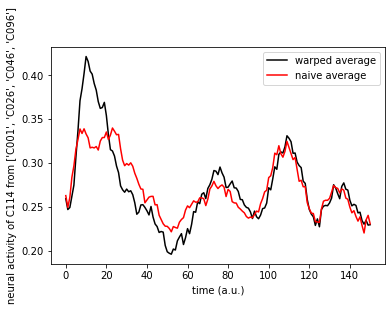

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


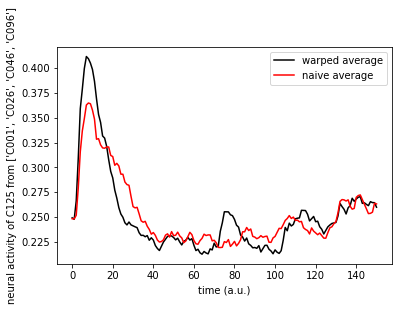

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 557.03it/s]


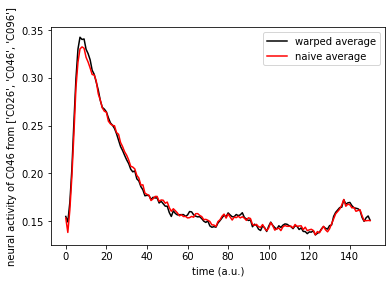

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 556.94it/s]


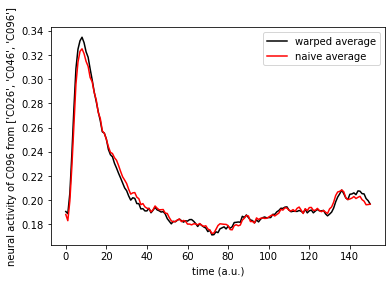

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.48it/s]


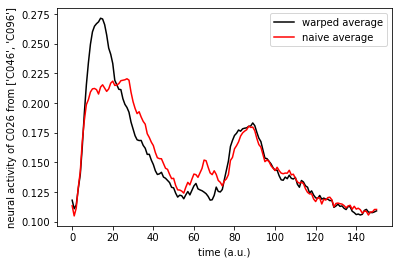

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.76it/s]


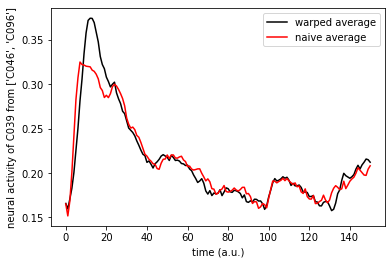

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 737.25it/s]


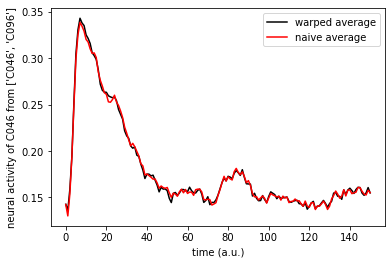

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 706.14it/s]


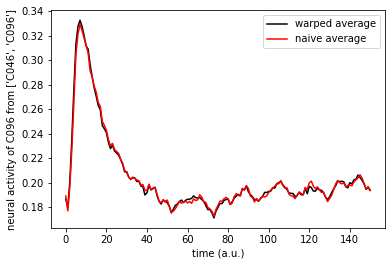

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.08it/s]


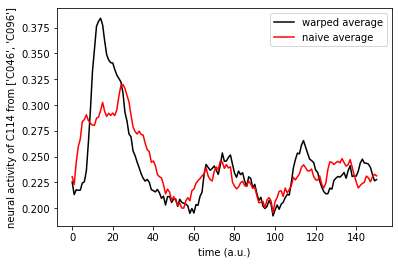

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 659.53it/s]


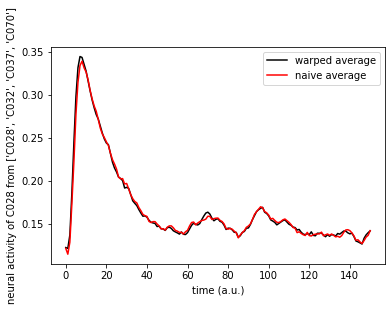

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.76it/s]


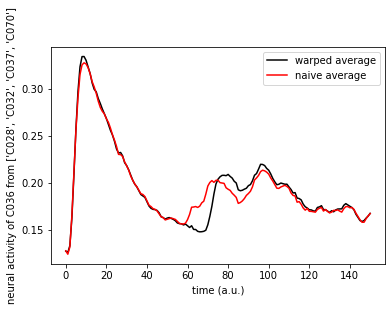

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.90it/s]


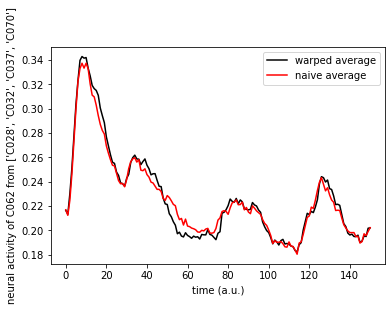

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 576.25it/s]


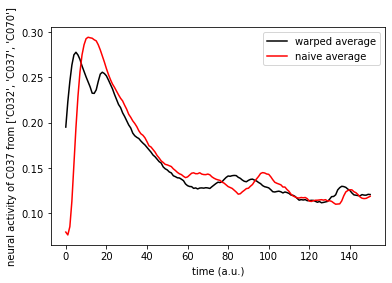

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 895.59it/s]


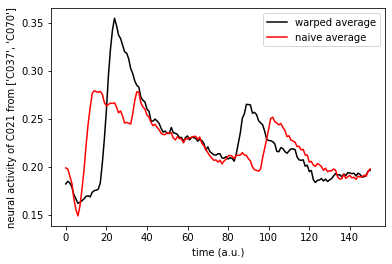

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 835.56it/s]


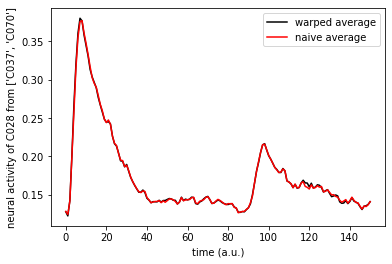

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 879.56it/s]


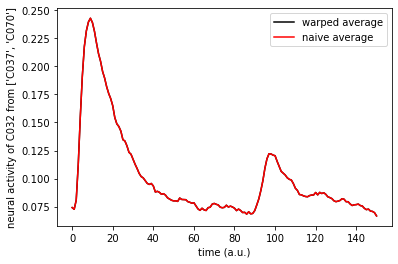

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 928.81it/s]


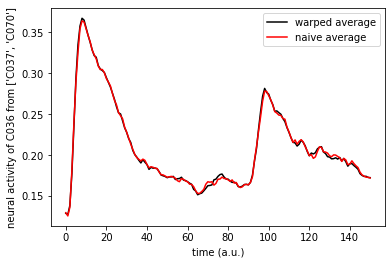

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 750.53it/s]


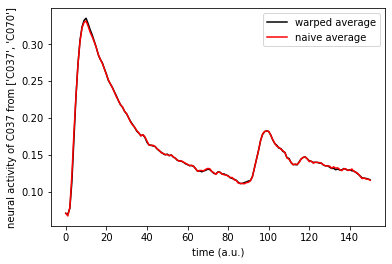

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.96it/s]


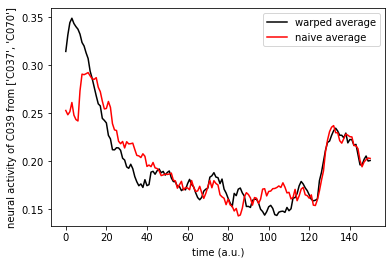

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 742.05it/s]


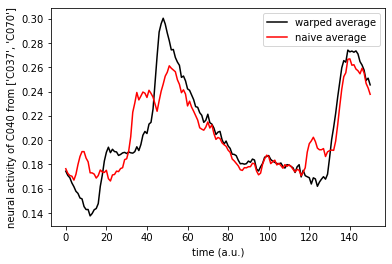

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.36it/s]


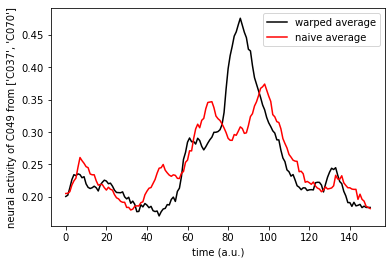

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.87it/s]


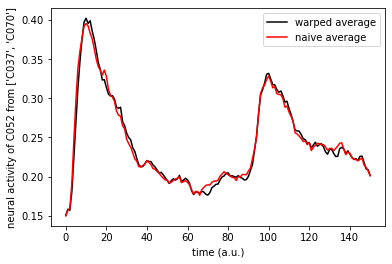

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.32it/s]


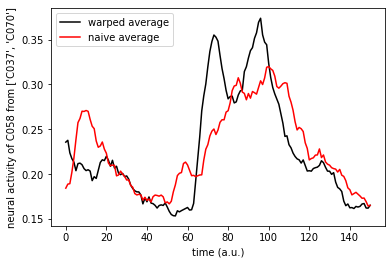

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.61it/s]


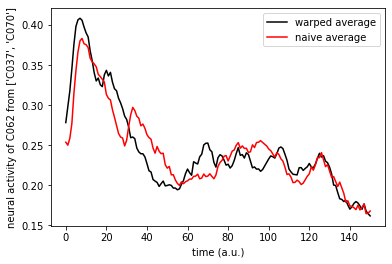

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 894.77it/s]


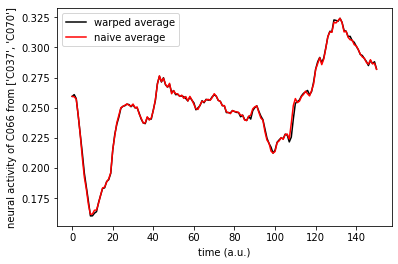

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.75it/s]


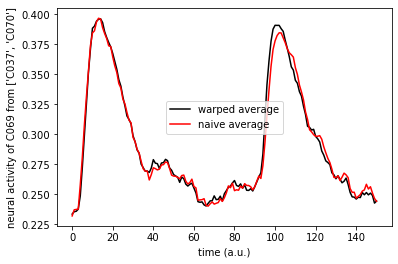

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 752.90it/s]


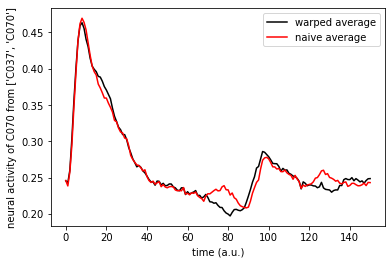

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.78it/s]


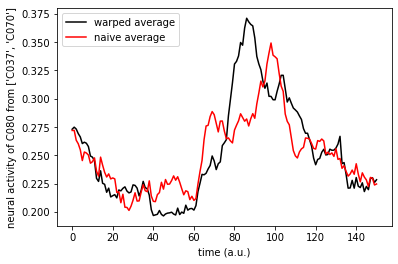

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 809.01it/s]


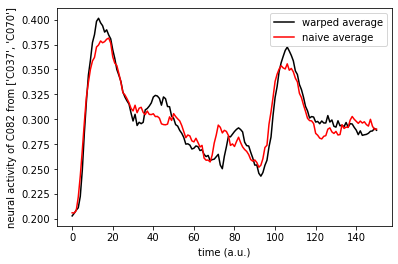

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.92it/s]


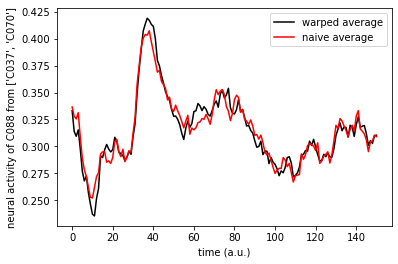

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.88it/s]


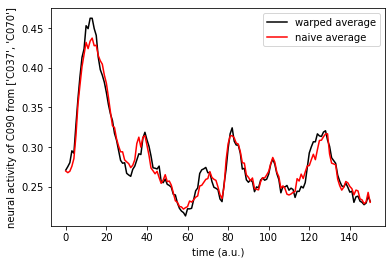

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.59it/s]


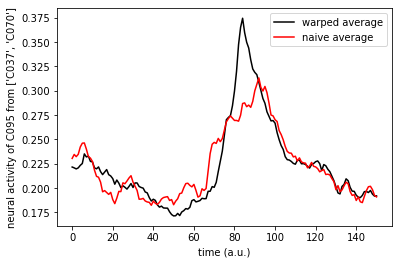

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 796.11it/s]


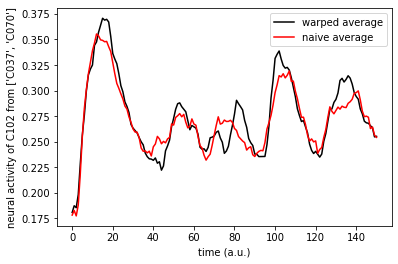

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.52it/s]


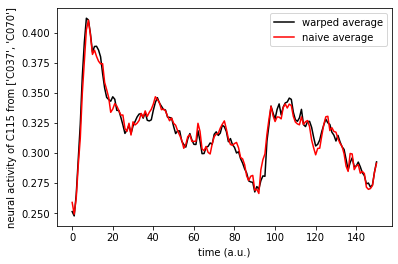

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 650.41it/s]


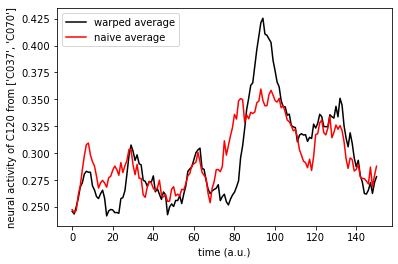

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.61it/s]


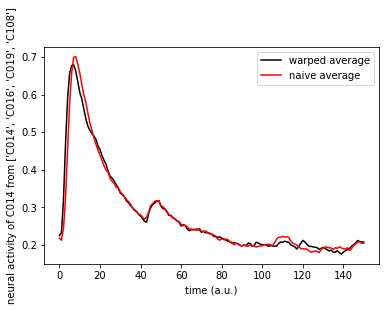

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.21it/s]


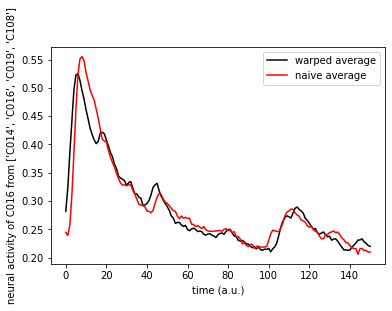

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.50it/s]


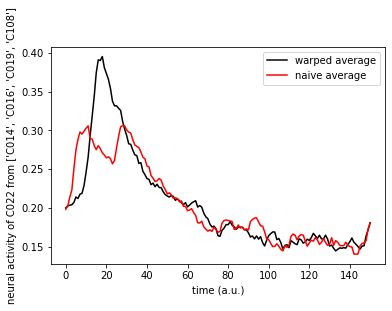

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.87it/s]


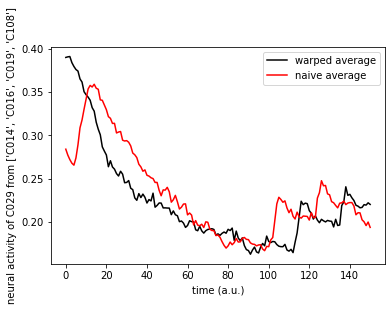

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 821.86it/s]


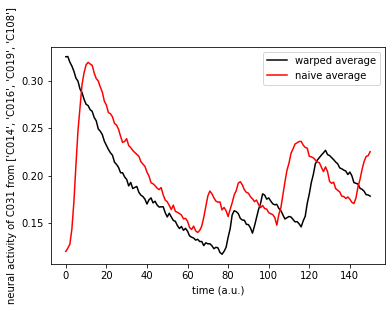

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


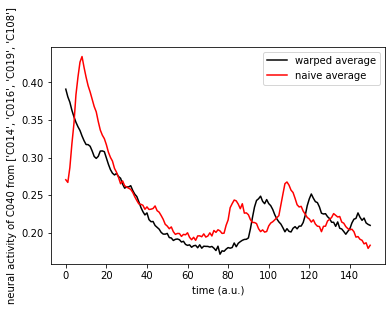

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 836.12it/s]


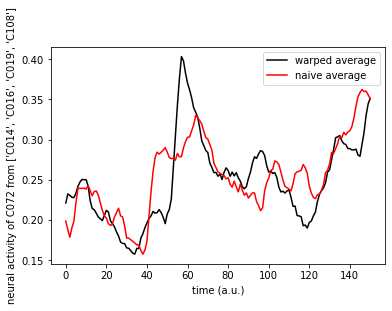

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.59it/s]


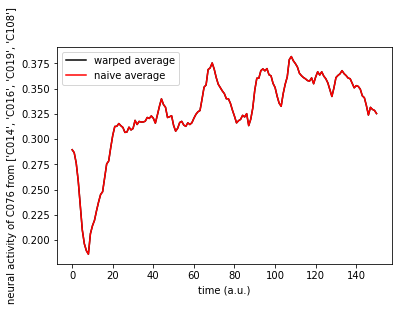

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 808.60it/s]


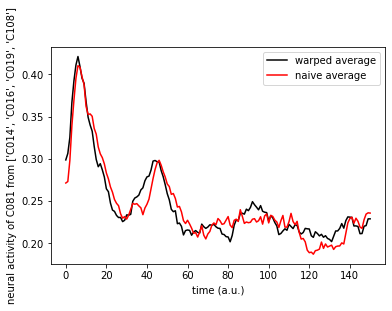

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.74it/s]


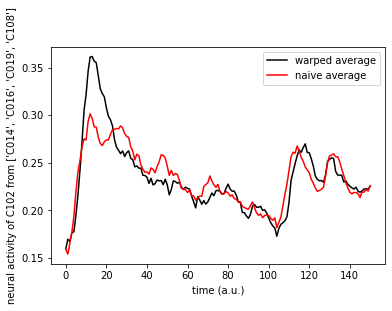

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.23it/s]


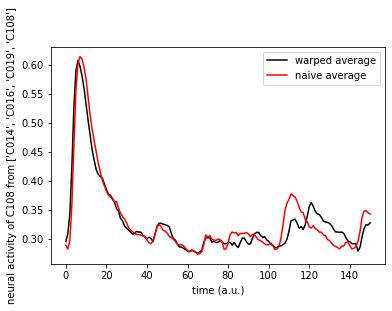

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 822.18it/s]


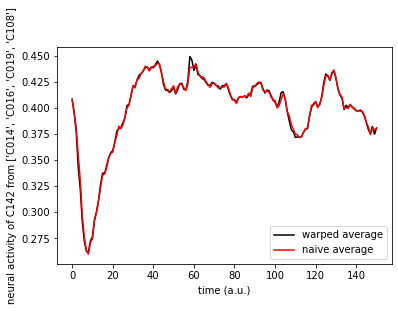

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.87it/s]


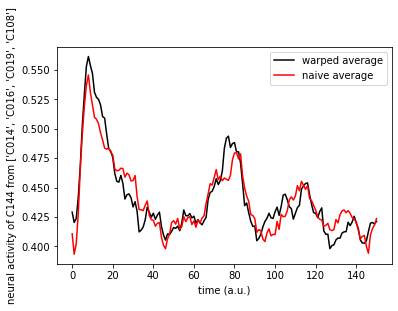

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 705.87it/s]


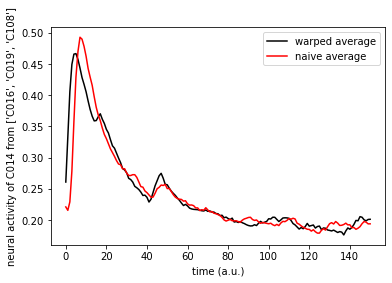

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.72it/s]


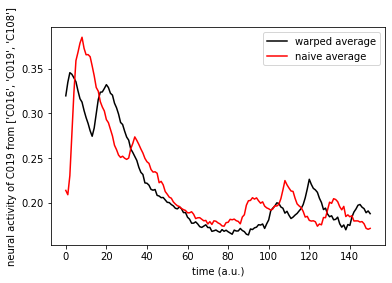

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


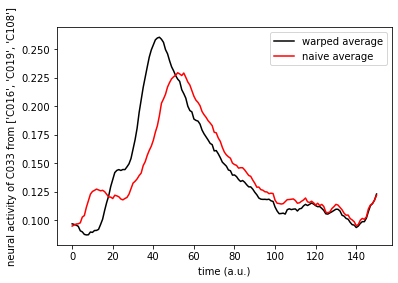

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 706.09it/s]


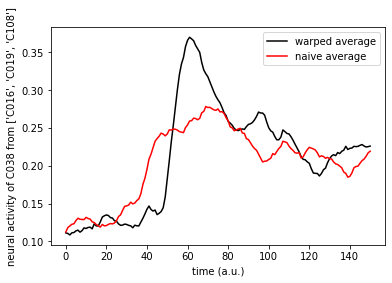

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


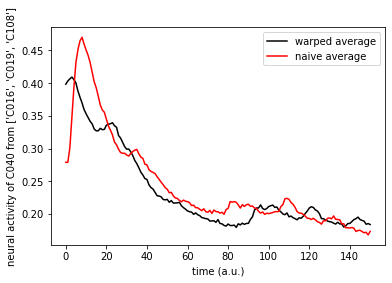

Loss: 0.04: 100%|██████████| 50/50 [00:00<00:00, 726.61it/s]


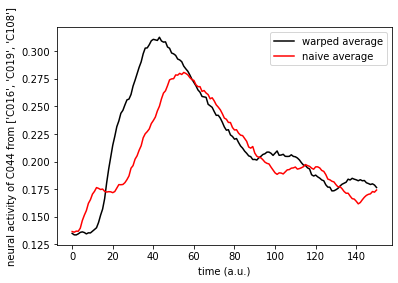

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.55it/s]


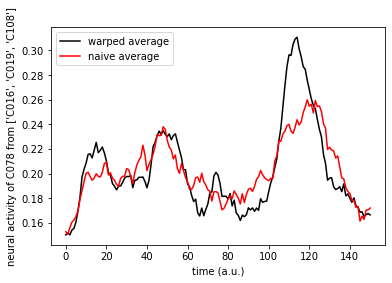

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 723.27it/s]


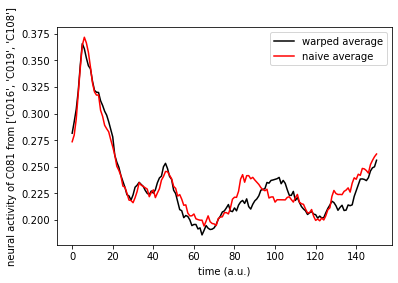

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.18it/s]


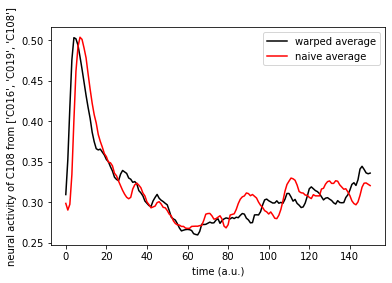

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


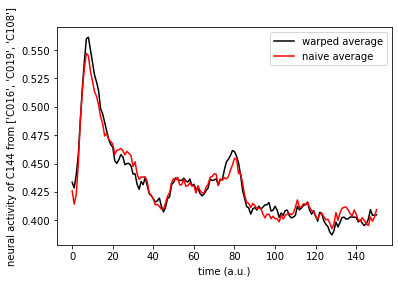

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 491.61it/s]


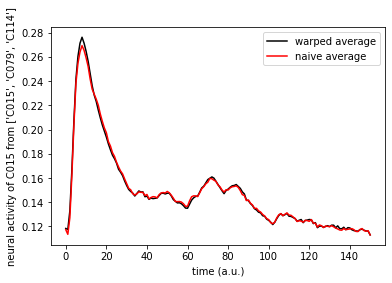

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 463.52it/s]


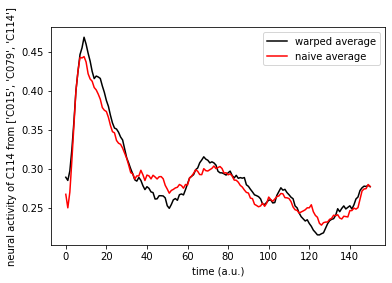

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.49it/s]


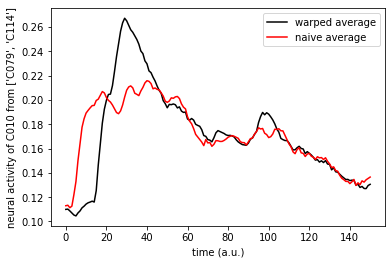

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


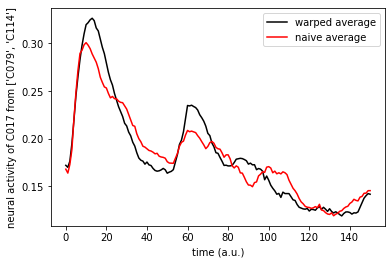

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.50it/s]


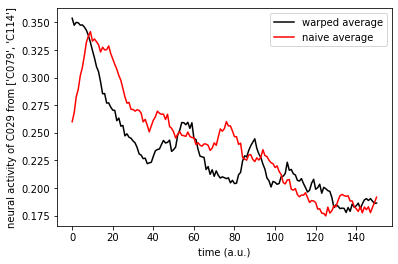

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 737.28it/s]


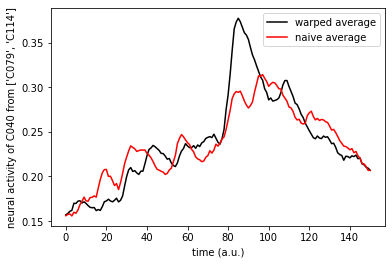

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


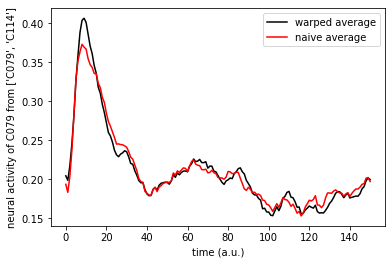

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


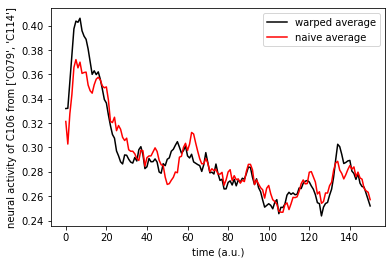

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 557.00it/s]


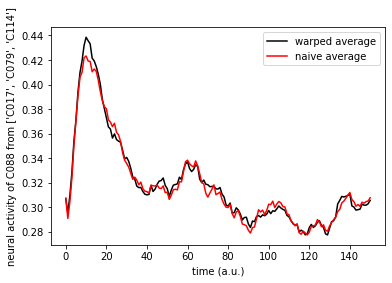

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 533.33it/s]


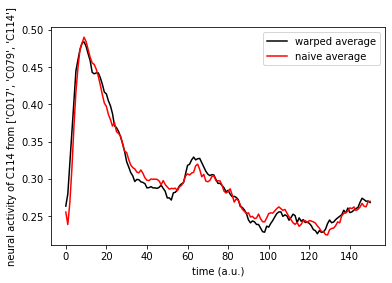

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.59it/s]


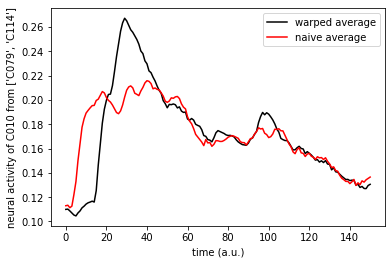

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.12it/s]


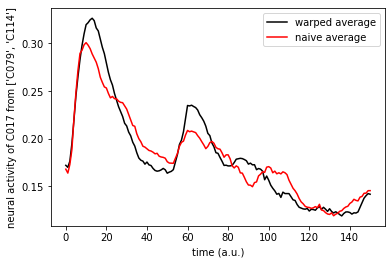

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


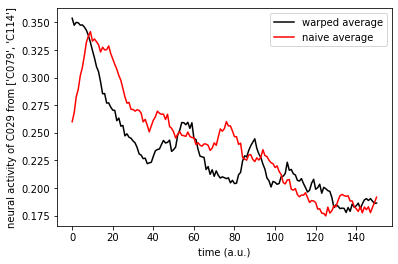

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 771.28it/s]


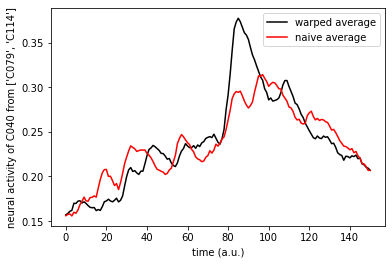

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


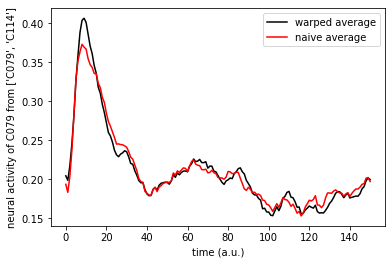

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 626.74it/s]


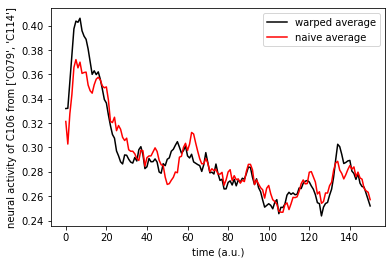

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 588.50it/s]


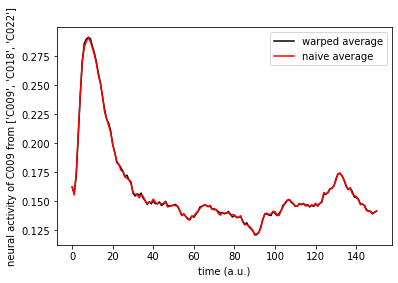

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 589.81it/s]


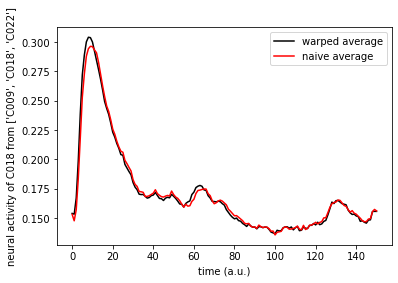

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 611.38it/s]


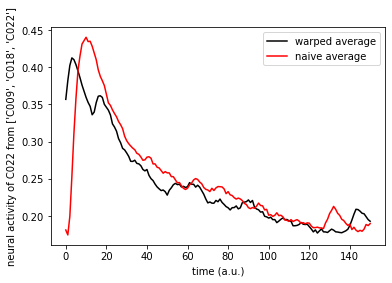

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 604.02it/s]


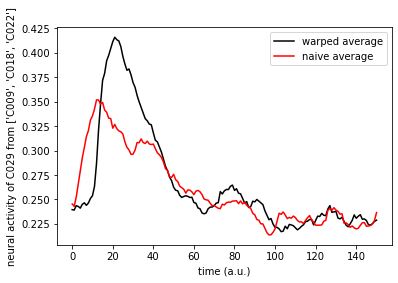

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 639.04it/s]


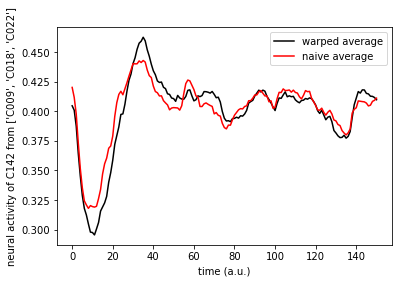

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.34it/s]


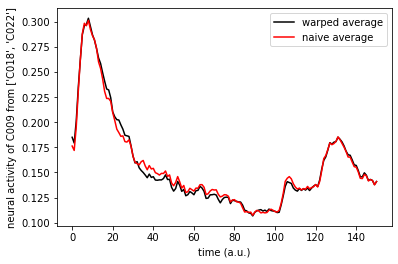

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 821.98it/s]


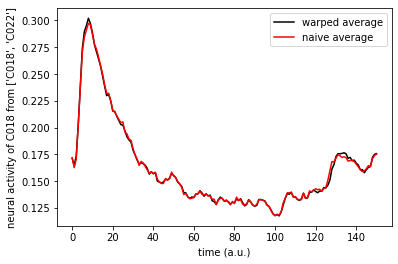

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


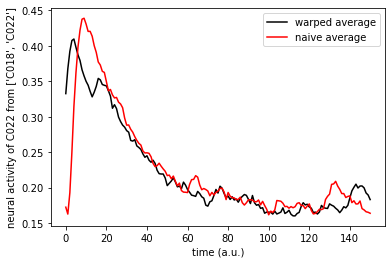

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 783.33it/s]


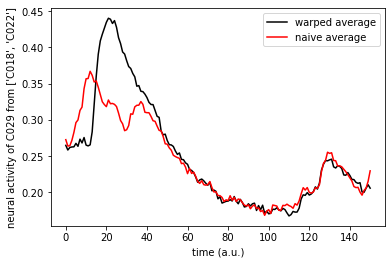

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.87it/s]


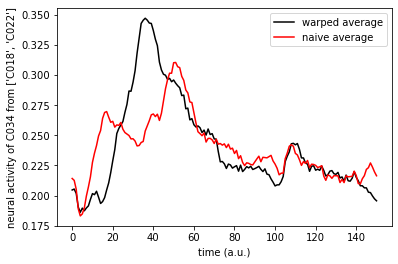

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 783.31it/s]


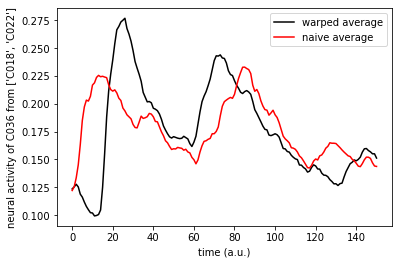

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.97it/s]


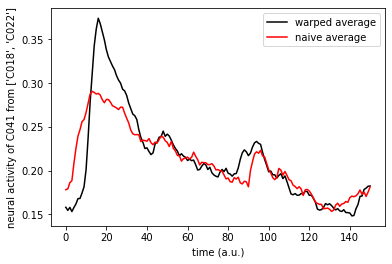

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.60it/s]


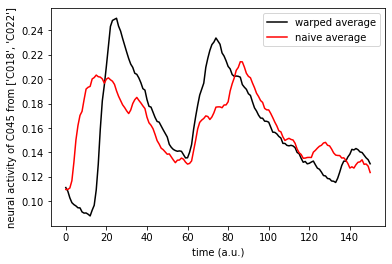

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 808.52it/s]


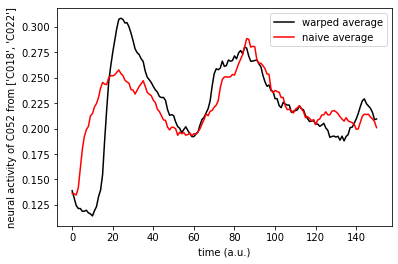

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.77it/s]


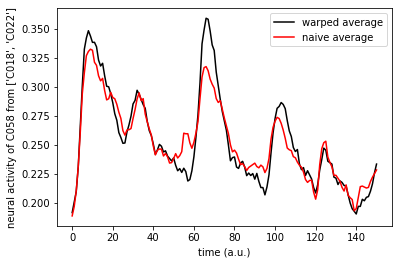

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.78it/s]


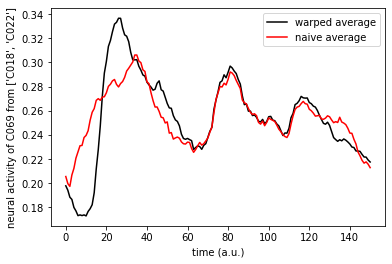

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.27it/s]


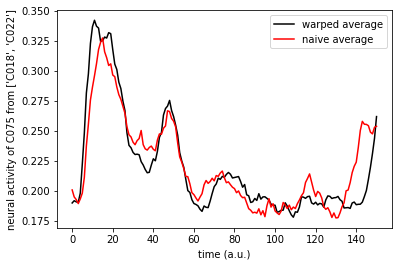

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.56it/s]


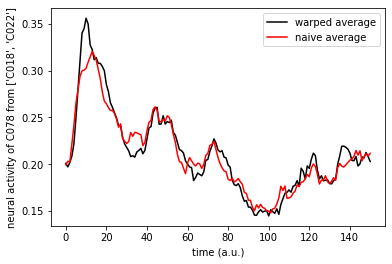

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.30it/s]


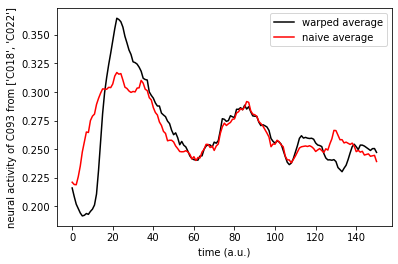

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.59it/s]


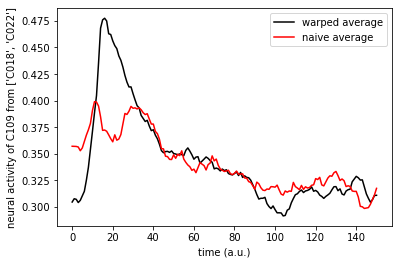

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 805.49it/s]


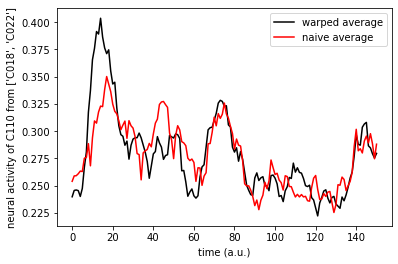

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.36it/s]


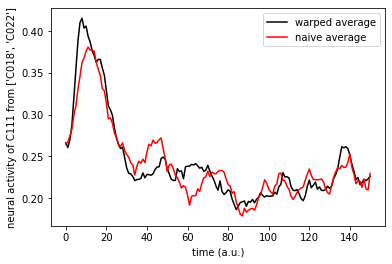

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.58it/s]


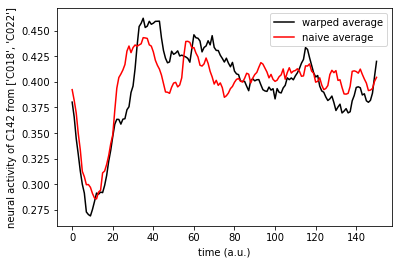

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 539.07it/s]


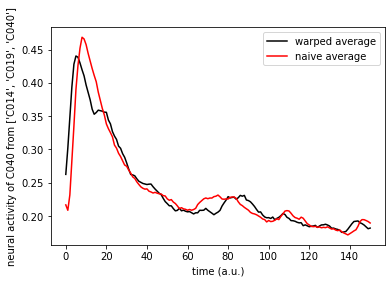

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 544.51it/s]


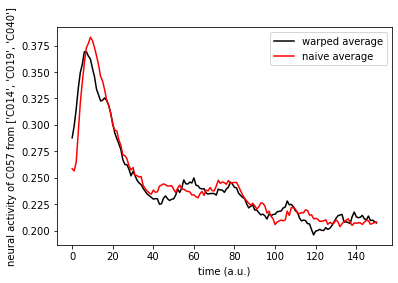

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 604.00it/s]


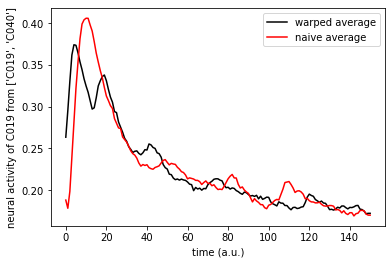

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 596.91it/s]


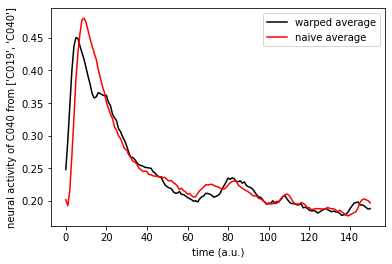

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 783.29it/s]


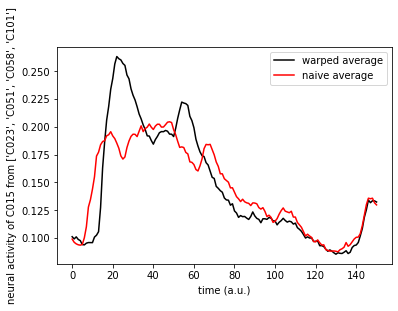

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 783.34it/s]


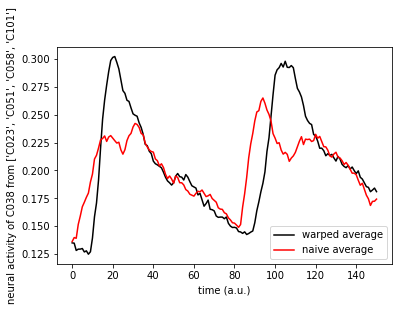

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 783.32it/s]


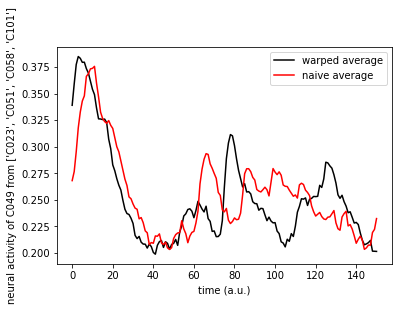

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.32it/s]


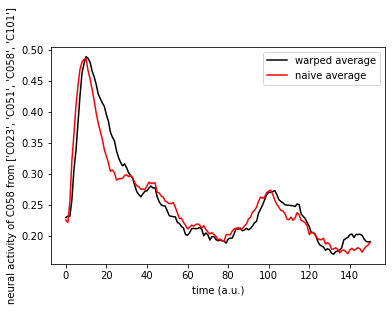

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.59it/s]


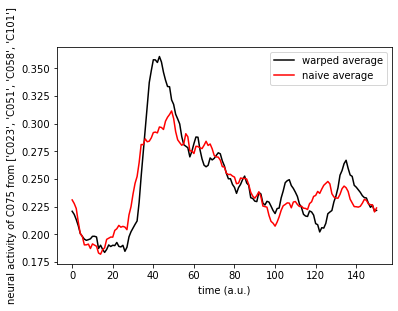

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.31it/s]


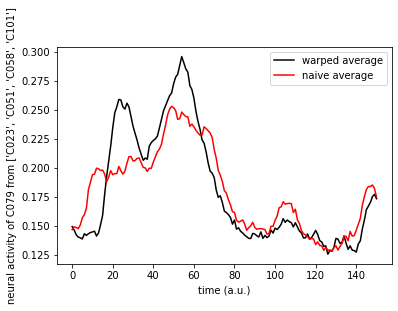

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.29it/s]


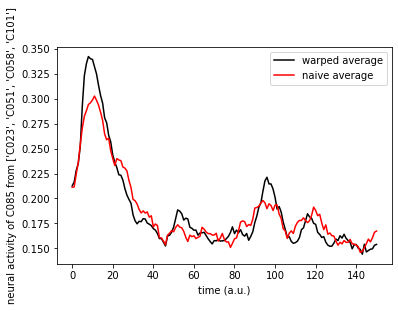

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


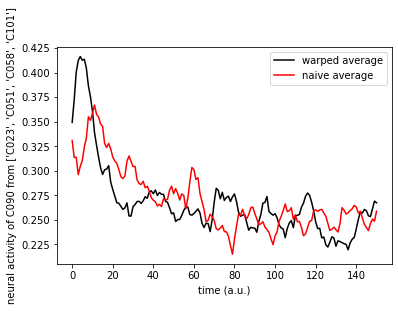

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 550.99it/s]


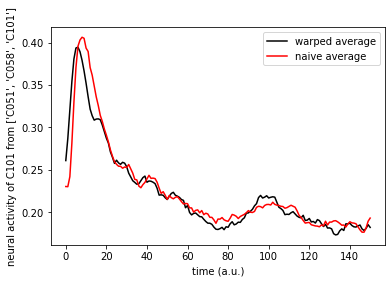

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.51it/s]


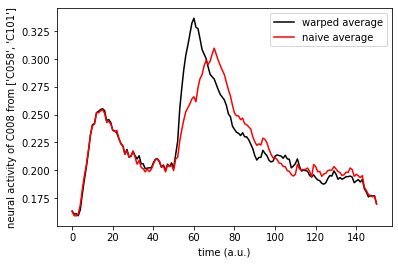

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


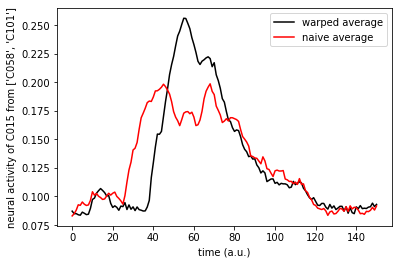

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 835.49it/s]


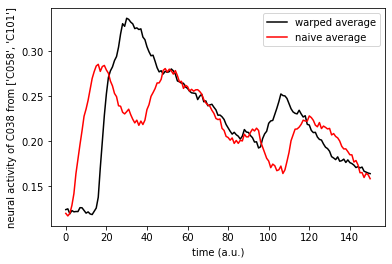

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.55it/s]


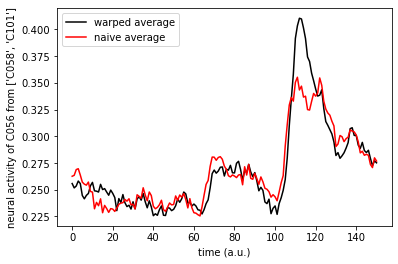

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.26it/s]


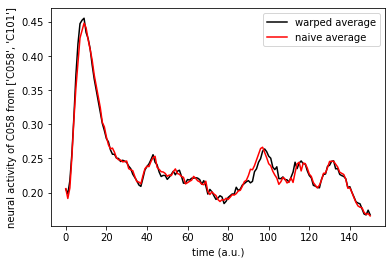

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 783.33it/s]


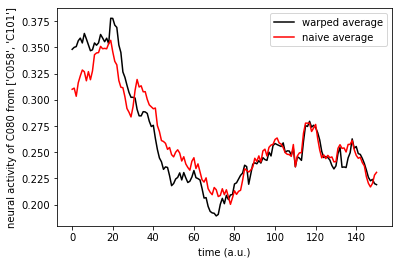

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.55it/s]


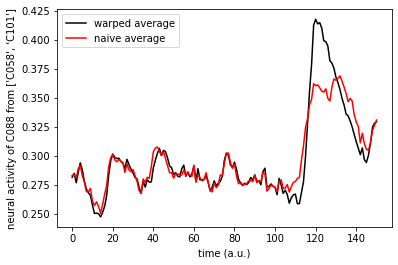

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.89it/s]


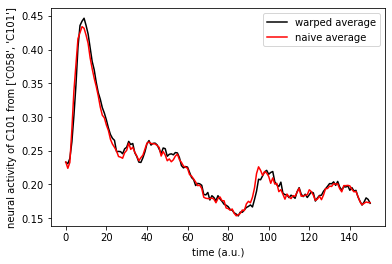

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.70it/s]


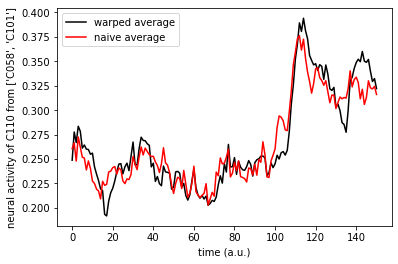

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.57it/s]


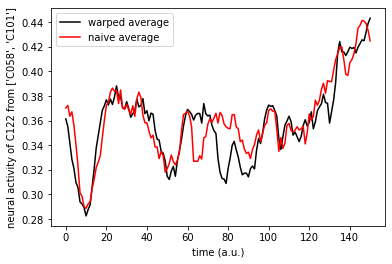

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.54it/s]


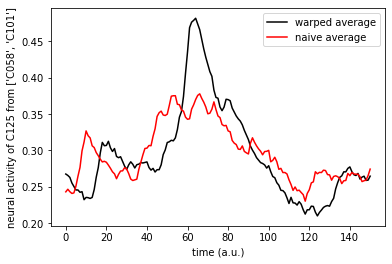

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.09it/s]


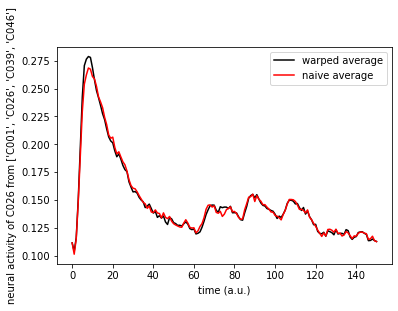

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.36it/s]


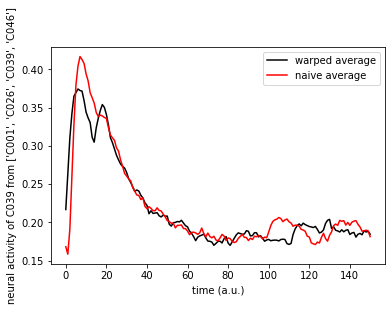

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 737.58it/s]


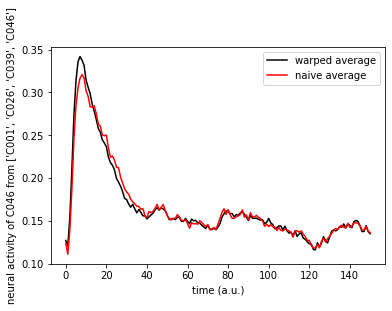

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 715.17it/s]


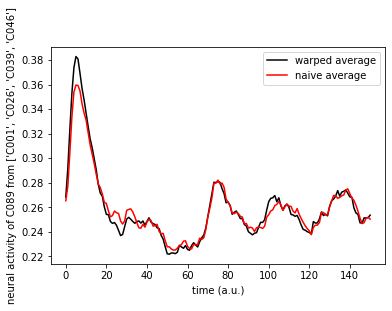

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 511.57it/s]


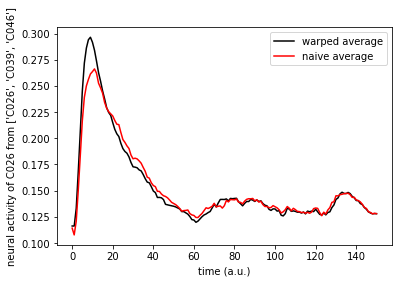

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.72it/s]


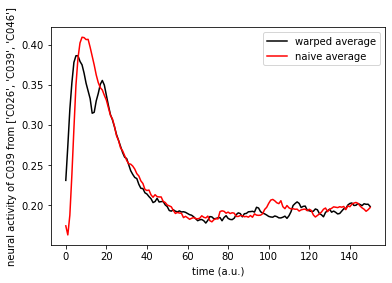

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 533.38it/s]


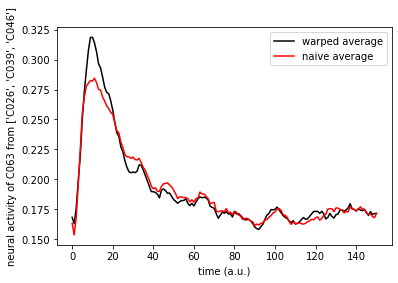

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 557.16it/s]


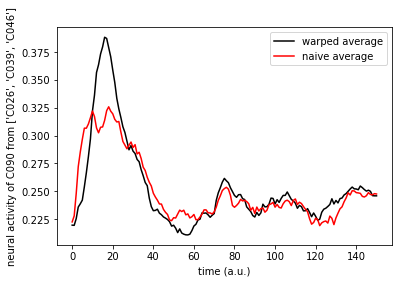

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 563.30it/s]


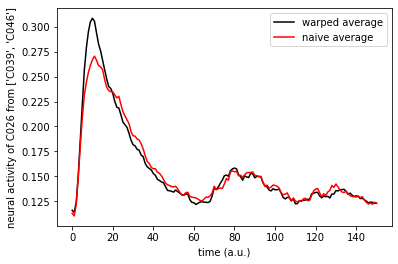

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 634.60it/s]


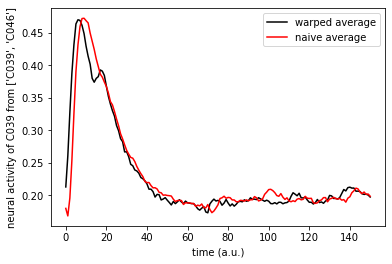

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 618.93it/s]


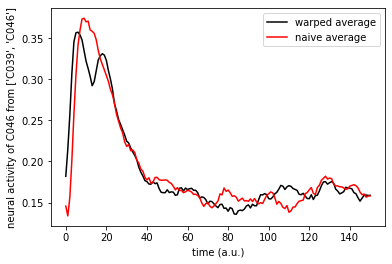

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 611.27it/s]


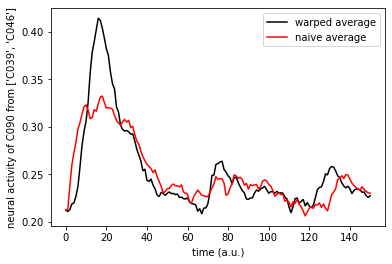

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 632.30it/s]


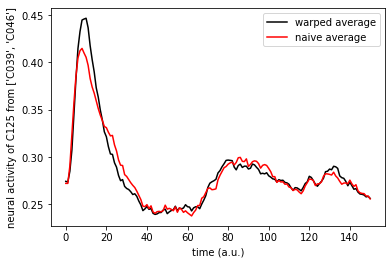

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


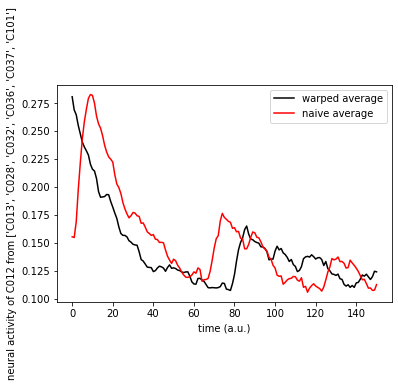

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.61it/s]


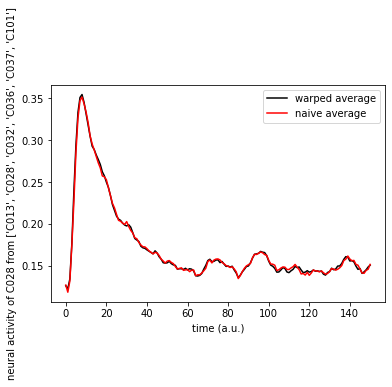

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 800.18it/s]


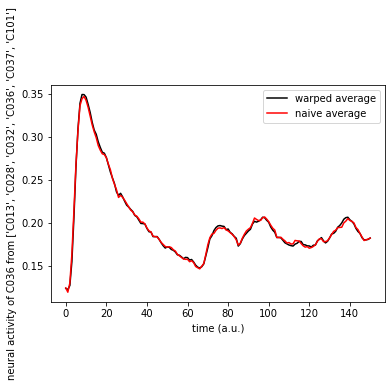

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1066.92it/s]


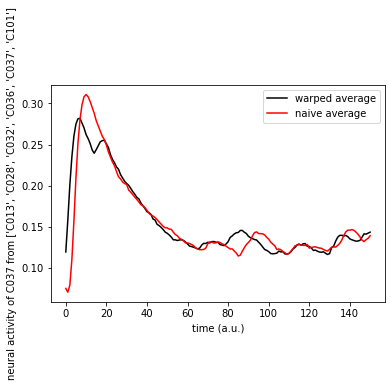

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 626.66it/s]


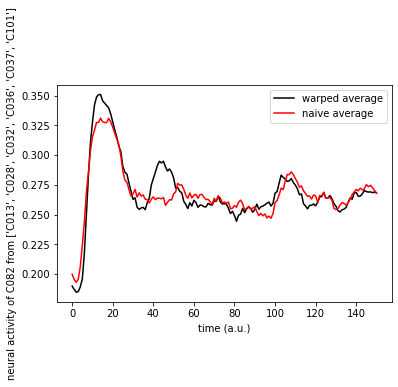

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.60it/s]


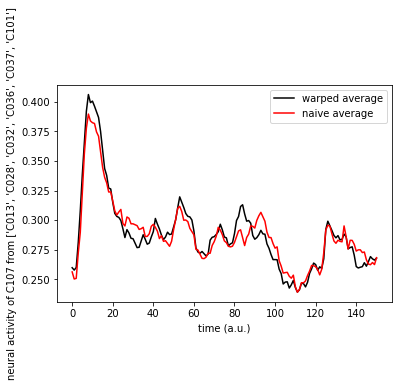

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.47it/s]


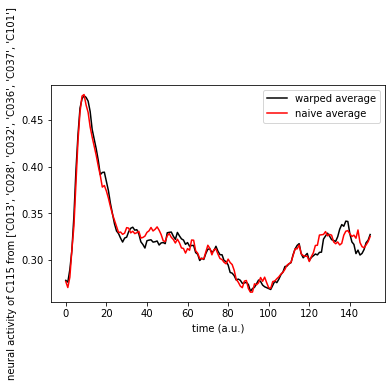

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 748.24it/s]


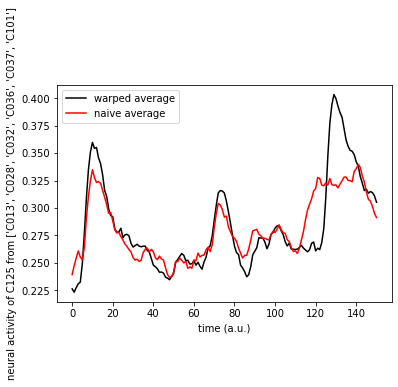

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


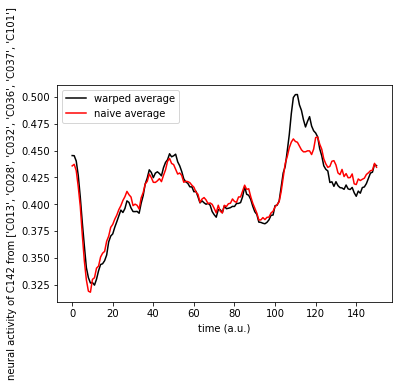

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 796.19it/s]


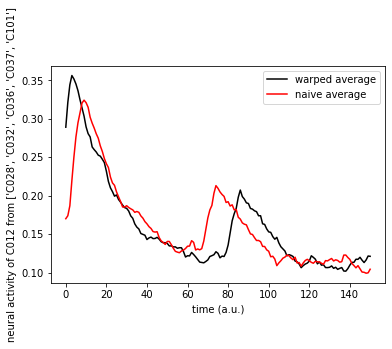

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.79it/s]


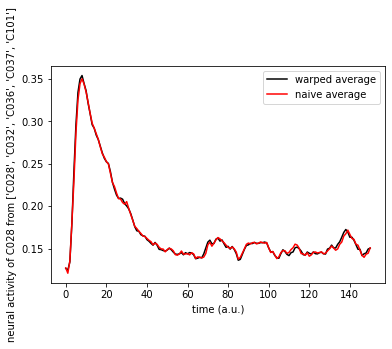

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.58it/s]


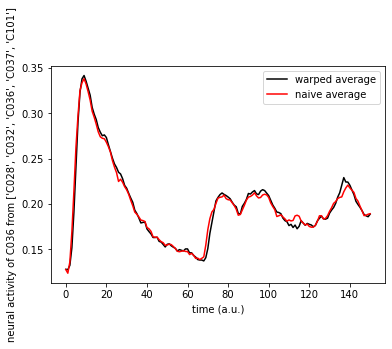

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


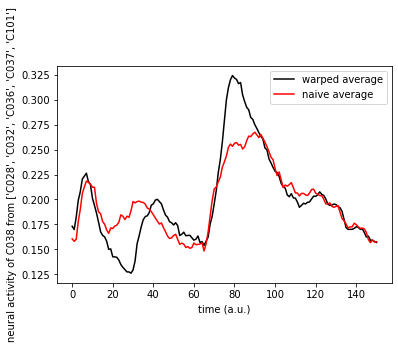

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 821.84it/s]


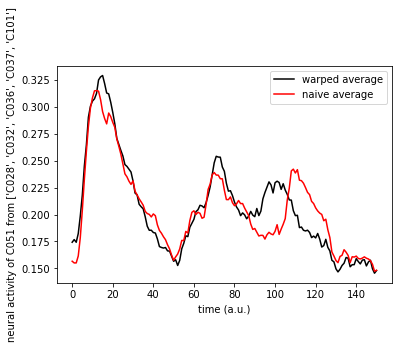

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 700.88it/s]


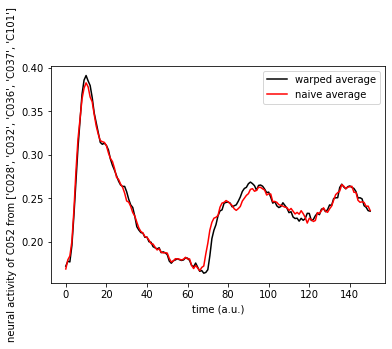

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


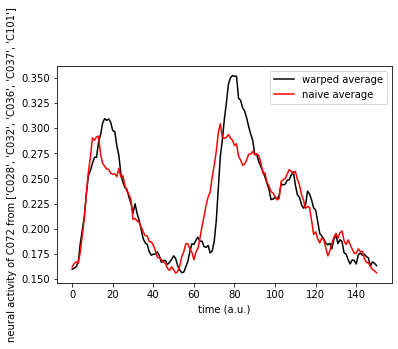

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.59it/s]


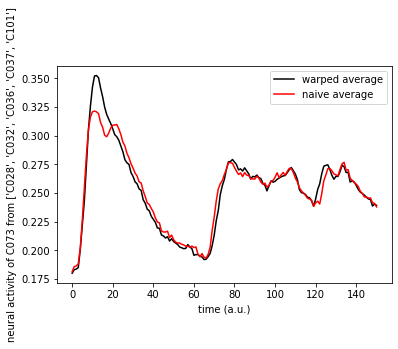

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.29it/s]


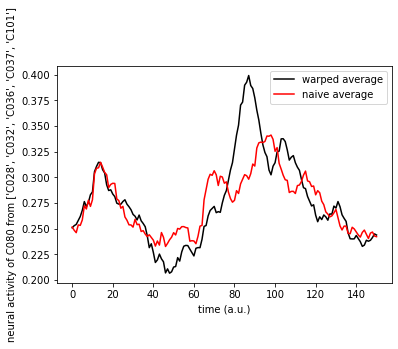

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 767.11it/s]


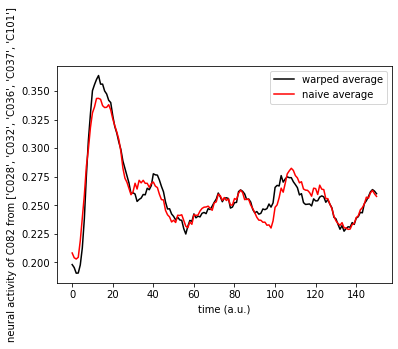

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


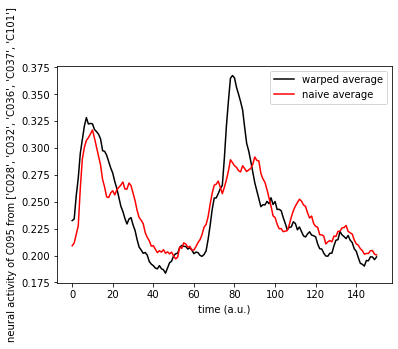

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.18it/s]


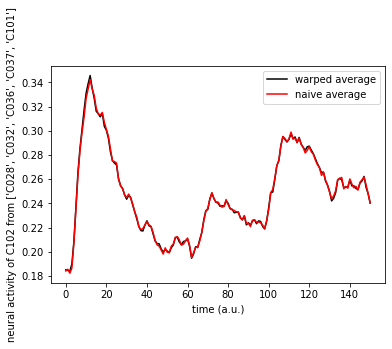

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.25it/s]


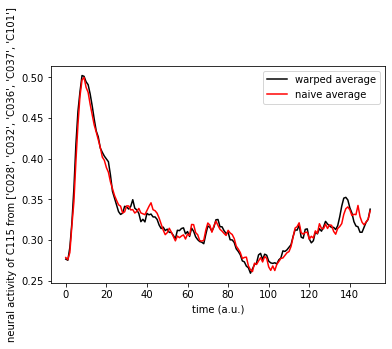

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 726.57it/s]


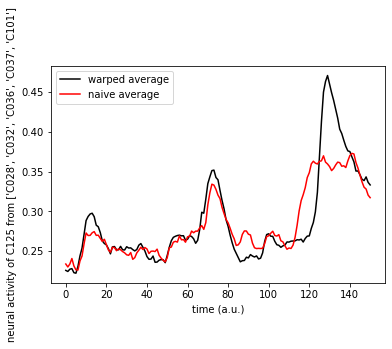

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.78it/s]


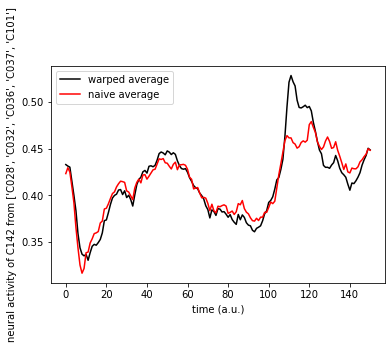

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


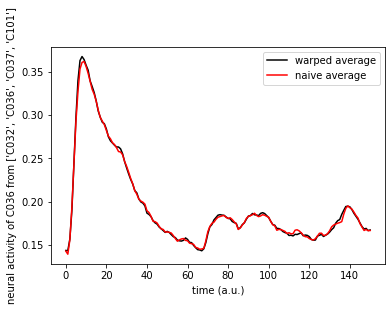

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.48it/s]


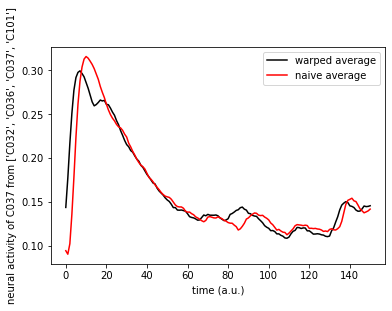

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 696.32it/s]


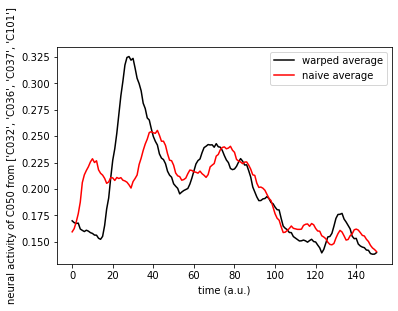

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 748.26it/s]


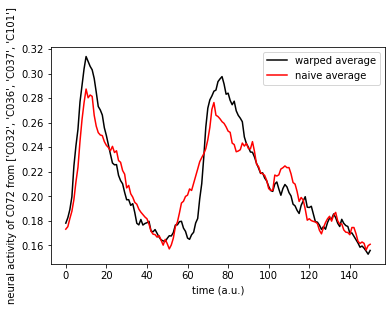

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.25it/s]


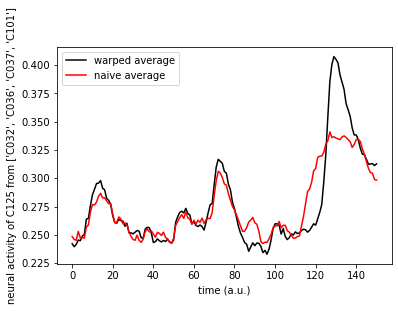

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 544.91it/s]


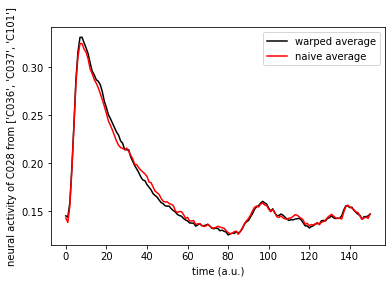

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 511.58it/s]


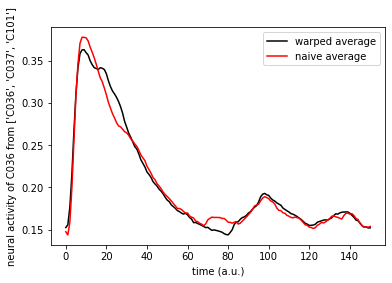

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 516.89it/s]


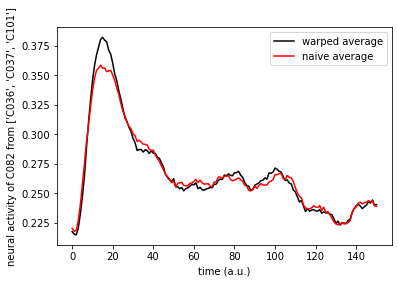

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.57it/s]


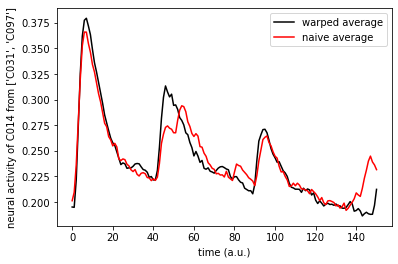

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.62it/s]


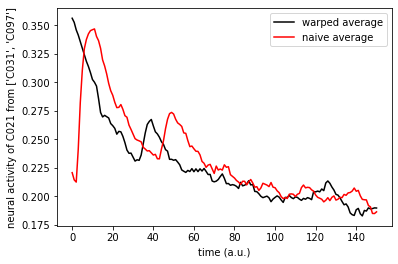

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.36it/s]


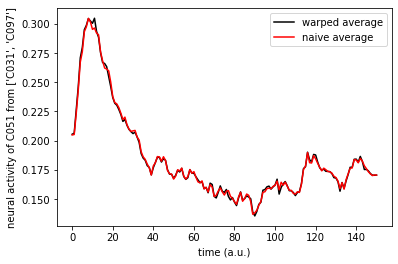

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 783.34it/s]


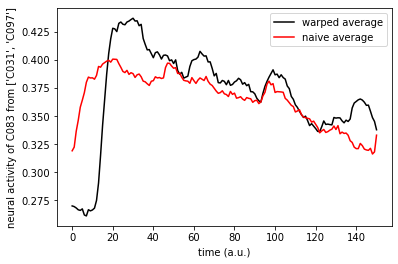

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.34it/s]


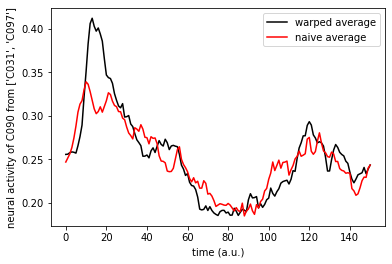

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.62it/s]


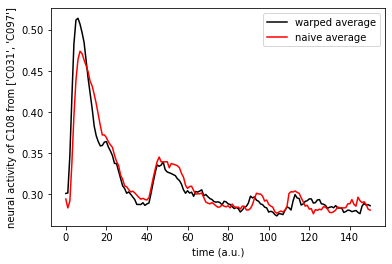

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


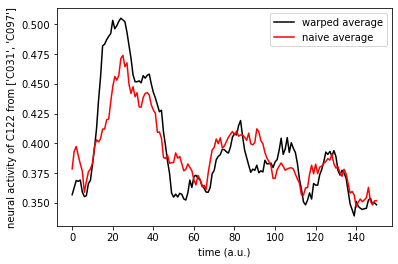

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.36it/s]


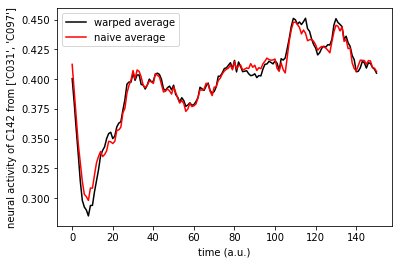

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.08it/s]


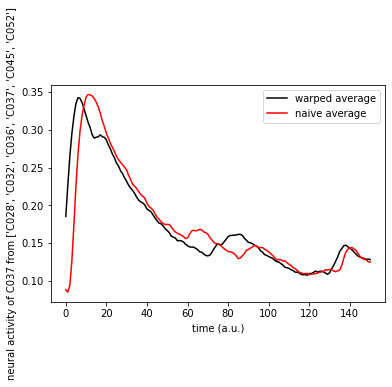

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.44it/s]


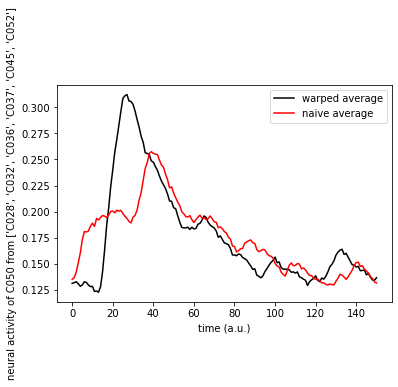

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


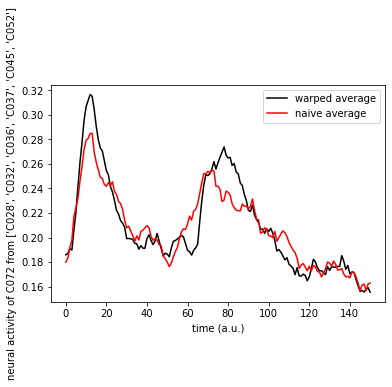

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.57it/s]


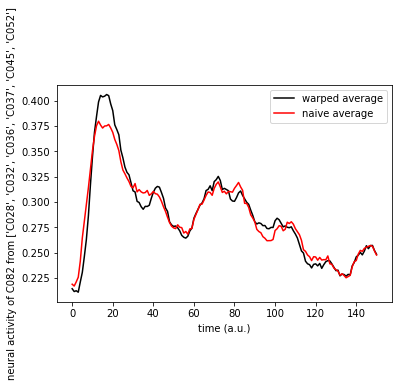

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


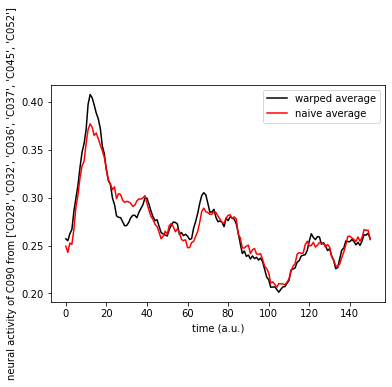

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 683.05it/s]


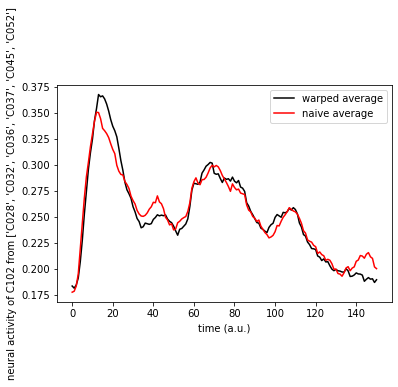

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 771.28it/s]


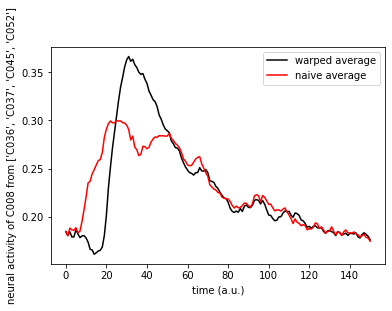

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.62it/s]


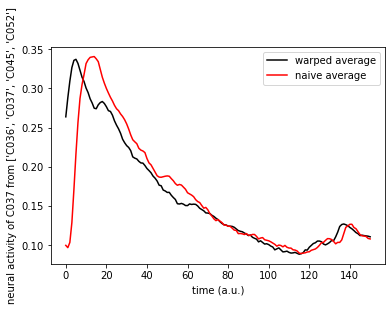

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 771.29it/s]


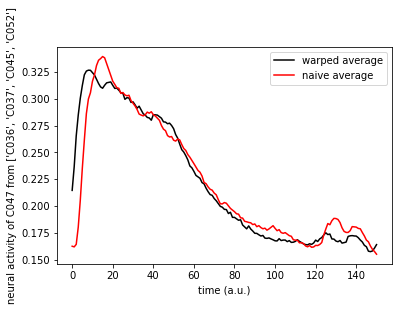

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.32it/s]


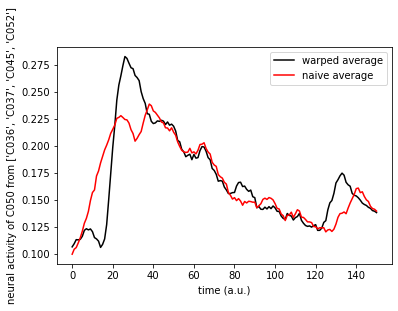

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.36it/s]


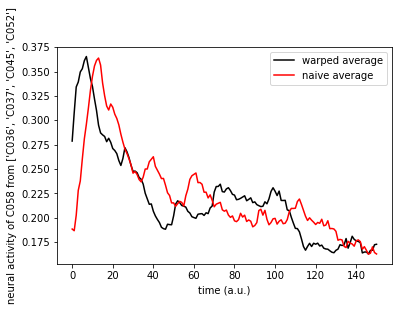

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


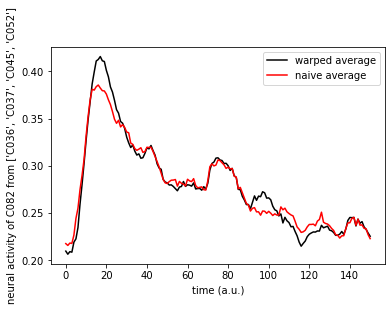

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 850.02it/s]


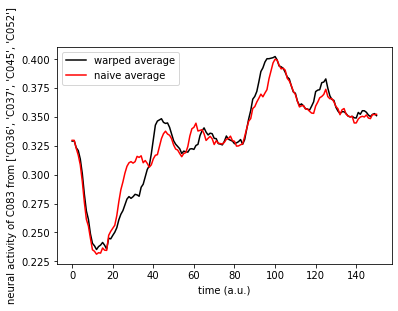

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.37it/s]


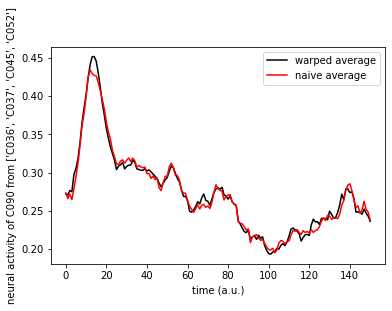

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.59it/s]


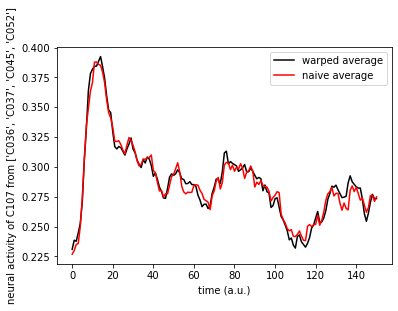

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.61it/s]


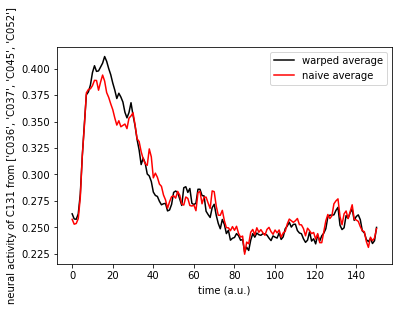

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 569.70it/s]


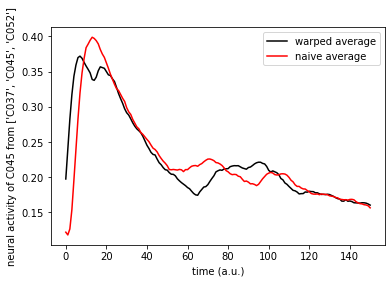

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.72it/s]


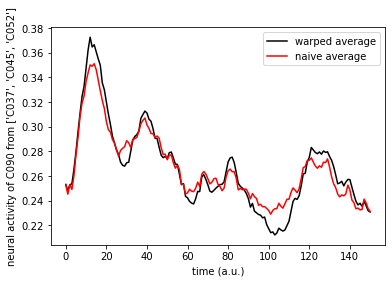

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


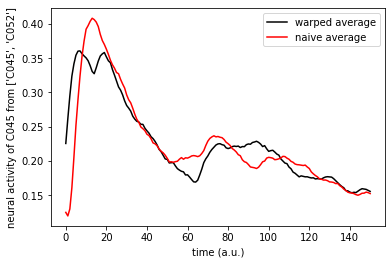

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.47it/s]


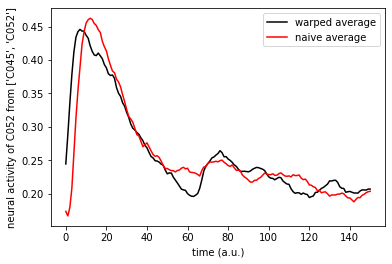

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 667.05it/s]


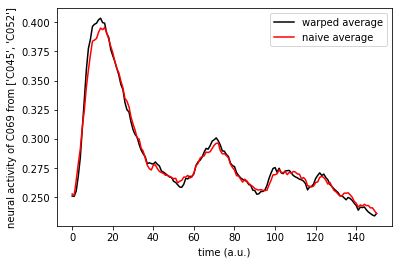

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 667.79it/s]


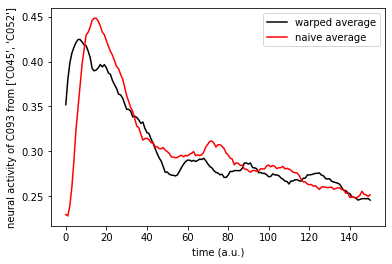

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 659.80it/s]


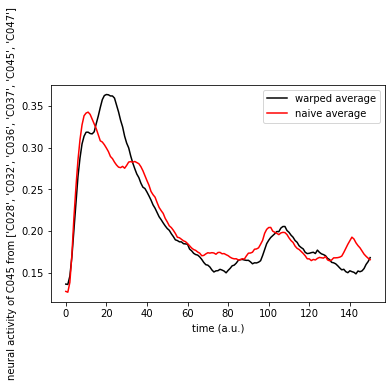

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 589.81it/s]


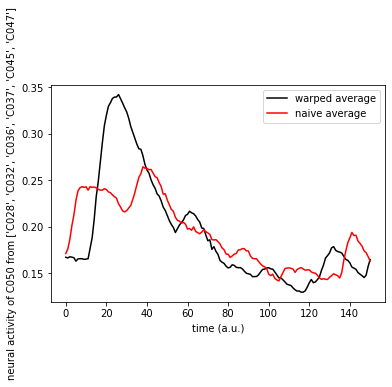

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


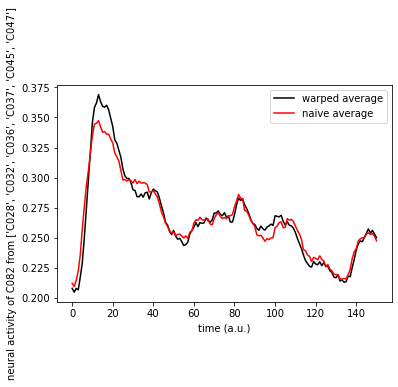

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.74it/s]


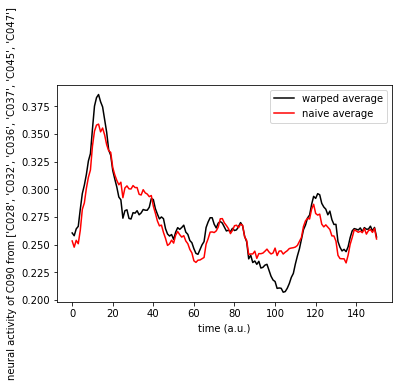

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.83it/s]


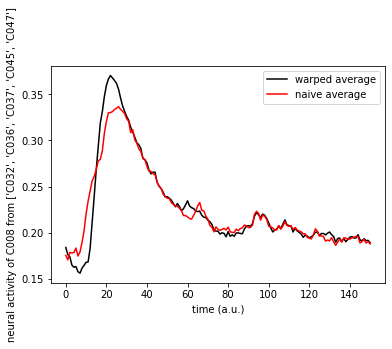

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 864.36it/s]


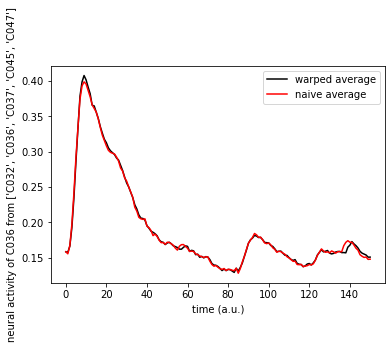

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 699.89it/s]


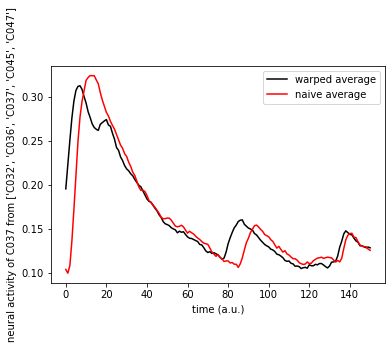

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.57it/s]


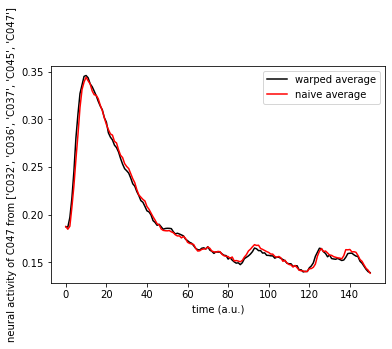

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.53it/s]


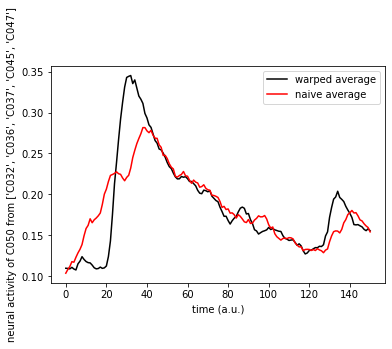

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.62it/s]


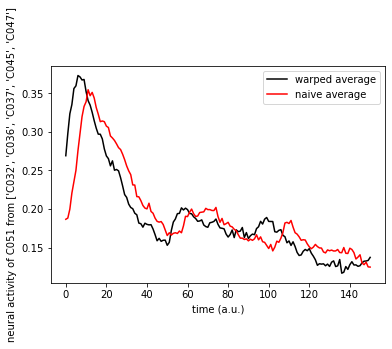

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.73it/s]


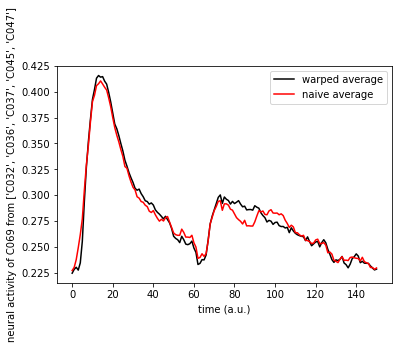

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 835.56it/s]


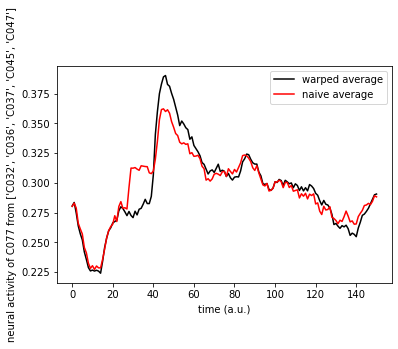

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.61it/s]


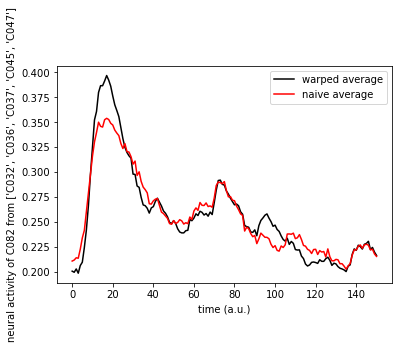

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.38it/s]


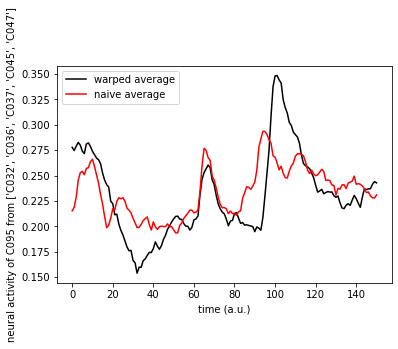

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.71it/s]


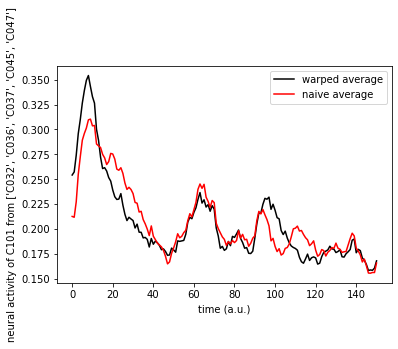

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 729.85it/s]


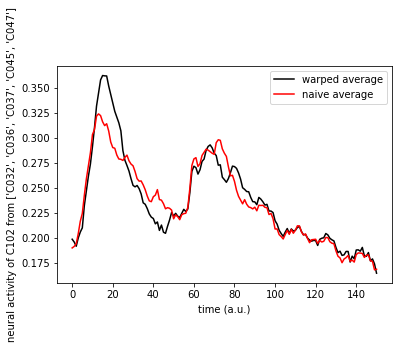

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 808.61it/s]


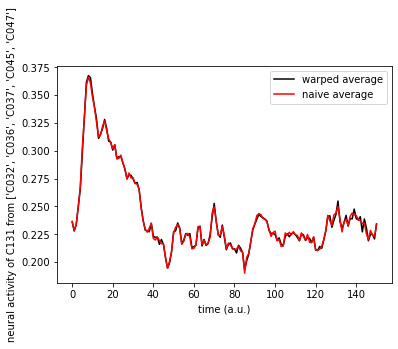

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


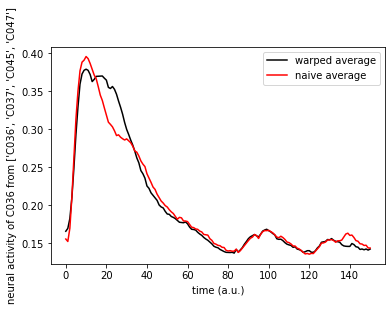

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 716.31it/s]


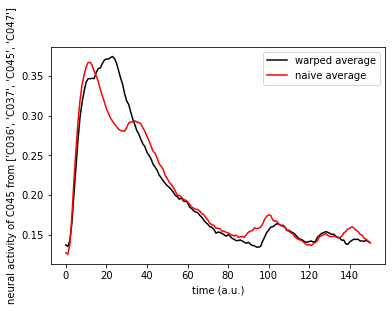

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.30it/s]


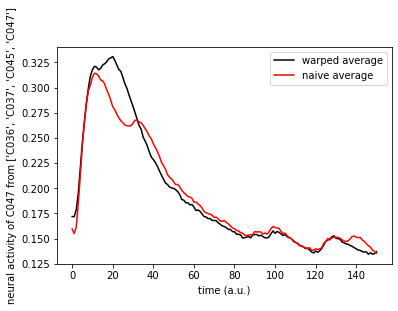

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.31it/s]


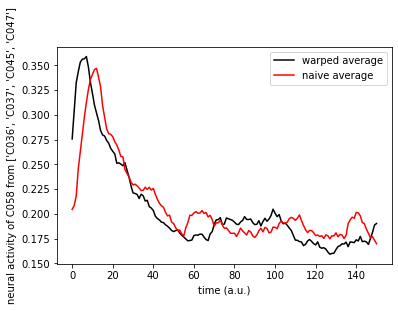

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.45it/s]


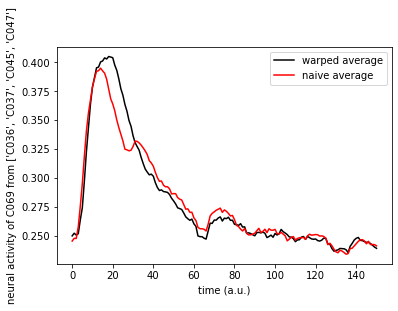

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 721.44it/s]


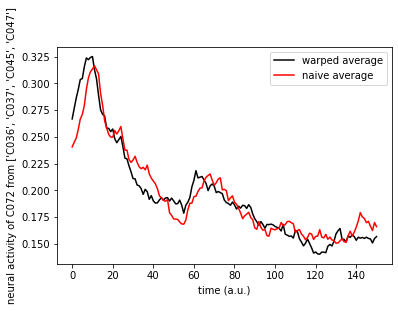

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.08it/s]


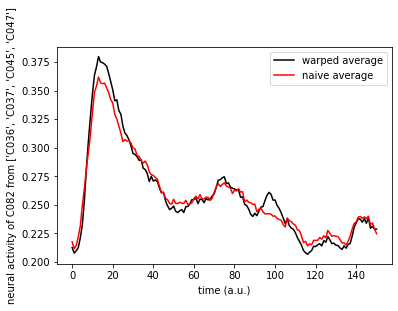

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.84it/s]


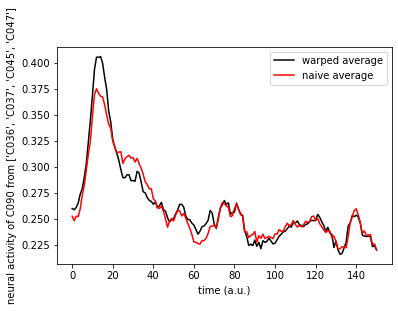

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.50it/s]


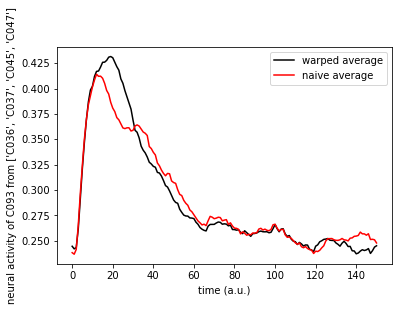

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 713.40it/s]


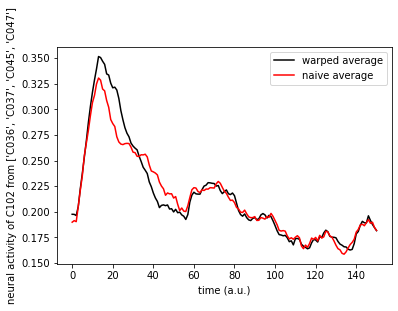

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.47it/s]


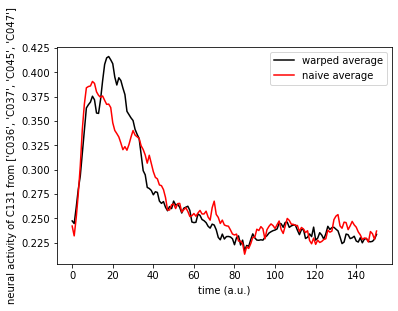

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 533.34it/s]


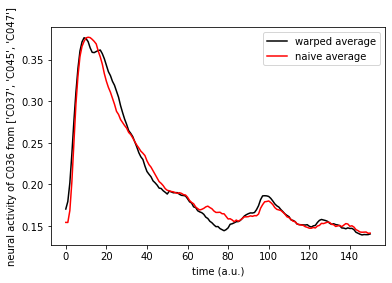

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 472.96it/s]


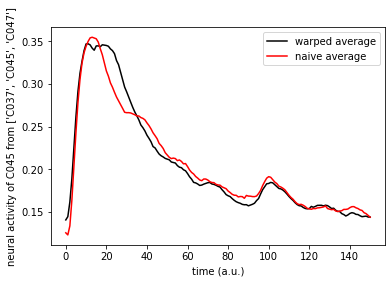

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 550.75it/s]


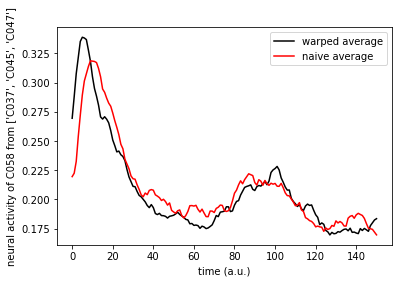

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.73it/s]


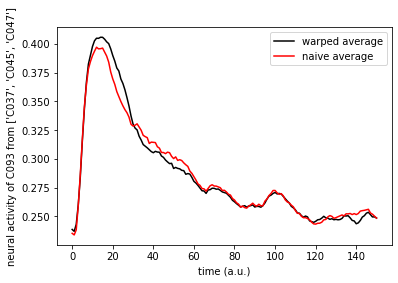

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.46it/s]


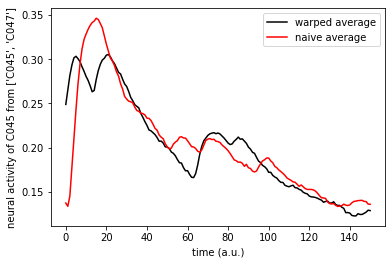

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.51it/s]


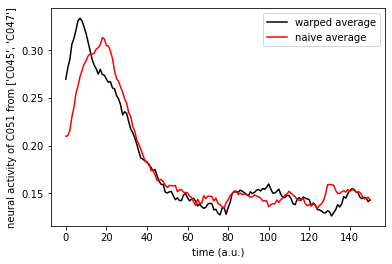

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.50it/s]


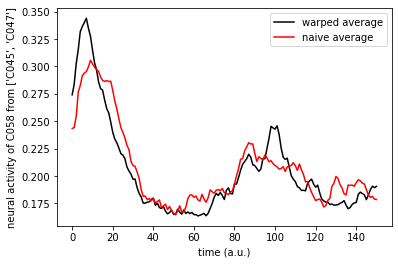

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.08it/s]


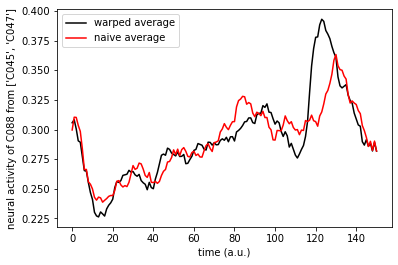

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


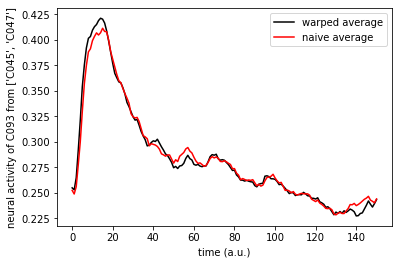

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.86it/s]


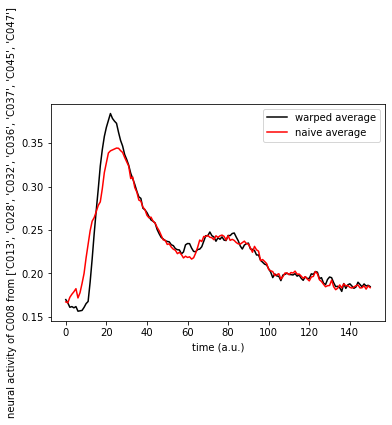

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 771.29it/s]


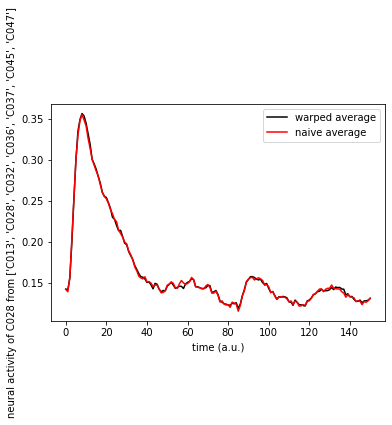

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 850.00it/s]


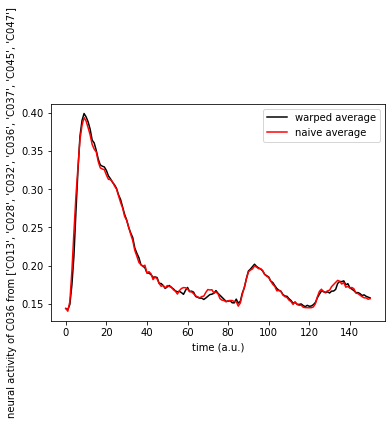

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 720.42it/s]


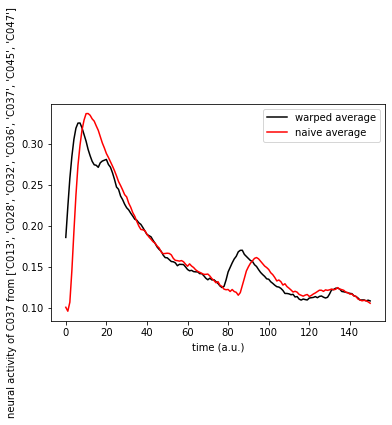

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 808.86it/s]


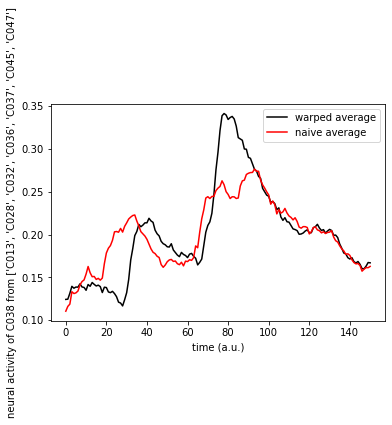

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.74it/s]


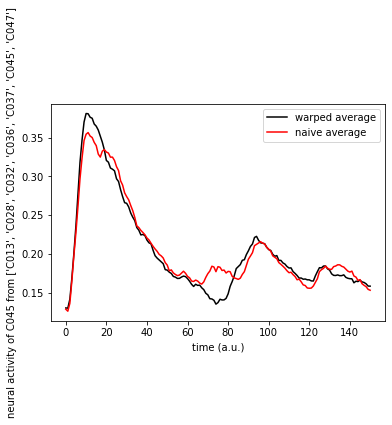

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 864.35it/s]


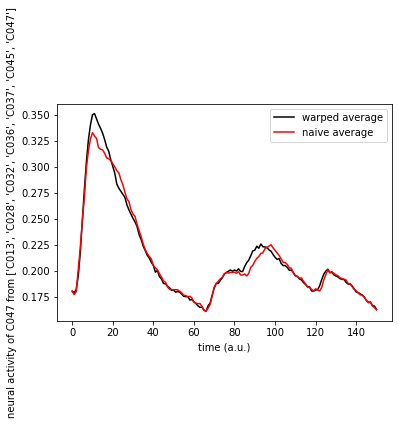

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.97it/s]


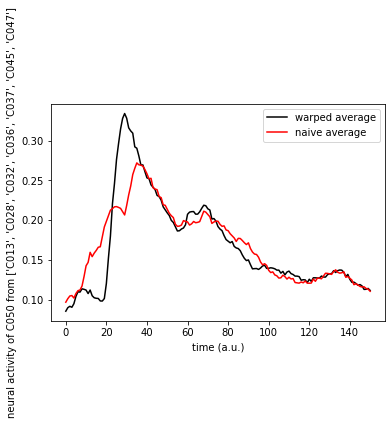

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 850.04it/s]


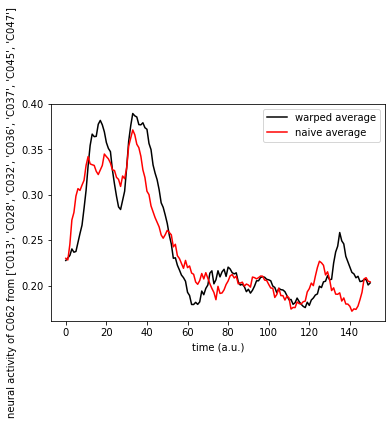

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.60it/s]


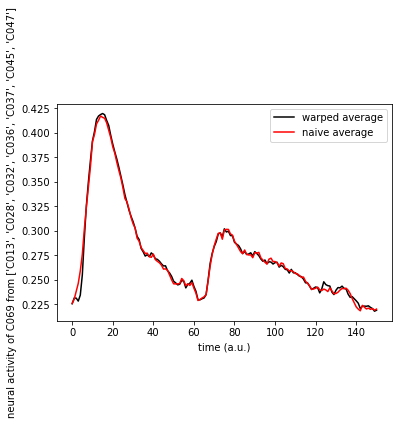

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 895.24it/s]


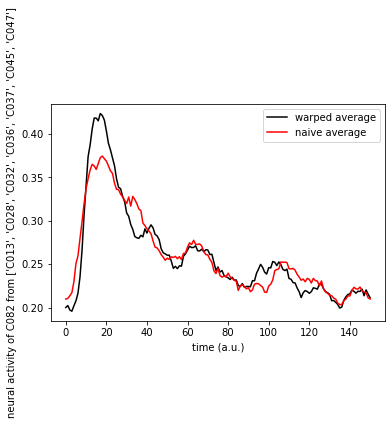

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


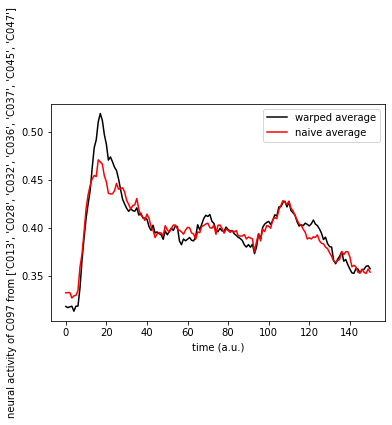

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.38it/s]


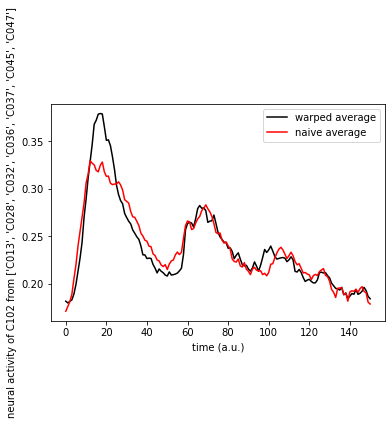

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.54it/s]


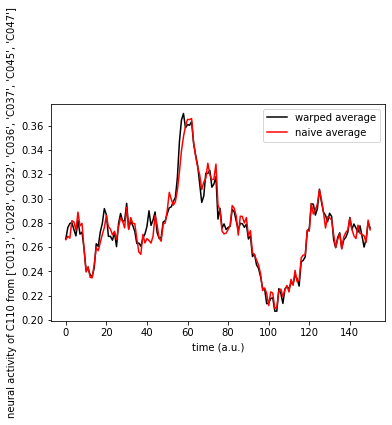

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.77it/s]


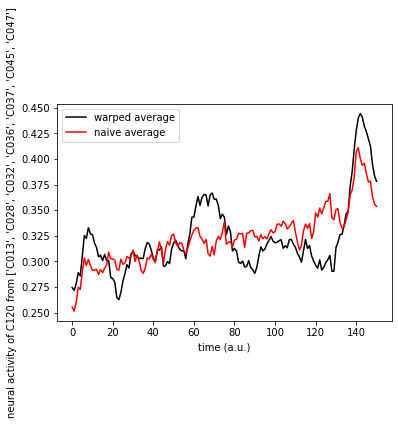

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.78it/s]


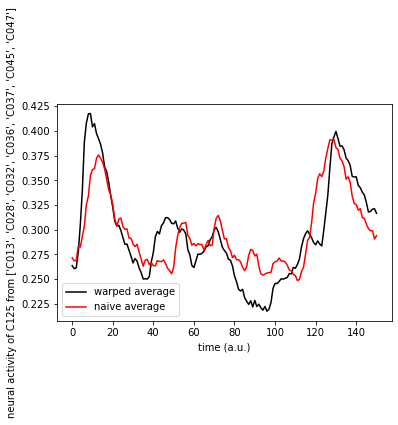

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 700.03it/s]


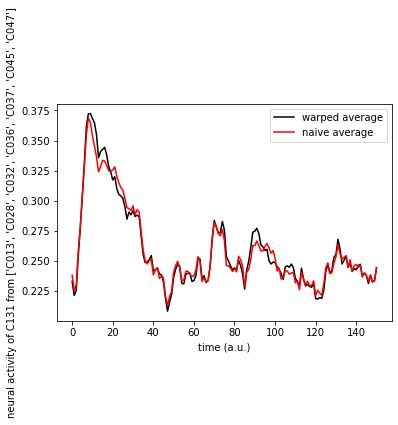

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 686.76it/s]


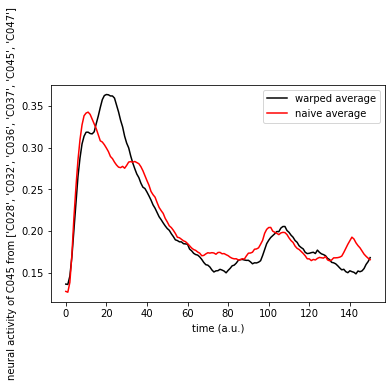

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 677.48it/s]


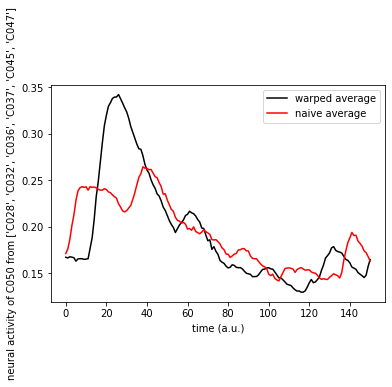

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 684.71it/s]


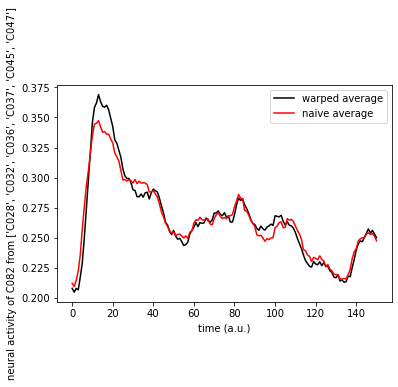

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.07it/s]


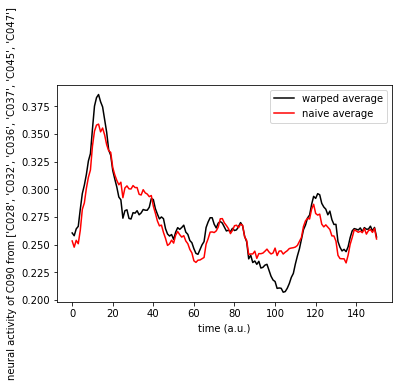

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 880.01it/s]


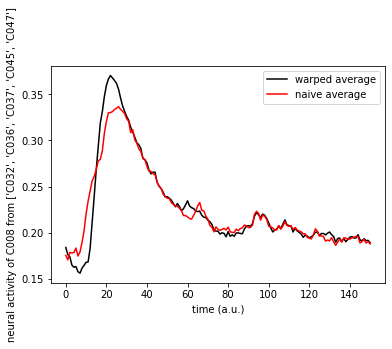

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 821.97it/s]


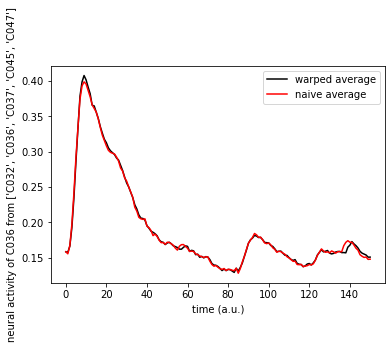

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 663.76it/s]


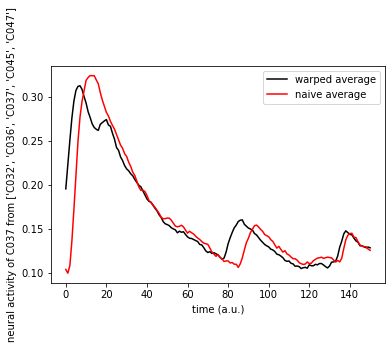

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.93it/s]


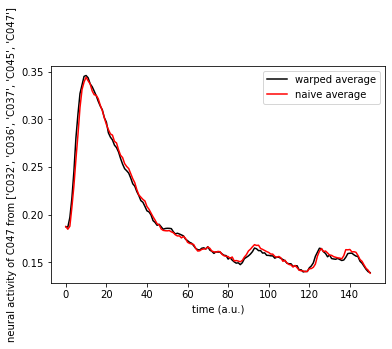

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.71it/s]


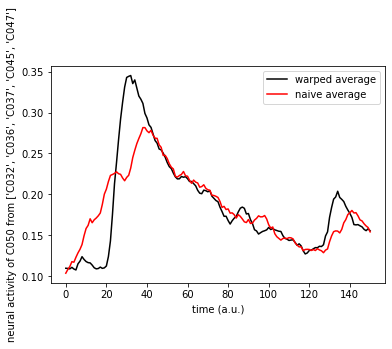

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 625.89it/s]


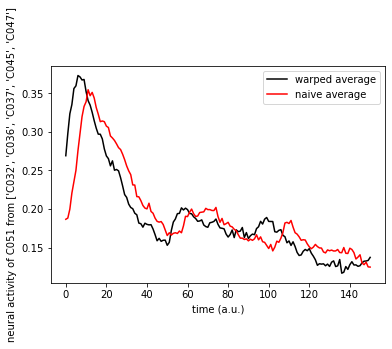

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.39it/s]


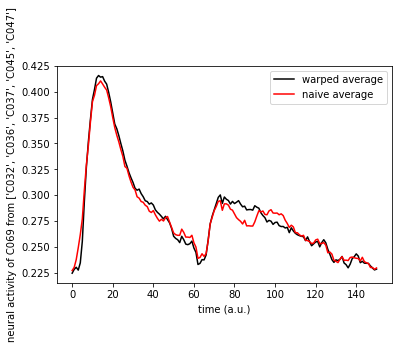

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 822.27it/s]


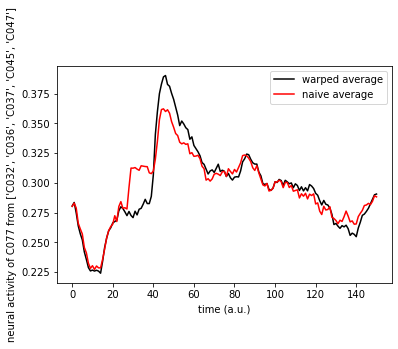

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.96it/s]


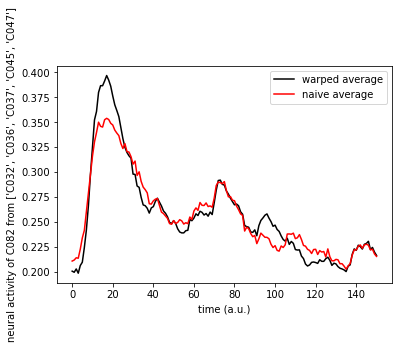

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.53it/s]


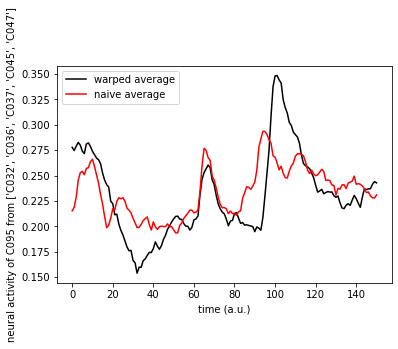

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 594.05it/s]


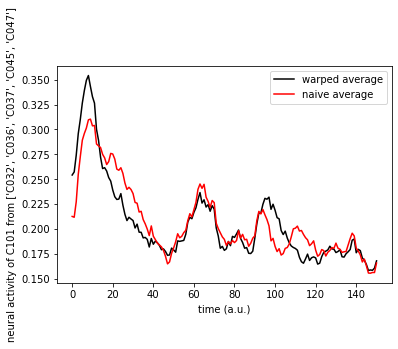

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.85it/s]


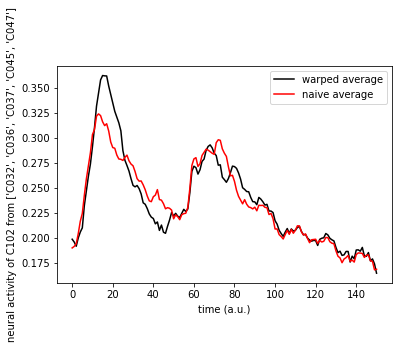

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 835.57it/s]


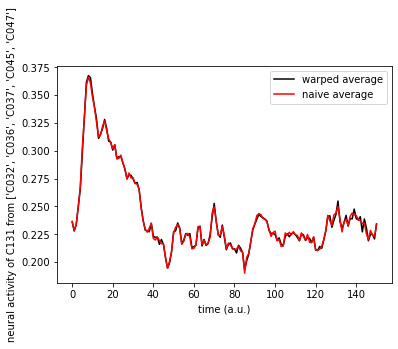

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.17it/s]


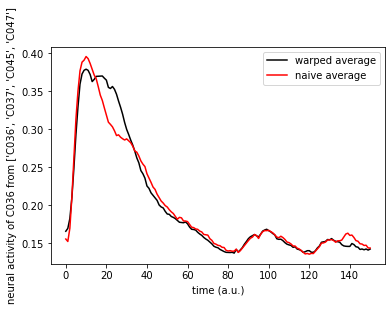

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 696.29it/s]


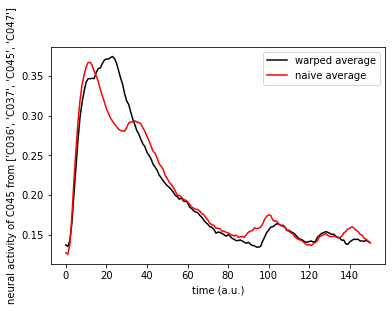

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


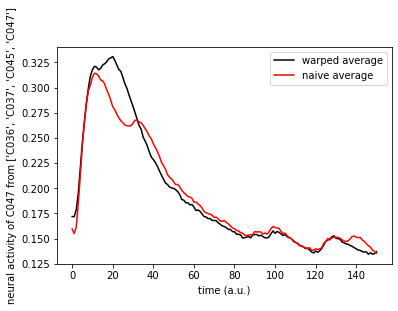

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 687.01it/s]


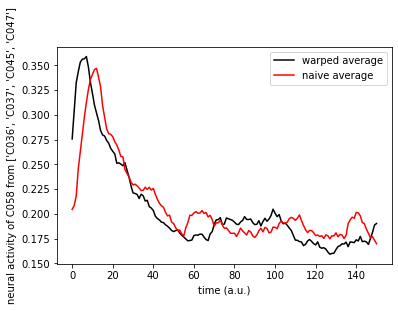

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.48it/s]


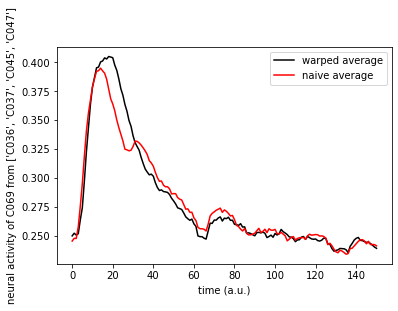

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.47it/s]


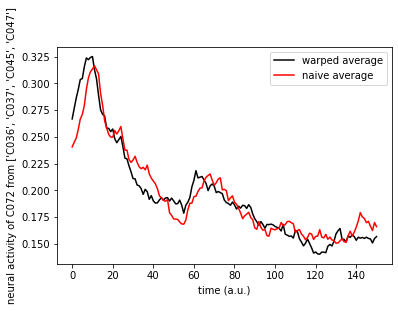

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


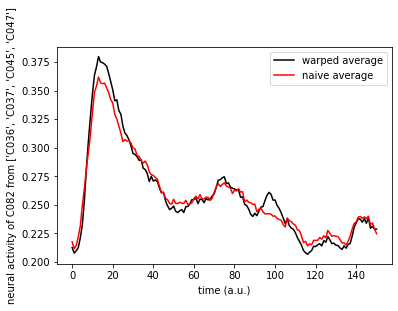

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.48it/s]


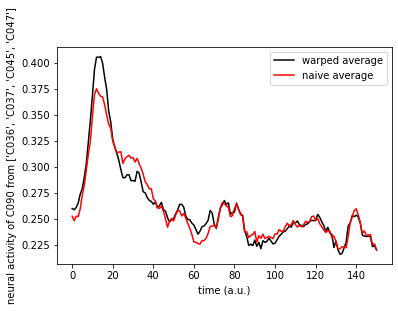

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 682.93it/s]


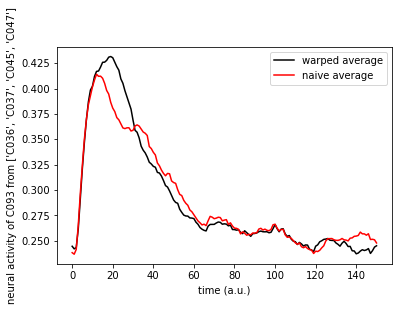

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.76it/s]


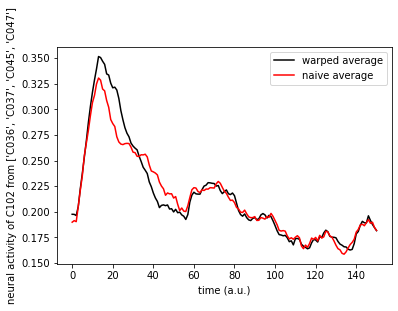

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.50it/s]


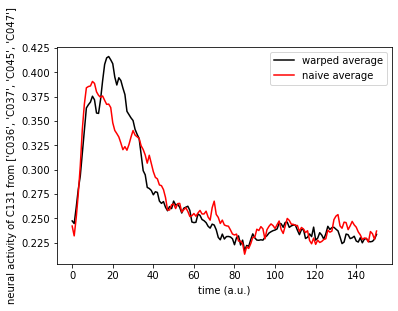

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.72it/s]


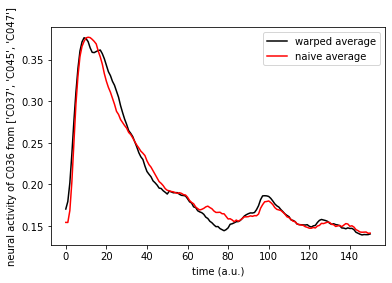

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 533.33it/s]


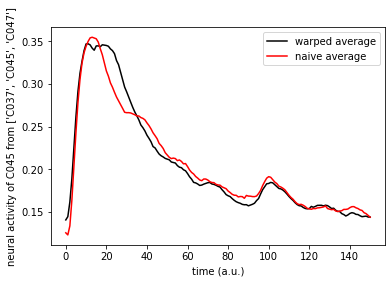

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 516.87it/s]


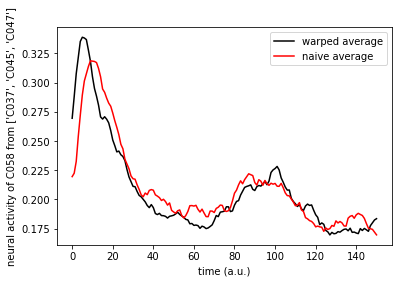

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 533.49it/s]


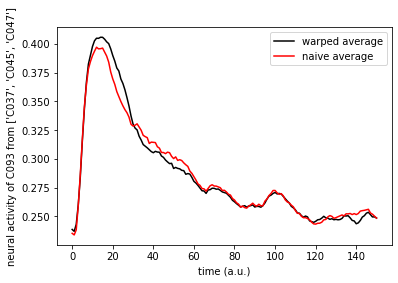

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


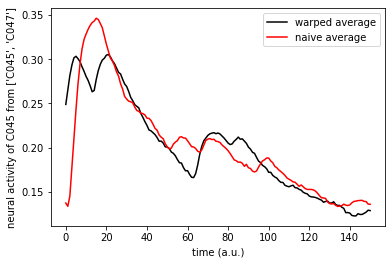

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


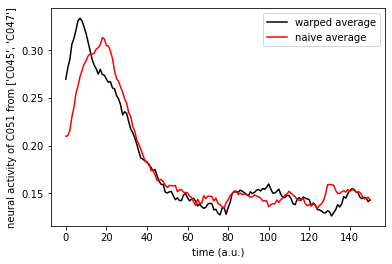

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 618.93it/s]


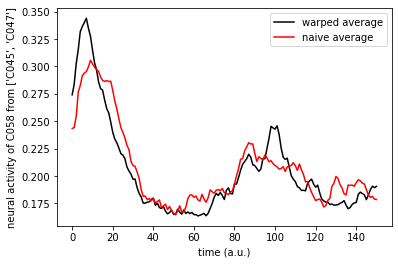

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.54it/s]


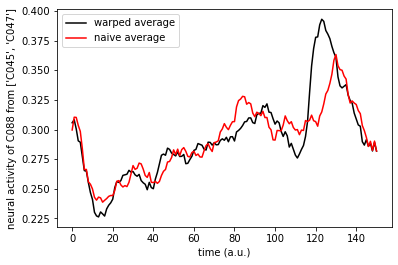

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 618.92it/s]


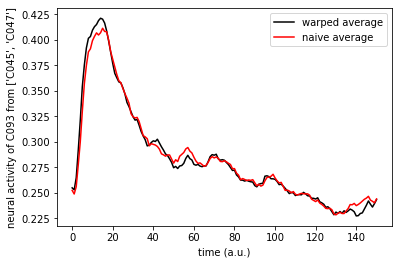

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 544.90it/s]


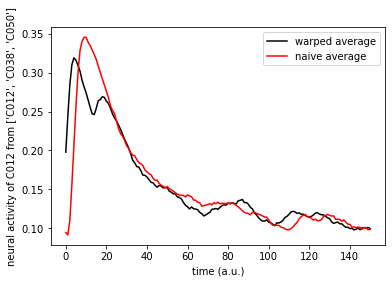

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 544.93it/s]


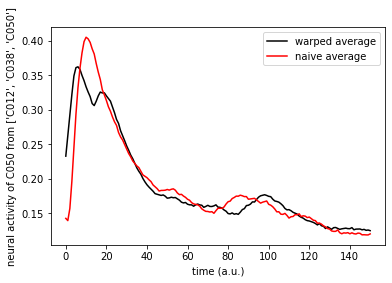

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 668.46it/s]


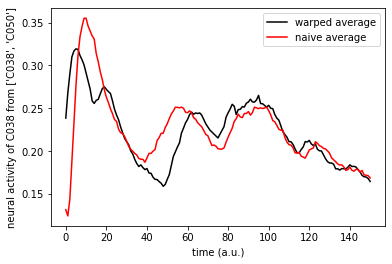

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.41it/s]


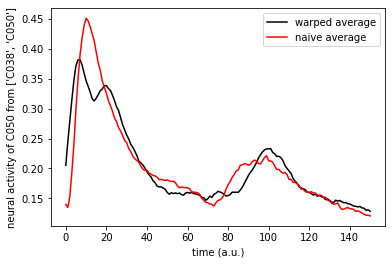

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.22it/s]


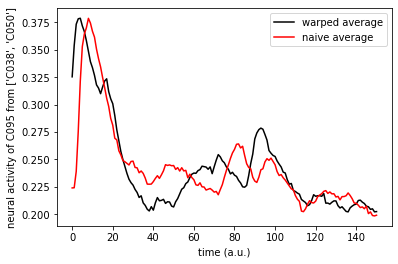

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 696.38it/s]


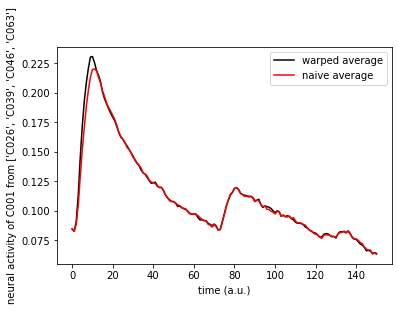

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.57it/s]


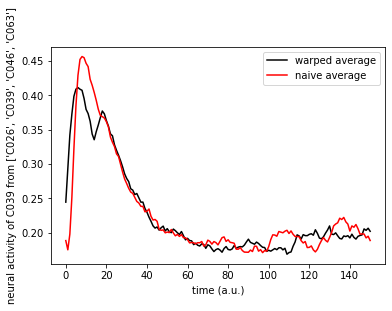

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


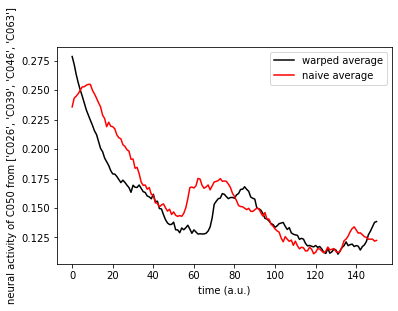

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 544.93it/s]


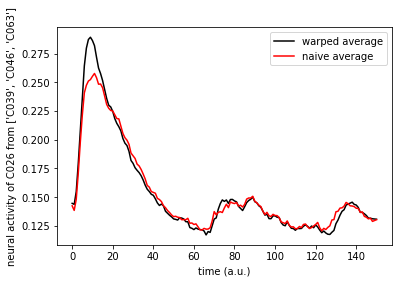

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.68it/s]


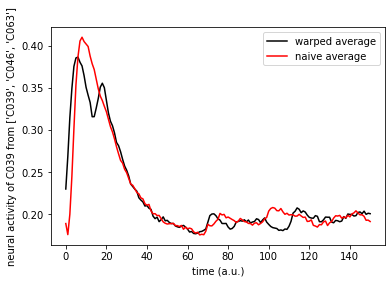

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 550.79it/s]


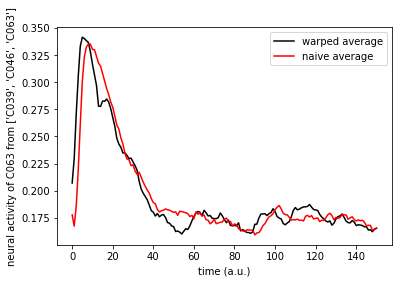

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 534.40it/s]


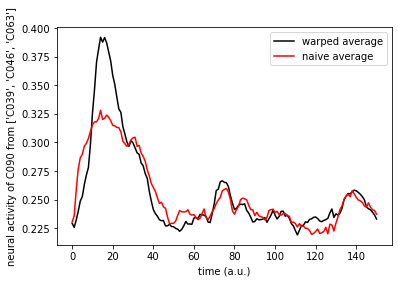

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 522.23it/s]


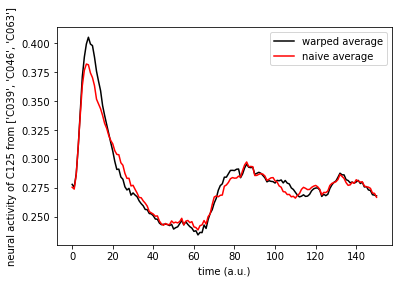

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 668.34it/s]


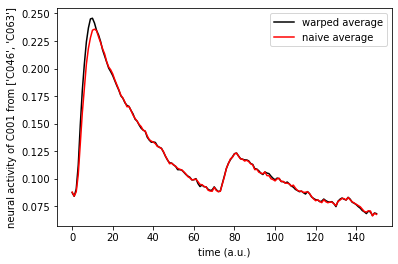

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


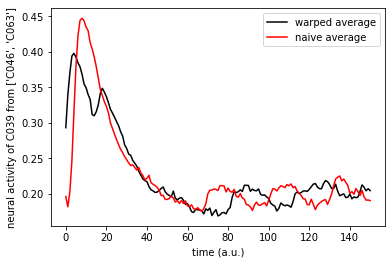

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


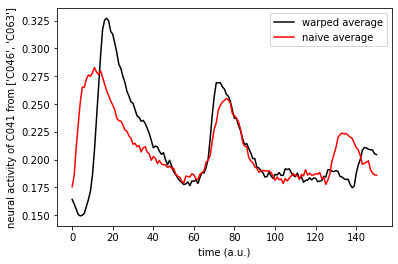

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.83it/s]


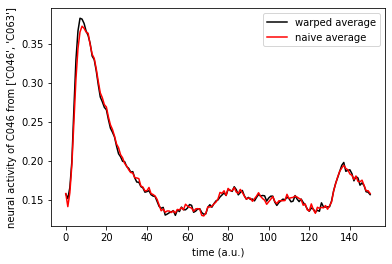

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.30it/s]


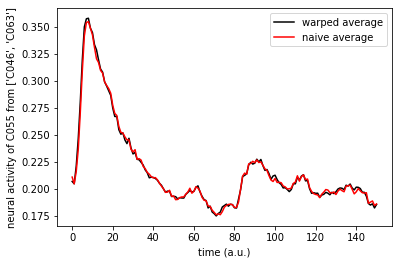

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.25it/s]


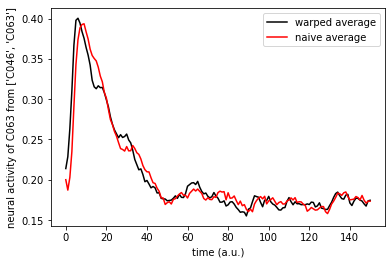

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 726.85it/s]


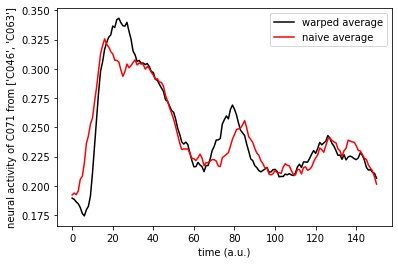

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.12it/s]


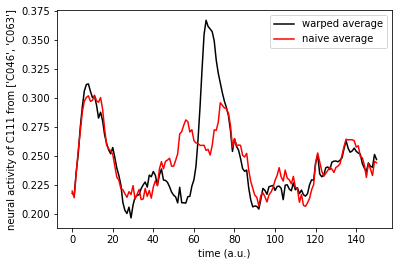

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 556.88it/s]


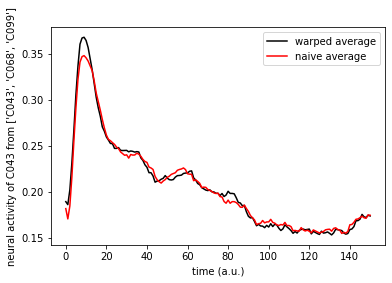

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 569.89it/s]


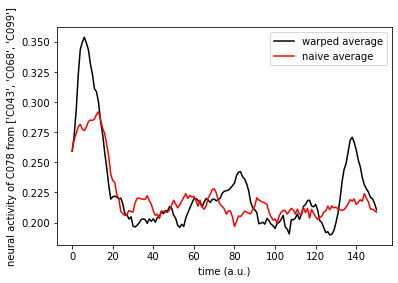

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 569.54it/s]


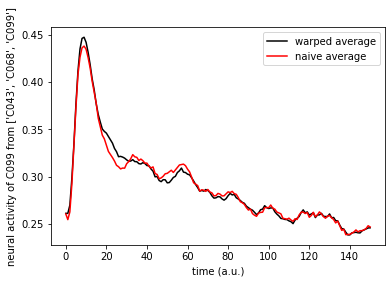

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


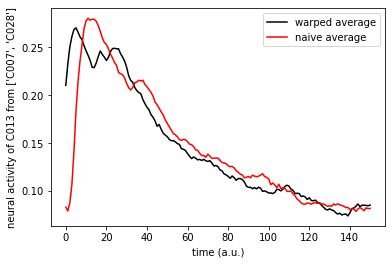

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.26it/s]


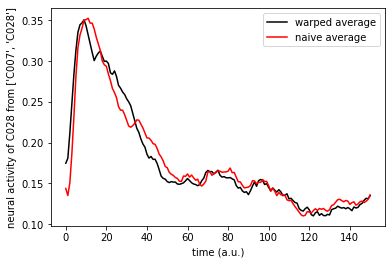

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.61it/s]


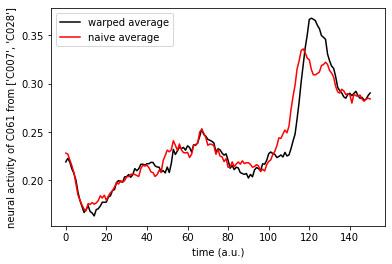

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.26it/s]


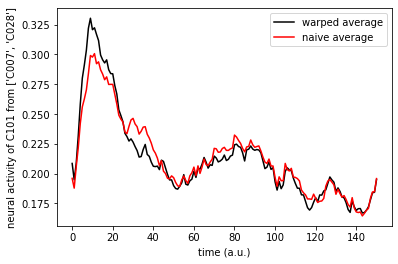

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


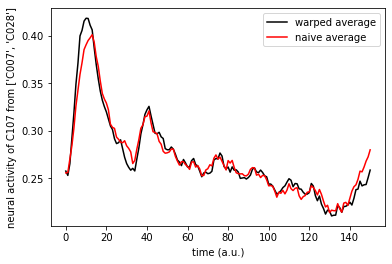

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.28it/s]


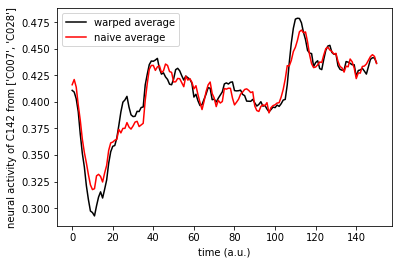

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.64it/s]


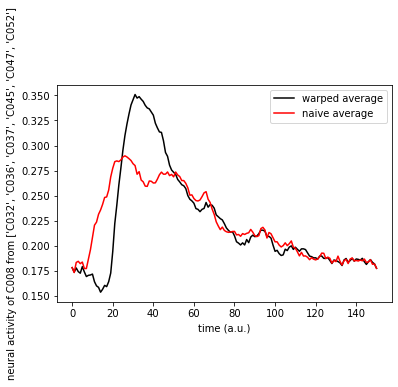

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.34it/s]


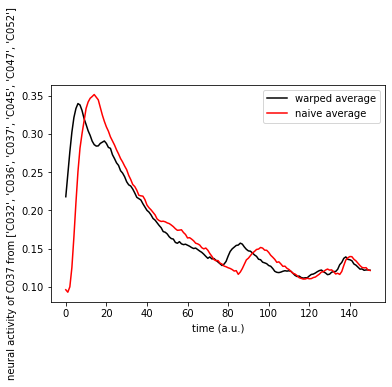

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.59it/s]


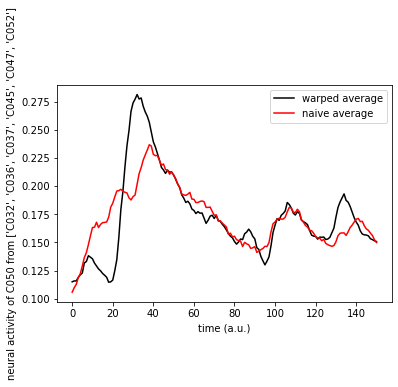

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 738.02it/s]


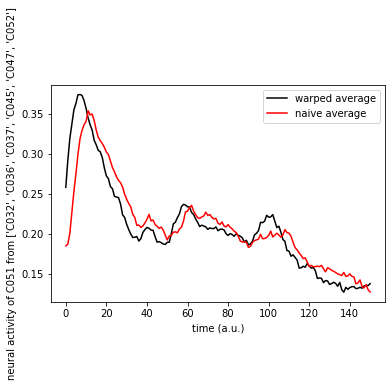

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.95it/s]


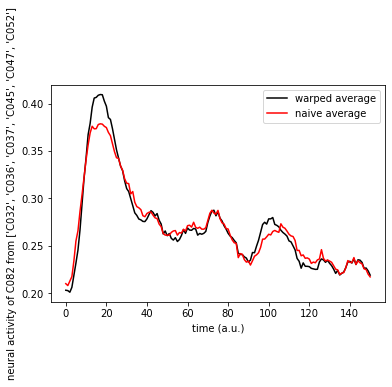

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.95it/s]


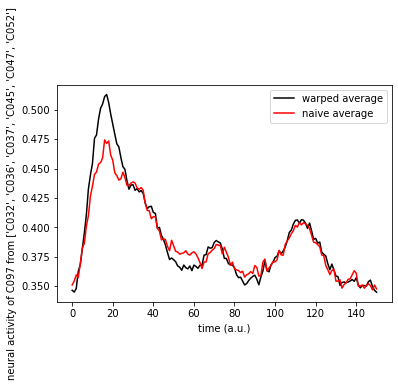

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.21it/s]


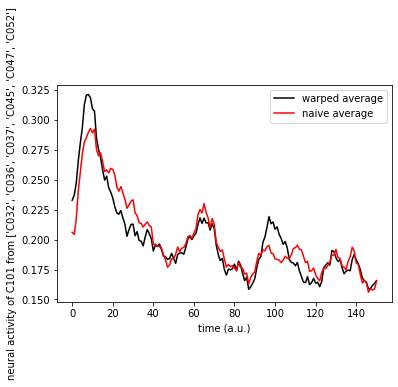

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 762.77it/s]


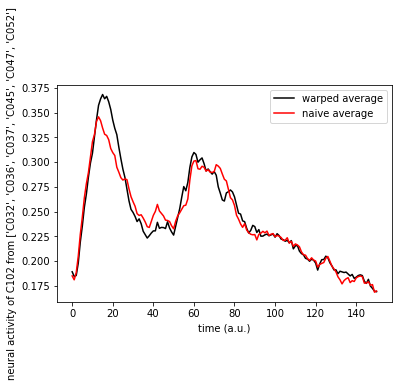

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


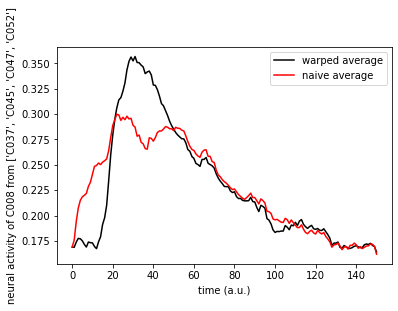

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.77it/s]


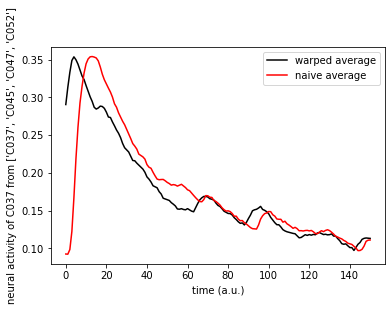

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 821.87it/s]


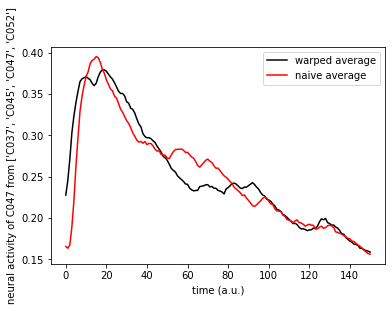

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 783.37it/s]


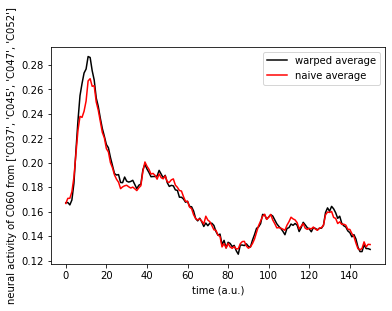

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.53it/s]


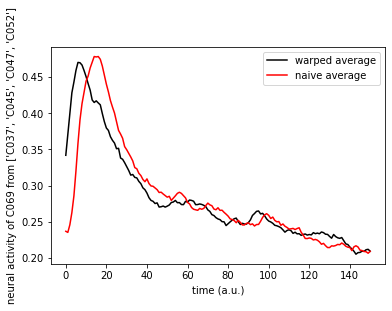

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.59it/s]


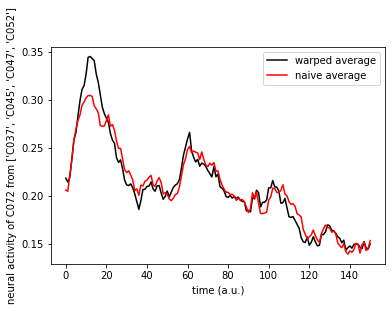

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.33it/s]


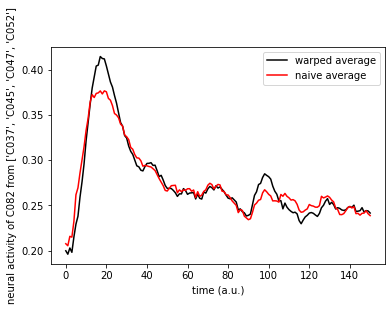

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 795.65it/s]


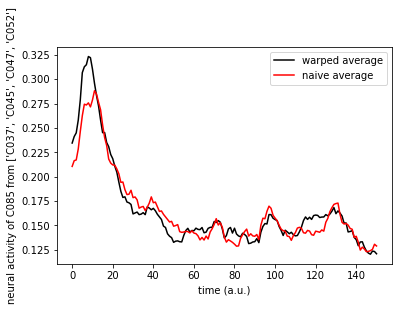

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.31it/s]


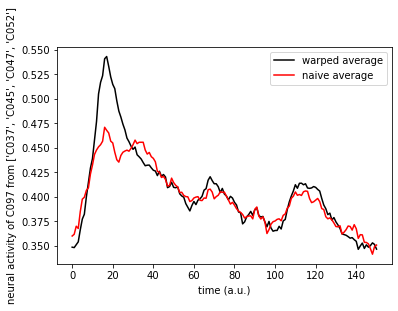

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 808.60it/s]


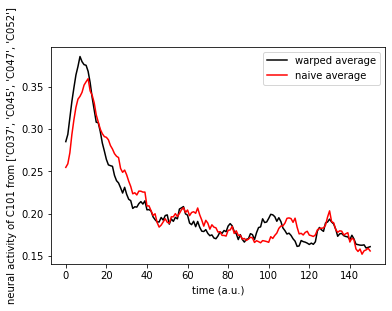

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 764.44it/s]


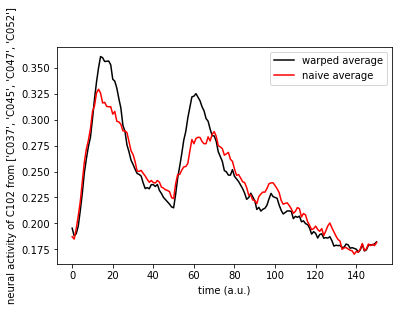

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.35it/s]


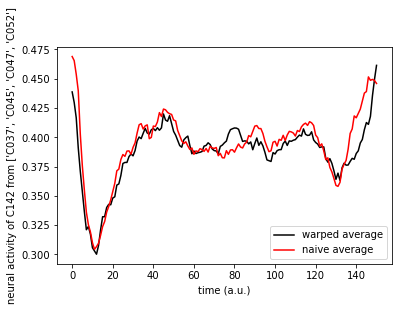

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 486.73it/s]


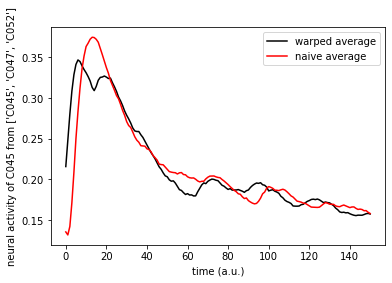

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 511.57it/s]


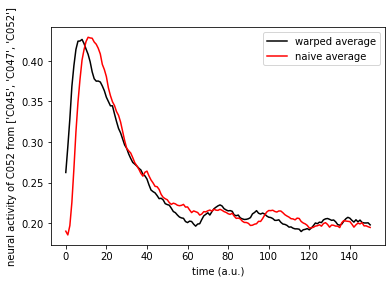

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 533.33it/s]


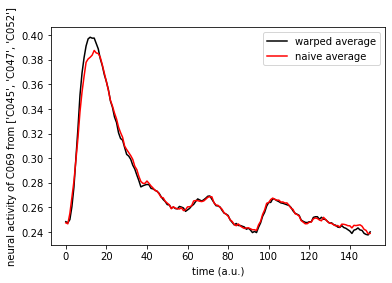

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 537.67it/s]


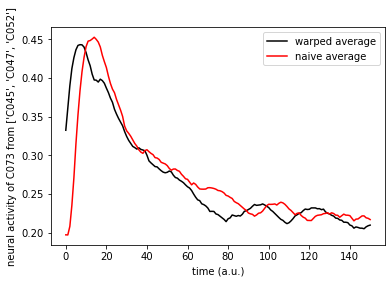

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.31it/s]


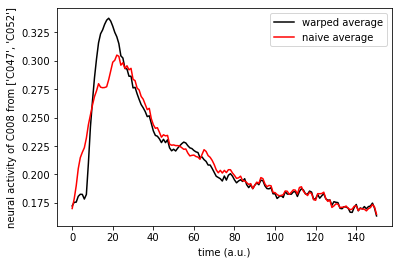

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


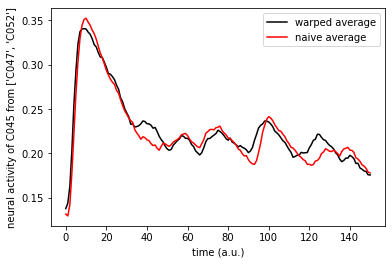

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.26it/s]


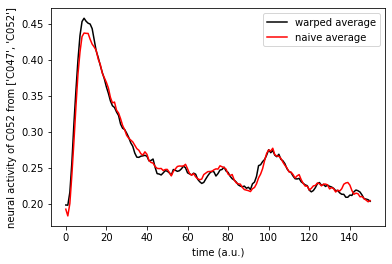

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.25it/s]


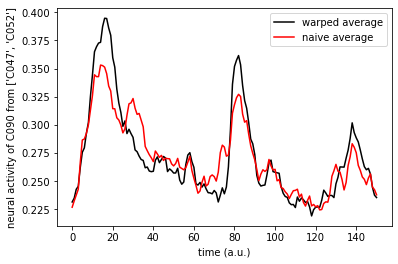

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 754.30it/s]


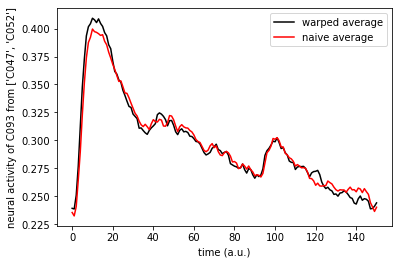

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 849.71it/s]


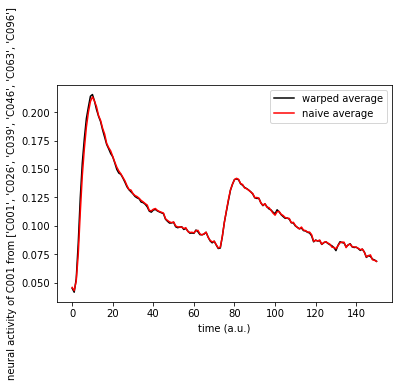

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.57it/s]


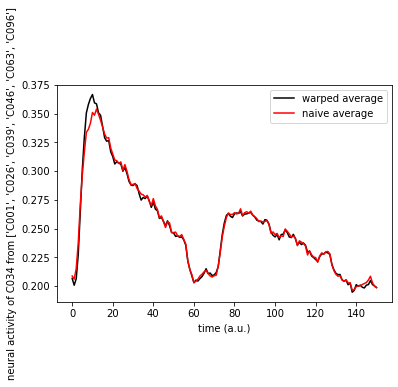

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.34it/s]


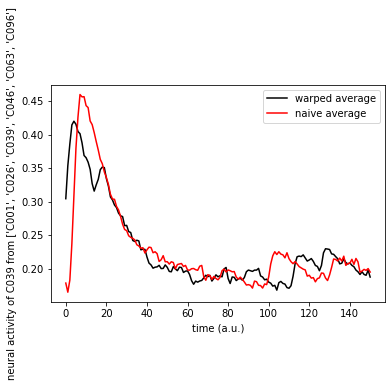

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 879.54it/s]


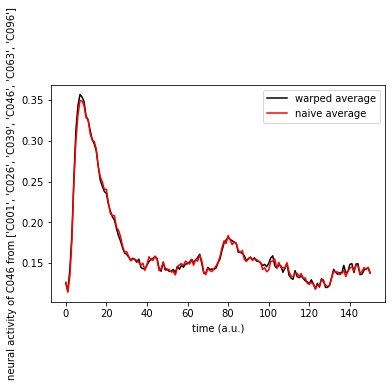

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


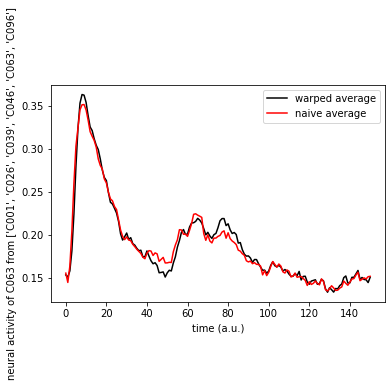

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 895.29it/s]


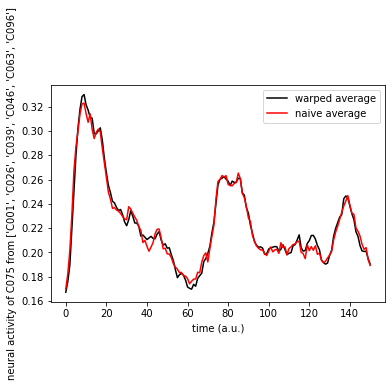

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.92it/s]


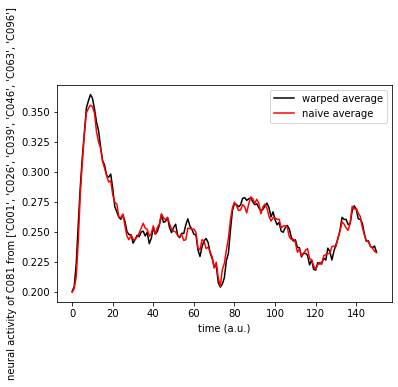

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 835.55it/s]


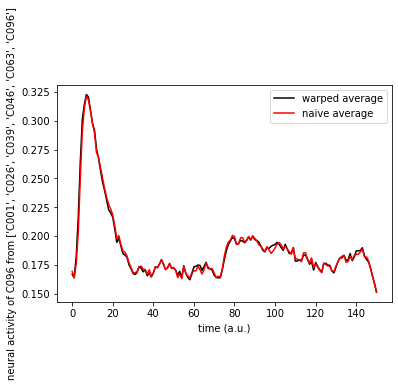

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 850.10it/s]


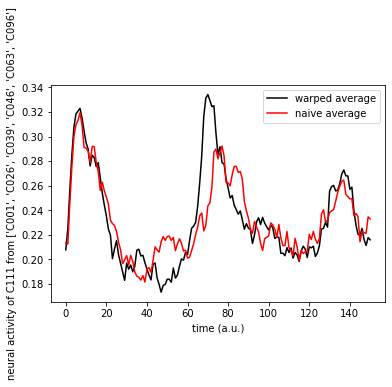

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 835.57it/s]


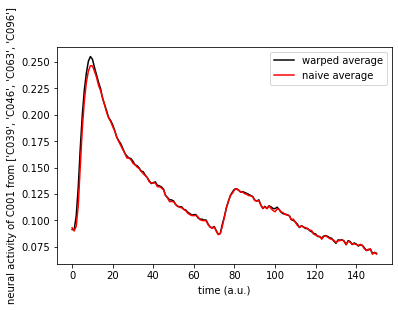

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.59it/s]


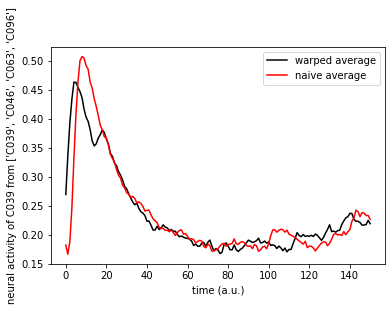

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.26it/s]


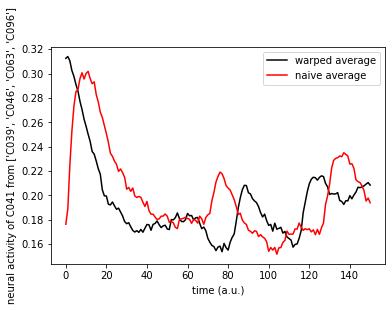

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 759.56it/s]


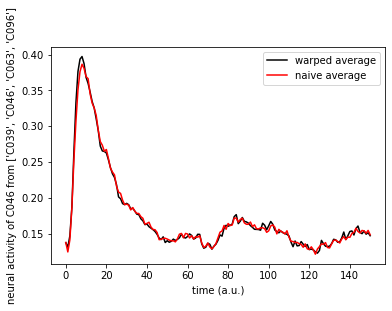

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.41it/s]


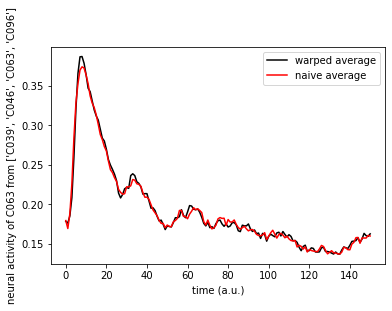

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 748.25it/s]


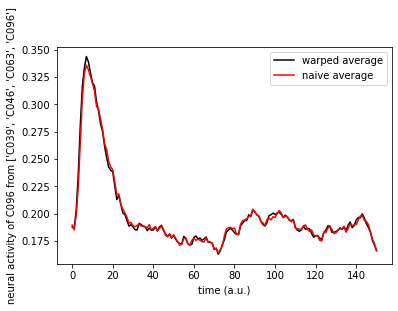

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 589.64it/s]


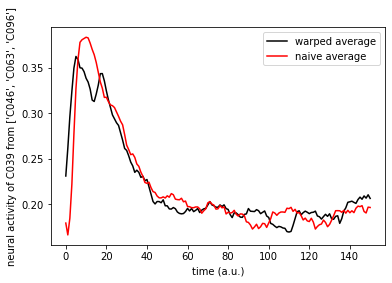

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 569.91it/s]


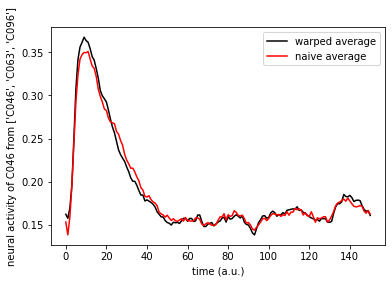

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 582.93it/s]


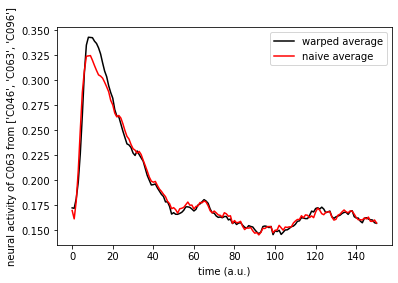

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 590.02it/s]


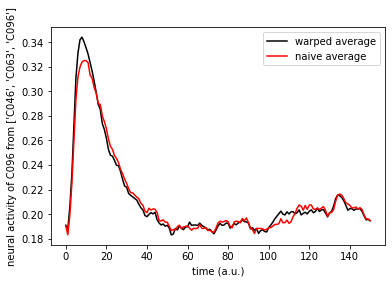

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 596.82it/s]


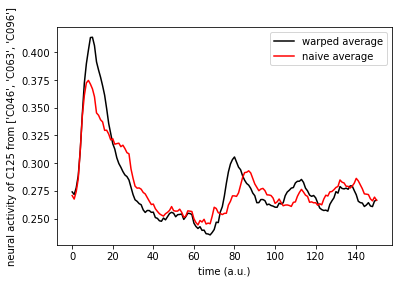

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 795.94it/s]


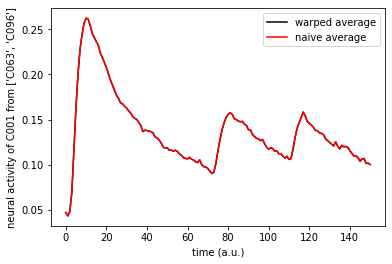

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.54it/s]


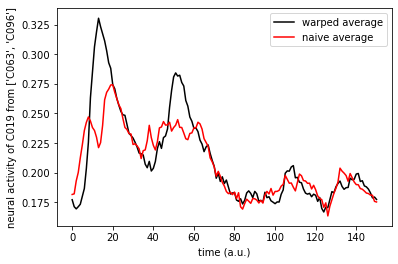

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.87it/s]


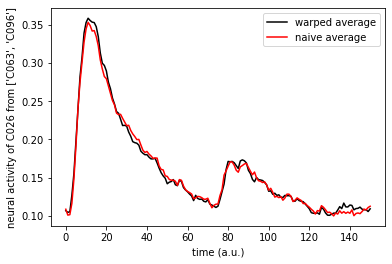

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 879.56it/s]


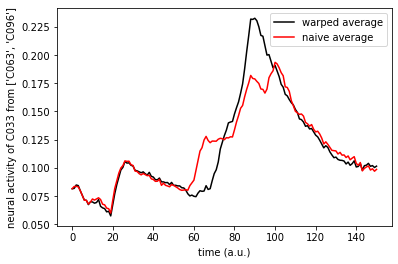

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


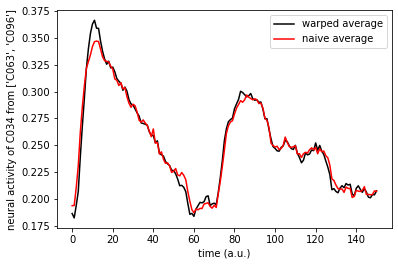

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.93it/s]


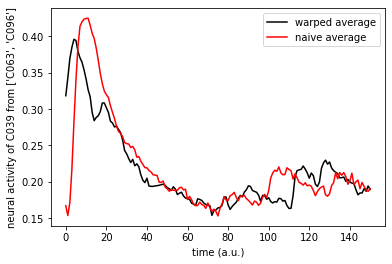

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.61it/s]


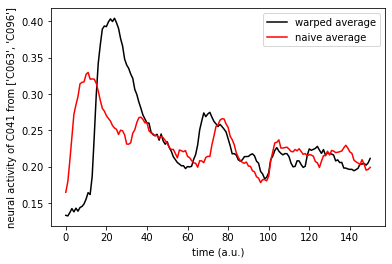

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 689.57it/s]


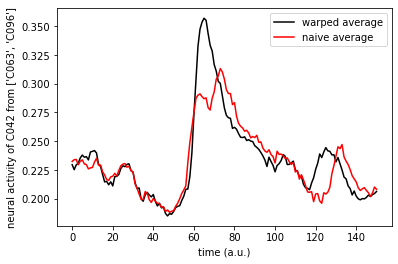

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.54it/s]


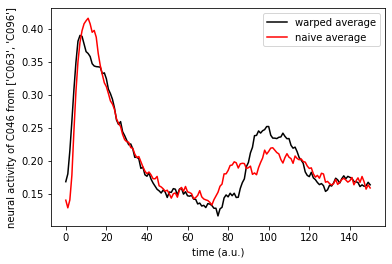

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 911.72it/s]


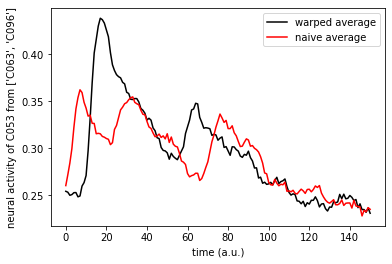

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 850.01it/s]


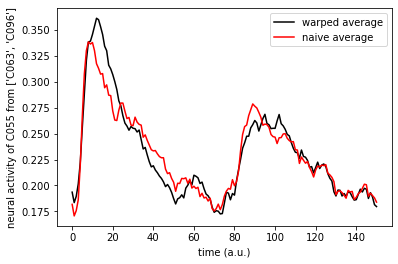

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.90it/s]


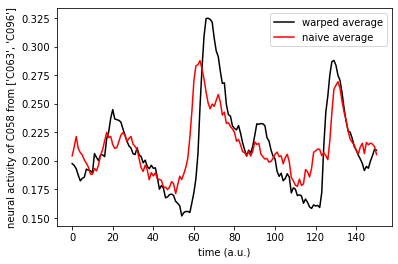

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.57it/s]


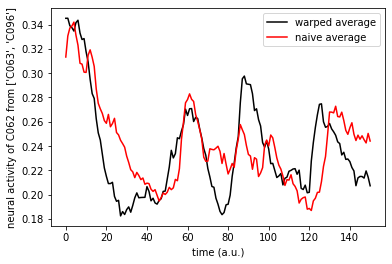

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 785.59it/s]


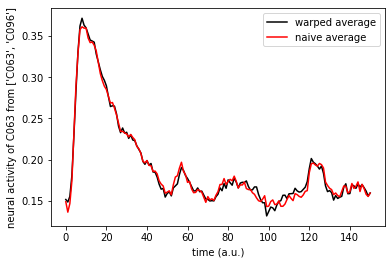

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.52it/s]


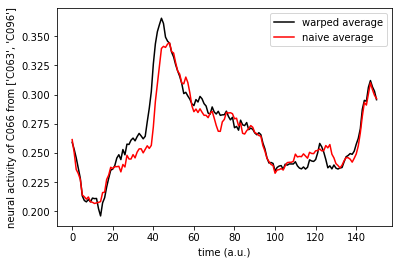

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 770.87it/s]


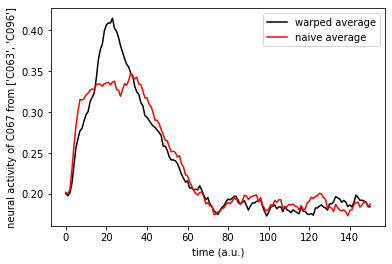

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


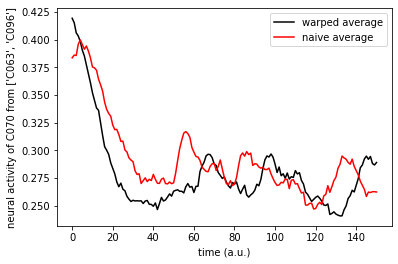

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 809.31it/s]


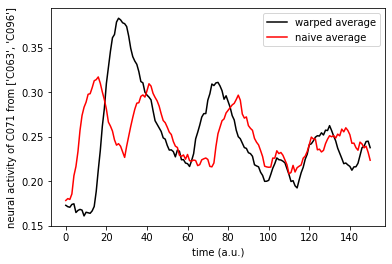

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.56it/s]


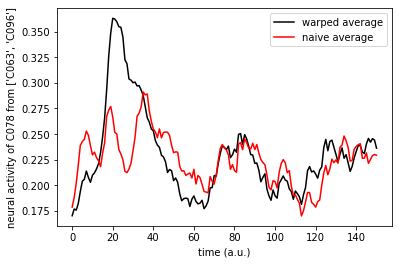

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 808.60it/s]


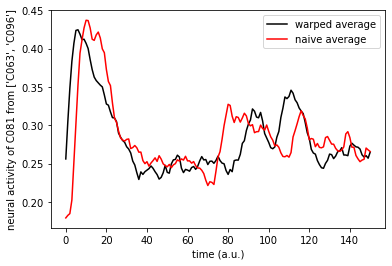

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.86it/s]


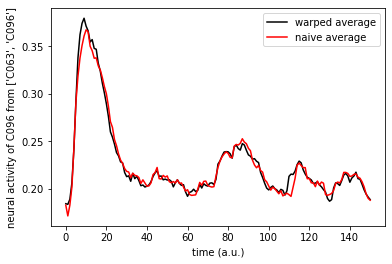

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 795.74it/s]


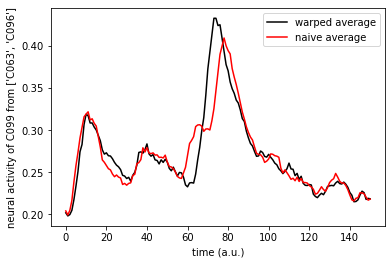

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 821.87it/s]


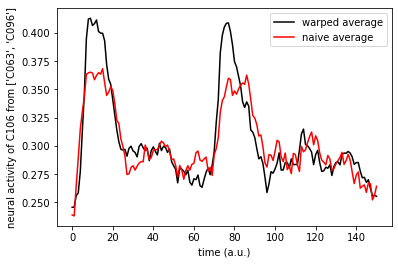

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


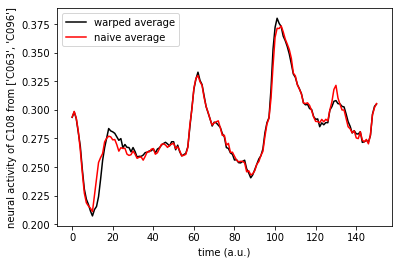

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.60it/s]


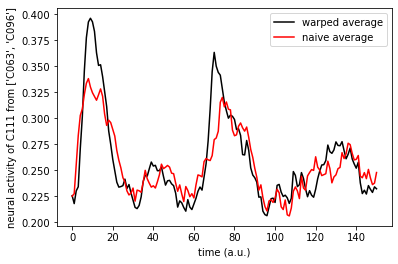

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 821.86it/s]


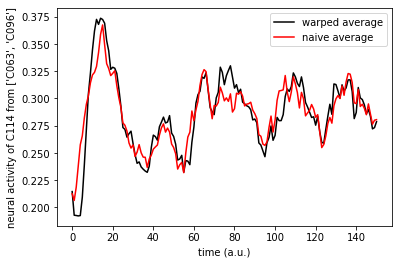

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.87it/s]


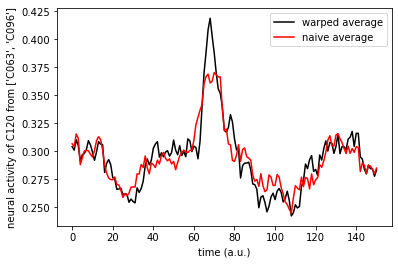

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 636.79it/s]


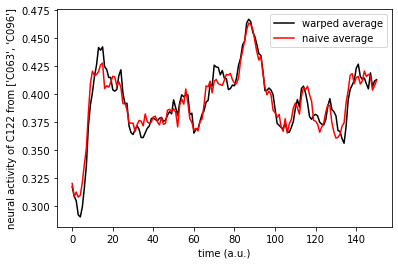

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.86it/s]


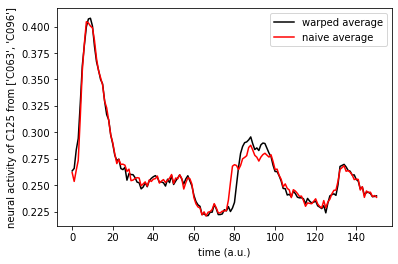

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


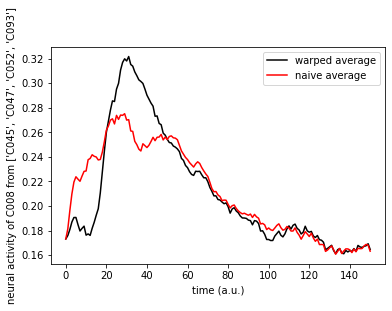

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 748.26it/s]


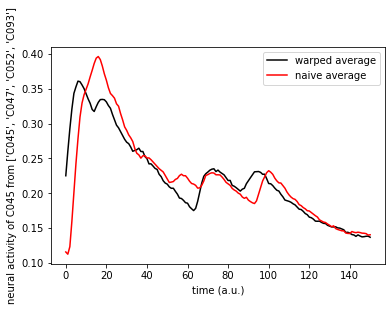

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


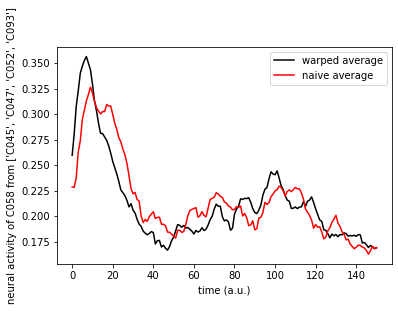

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 726.42it/s]


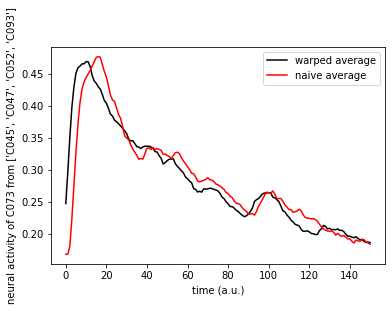

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.56it/s]


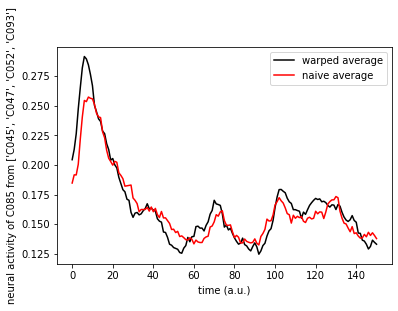

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.25it/s]


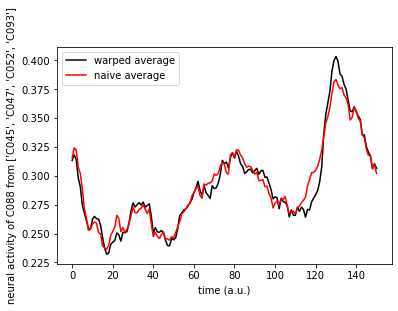

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


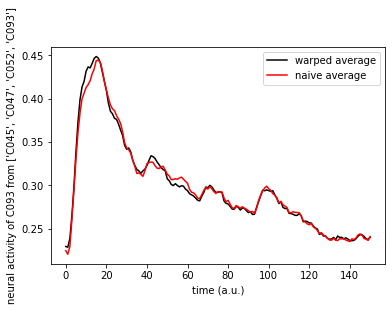

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


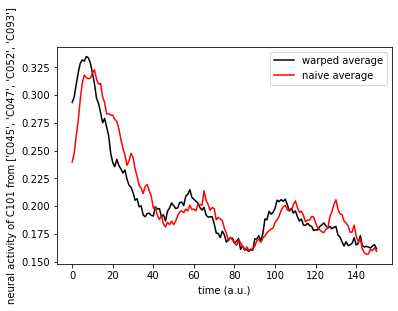

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 576.25it/s]


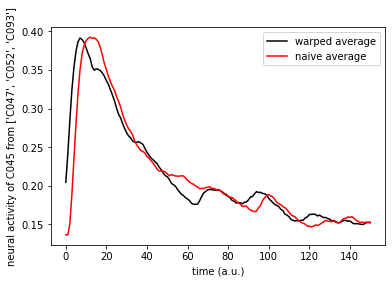

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 582.93it/s]


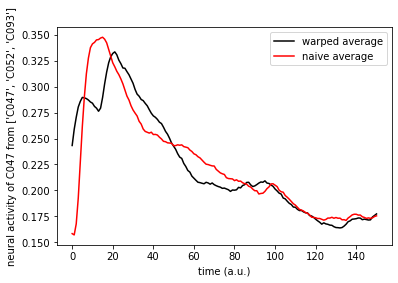

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 576.24it/s]


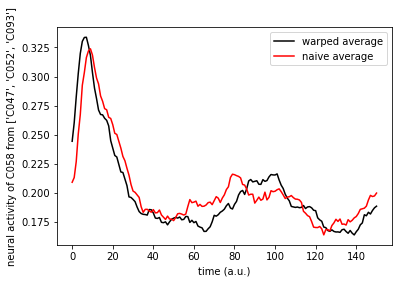

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 569.73it/s]


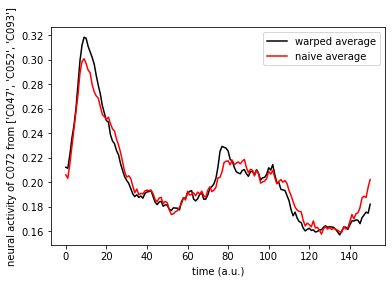

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 524.33it/s]


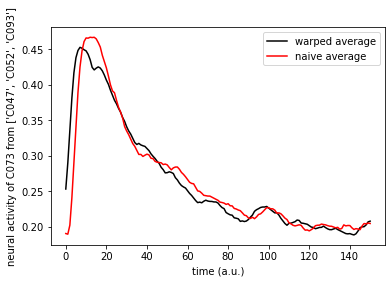

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 539.07it/s]


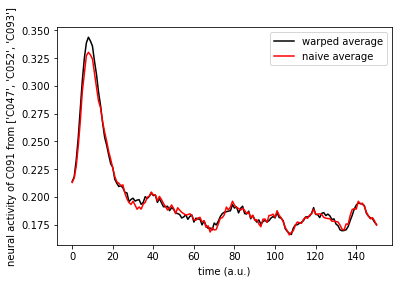

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.37it/s]


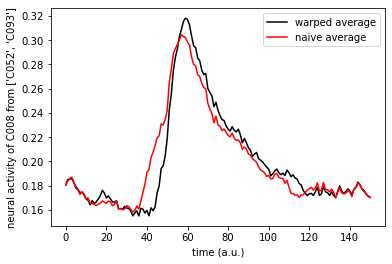

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.61it/s]


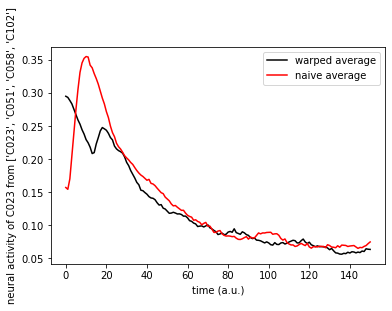

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


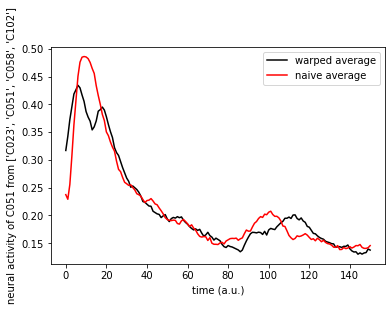

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.46it/s]


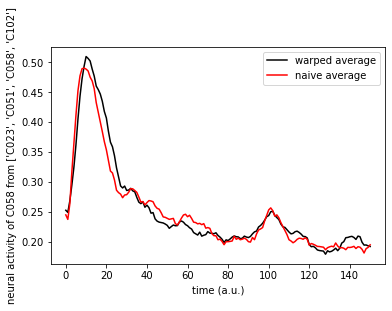

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.27it/s]


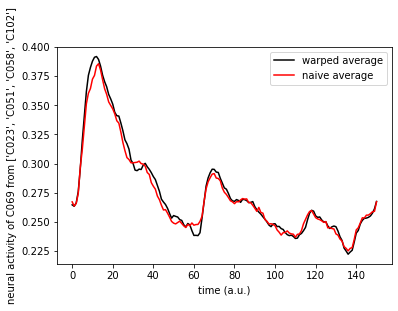

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


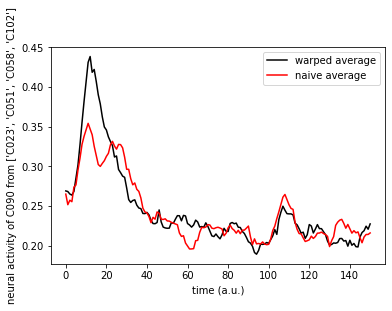

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 486.73it/s]


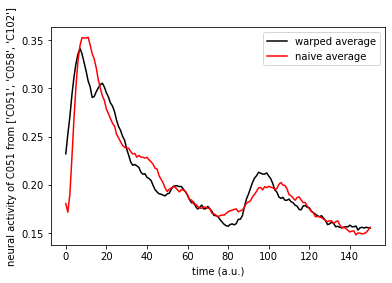

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.27it/s]


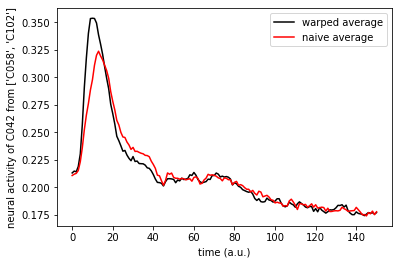

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 710.74it/s]


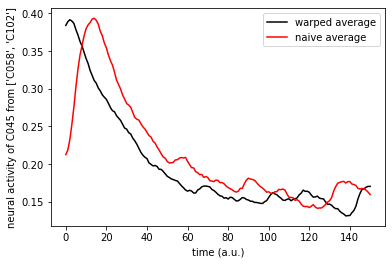

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.21it/s]


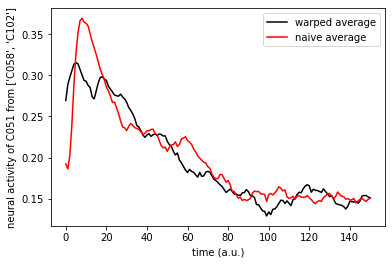

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 644.85it/s]


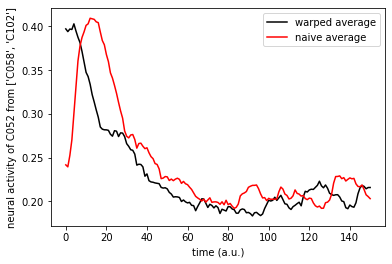

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 687.03it/s]


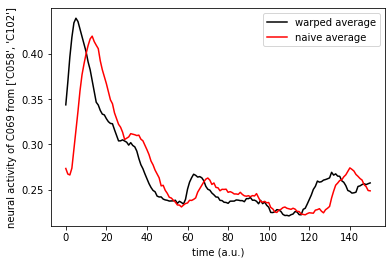

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.48it/s]


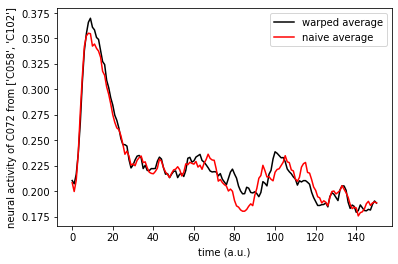

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


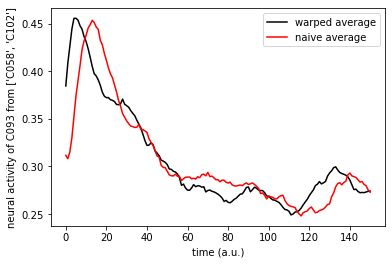

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


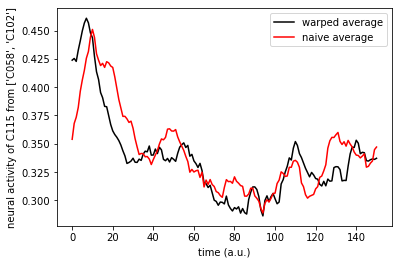

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.09it/s]


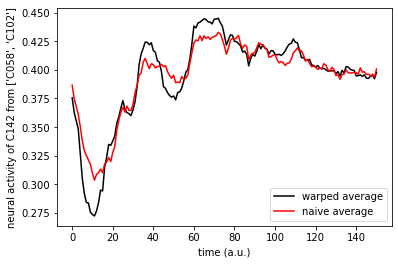

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.83it/s]


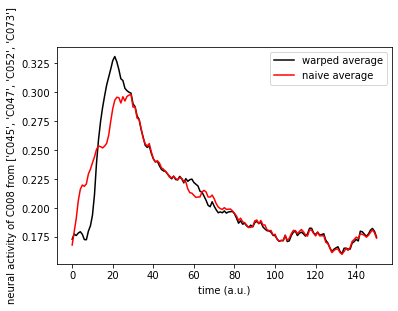

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.56it/s]


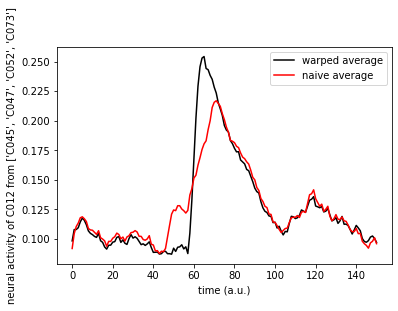

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 783.36it/s]


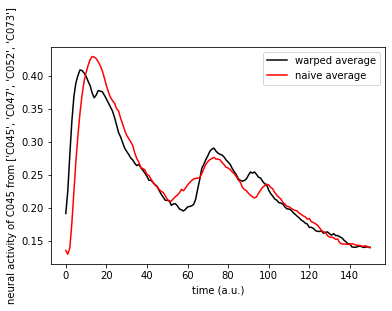

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 771.56it/s]


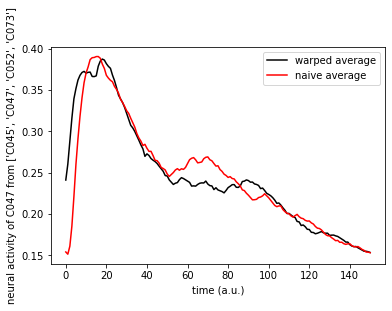

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.59it/s]


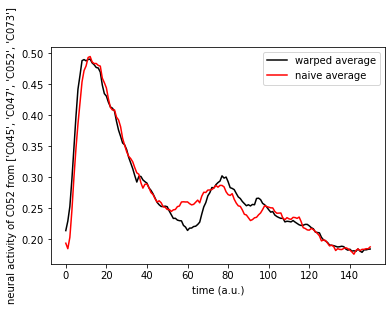

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.89it/s]


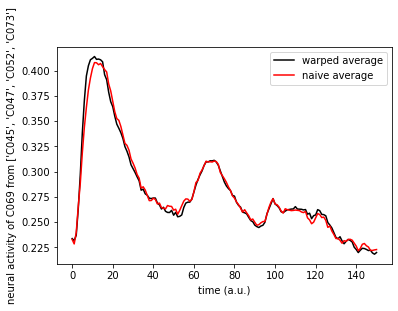

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.88it/s]


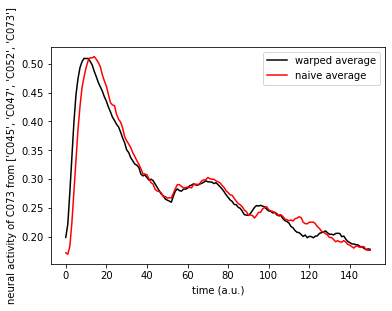

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.68it/s]


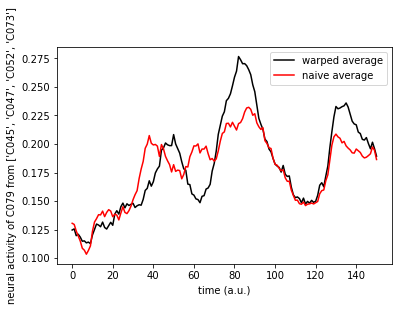

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.89it/s]


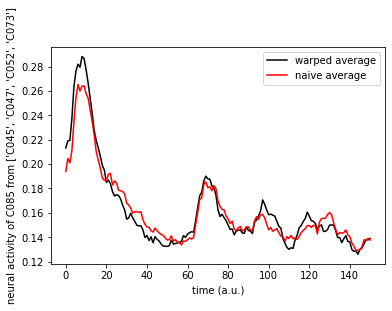

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.68it/s]


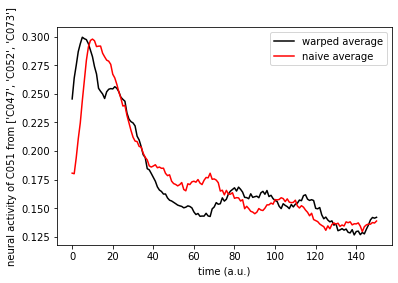

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 472.94it/s]


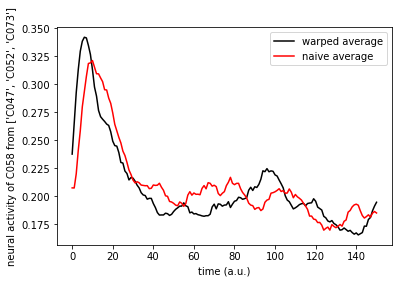

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 550.92it/s]


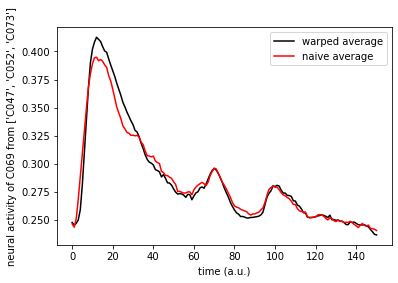

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 557.03it/s]


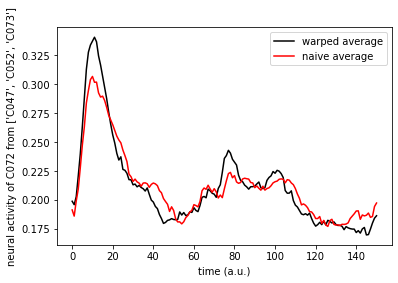

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 544.93it/s]


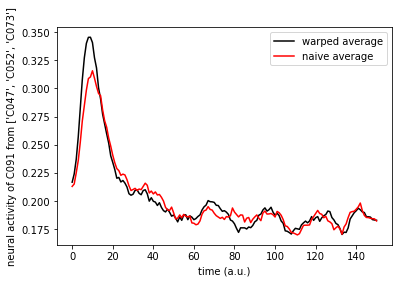

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 490.84it/s]


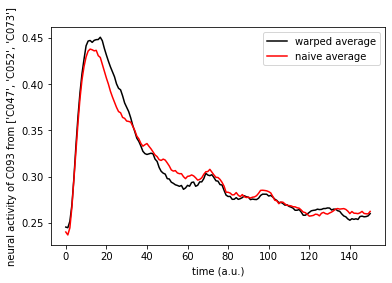

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 557.22it/s]


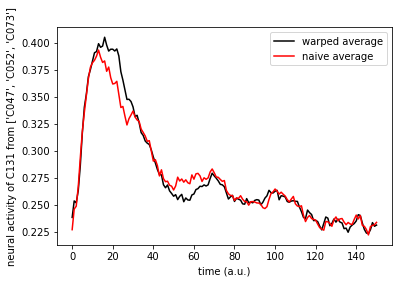

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.78it/s]


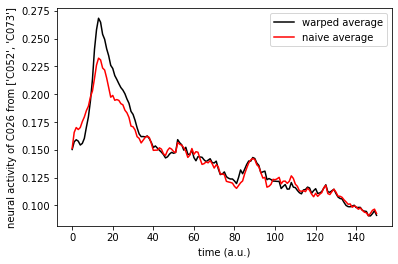

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 642.73it/s]


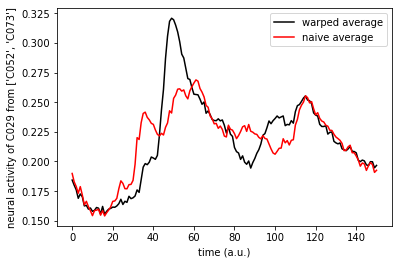

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 706.32it/s]


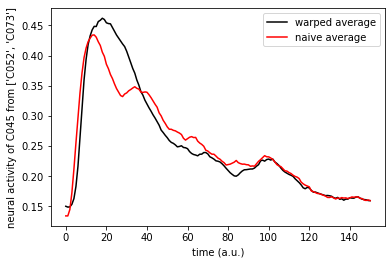

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 792.57it/s]


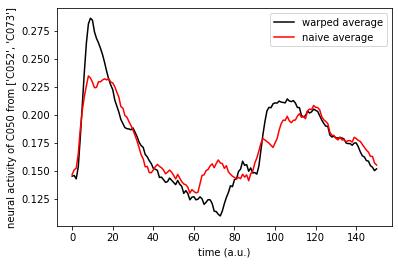

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 800.55it/s]


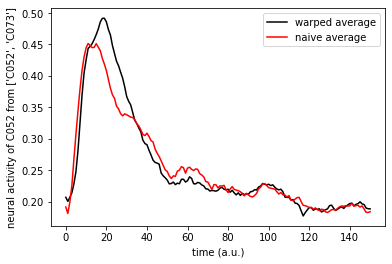

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.31it/s]


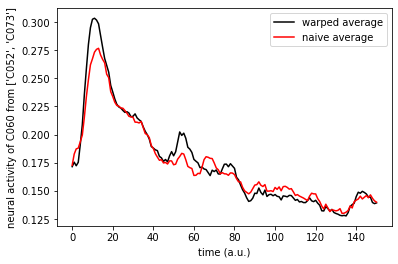

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.18it/s]


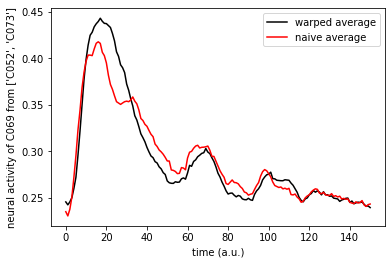

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


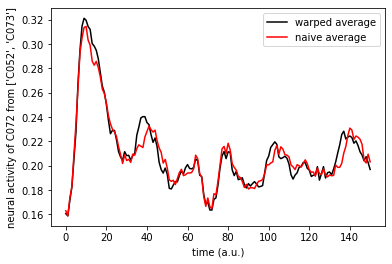

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 594.20it/s]


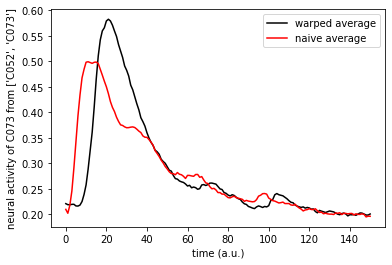

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 696.30it/s]


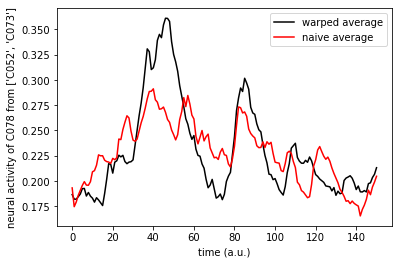

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 618.93it/s]


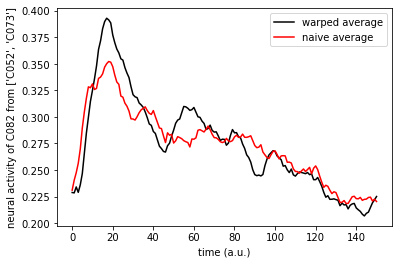

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.25it/s]


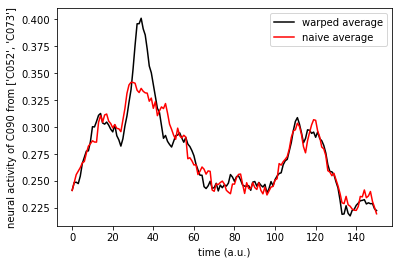

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.13it/s]


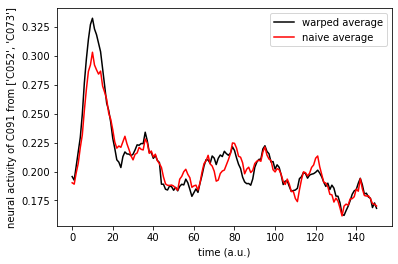

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.71it/s]


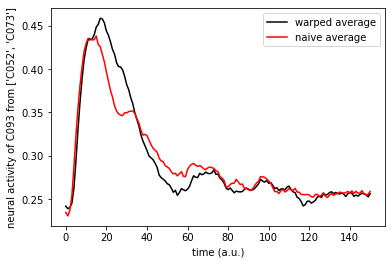

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.25it/s]


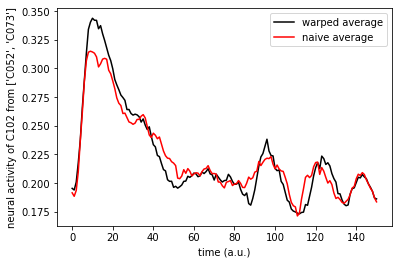

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 696.30it/s]


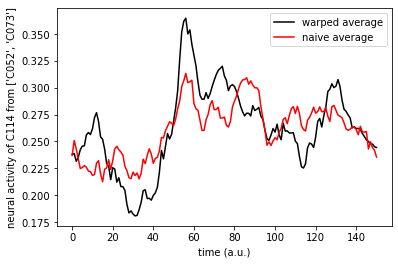

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.21it/s]


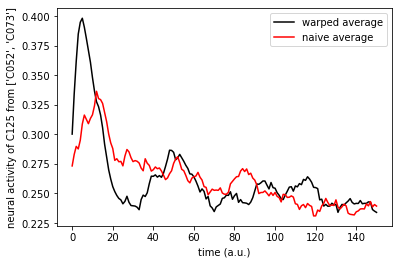

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.46it/s]


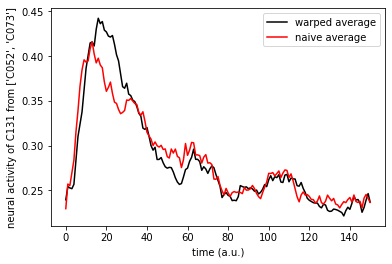

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


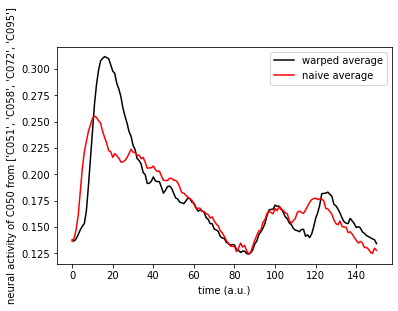

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.29it/s]


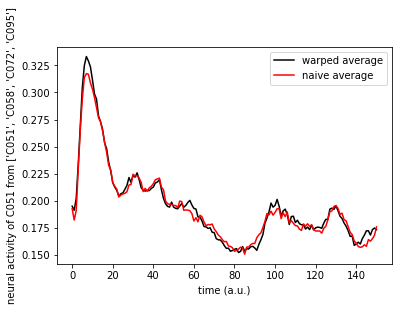

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.27it/s]


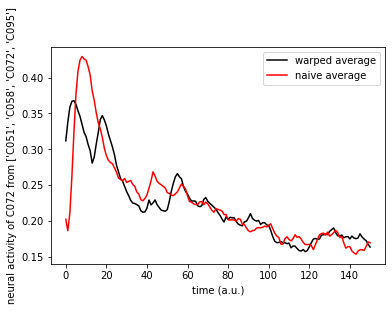

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.76it/s]


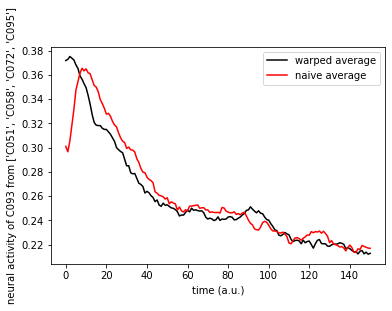

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


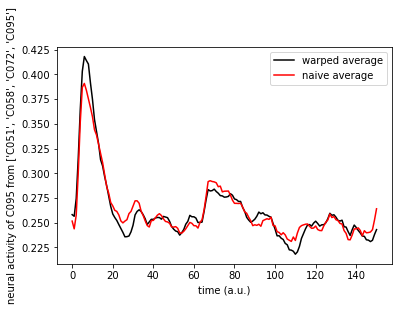

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.47it/s]


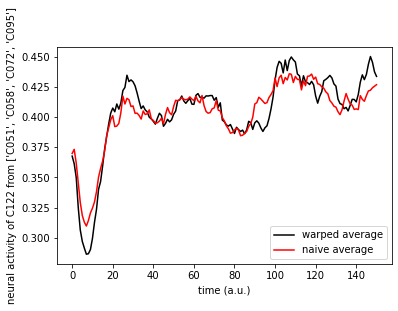

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 391.66it/s]


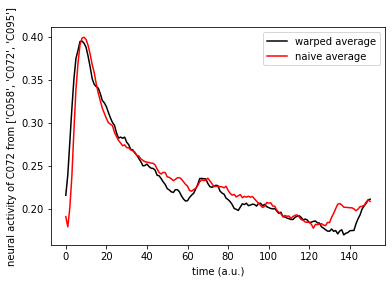

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 634.61it/s]


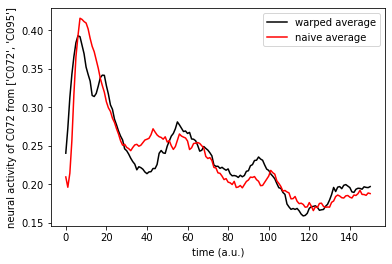

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


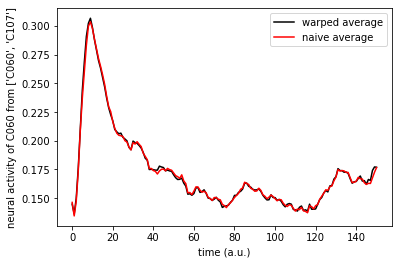

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


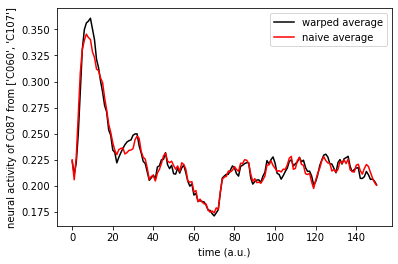

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.01it/s]


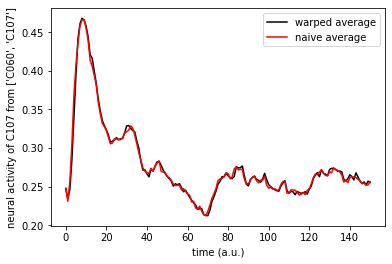

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.29it/s]


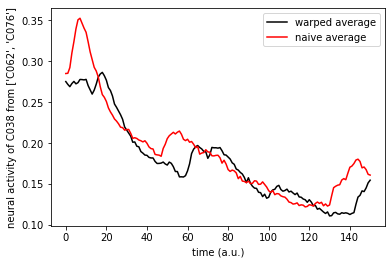

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.28it/s]


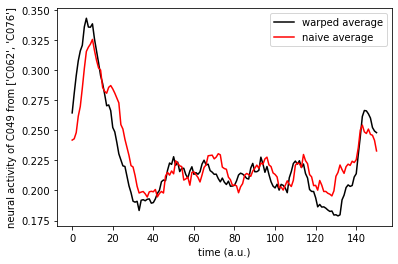

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.59it/s]


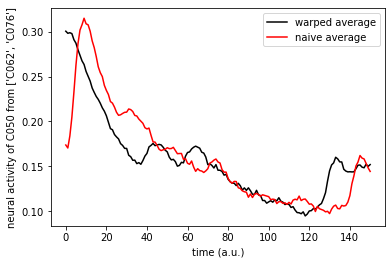

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 783.31it/s]


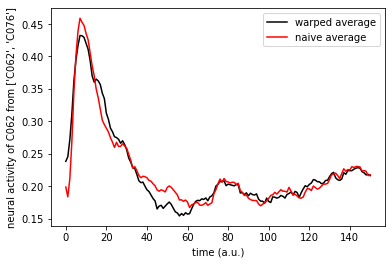

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


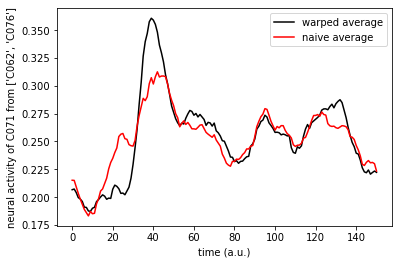

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


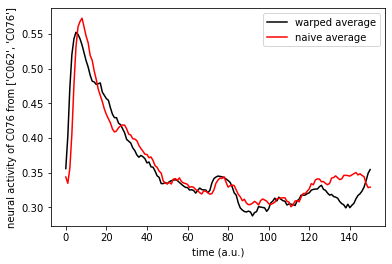

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 501.33it/s]


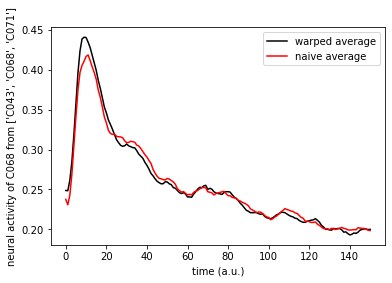

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 455.76it/s]


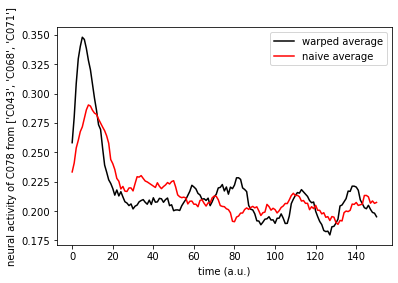

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.10it/s]


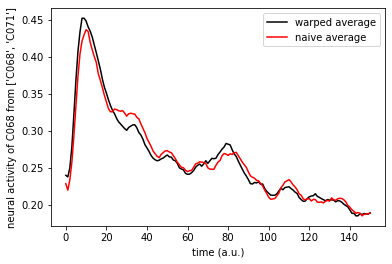

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 632.12it/s]


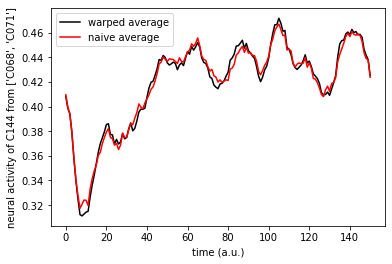

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 498.45it/s]


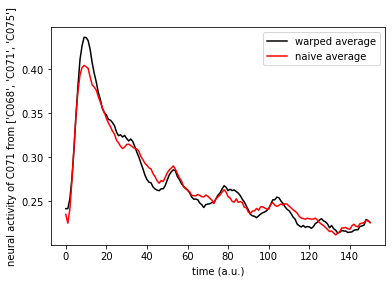

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 660.59it/s]


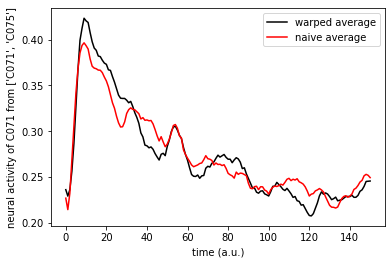

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 606.89it/s]


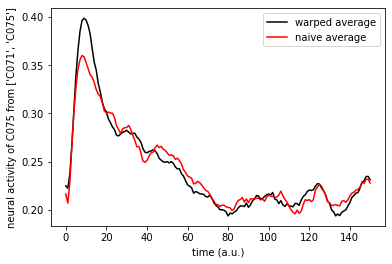

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 423.81it/s]


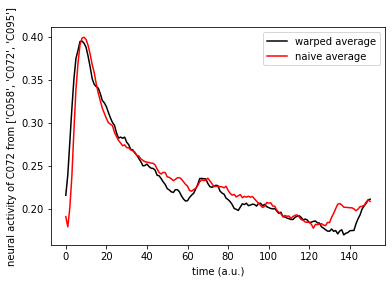

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 588.28it/s]


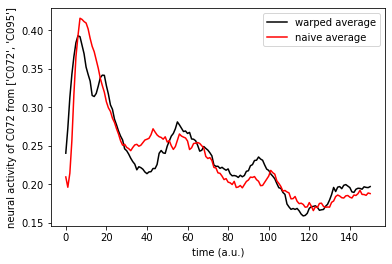

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 615.49it/s]


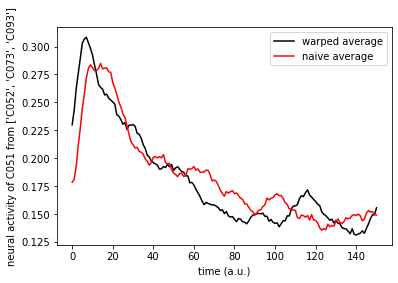

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 593.84it/s]


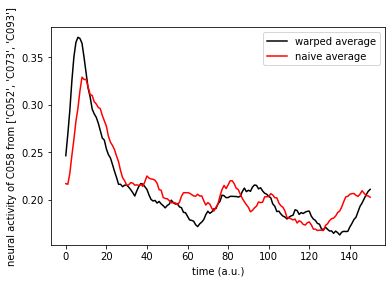

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 613.28it/s]


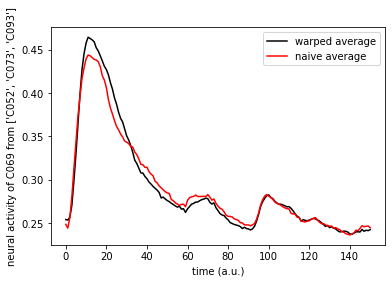

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 598.77it/s]


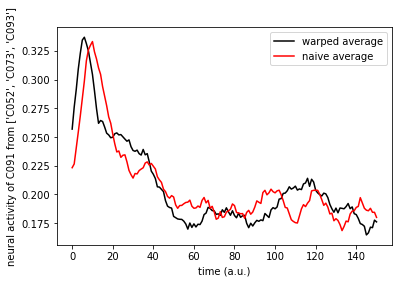

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 570.28it/s]


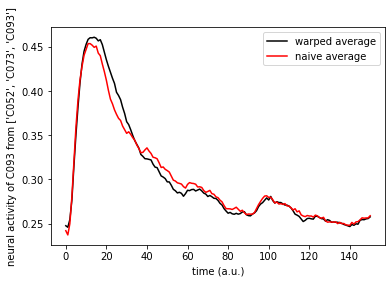

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.27it/s]


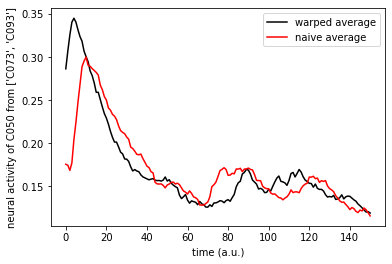

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 812.28it/s]


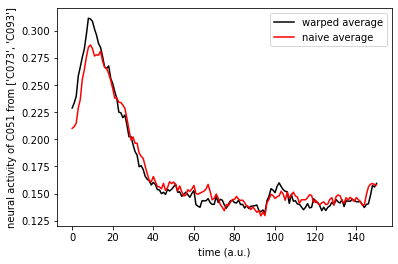

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.12it/s]


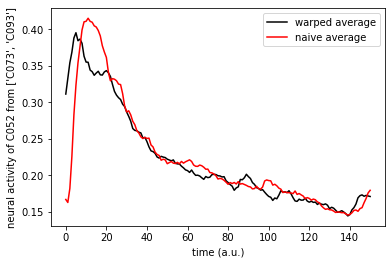

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 714.18it/s]


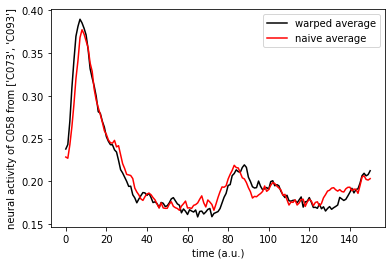

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 712.50it/s]


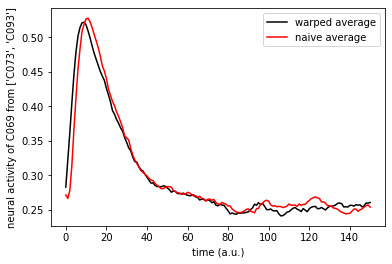

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.75it/s]


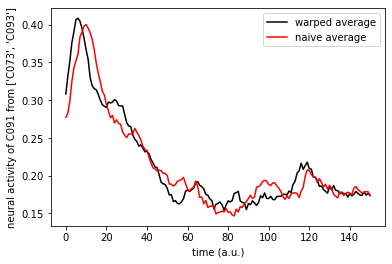

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 721.39it/s]


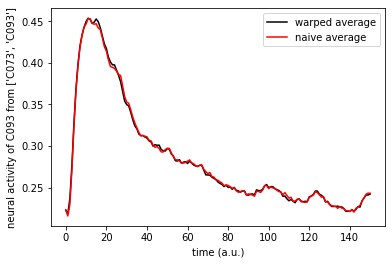

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 685.70it/s]


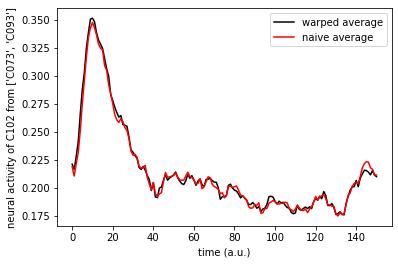

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 754.95it/s]


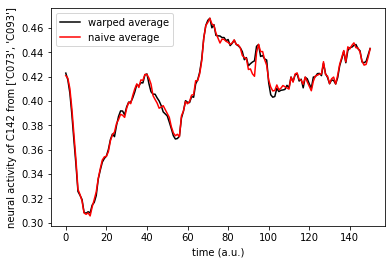

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 714.97it/s]


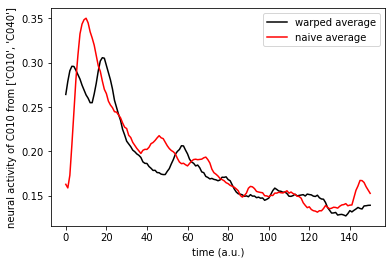

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 707.57it/s]


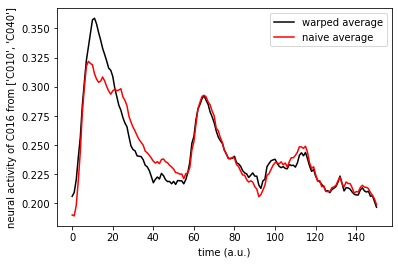

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 726.86it/s]


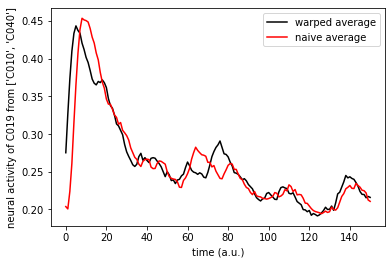

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 691.87it/s]


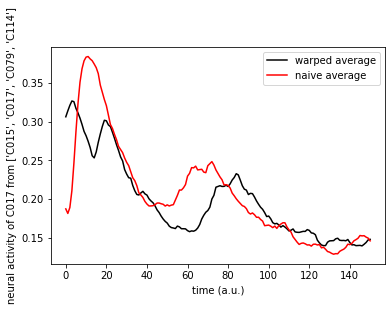

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 720.68it/s]


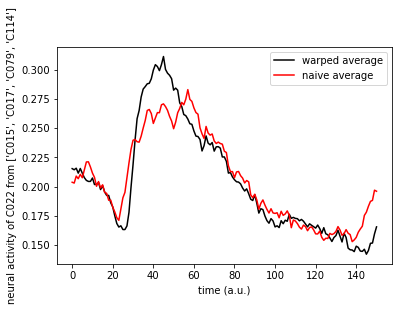

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 666.82it/s]


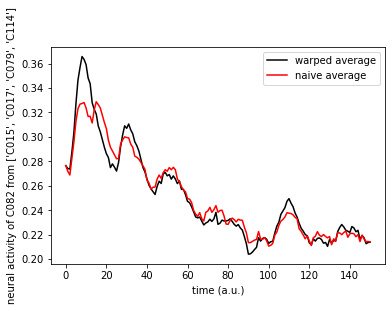

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 692.51it/s]


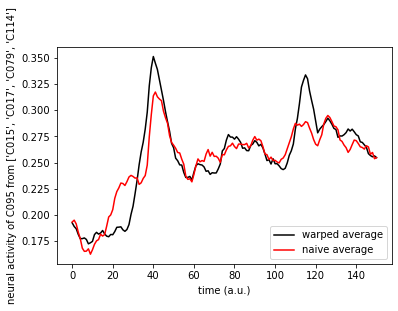

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.18it/s]


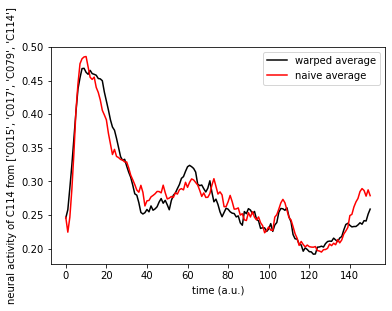

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 482.06it/s]


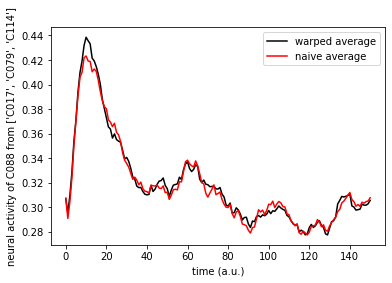

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 507.40it/s]


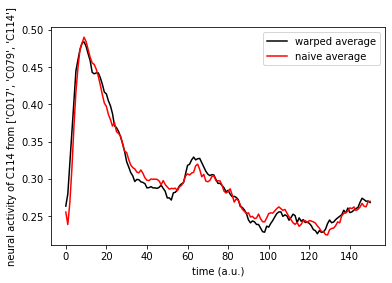

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 734.55it/s]


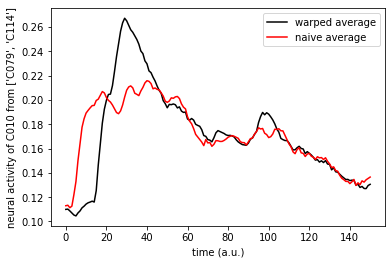

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 799.62it/s]


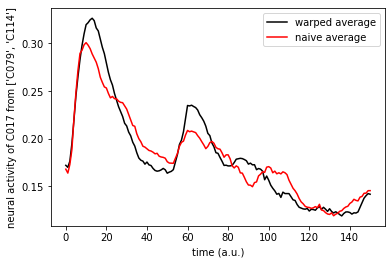

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 684.61it/s]


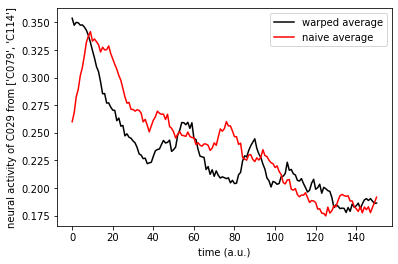

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 755.55it/s]


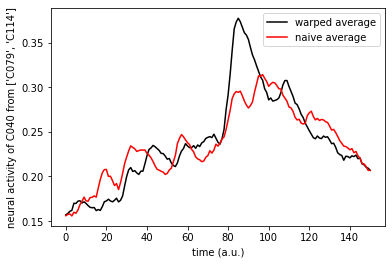

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 693.25it/s]


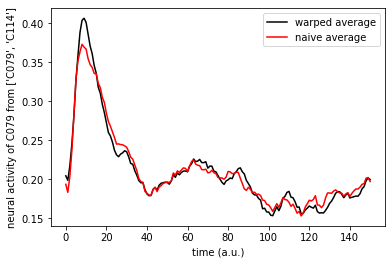

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 694.79it/s]


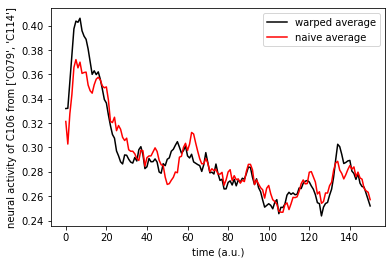

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 911.36it/s]


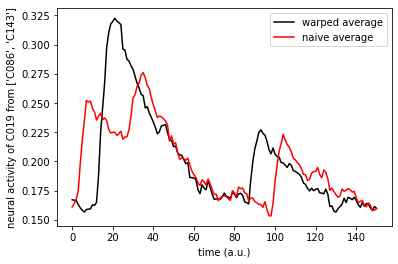

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 923.27it/s]


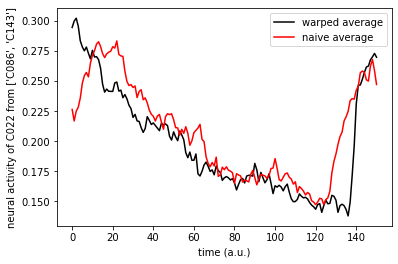

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 810.93it/s]


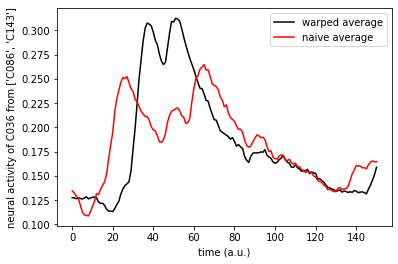

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 830.36it/s]


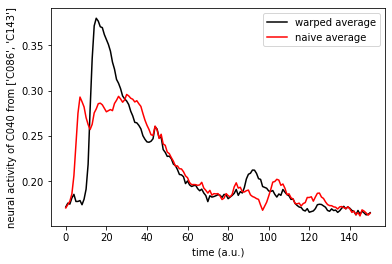

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 780.68it/s]


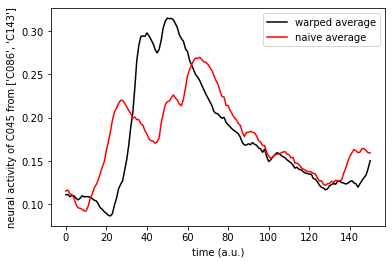

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 853.81it/s]


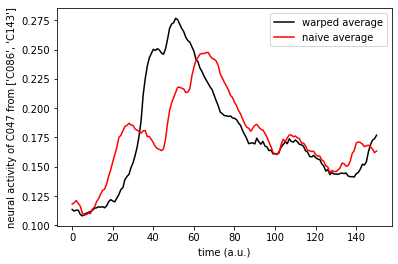

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 793.91it/s]


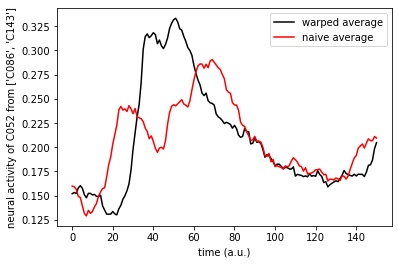

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 829.17it/s]


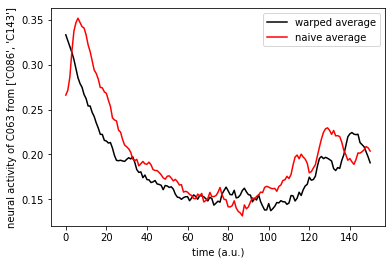

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 824.83it/s]


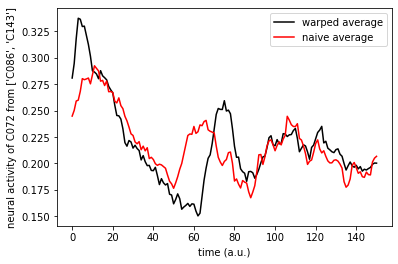

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 801.31it/s]


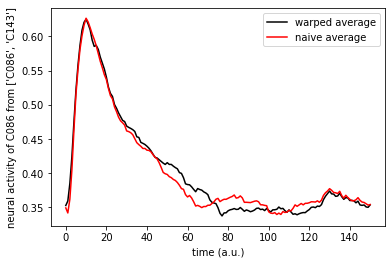

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 957.68it/s]


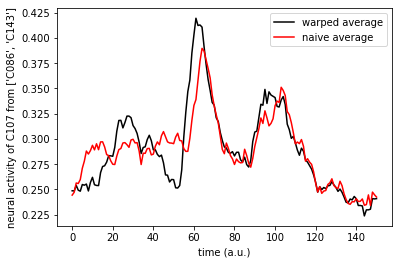

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 894.88it/s]


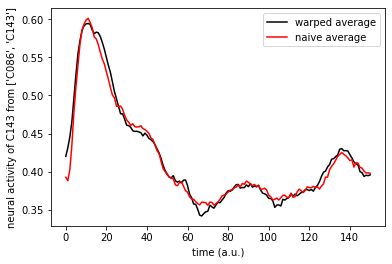

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 586.50it/s]


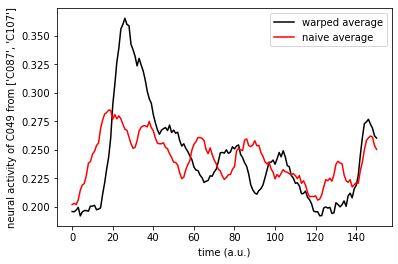

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 579.93it/s]


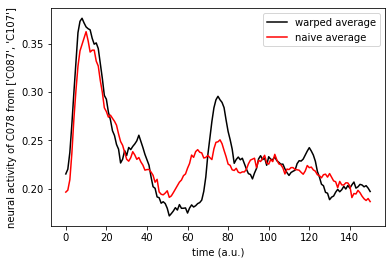

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 554.72it/s]


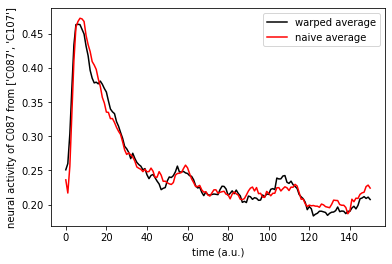

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 614.83it/s]


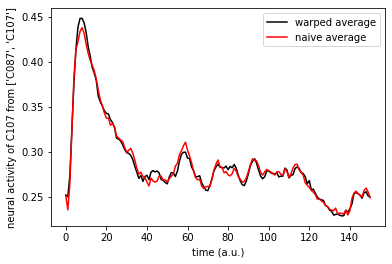

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 760.42it/s]


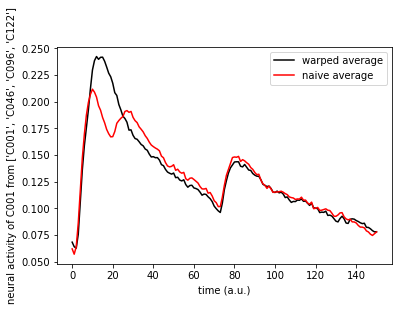

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 869.88it/s]


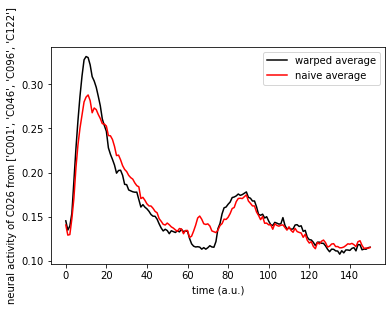

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 822.40it/s]


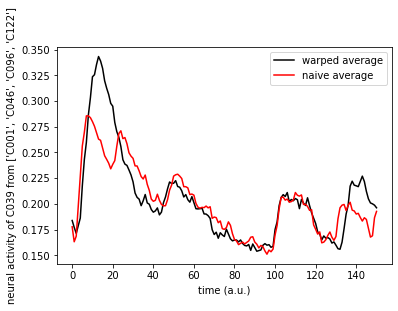

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 809.26it/s]


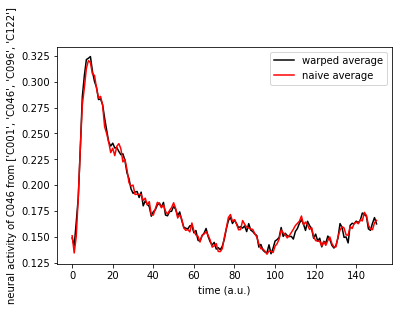

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 790.32it/s]


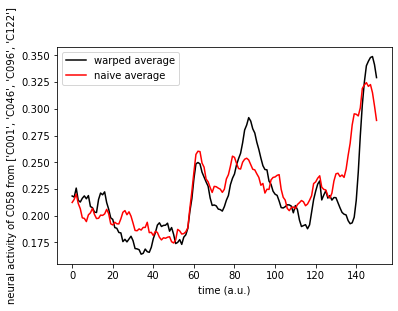

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 761.18it/s]


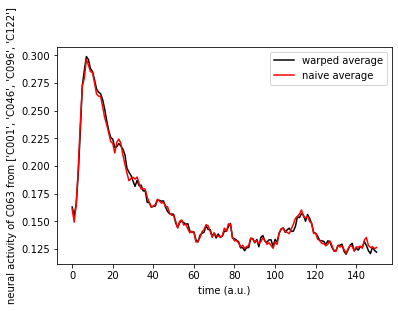

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 817.25it/s]


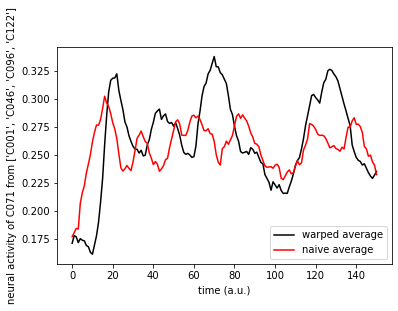

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 819.50it/s]


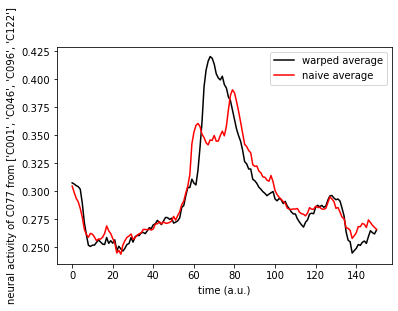

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 800.20it/s]


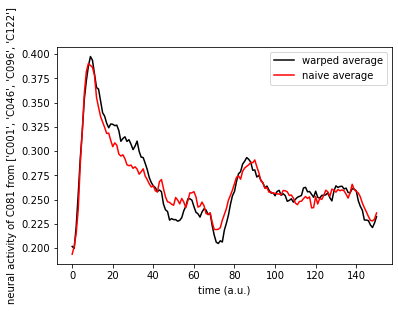

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 764.10it/s]


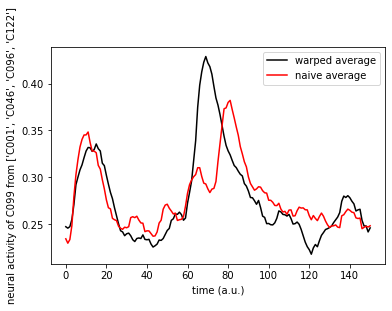

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 729.33it/s]


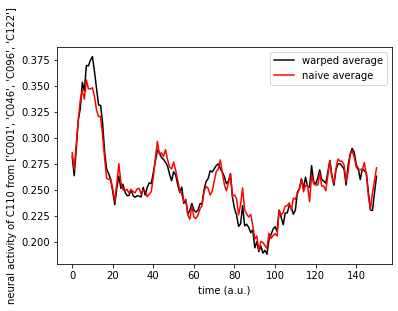

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 740.47it/s]


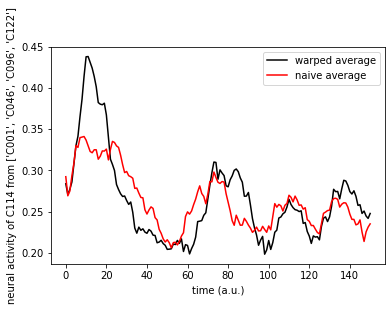

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 840.31it/s]


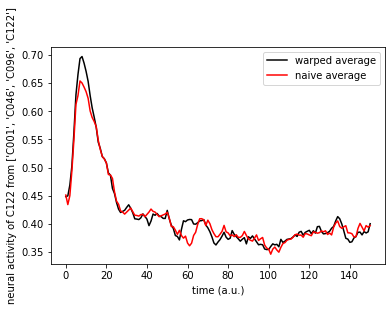

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 775.72it/s]


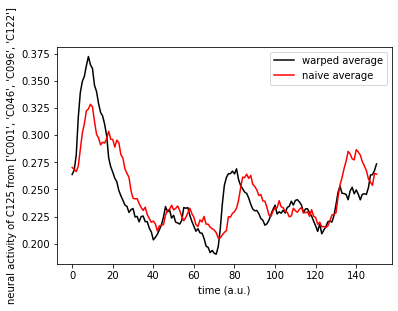

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 743.07it/s]


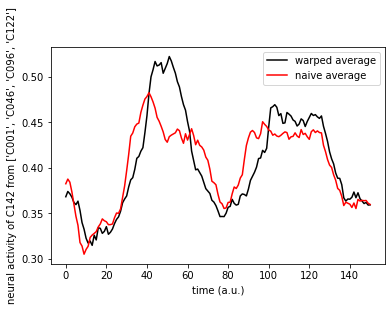

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 578.29it/s]


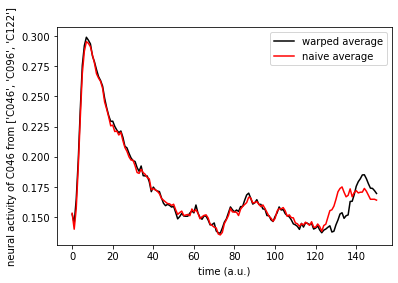

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 601.10it/s]


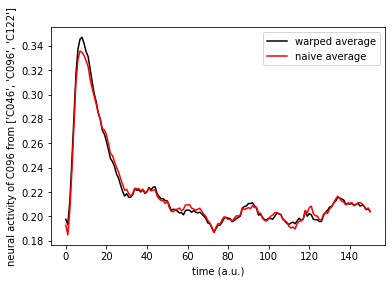

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 677.53it/s]


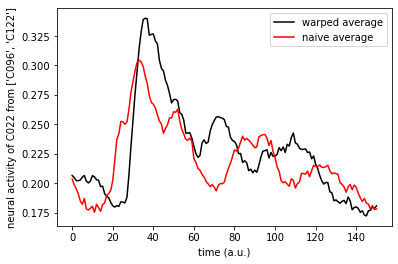

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 644.56it/s]


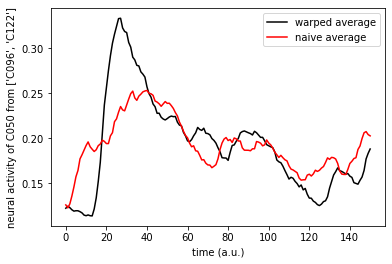

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 657.65it/s]


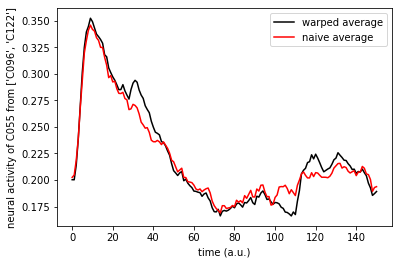

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 693.65it/s]


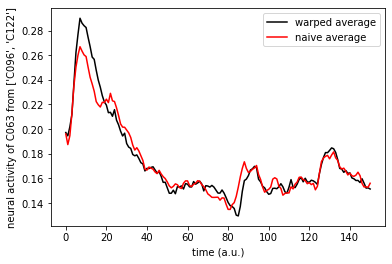

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 724.99it/s]


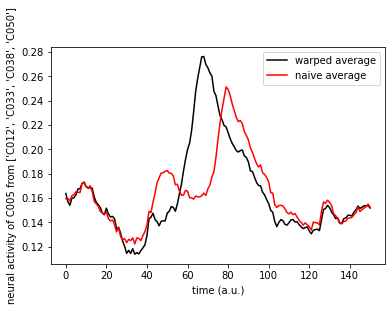

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 700.46it/s]


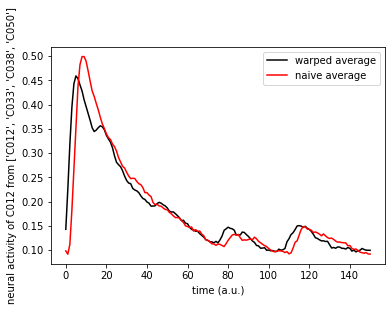

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 800.20it/s]


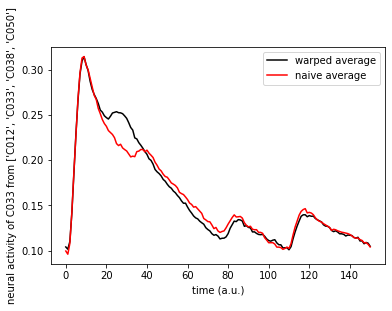

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 695.27it/s]


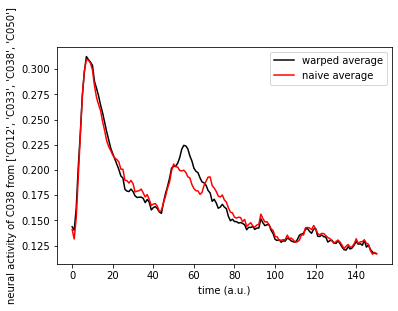

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 724.04it/s]


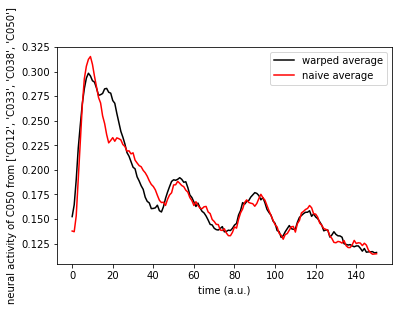

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 673.68it/s]


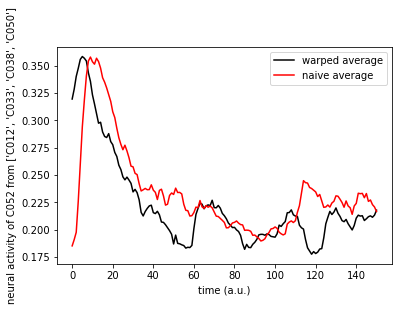

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 758.88it/s]


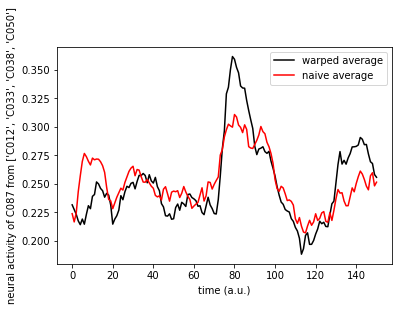

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 699.10it/s]


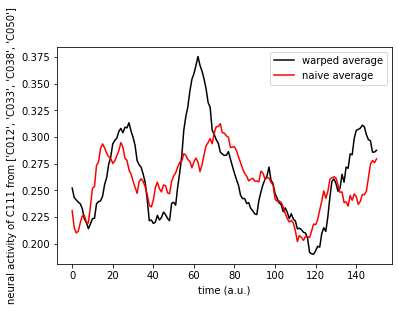

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 675.95it/s]


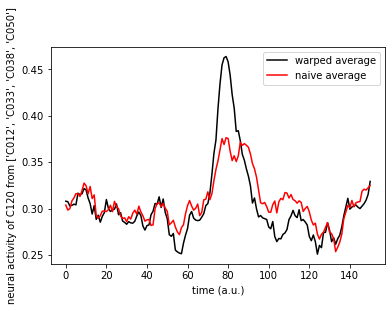

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 512.43it/s]


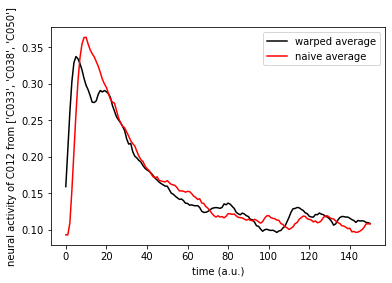

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 507.39it/s]


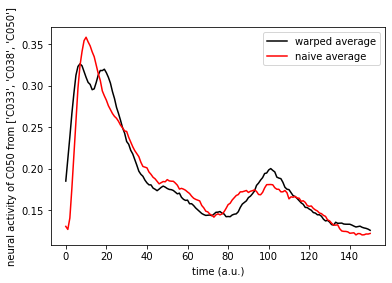

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 649.40it/s]


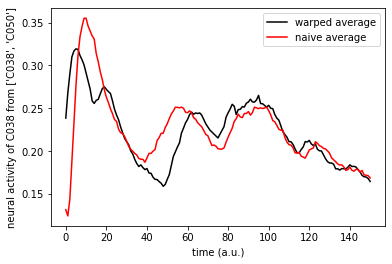

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 631.76it/s]


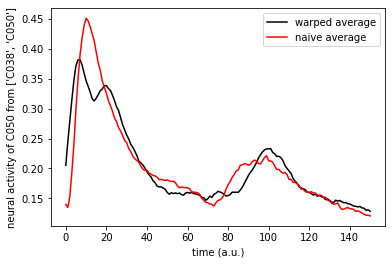

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 703.91it/s]


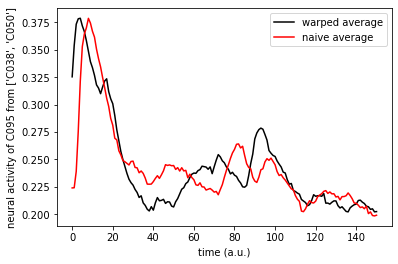

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 574.92it/s]


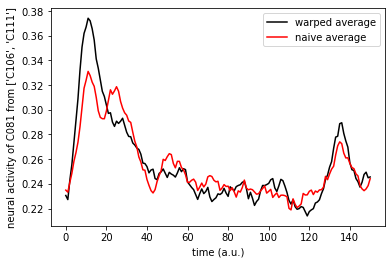

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 671.52it/s]


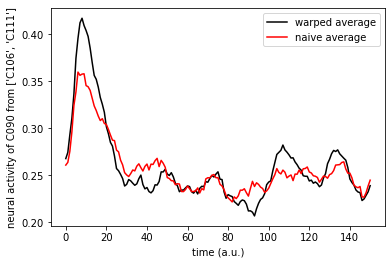

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 606.47it/s]


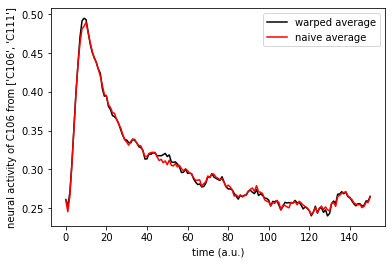

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 604.28it/s]


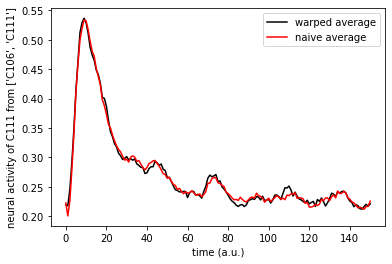

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 594.91it/s]


In [6]:
patterns = wrapped.findPatterns([wrapped.getAft(partialGroups[i]) for i in range(len(partialGroups))], partialGroups)

In [7]:
patterns

{'C001 C026 C046 C096': [(['C019', 'C039', 'C114'], [13]),
  (['C026', 'C046', 'C055', 'C063', 'C111', 'C125'], [9])],
 'C046 C096': [(['C026', 'C039', 'C114'], [13])],
 'C037 C070': [(['C037', 'C052', 'C090', 'C102'], [13]),
  (['C028', 'C032', 'C036', 'C062', 'C070', 'C115'], [9]),
  (['C049', 'C080', 'C095'], [86])],
 'C018 C022': [(['C041', 'C075', 'C078', 'C109', 'C110'], [13]),
  (['C009', 'C018', 'C022', 'C111'], [9]),
  (['C029', 'C036', 'C045', 'C052', 'C069', 'C093'], [24])],
 'C039 C046': [(['C026', 'C090', 'C125'], [13])],
 'C013 C028 C032 C036 C037 C101': [(['C037', 'C082', 'C125'], [13]),
  (['C012', 'C028', 'C036', 'C107', 'C115'], [9])],
 'C028 C032 C036 C037 C101': [(['C051', 'C052', 'C082', 'C102'], [13]),
  (['C028', 'C036', 'C115'], [9]),
  (['C038', 'C072', 'C073', 'C095'], [79])],
 'C028 C032 C036 C037 C045 C052': [(['C037', 'C072', 'C082', 'C090', 'C102'],
   [13])],
 'C036 C037 C045 C052': [(['C037', 'C047', 'C090', 'C107', 'C131'], [13])],
 'C045 C052': [(['C04

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.09it/s]


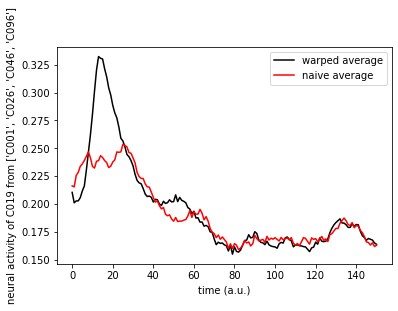

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.29it/s]


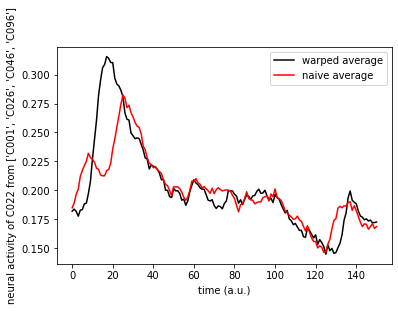

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


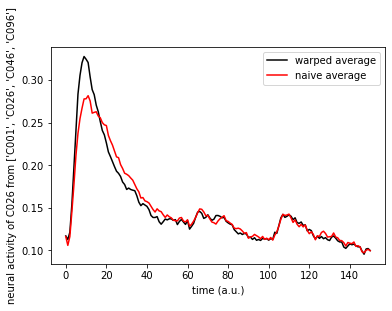

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 642.72it/s]


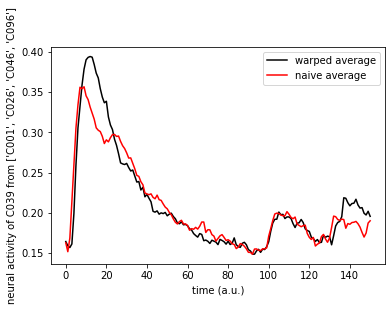

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 795.77it/s]


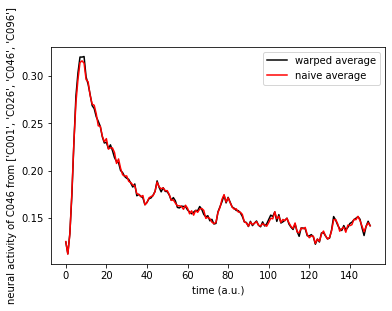

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


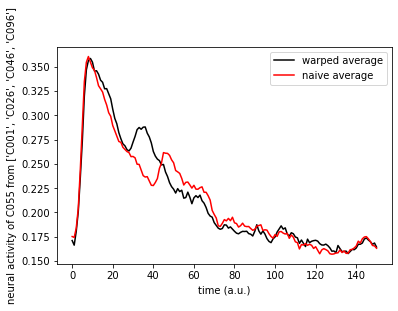

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.26it/s]


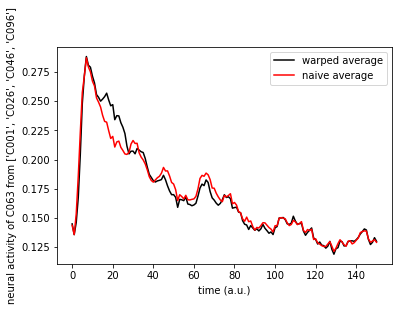

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.76it/s]


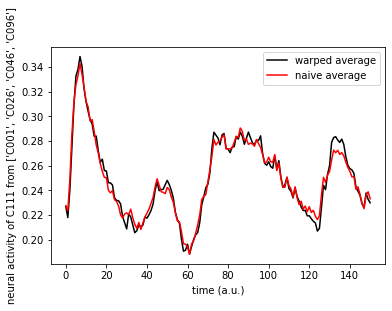

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.06it/s]


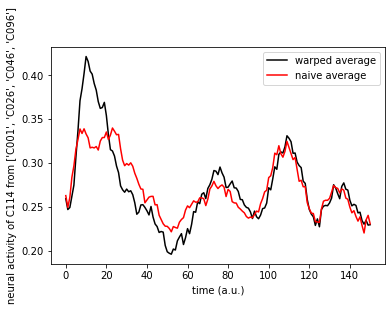

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 737.24it/s]


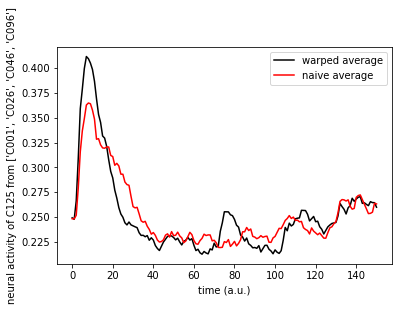

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 506.40it/s]


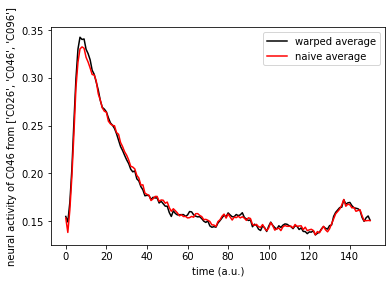

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 307.57it/s]


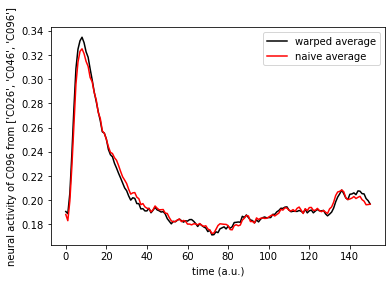

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 506.40it/s]


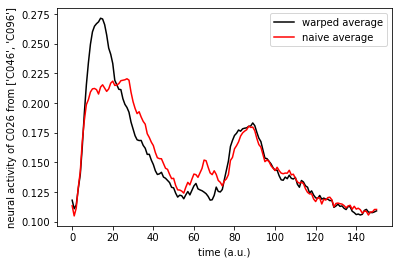

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 522.23it/s]


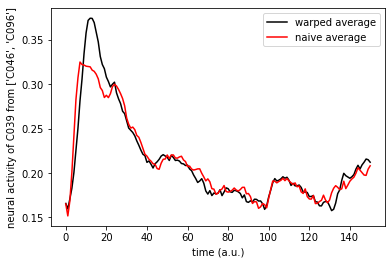

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 482.06it/s]


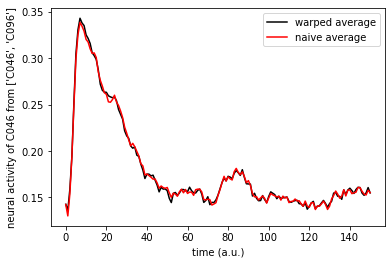

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 486.72it/s]


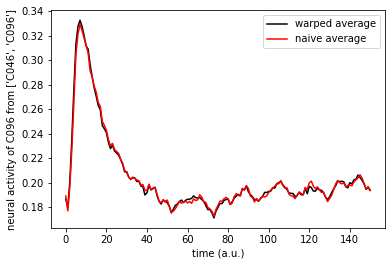

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 451.66it/s]


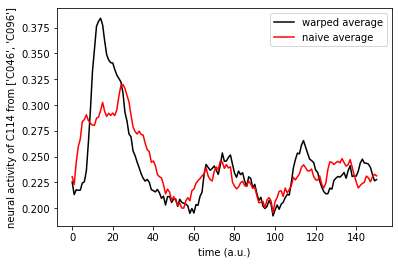

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.44it/s]


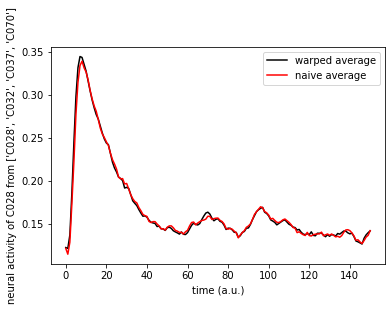

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


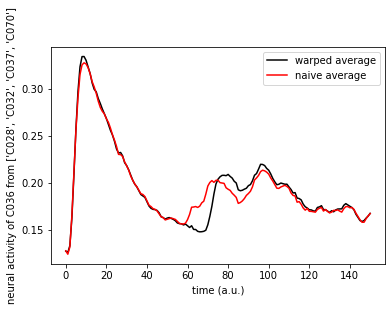

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 432.19it/s]


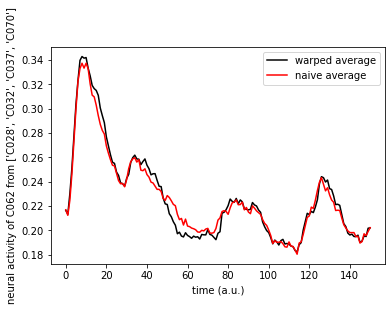

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 455.20it/s]


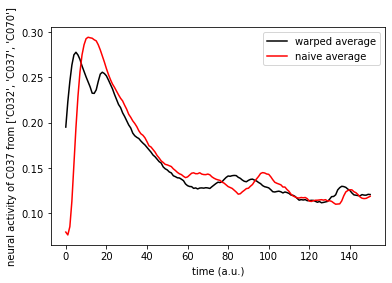

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.46it/s]


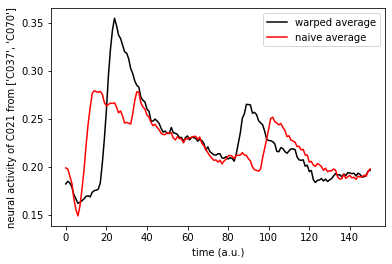

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 651.09it/s]


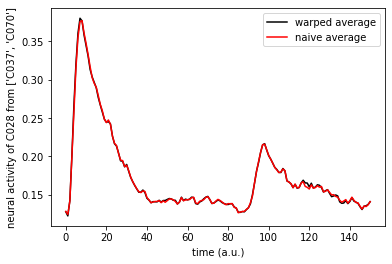

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 596.83it/s]


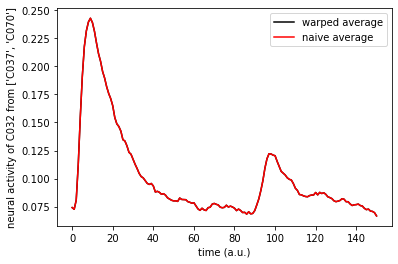

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.27it/s]


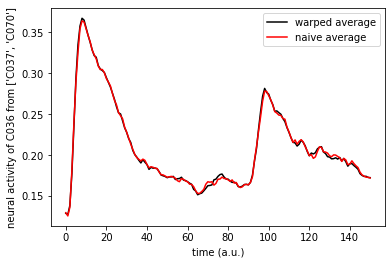

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 566.46it/s]


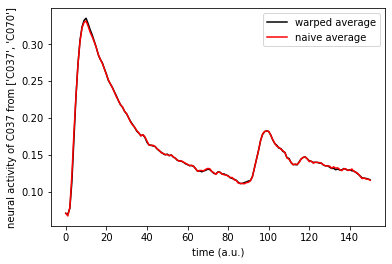

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.30it/s]


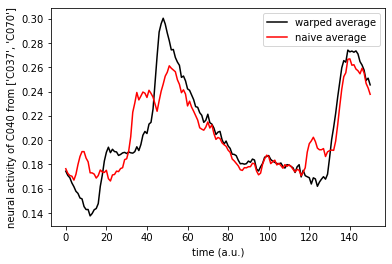

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.31it/s]


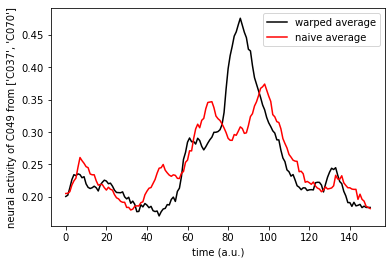

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.57it/s]


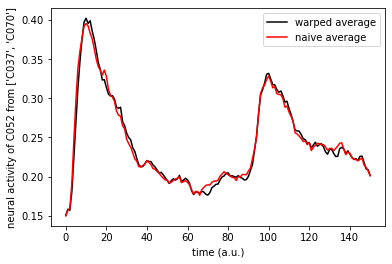

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.25it/s]


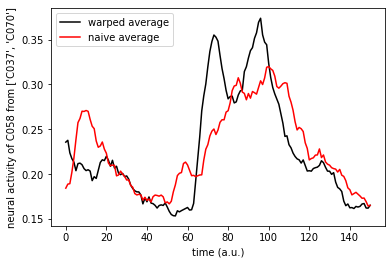

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 878.93it/s]


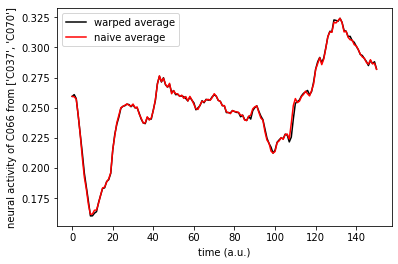

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1066.91it/s]


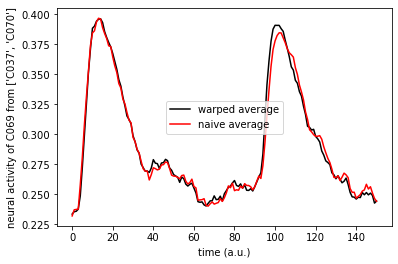

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1066.93it/s]


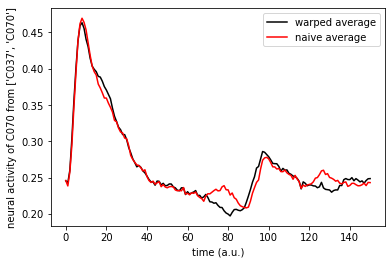

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1066.88it/s]


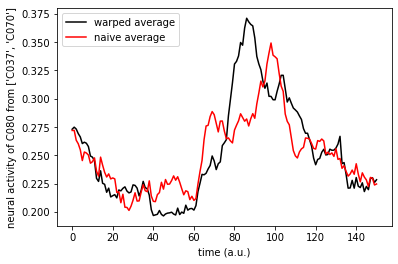

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1066.89it/s]


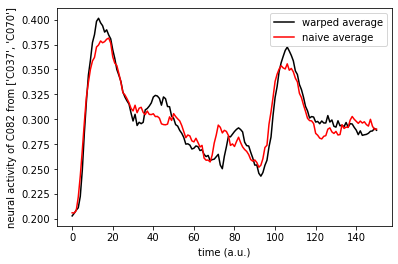

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1066.93it/s]


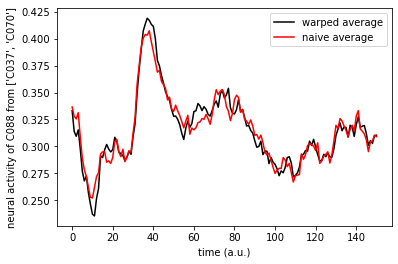

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1066.89it/s]


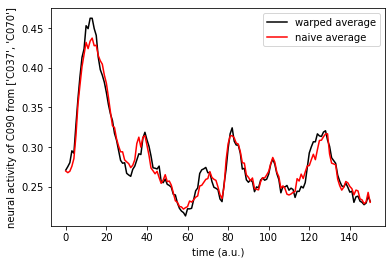

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 930.10it/s]


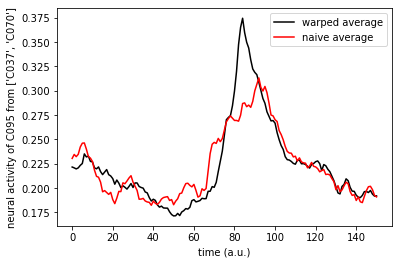

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 928.44it/s]


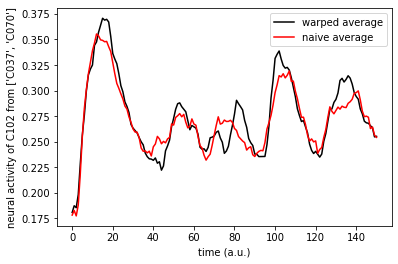

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 800.19it/s]


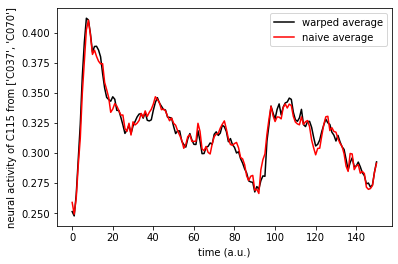

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1066.91it/s]


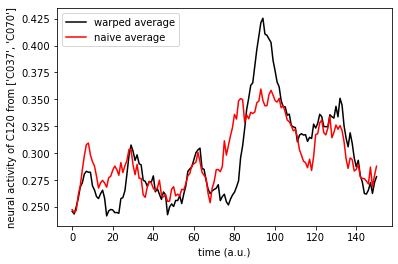

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1023.13it/s]


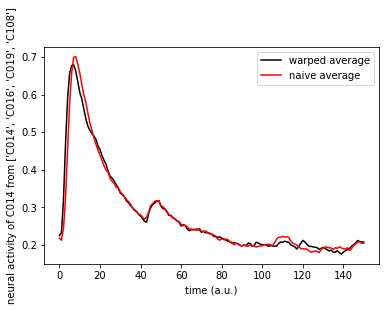

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 981.93it/s]


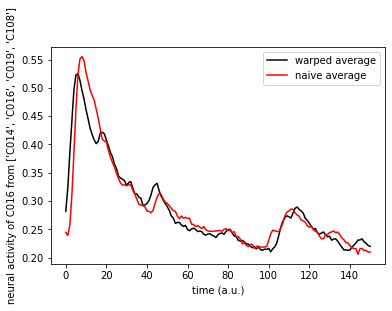

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1044.09it/s]


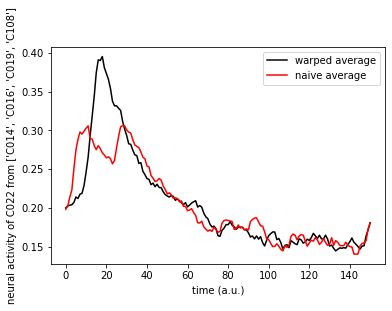

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.27it/s]


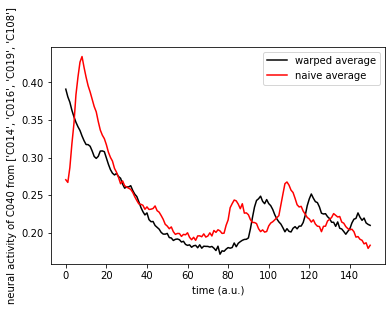

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


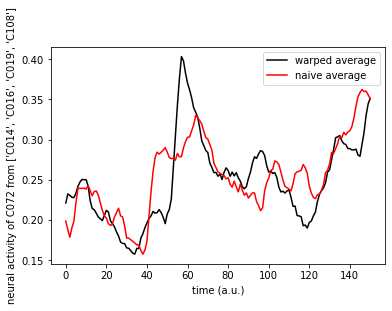

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.30it/s]


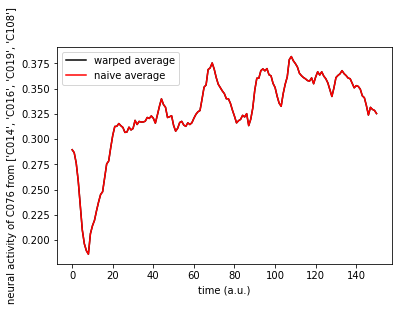

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 582.95it/s]


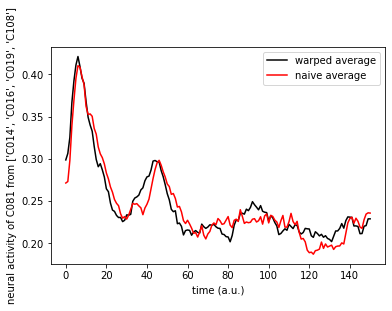

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 557.04it/s]


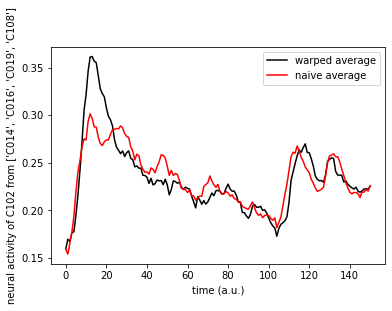

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 626.67it/s]


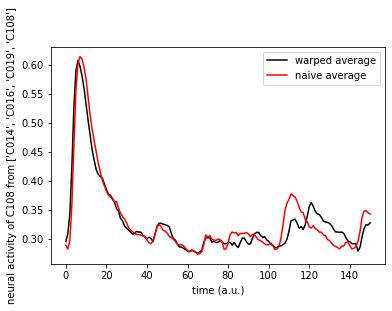

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 544.93it/s]


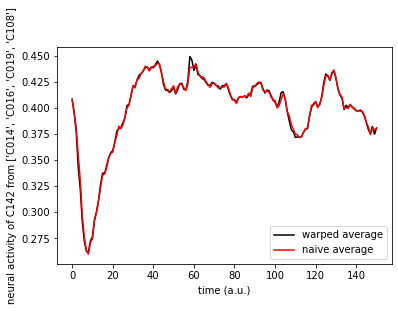

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.45it/s]


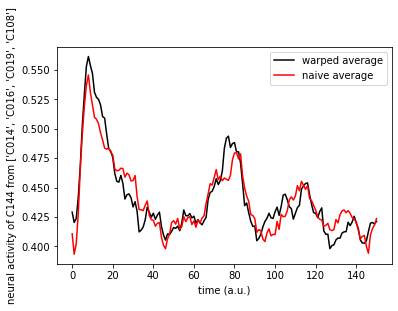

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 544.93it/s]


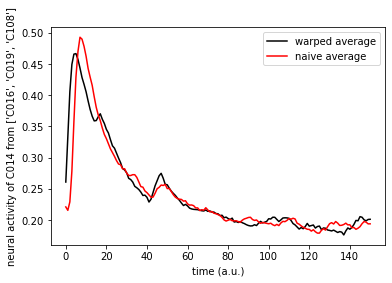

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 443.66it/s]


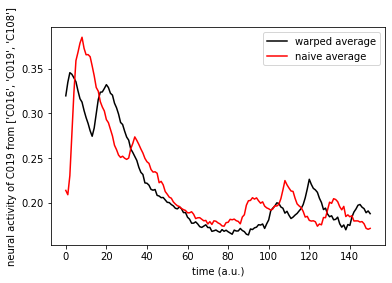

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 557.04it/s]


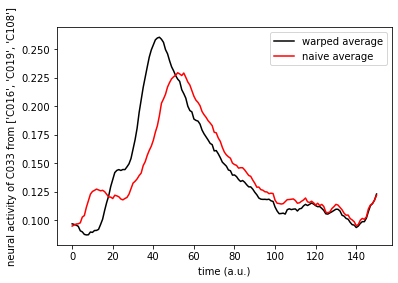

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 726.57it/s]


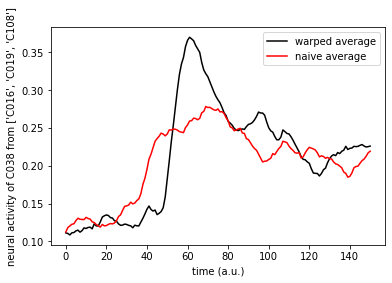

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.48it/s]


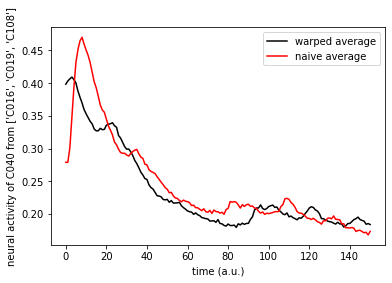

Loss: 0.04: 100%|██████████| 50/50 [00:00<00:00, 611.39it/s]


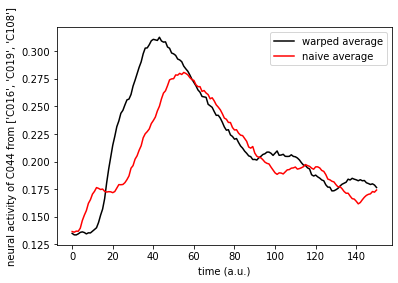

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 596.83it/s]


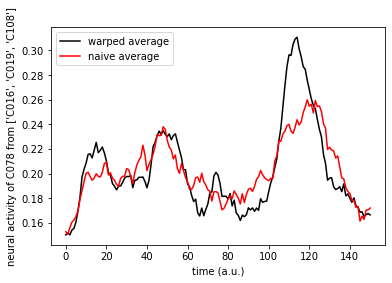

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 634.61it/s]


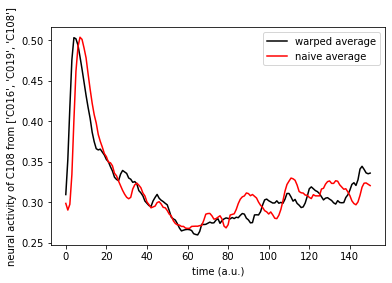

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 596.83it/s]


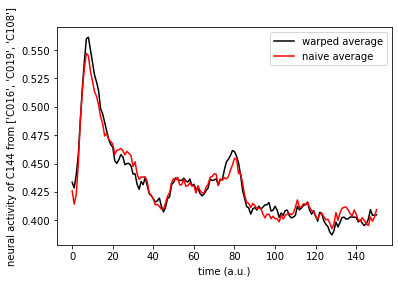

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 401.06it/s]


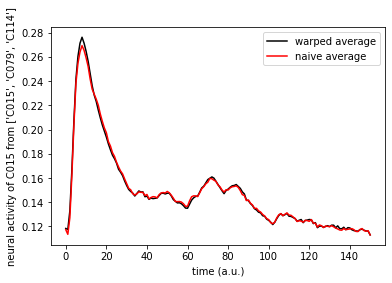

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 421.29it/s]


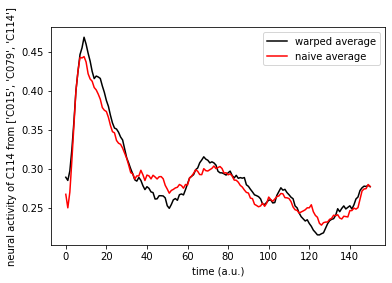

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 569.71it/s]


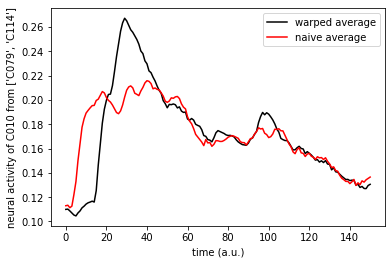

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 618.93it/s]


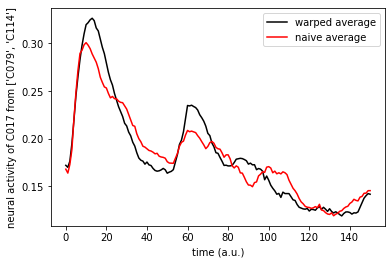

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 506.39it/s]


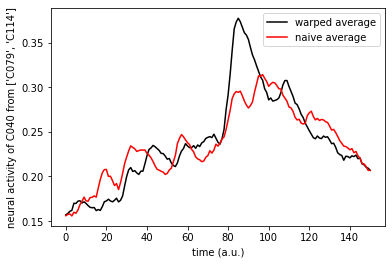

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 618.94it/s]


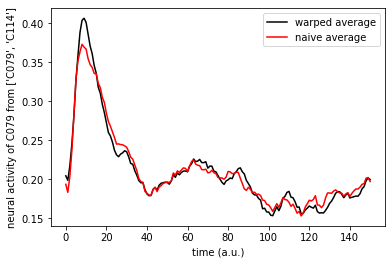

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 327.67it/s]


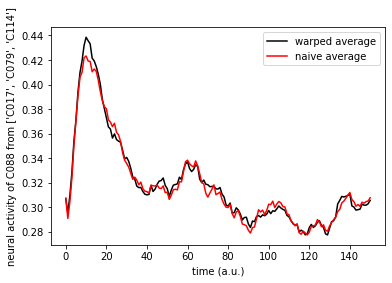

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 374.13it/s]


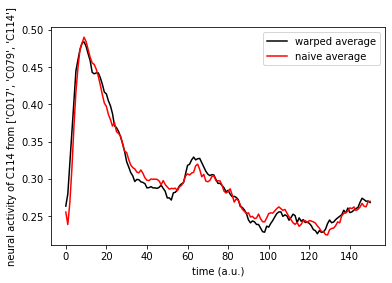

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.75it/s]


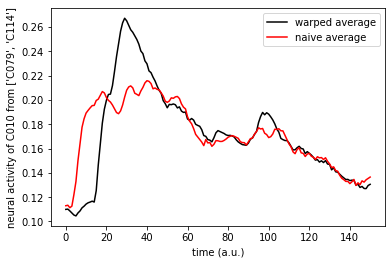

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 407.59it/s]


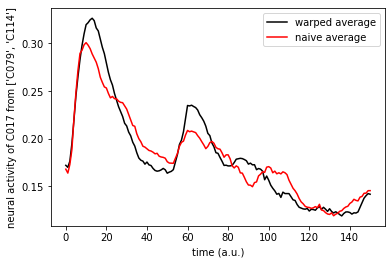

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 432.18it/s]


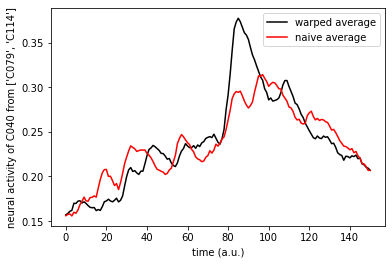

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 455.76it/s]


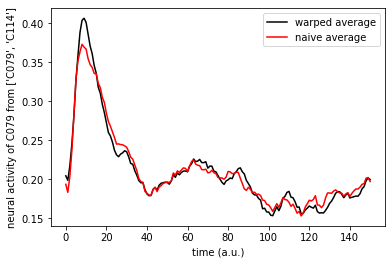

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 451.65it/s]


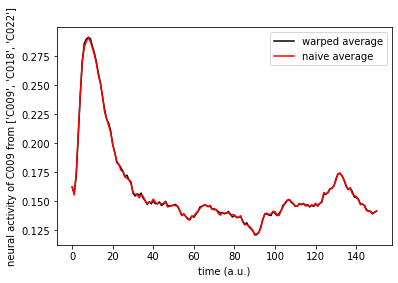

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 459.94it/s]


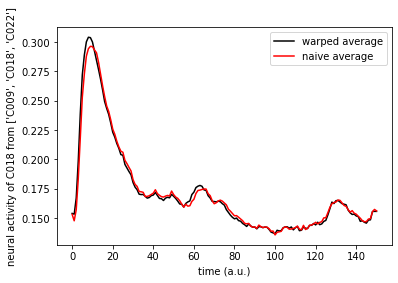

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 482.05it/s]


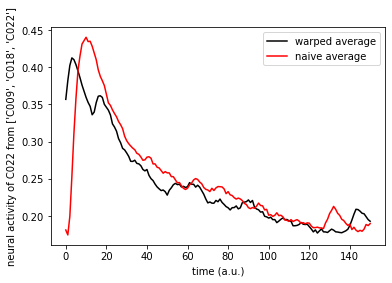

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 575.02it/s]


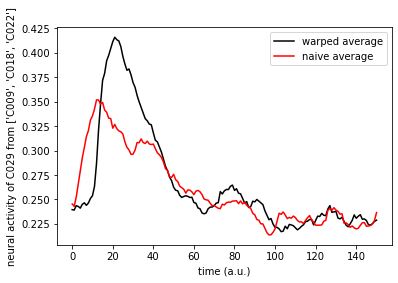

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.72it/s]


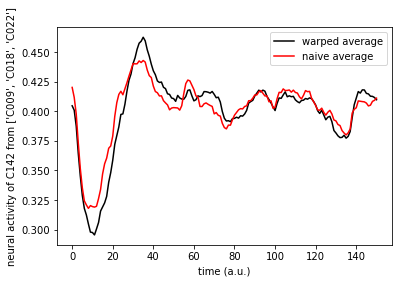

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


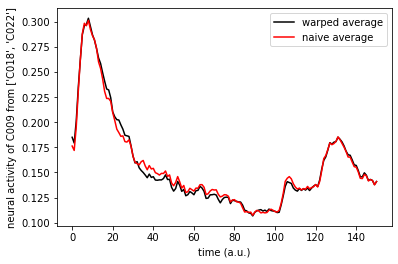

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 762.41it/s]


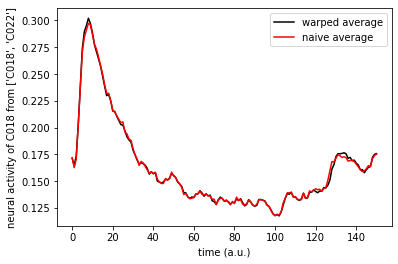

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 642.72it/s]


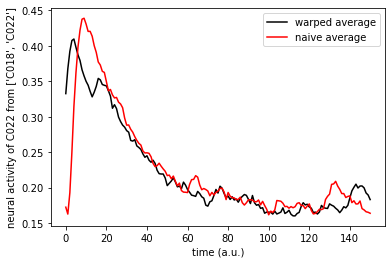

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


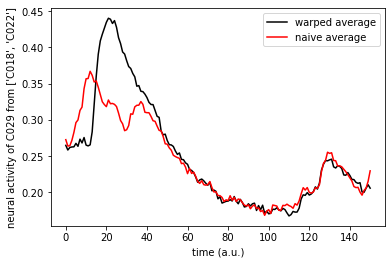

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.78it/s]


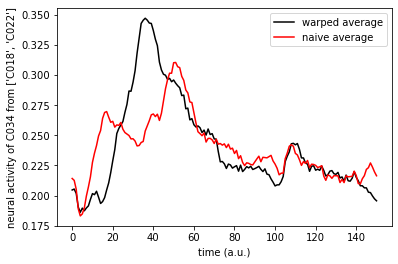

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 795.77it/s]


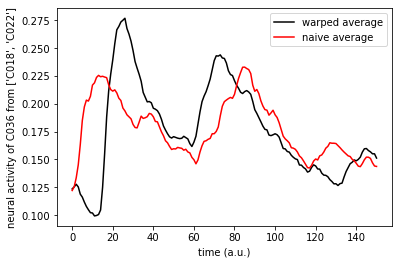

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.27it/s]


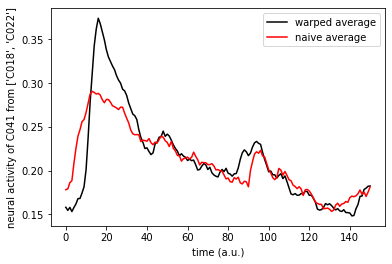

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 753.63it/s]


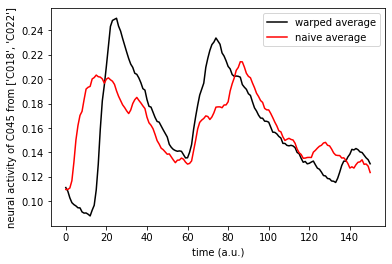

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 771.29it/s]


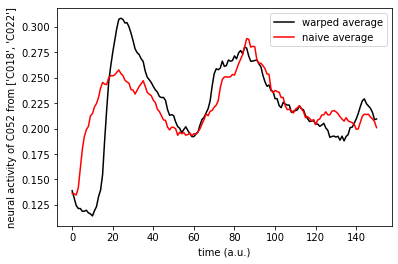

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


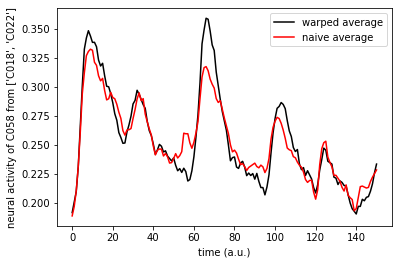

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.59it/s]


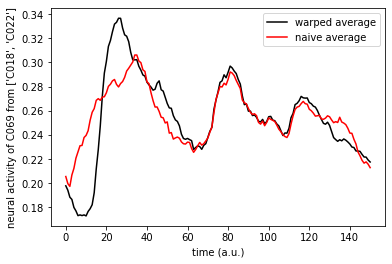

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.27it/s]


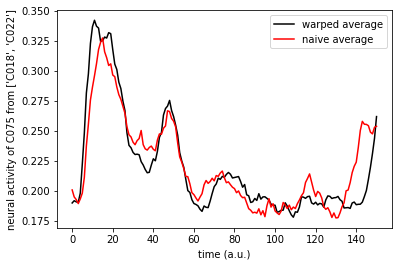

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.28it/s]


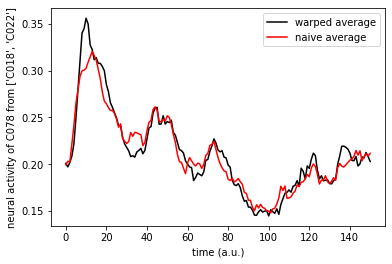

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 700.46it/s]


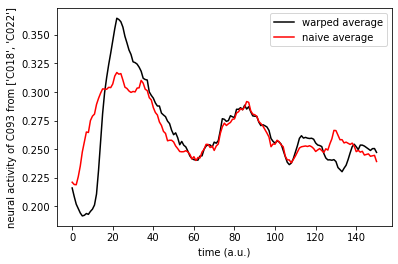

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 928.42it/s]


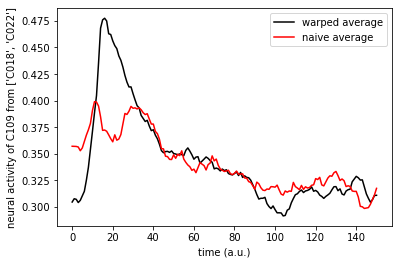

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 642.74it/s]


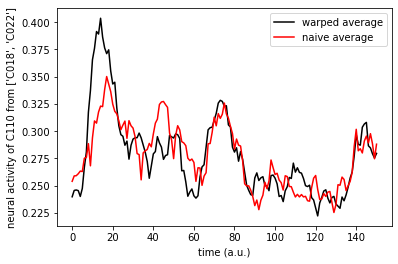

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 544.94it/s]


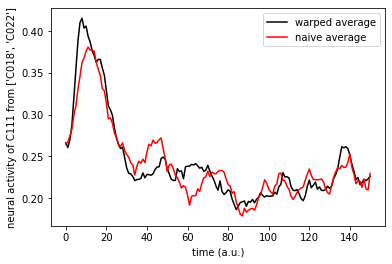

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 710.06it/s]


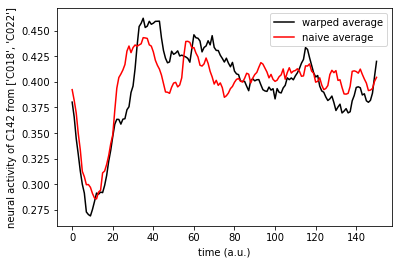

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 503.40it/s]


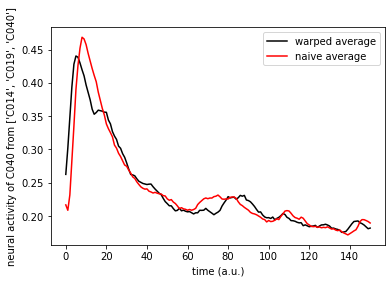

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 516.83it/s]


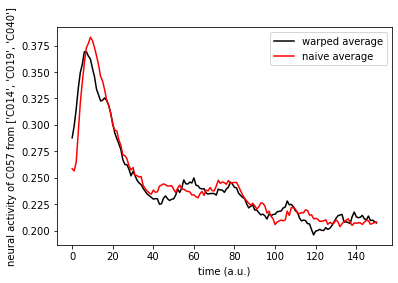

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.72it/s]


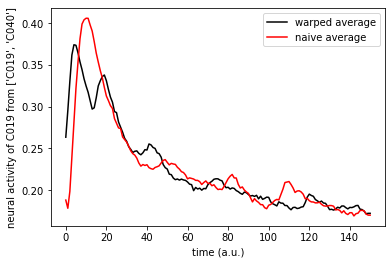

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 596.82it/s]


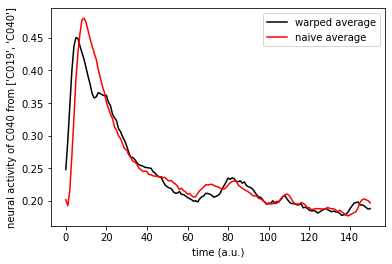

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 677.48it/s]


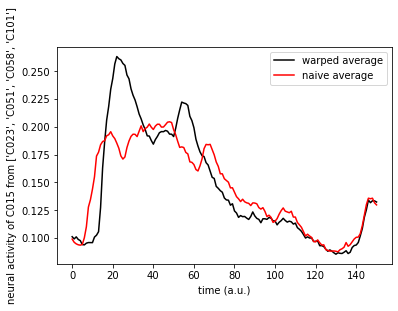

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 459.94it/s]


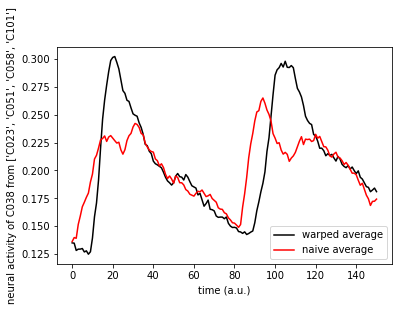

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.30it/s]


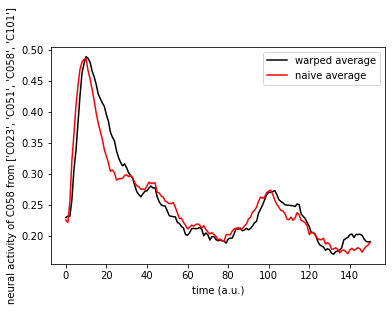

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.61it/s]


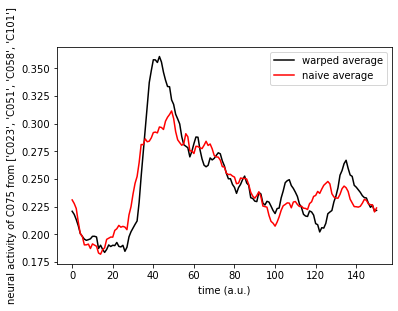

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.59it/s]


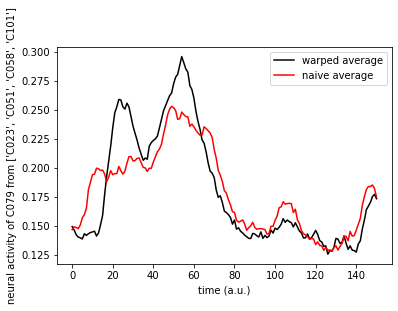

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.28it/s]


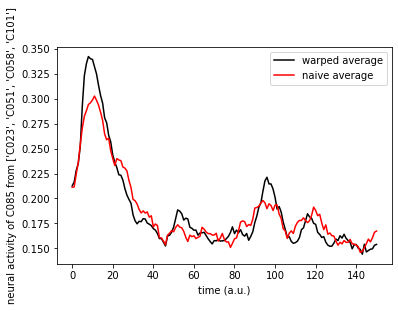

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 539.07it/s]


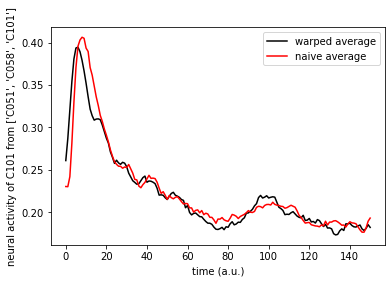

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.61it/s]


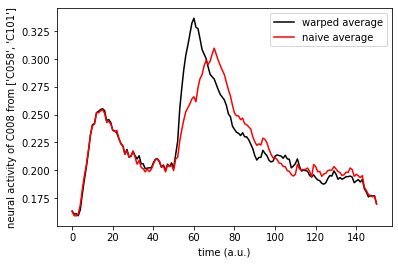

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.57it/s]


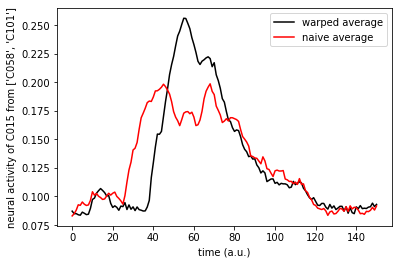

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 835.72it/s]


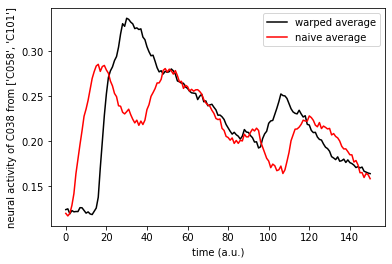

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.31it/s]


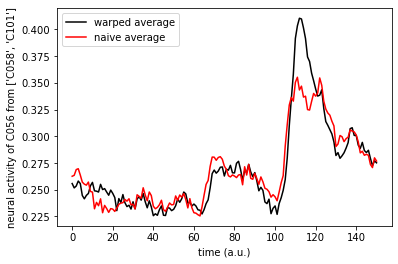

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.60it/s]


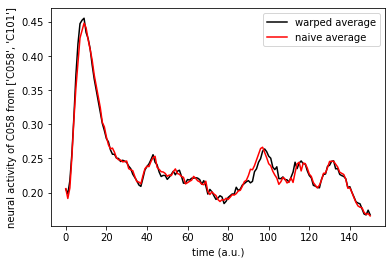

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.37it/s]


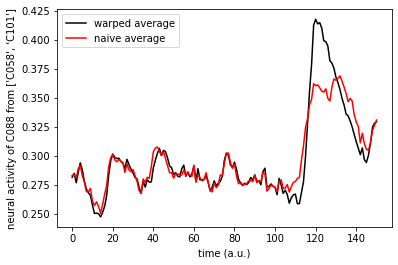

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.35it/s]


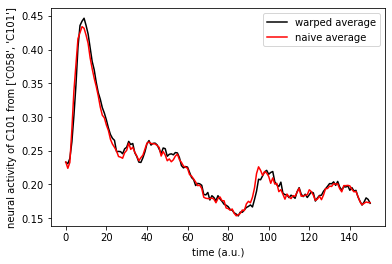

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.70it/s]


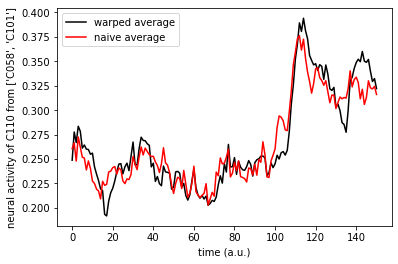

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.73it/s]


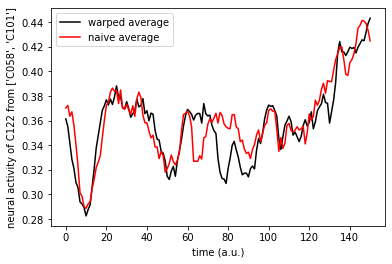

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.50it/s]


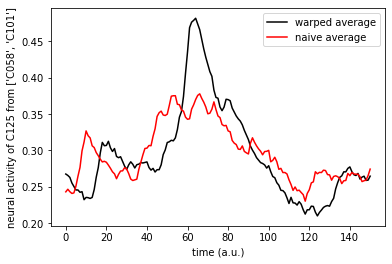

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


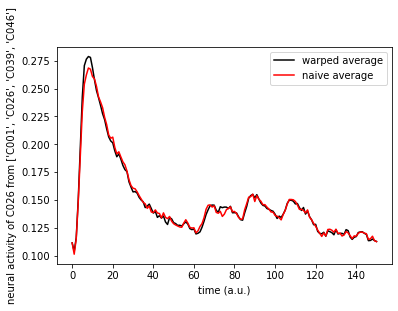

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.30it/s]


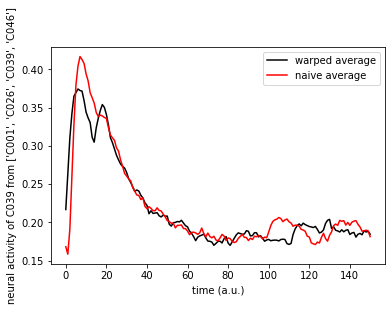

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 706.17it/s]


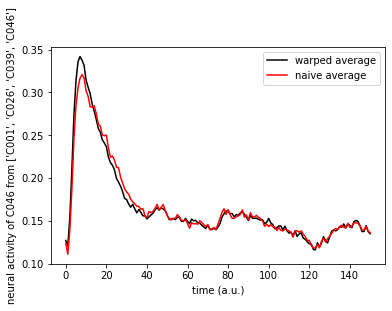

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.59it/s]


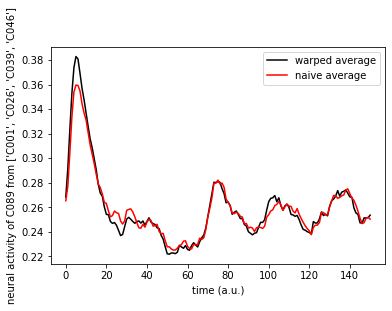

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 506.40it/s]


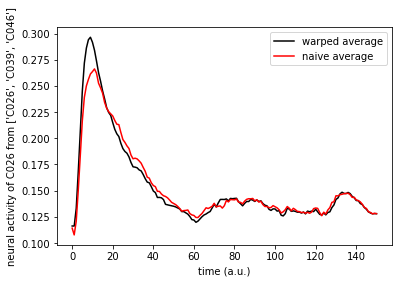

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 511.56it/s]


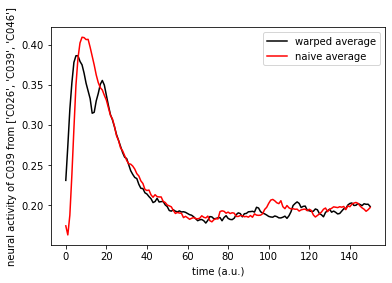

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 501.34it/s]


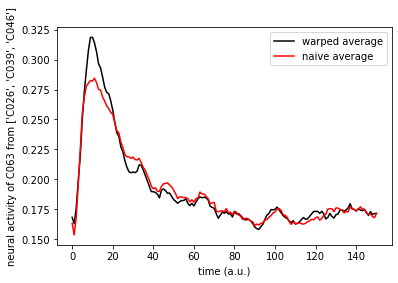

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 511.57it/s]


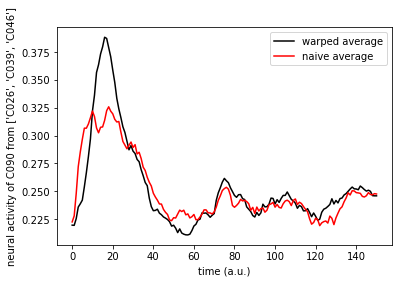

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 597.01it/s]


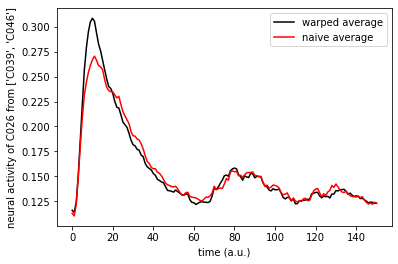

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 618.92it/s]


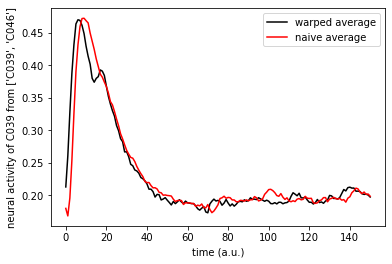

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 583.00it/s]


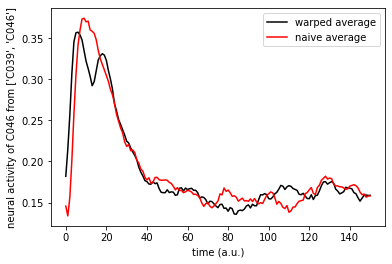

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 611.39it/s]


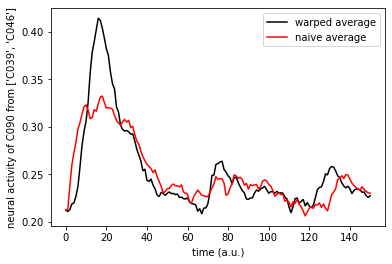

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 626.67it/s]


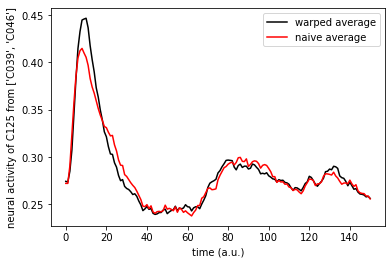

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.24it/s]


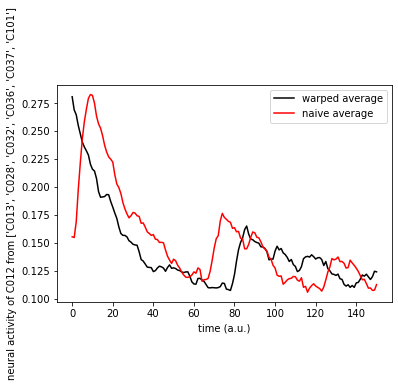

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 618.93it/s]


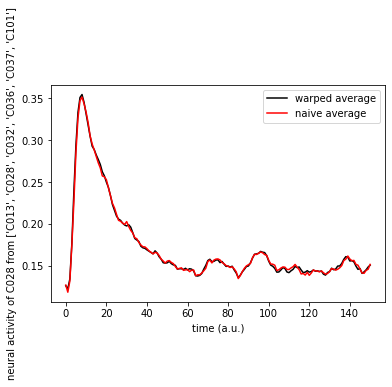

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 695.84it/s]


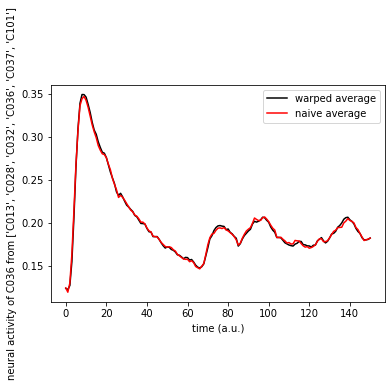

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 647.50it/s]


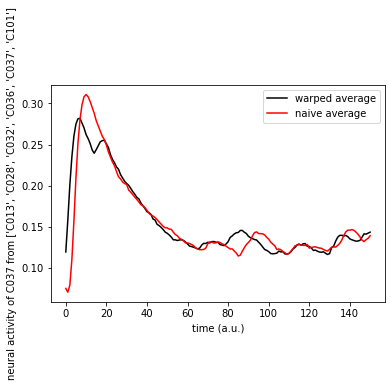

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.27it/s]


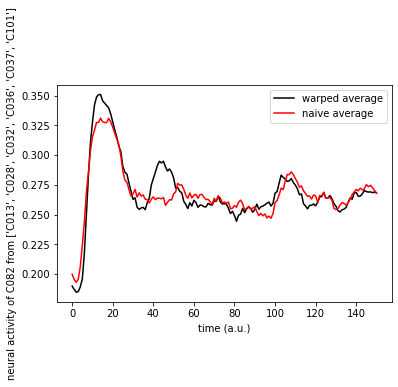

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.24it/s]


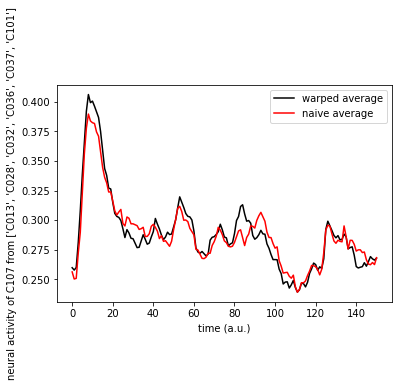

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 681.48it/s]


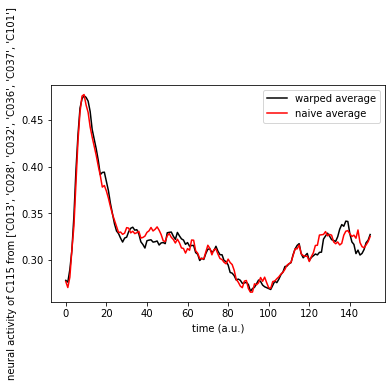

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 686.76it/s]


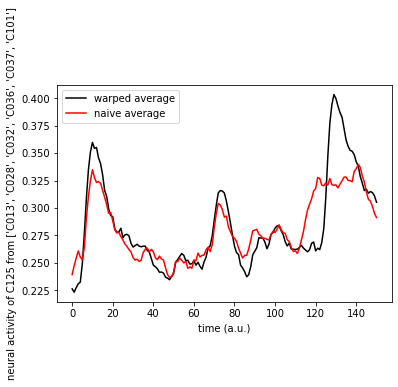

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.45it/s]


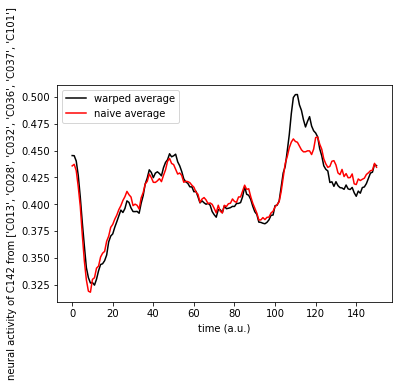

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 796.03it/s]


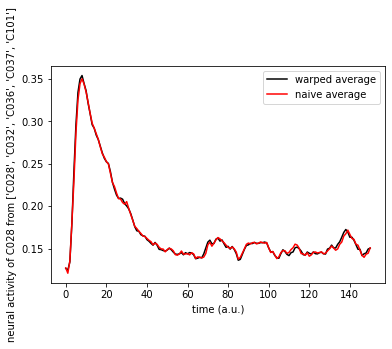

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.45it/s]


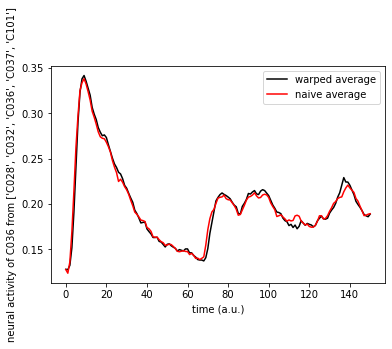

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 757.66it/s]


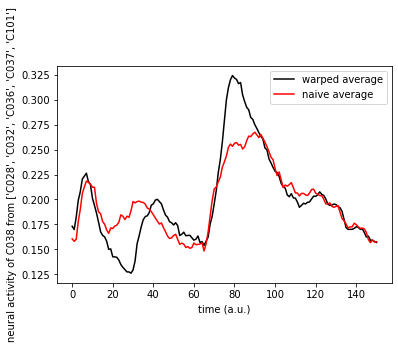

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 808.43it/s]


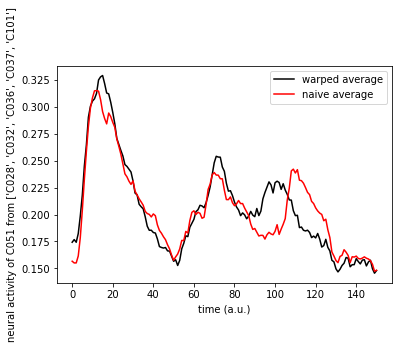

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


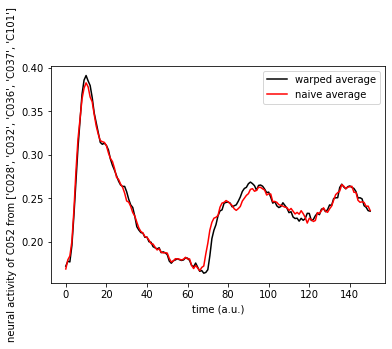

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 808.63it/s]


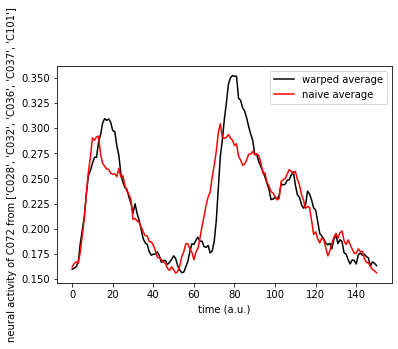

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.59it/s]


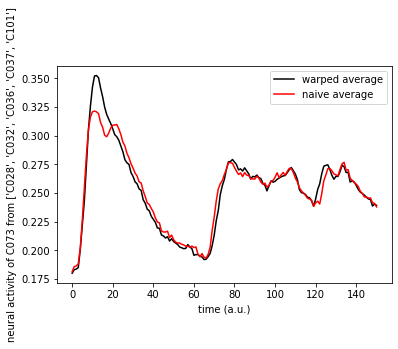

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.22it/s]


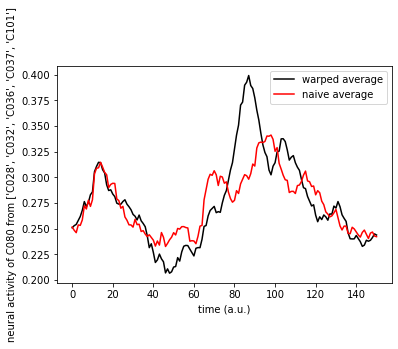

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 796.44it/s]


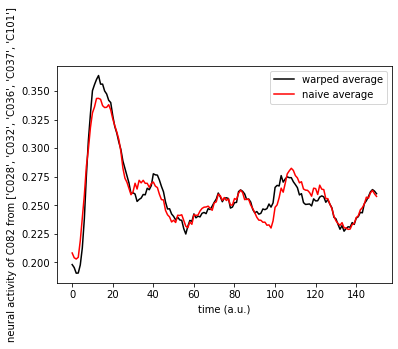

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 879.55it/s]


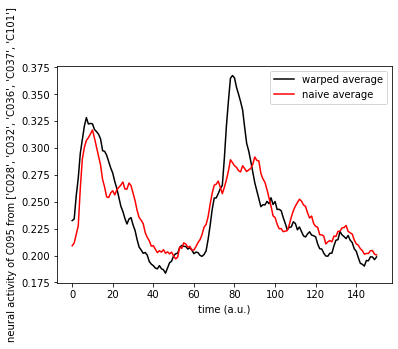

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 945.43it/s]


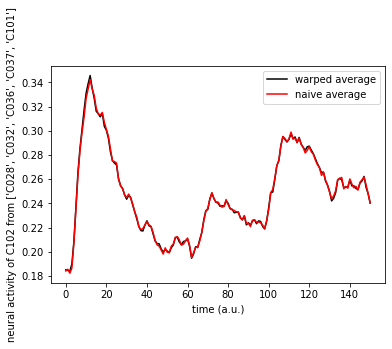

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 911.52it/s]


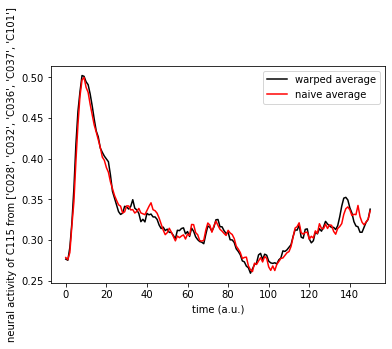

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 983.02it/s]


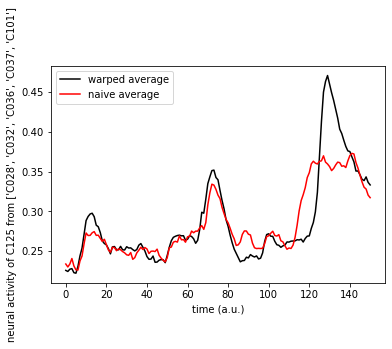

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


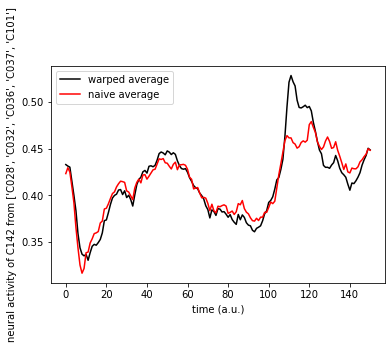

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


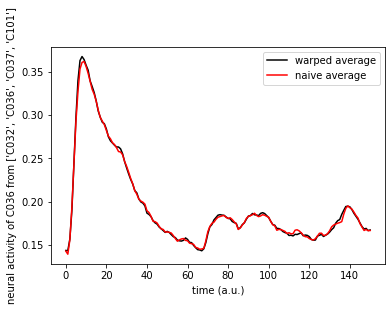

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.48it/s]


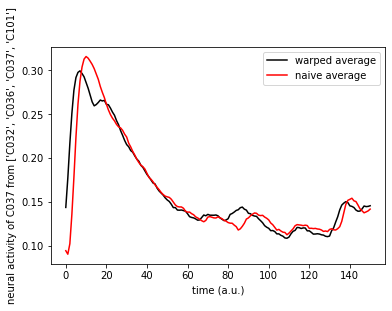

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 696.29it/s]


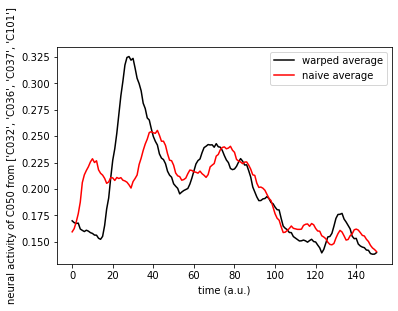

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 737.27it/s]


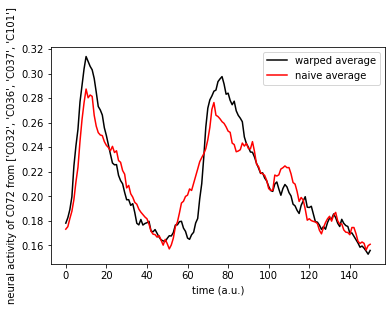

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.47it/s]


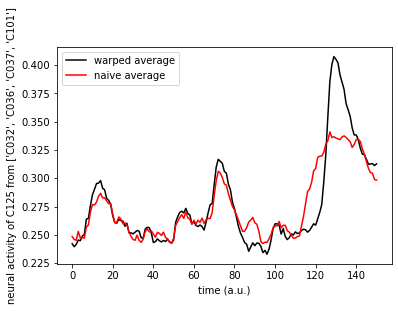

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 513.99it/s]


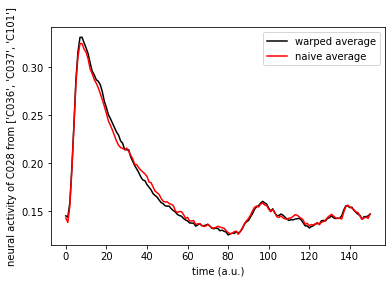

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.72it/s]


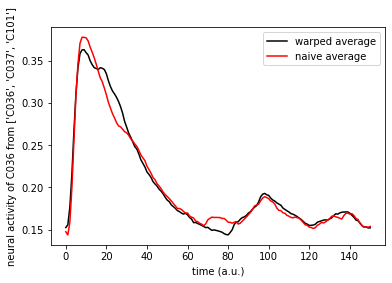

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 522.37it/s]


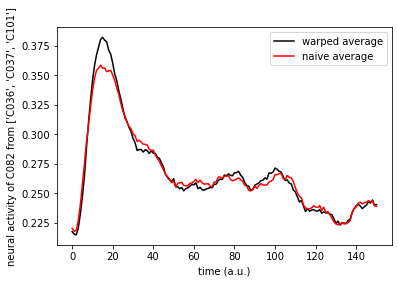

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.77it/s]


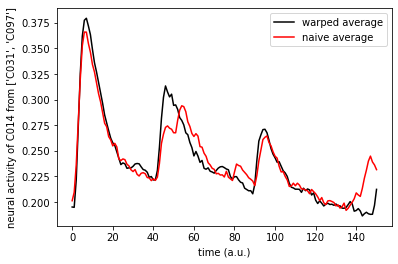

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 795.77it/s]


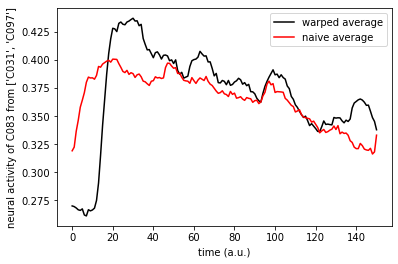

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.60it/s]


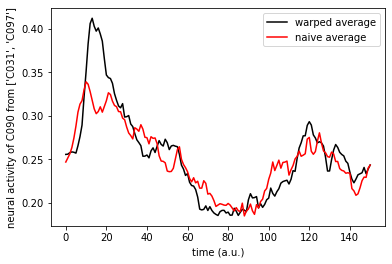

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.57it/s]


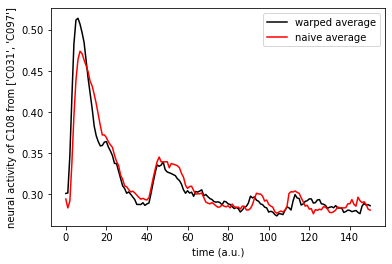

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.34it/s]


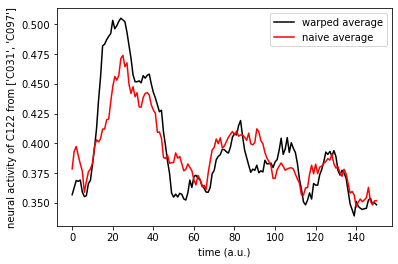

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.31it/s]


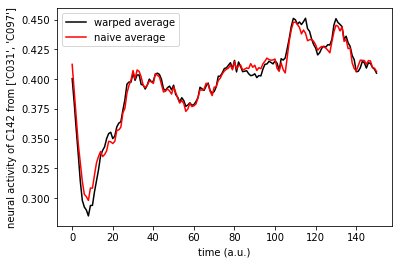

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.47it/s]


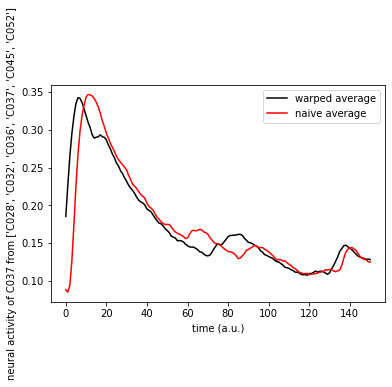

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 659.66it/s]


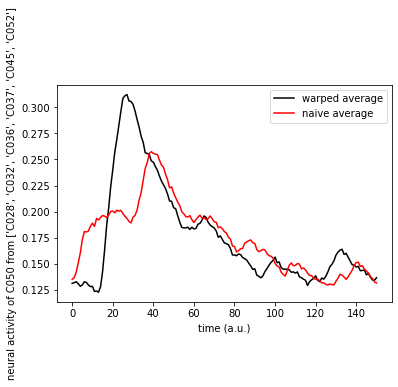

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.07it/s]


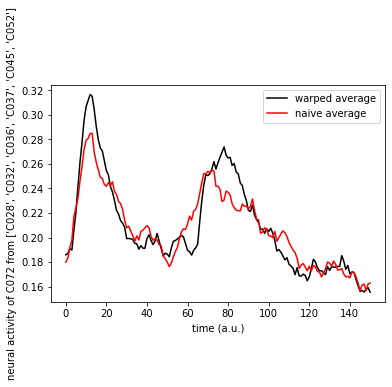

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.46it/s]


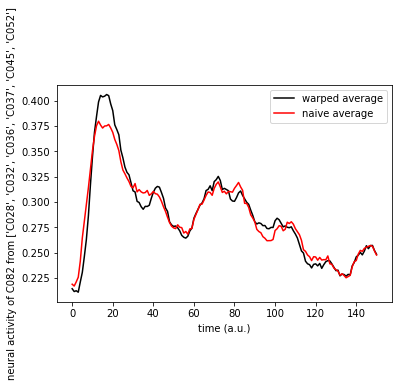

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


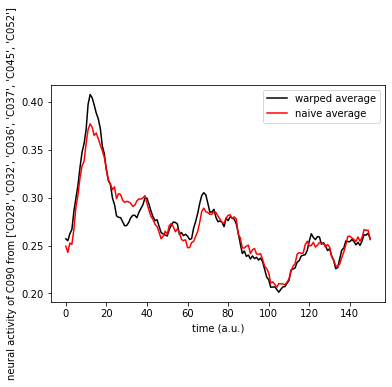

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 696.10it/s]


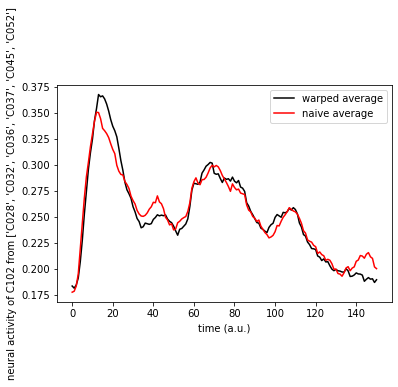

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 849.71it/s]


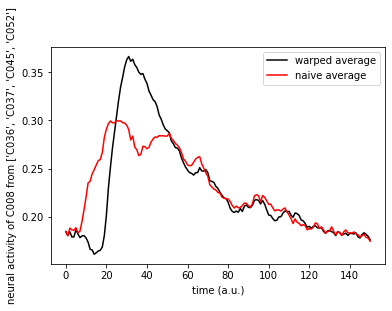

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.38it/s]


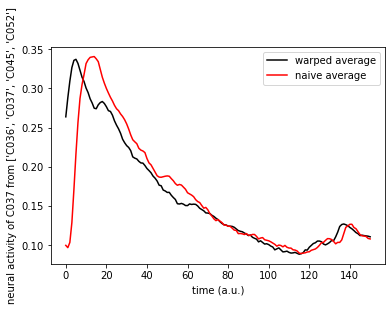

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 821.82it/s]


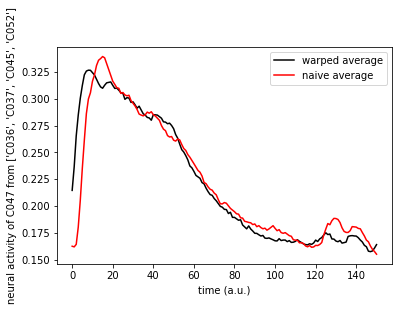

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.51it/s]


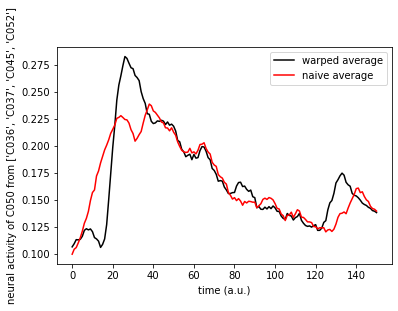

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.77it/s]


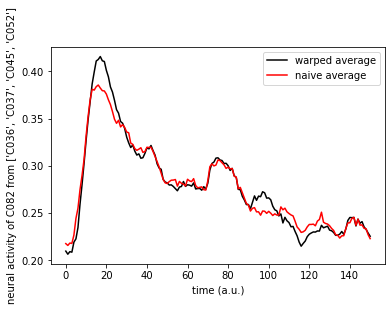

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 753.71it/s]


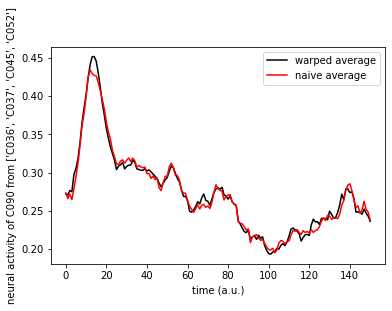

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.78it/s]


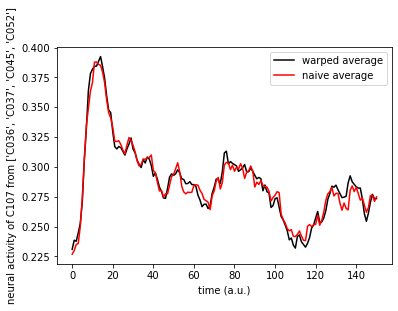

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


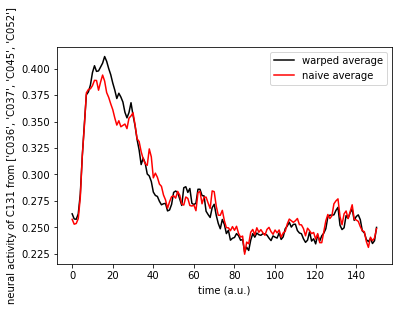

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 541.14it/s]


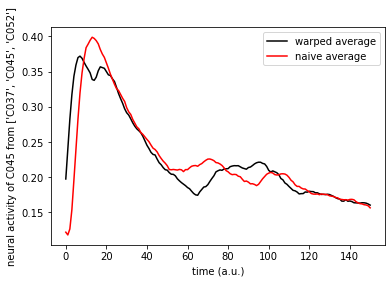

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 519.91it/s]


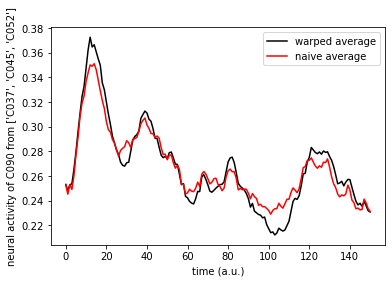

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 671.76it/s]


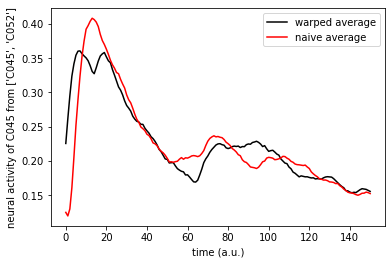

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 659.64it/s]


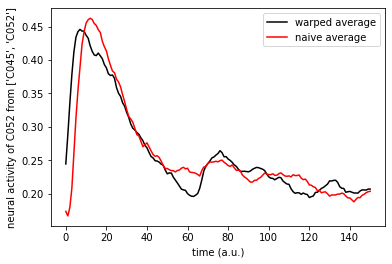

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.02it/s]


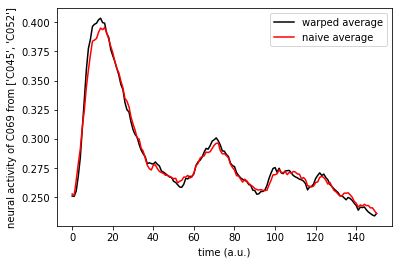

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.44it/s]


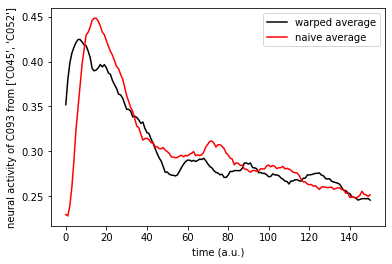

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 651.11it/s]


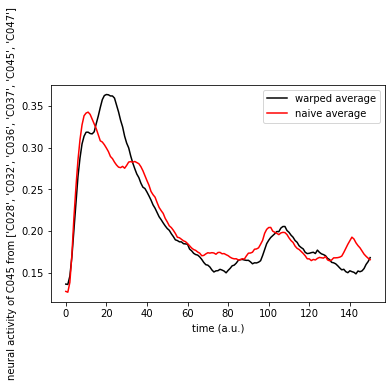

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 644.58it/s]


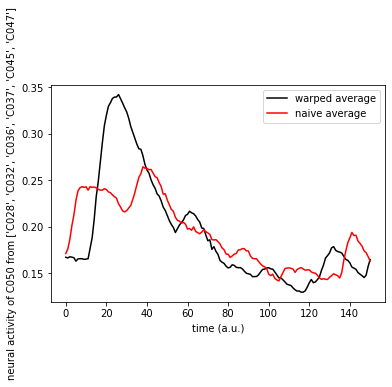

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 596.82it/s]


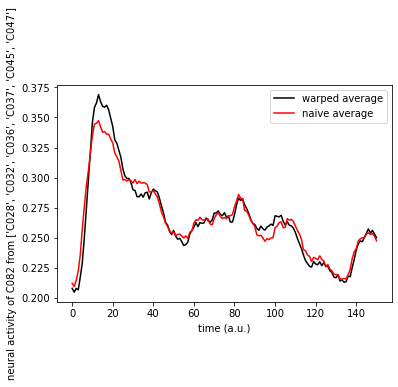

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 611.38it/s]


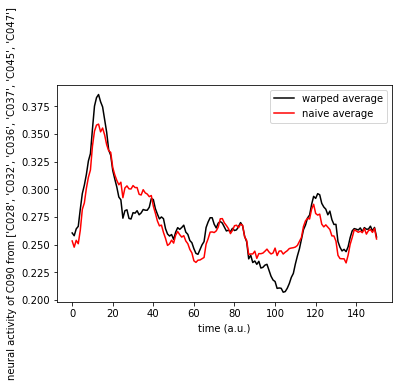

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 736.23it/s]


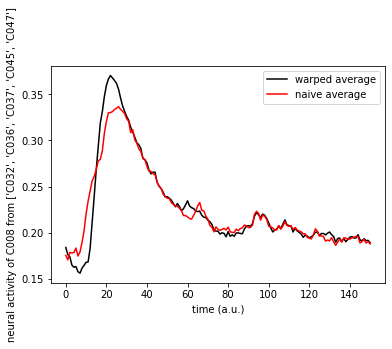

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 849.73it/s]


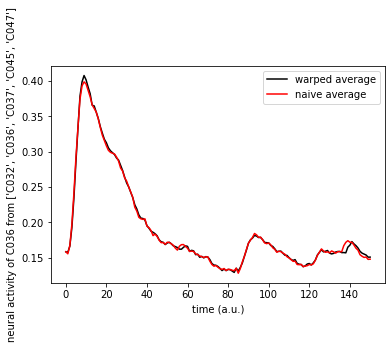

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.27it/s]


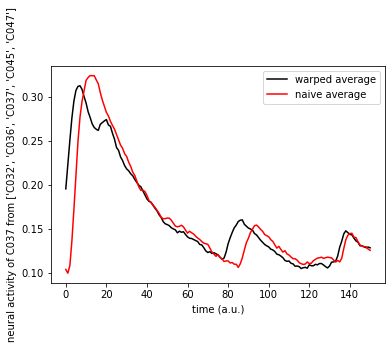

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.35it/s]


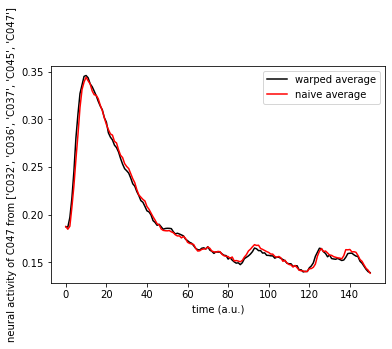

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 763.74it/s]


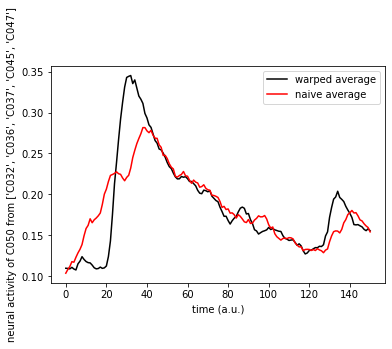

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.34it/s]


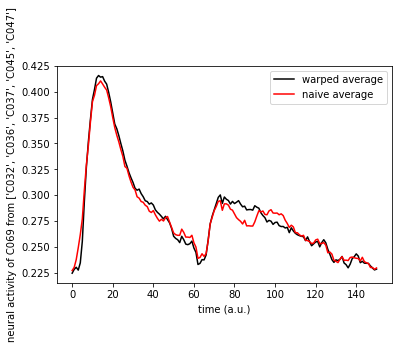

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 795.76it/s]


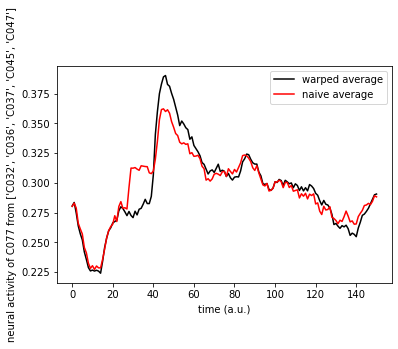

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


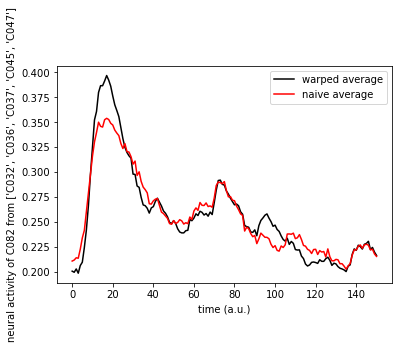

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.29it/s]


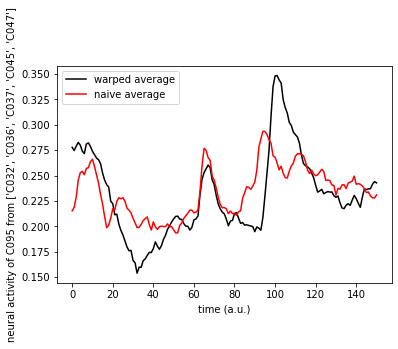

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.79it/s]


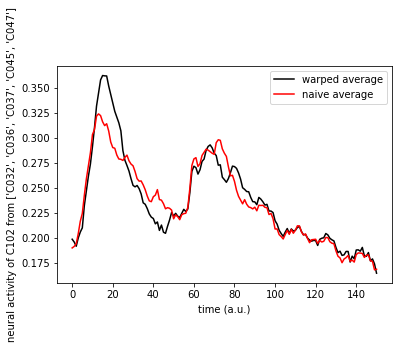

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 808.58it/s]


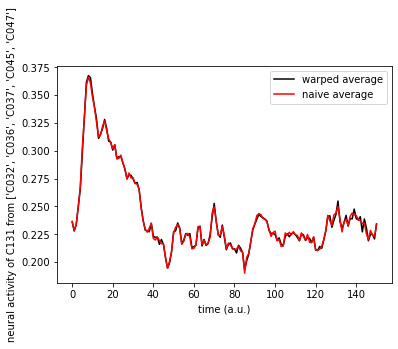

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.44it/s]


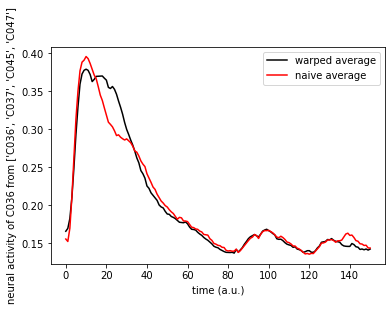

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 677.49it/s]


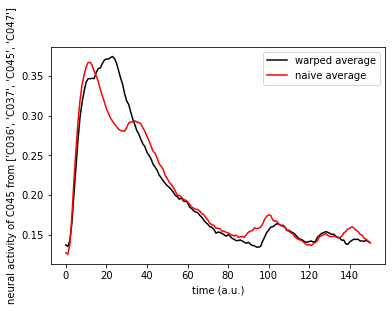

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


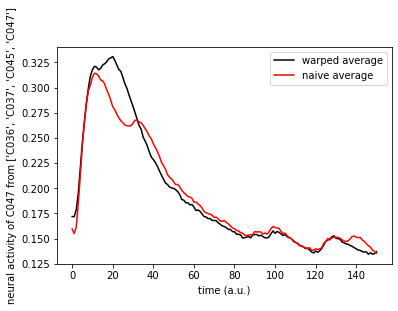

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.75it/s]


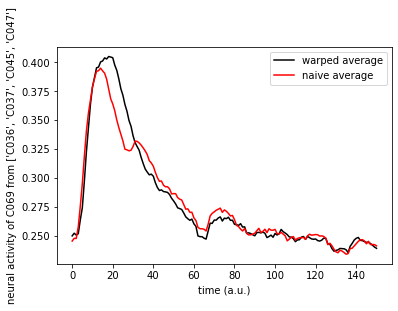

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 607.49it/s]


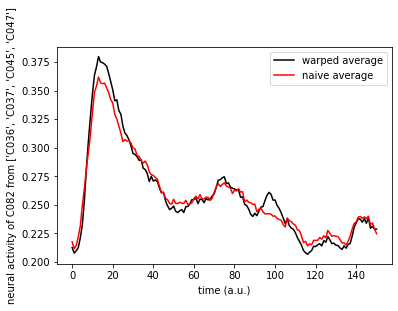

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.10it/s]


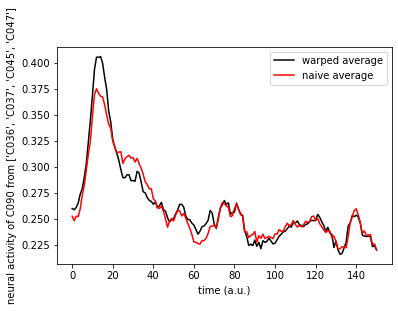

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.31it/s]


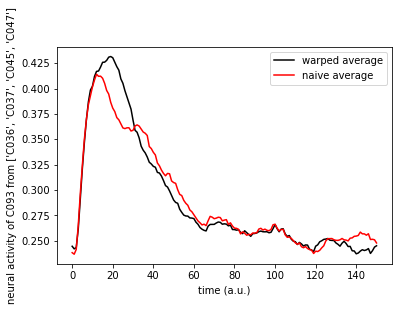

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.45it/s]


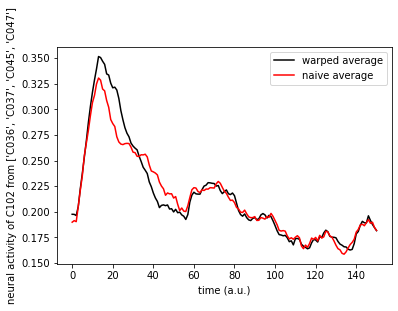

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


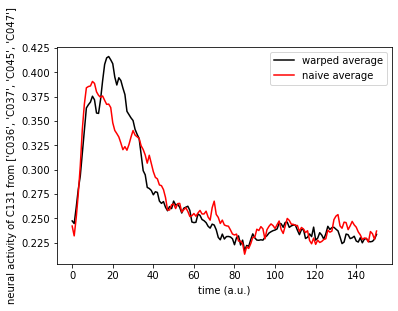

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 501.33it/s]


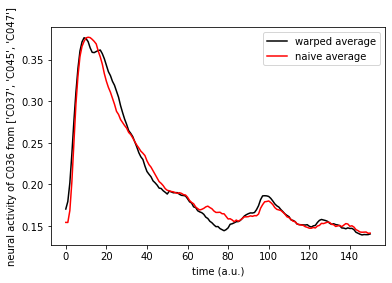

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 527.72it/s]


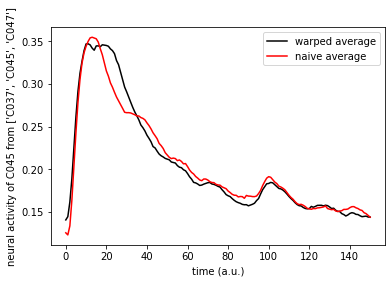

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 498.77it/s]


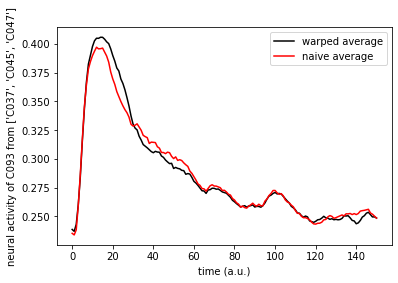

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.45it/s]


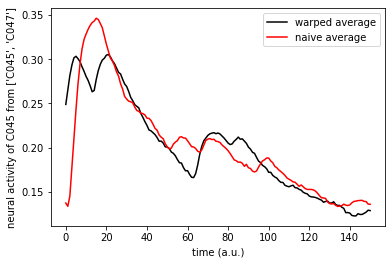

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.50it/s]


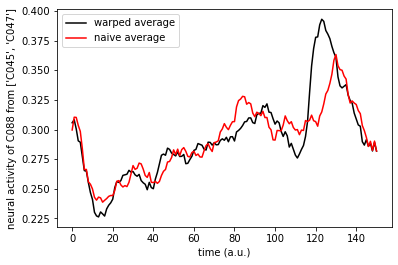

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.45it/s]


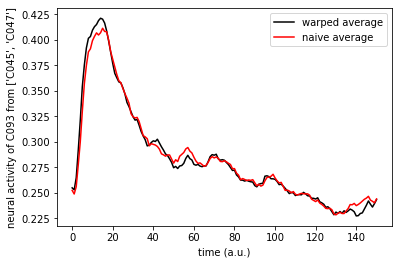

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.73it/s]


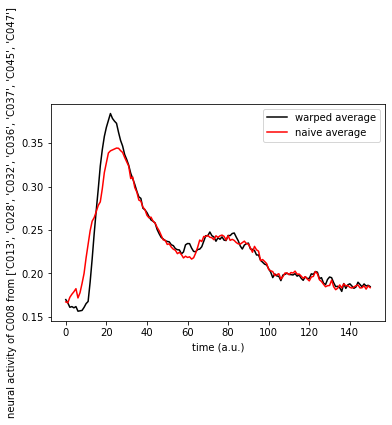

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 848.19it/s]


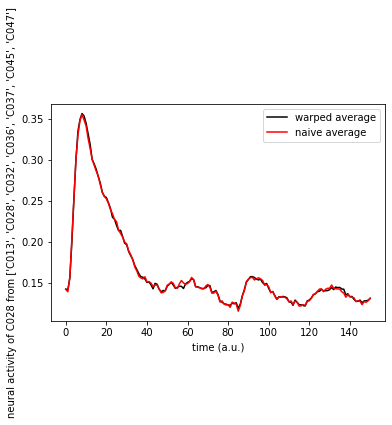

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 849.71it/s]


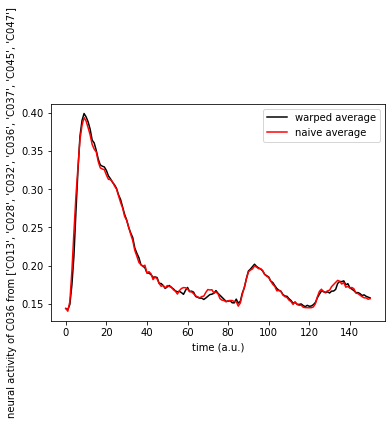

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


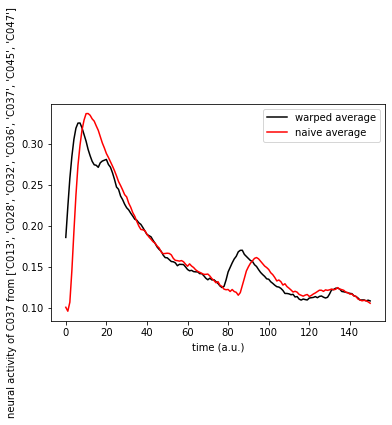

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


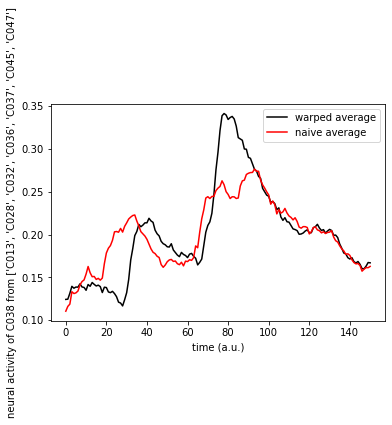

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.32it/s]


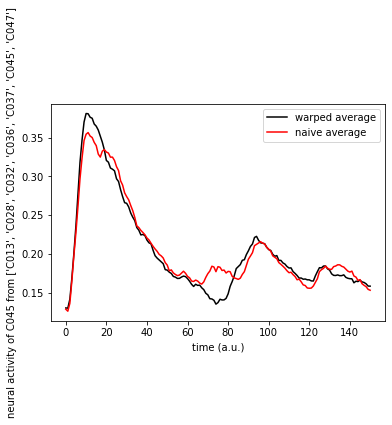

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


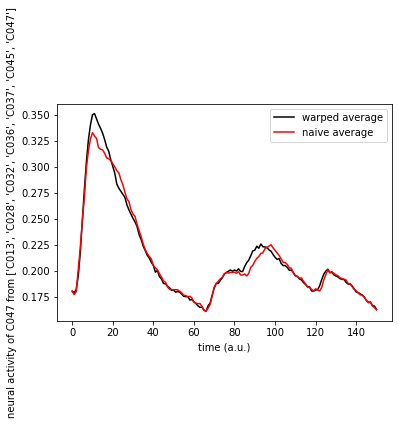

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 895.25it/s]


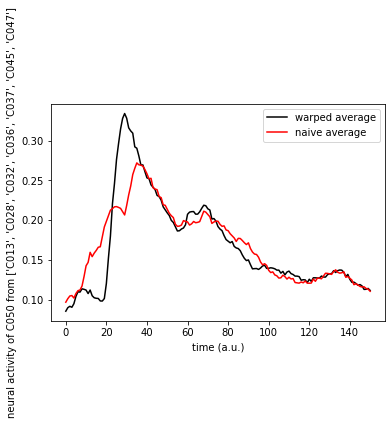

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 911.53it/s]


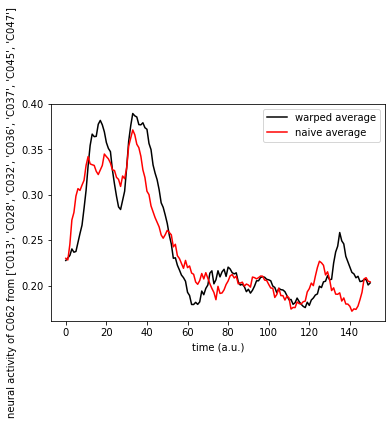

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.53it/s]


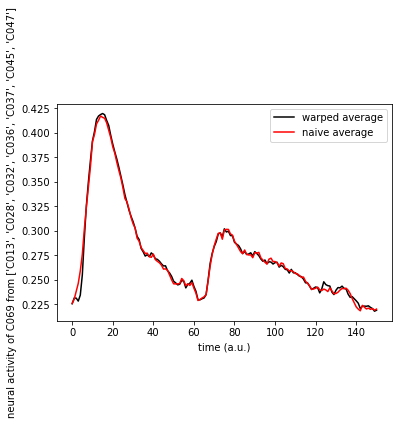

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.72it/s]


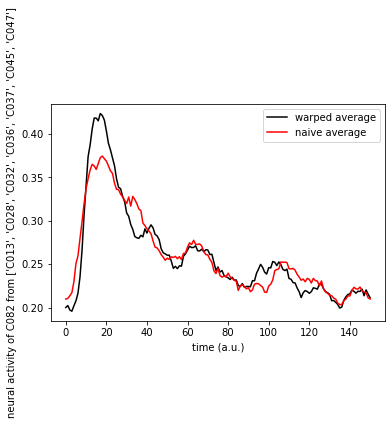

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.52it/s]


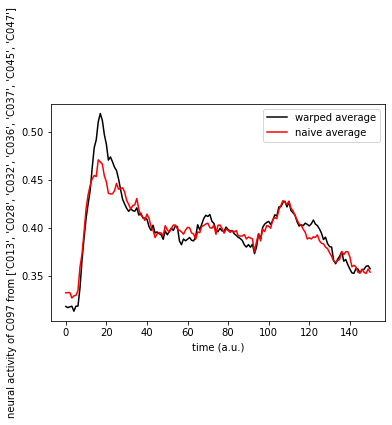

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.55it/s]


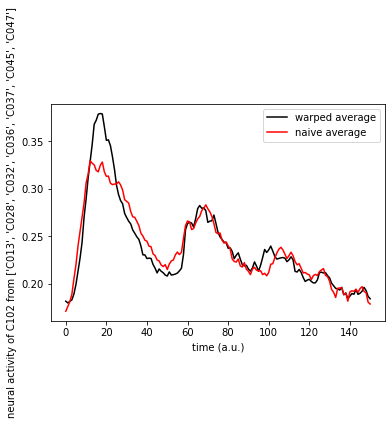

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.62it/s]


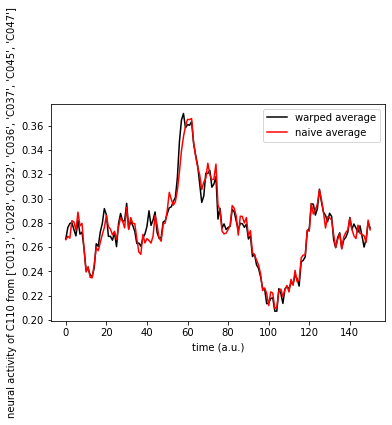

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.88it/s]


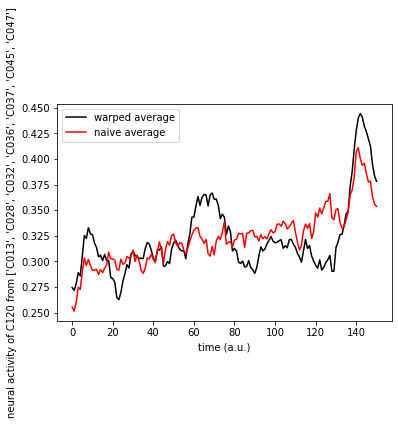

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.55it/s]


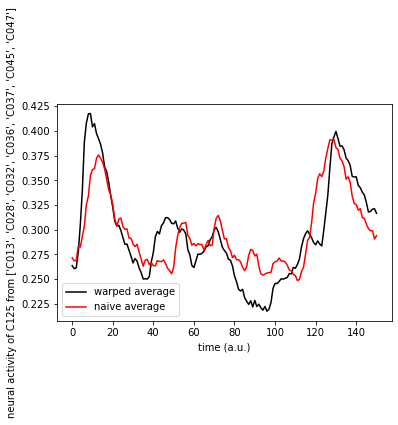

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 802.01it/s]


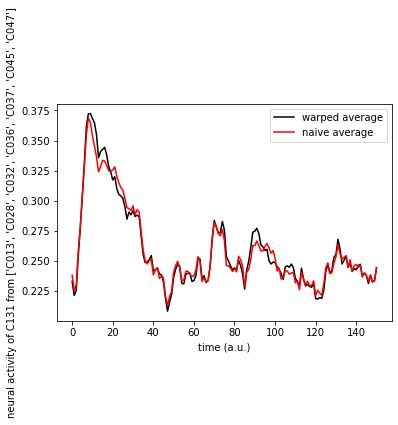

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 670.15it/s]


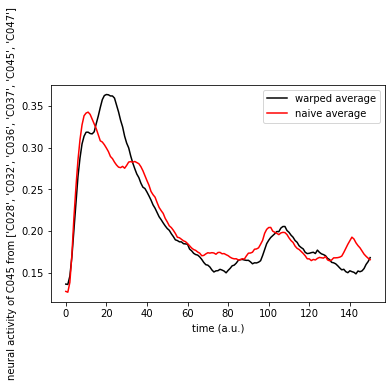

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 604.02it/s]


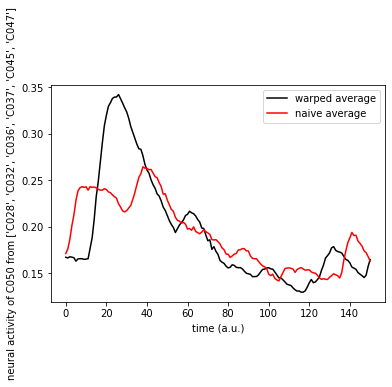

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 657.05it/s]


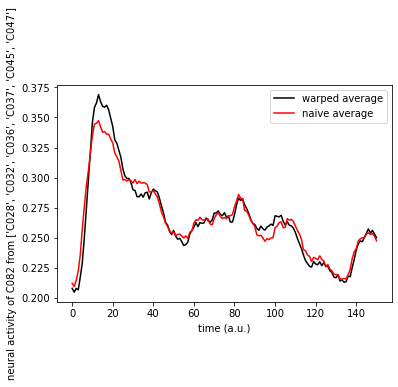

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 659.64it/s]


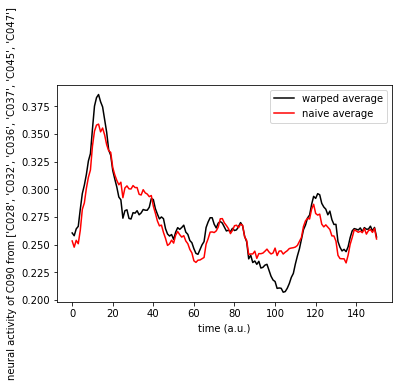

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 895.24it/s]


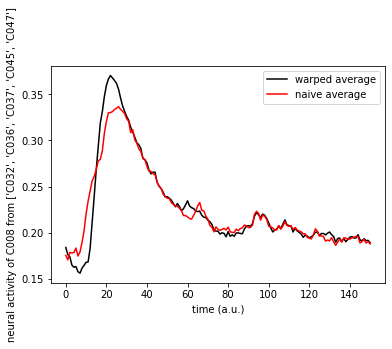

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 895.46it/s]


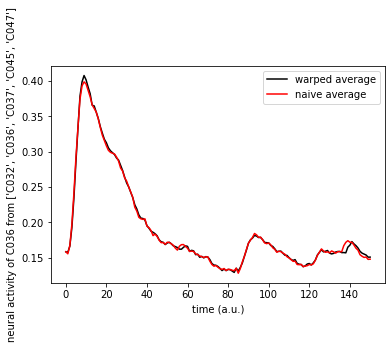

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 827.21it/s]


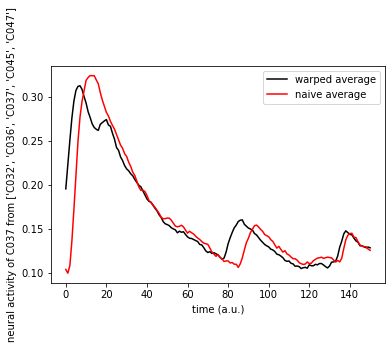

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.74it/s]


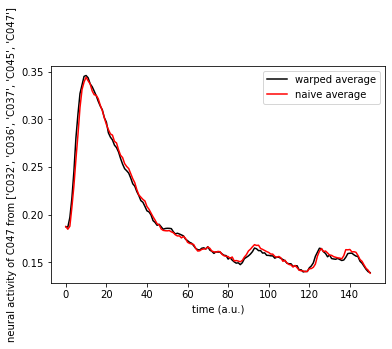

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 809.97it/s]


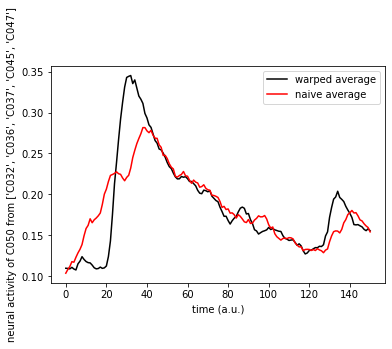

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.95it/s]


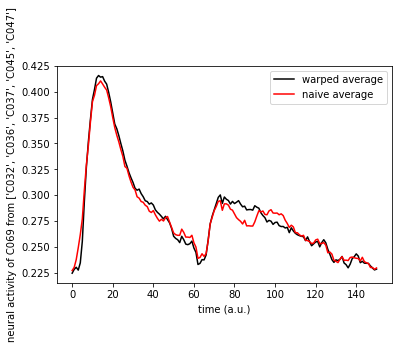

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 840.54it/s]


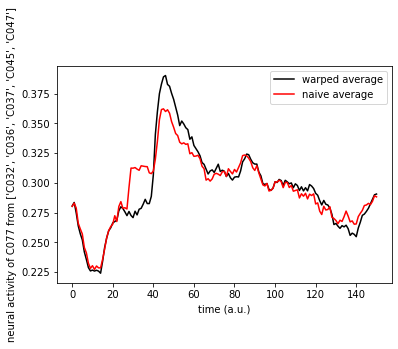

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.16it/s]


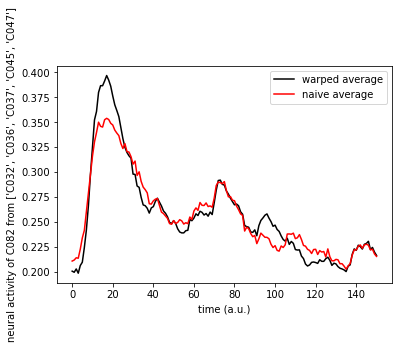

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 778.41it/s]


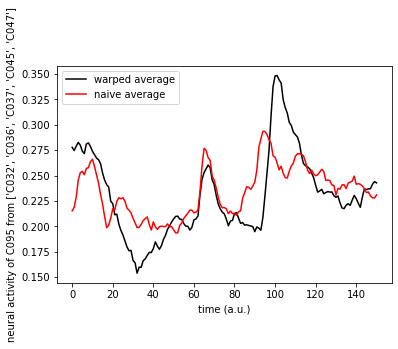

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.53it/s]


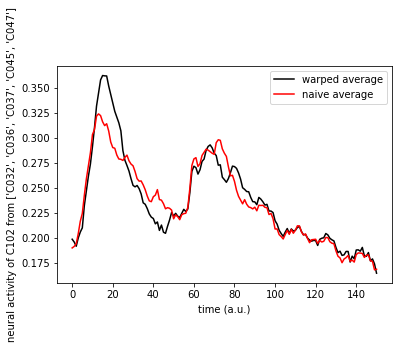

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 879.55it/s]


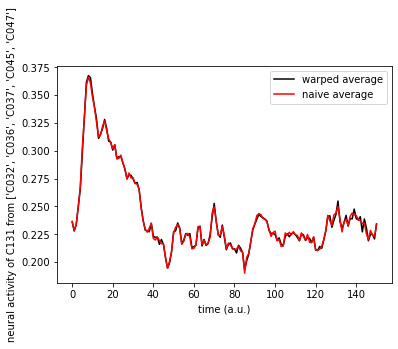

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.45it/s]


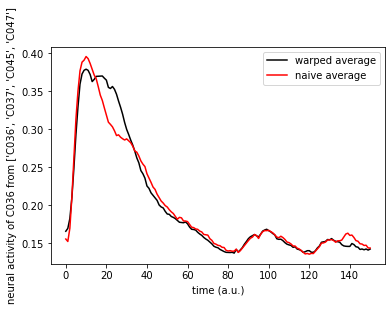

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 706.04it/s]


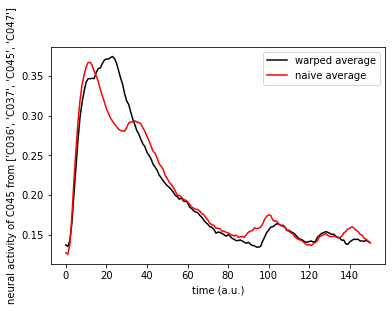

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 668.23it/s]


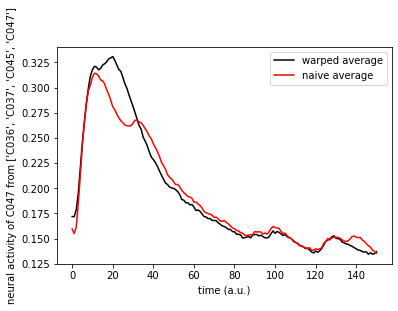

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


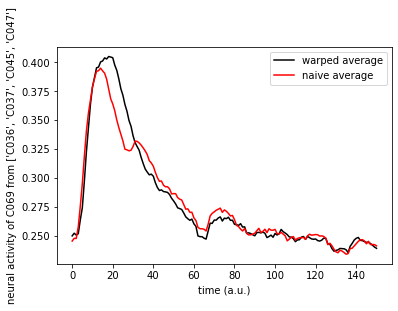

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.40it/s]


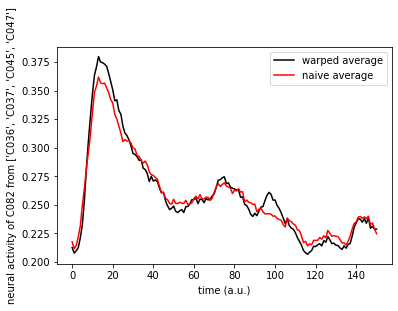

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 659.65it/s]


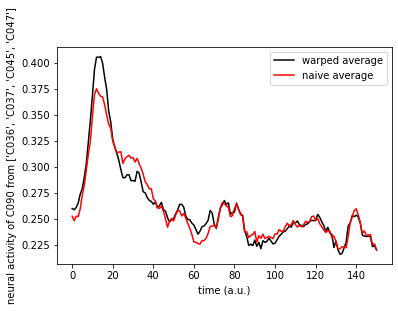

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 685.73it/s]


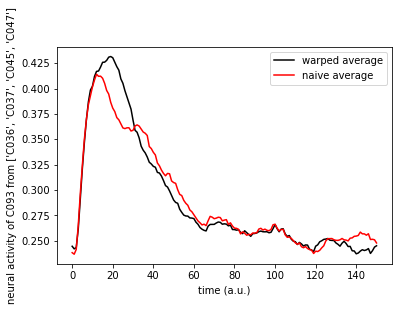

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


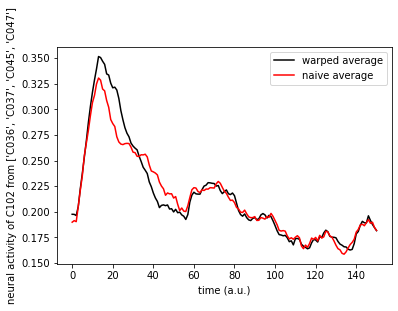

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 659.76it/s]


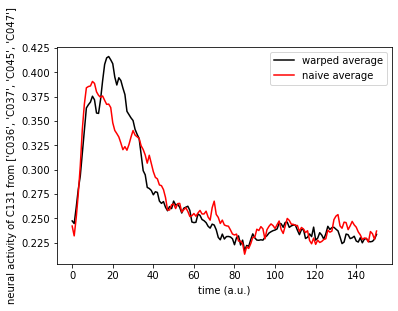

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 522.22it/s]


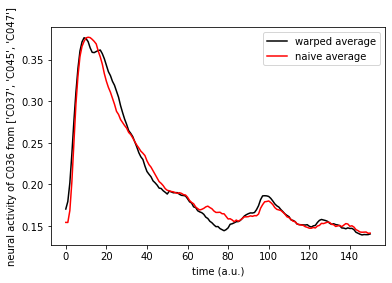

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 491.50it/s]


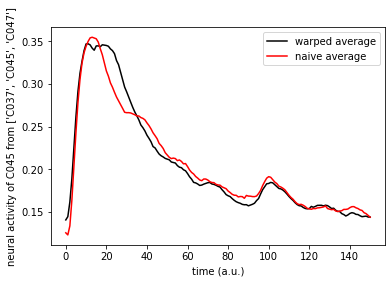

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 522.22it/s]


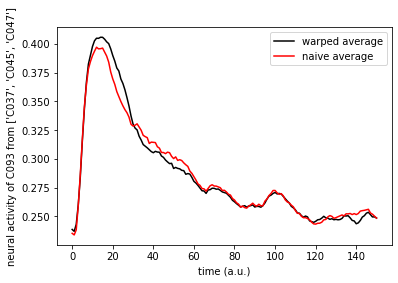

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.77it/s]


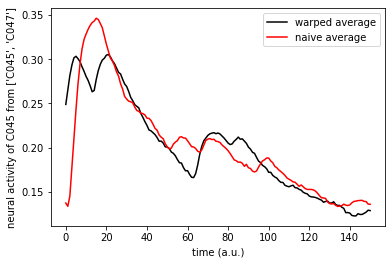

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 733.25it/s]


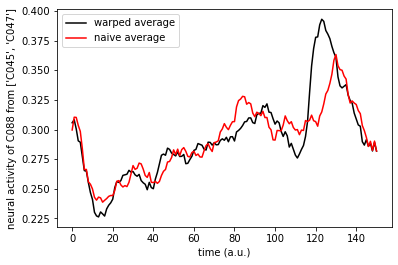

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 681.56it/s]


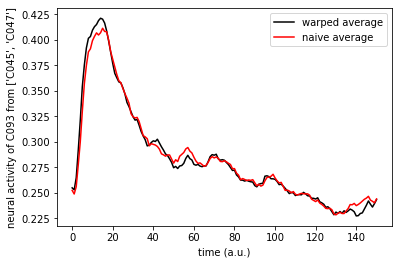

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.65it/s]


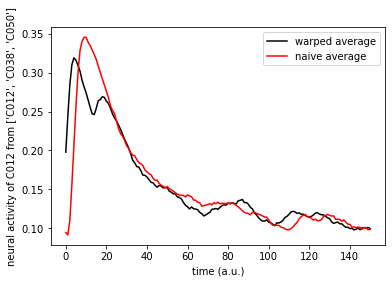

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 545.05it/s]


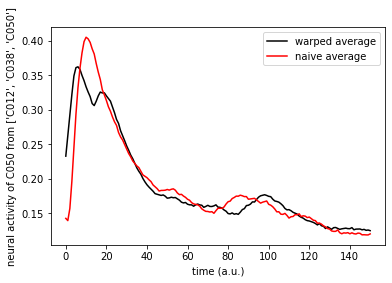

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 677.50it/s]


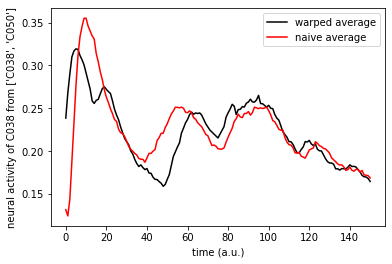

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 626.65it/s]


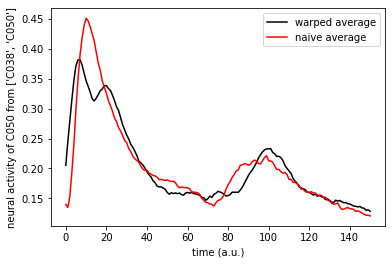

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


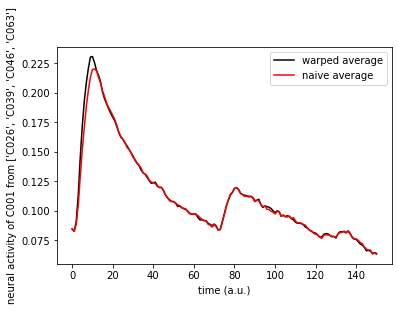

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


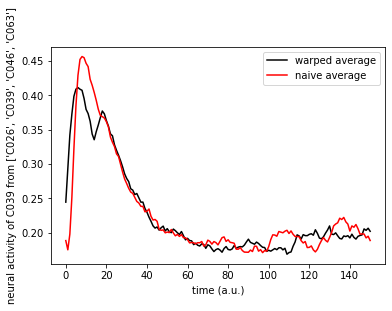

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 506.40it/s]


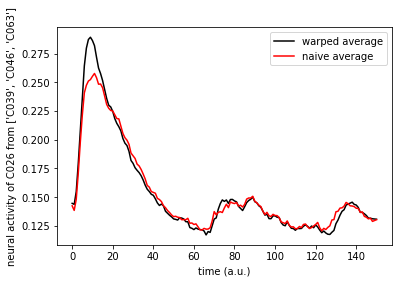

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 604.07it/s]


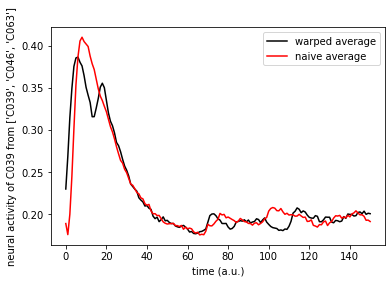

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 498.76it/s]


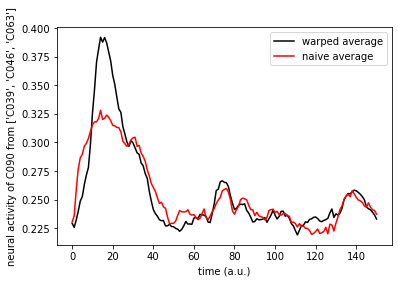

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 533.21it/s]


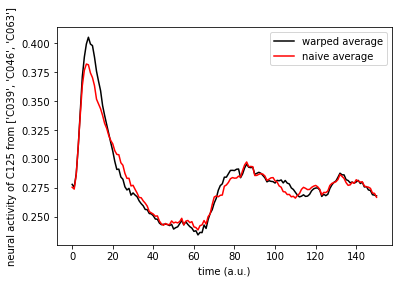

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 696.27it/s]


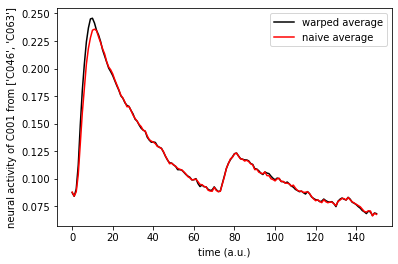

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


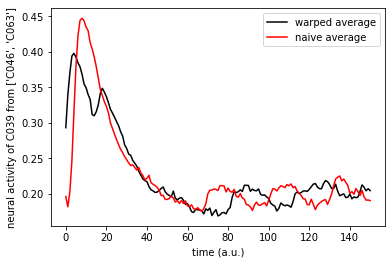

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 696.31it/s]


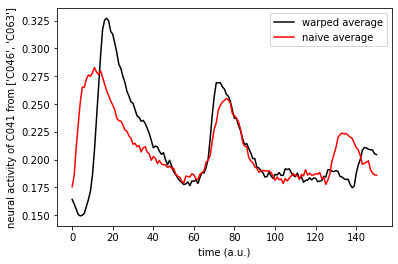

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


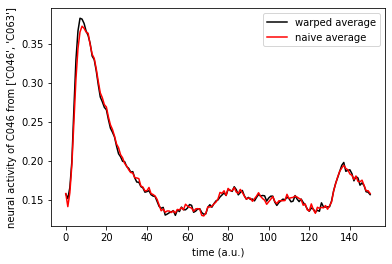

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 697.92it/s]


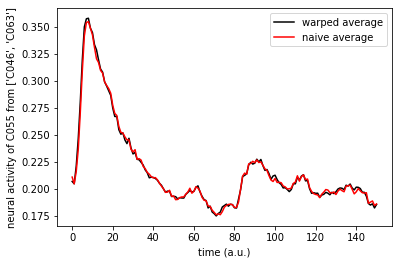

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


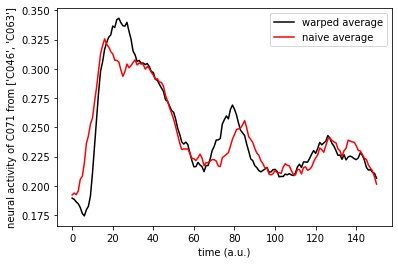

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.22it/s]


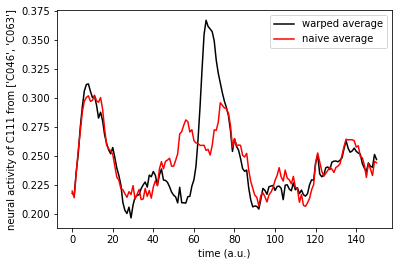

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 557.04it/s]


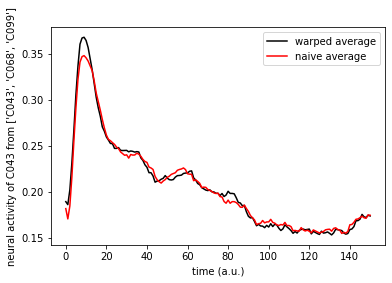

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 550.80it/s]


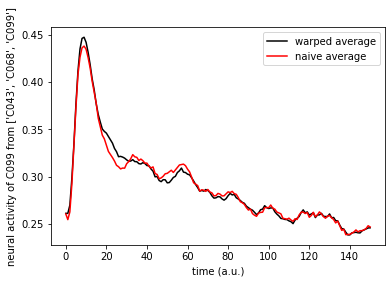

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.57it/s]


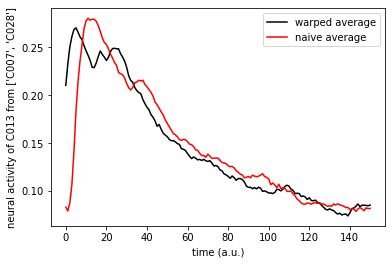

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.28it/s]


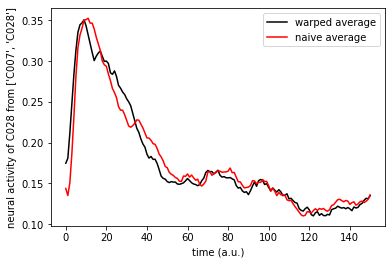

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


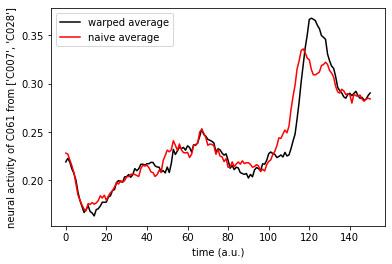

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 747.95it/s]


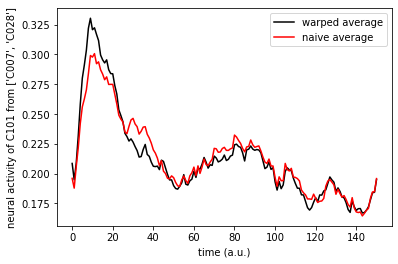

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


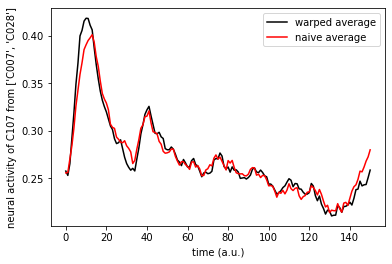

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.25it/s]


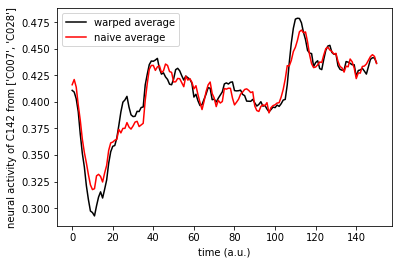

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 795.83it/s]


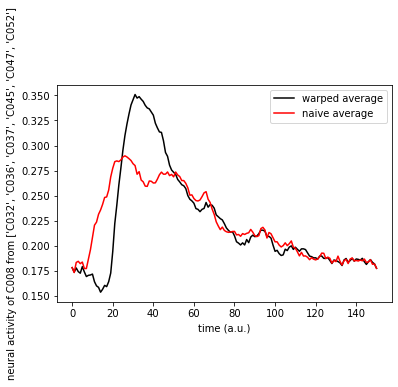

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.17it/s]


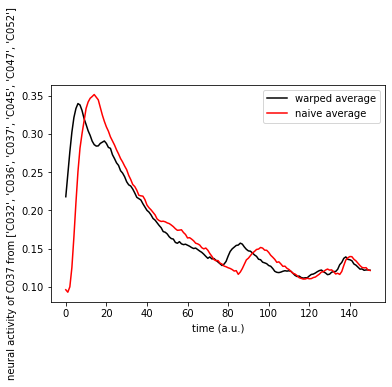

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.63it/s]


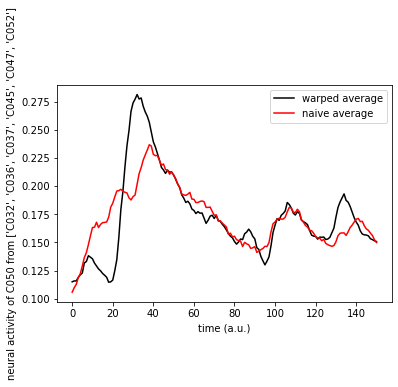

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 744.44it/s]


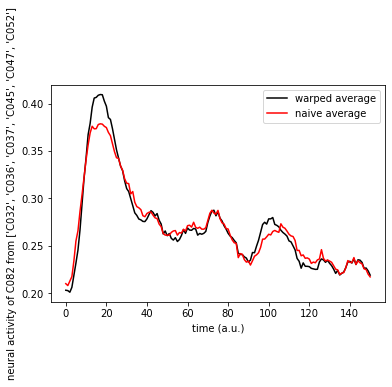

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.30it/s]


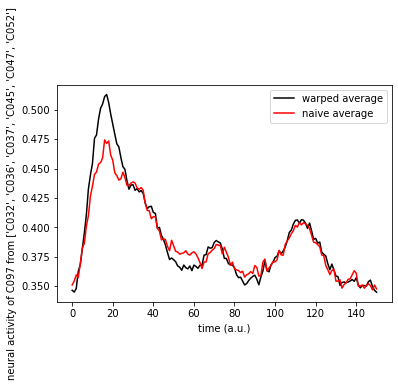

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 773.40it/s]


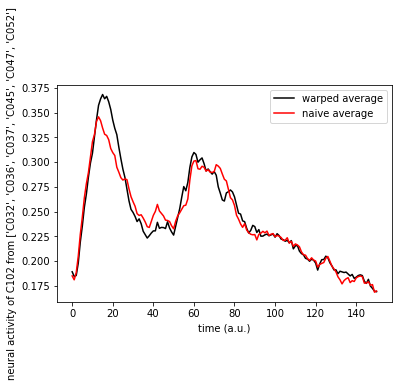

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 771.28it/s]


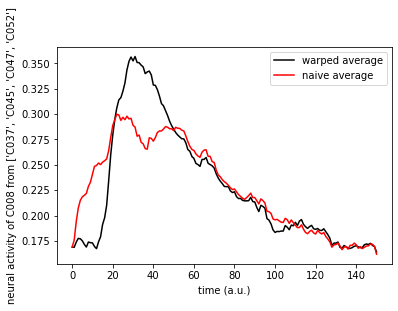

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


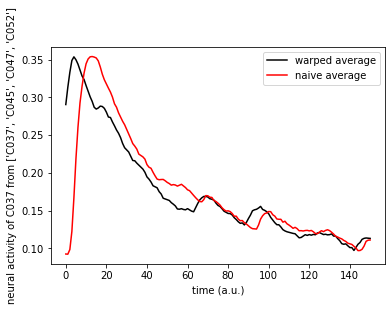

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


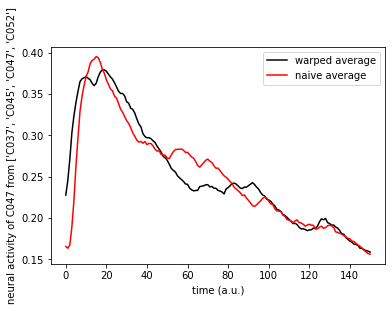

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 821.86it/s]


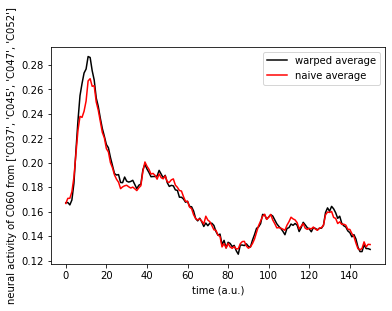

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


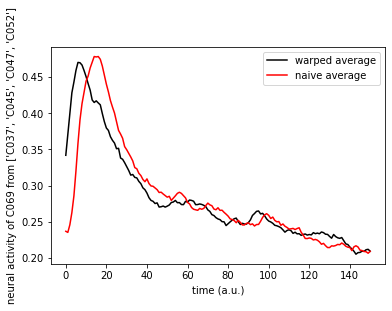

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


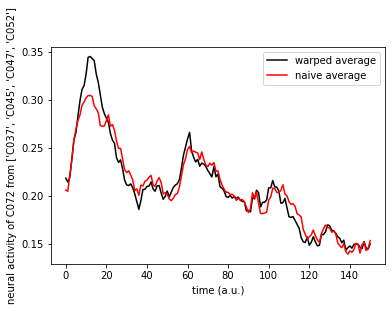

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.15it/s]


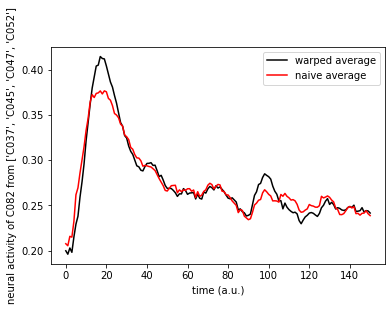

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.42it/s]


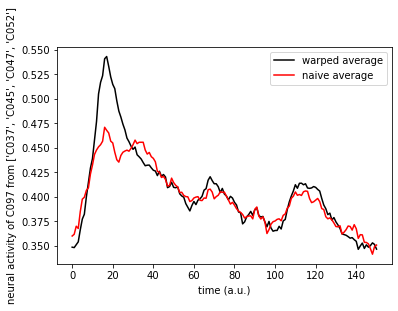

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 821.86it/s]


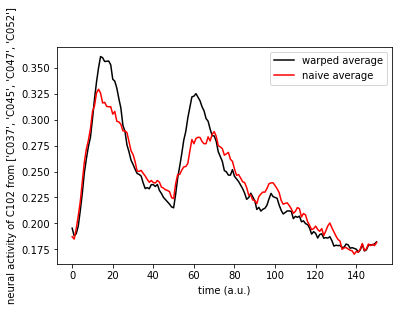

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.26it/s]


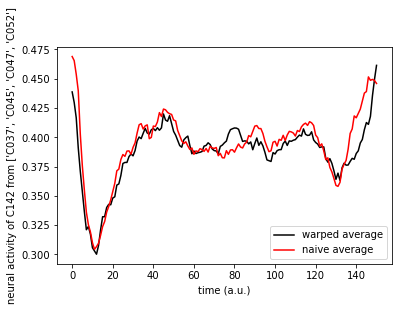

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 533.33it/s]


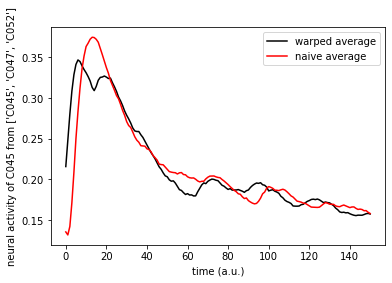

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 527.84it/s]


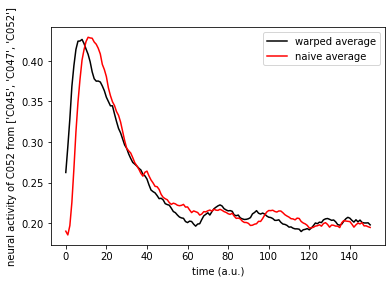

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 482.17it/s]


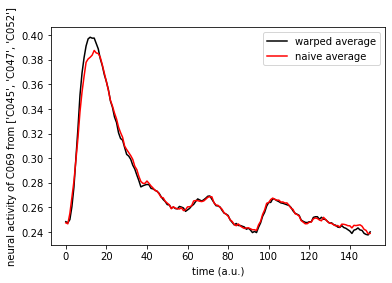

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 475.15it/s]


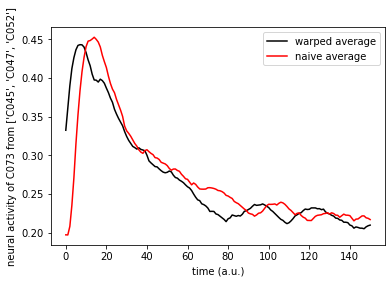

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 775.16it/s]


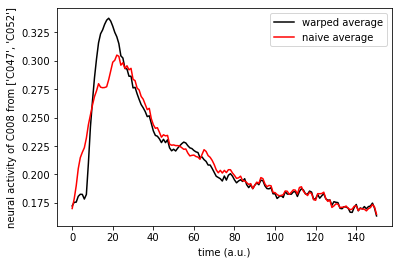

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 783.12it/s]


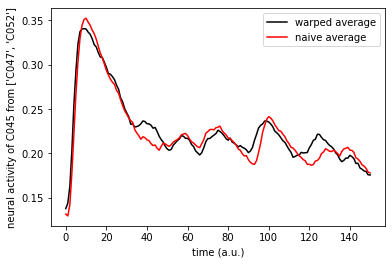

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.26it/s]


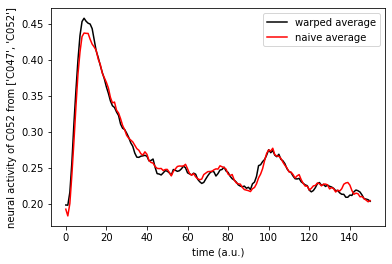

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.21it/s]


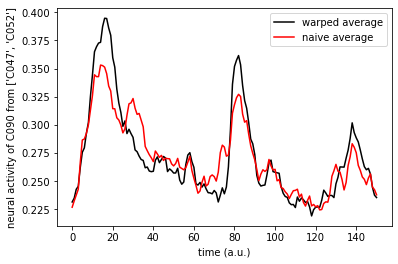

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 740.29it/s]


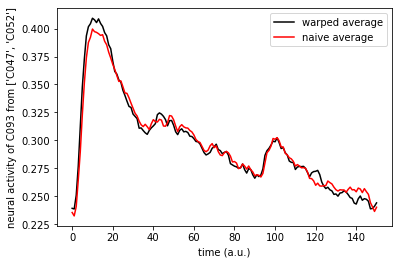

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


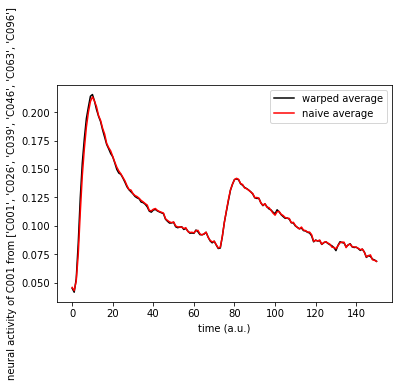

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 895.25it/s]


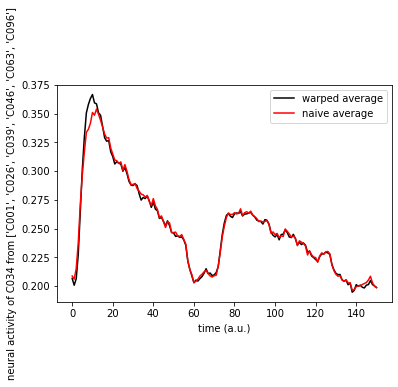

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


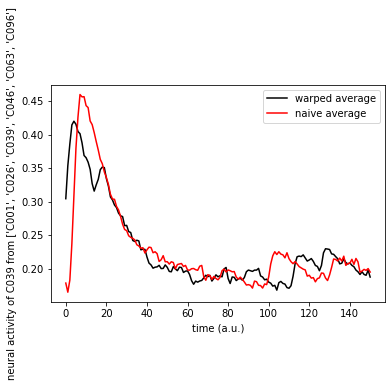

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


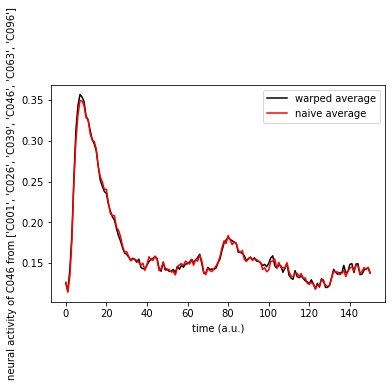

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


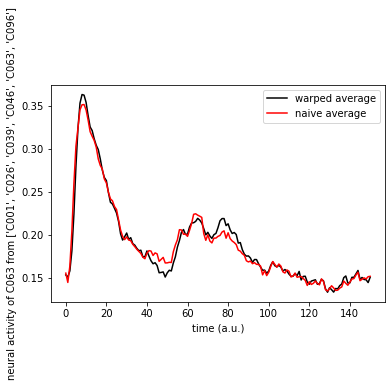

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 770.70it/s]


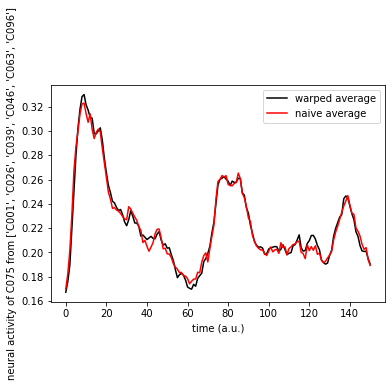

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.59it/s]


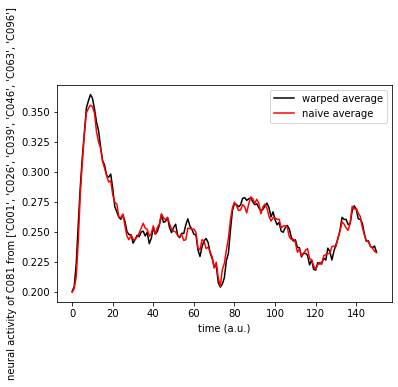

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 795.68it/s]


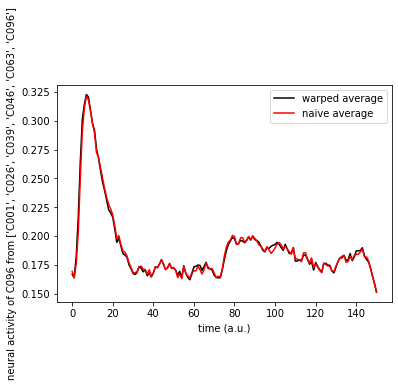

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


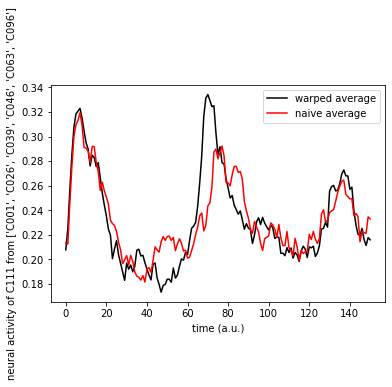

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 771.15it/s]


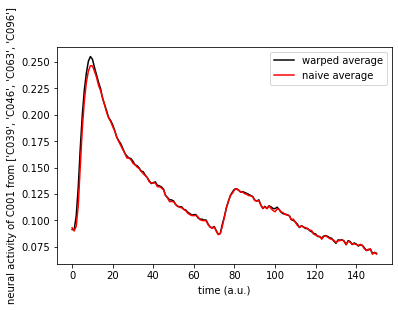

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.79it/s]


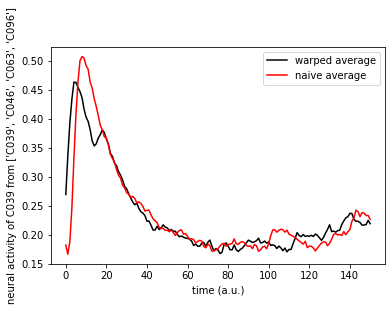

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 726.58it/s]


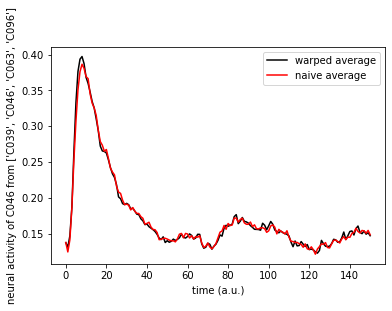

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 769.87it/s]


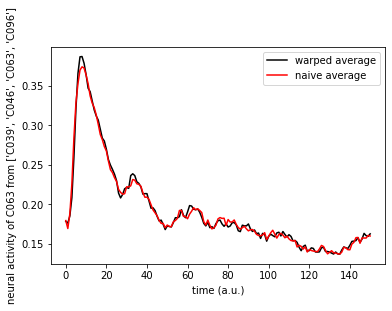

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


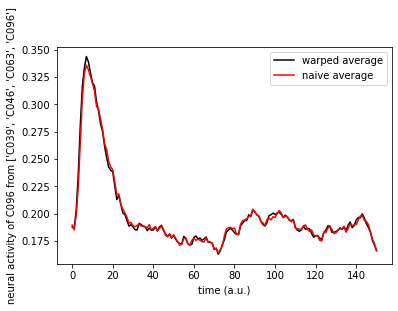

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 576.08it/s]


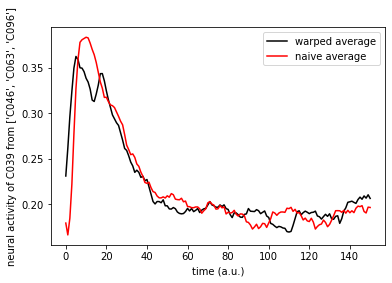

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 569.79it/s]


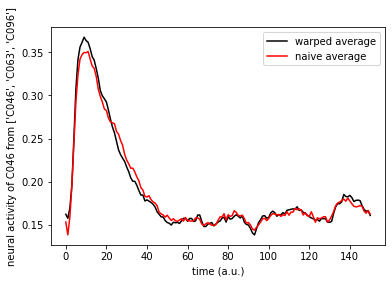

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 563.48it/s]


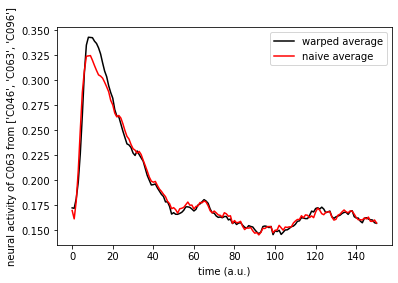

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 563.31it/s]


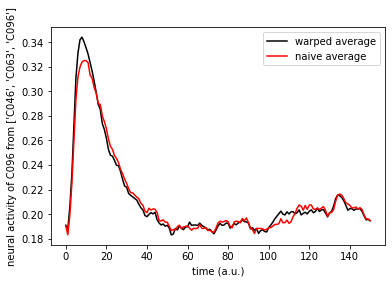

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 558.69it/s]


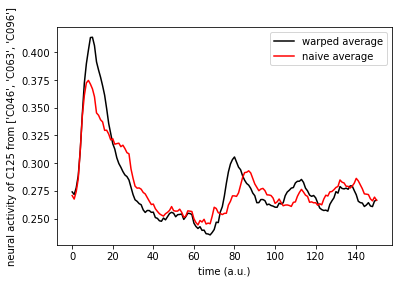

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 849.82it/s]


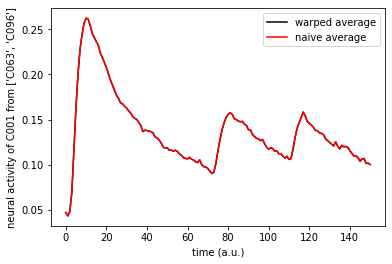

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 983.02it/s]


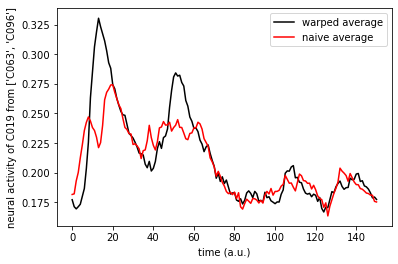

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1002.66it/s]


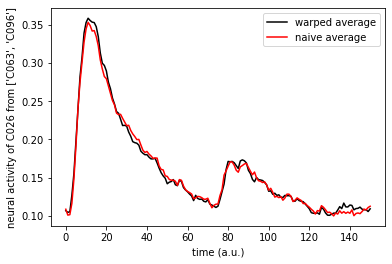

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 964.11it/s]


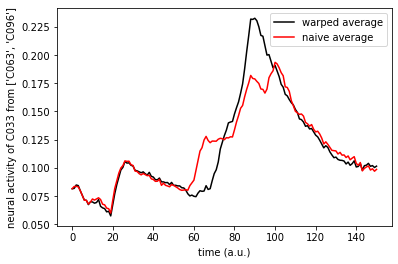

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1002.68it/s]


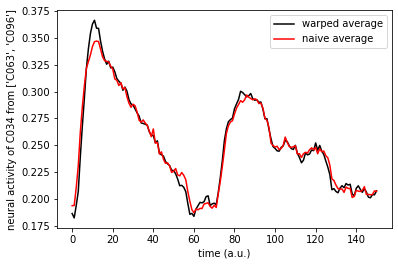

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1044.42it/s]


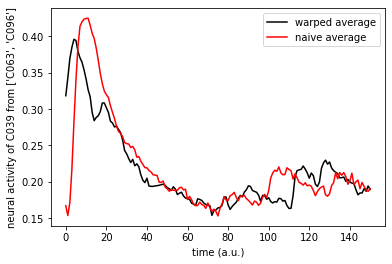

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 983.01it/s]


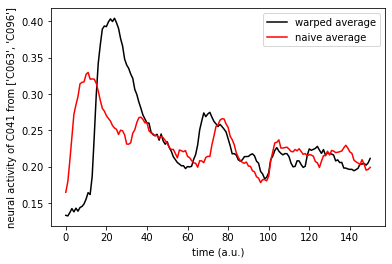

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 1023.18it/s]


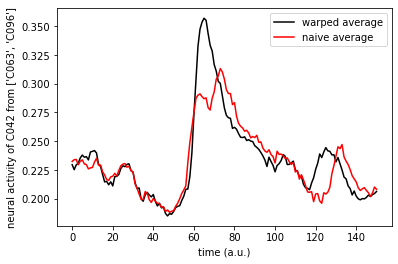

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.60it/s]


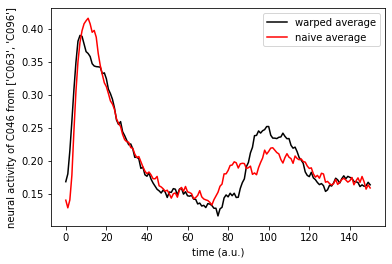

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 821.87it/s]


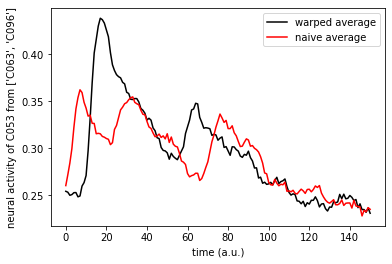

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.59it/s]


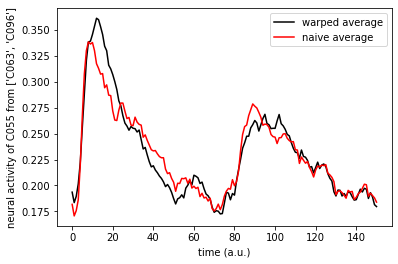

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.85it/s]


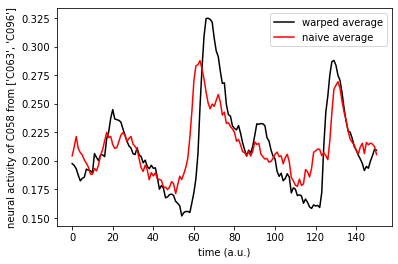

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.64it/s]


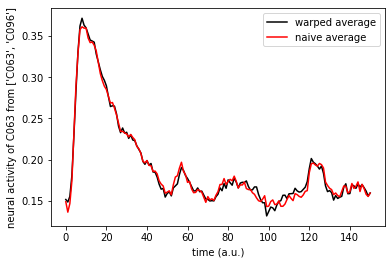

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.61it/s]


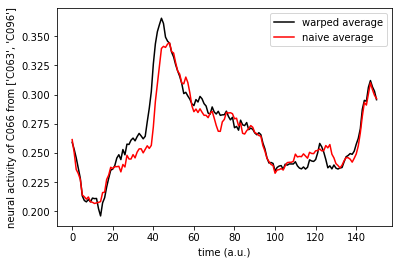

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 849.80it/s]


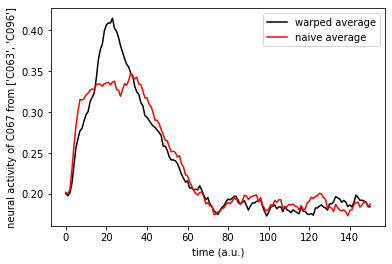

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.53it/s]


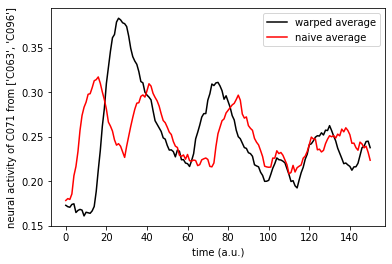

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 911.53it/s]


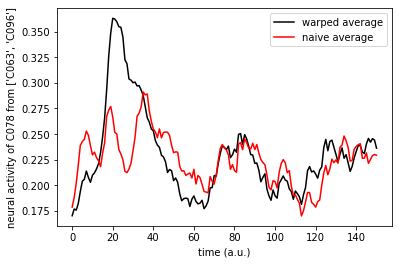

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 835.57it/s]


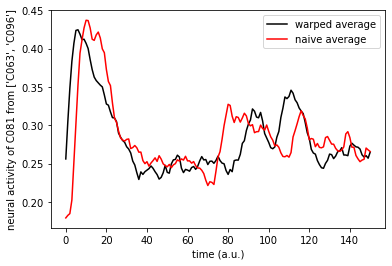

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.78it/s]


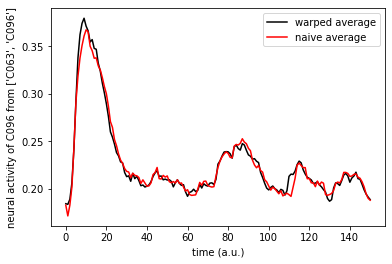

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 835.55it/s]


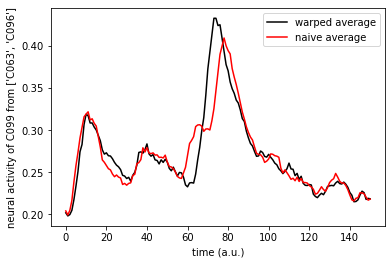

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 835.56it/s]


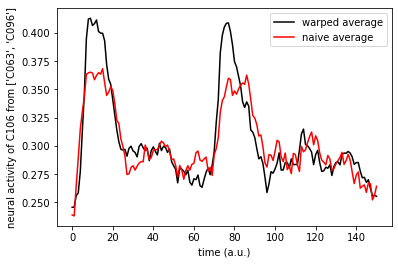

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.68it/s]


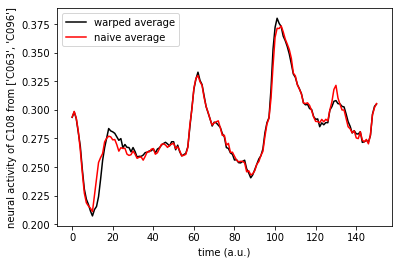

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.87it/s]


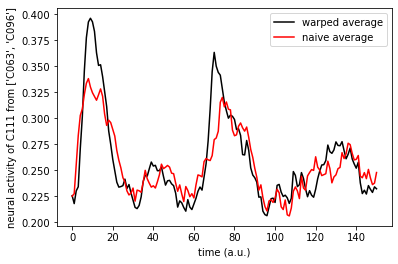

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 864.38it/s]


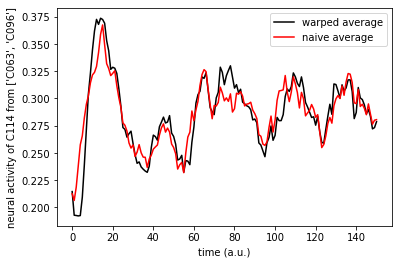

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.60it/s]


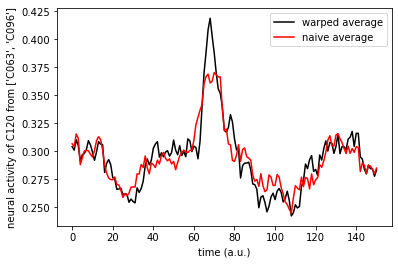

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


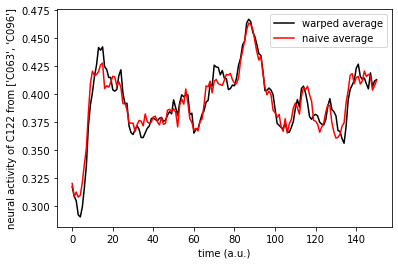

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.51it/s]


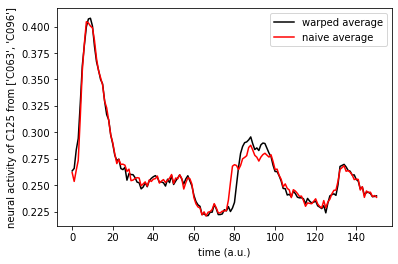

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.98it/s]


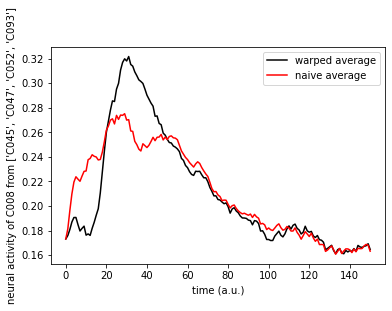

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 737.25it/s]


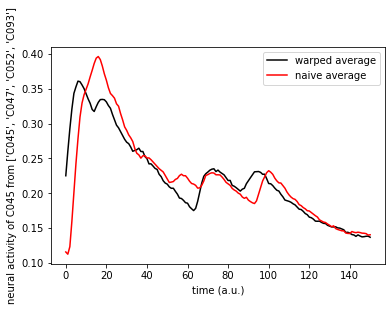

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 795.78it/s]


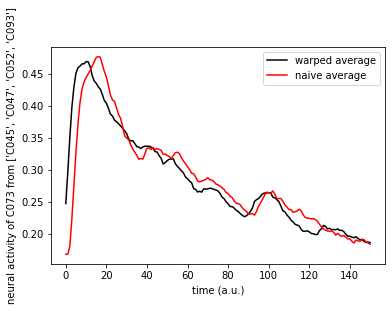

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 708.31it/s]


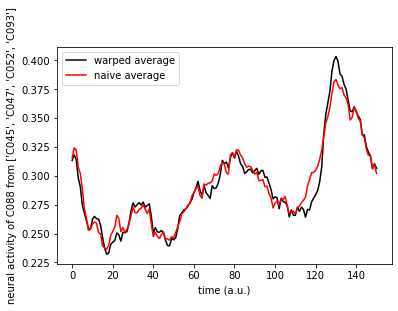

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


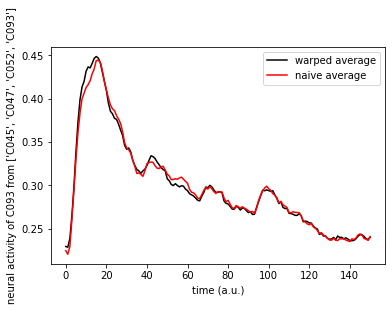

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 550.76it/s]


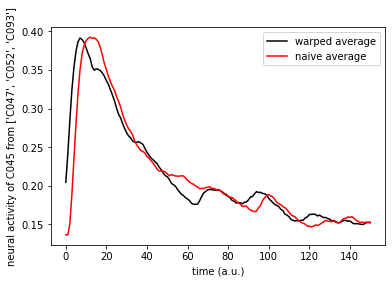

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 569.69it/s]


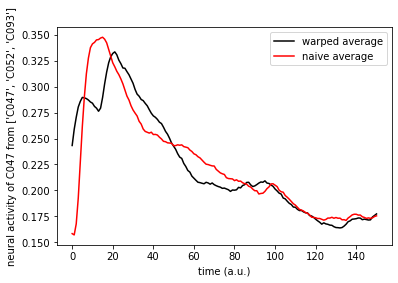

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 577.58it/s]


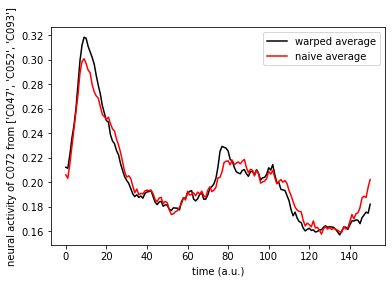

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 558.46it/s]


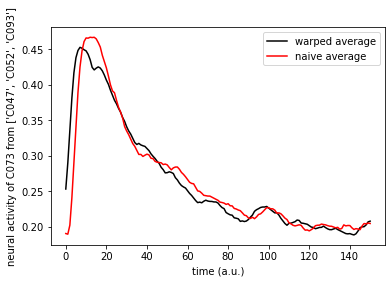

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 835.55it/s]


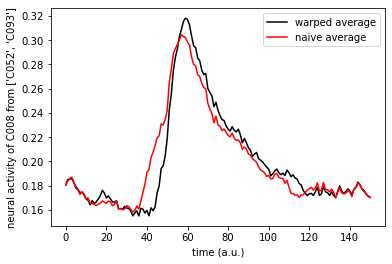

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.06it/s]


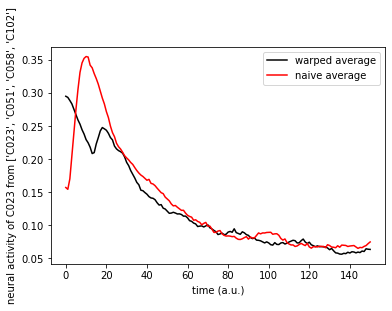

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


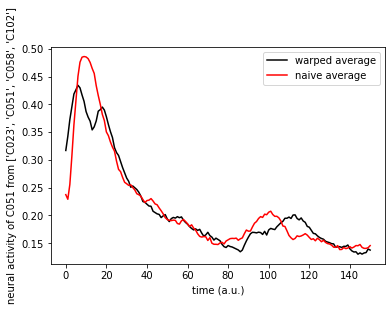

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.08it/s]


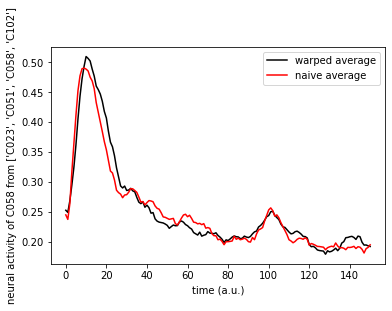

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.34it/s]


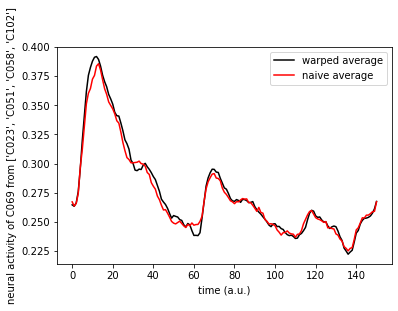

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.66it/s]


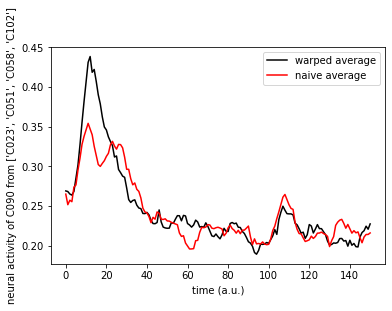

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 421.27it/s]


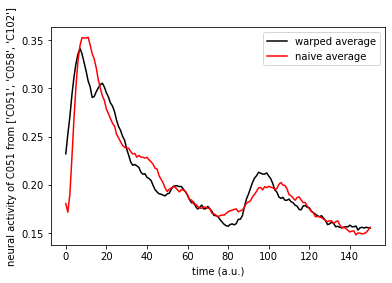

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 681.60it/s]


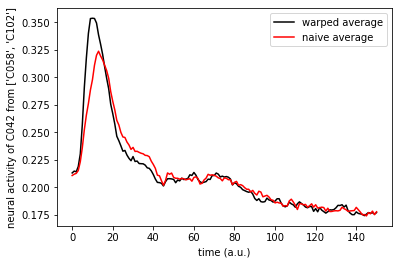

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


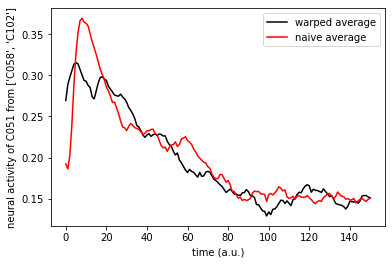

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.54it/s]


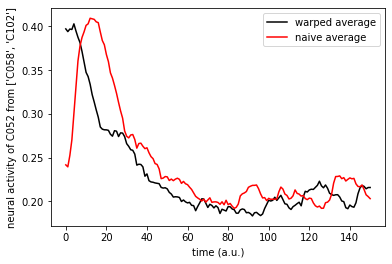

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.12it/s]


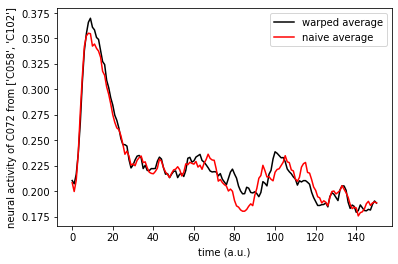

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.29it/s]


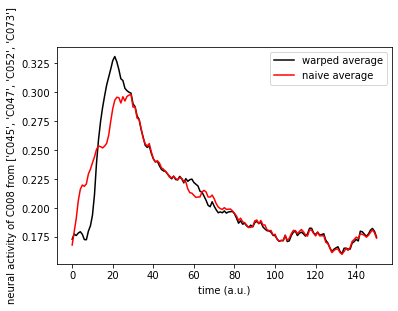

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 772.63it/s]


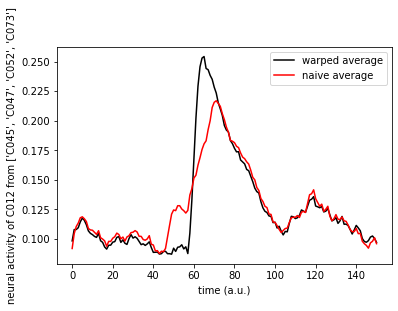

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 783.04it/s]


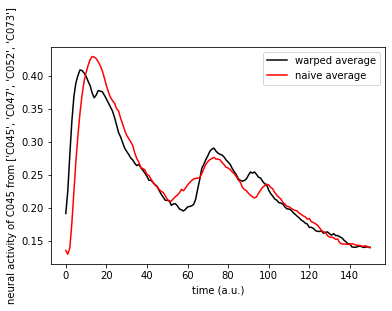

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 748.11it/s]


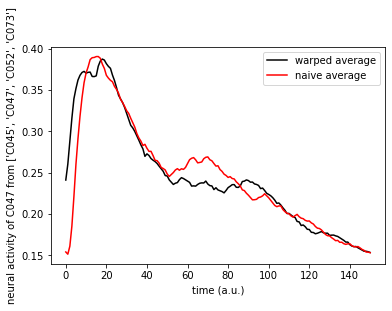

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.31it/s]


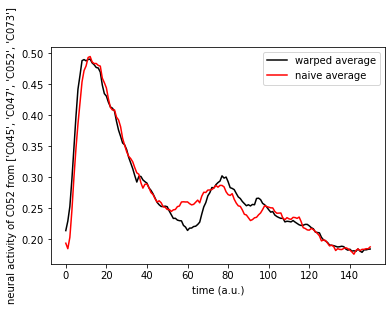

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 798.88it/s]


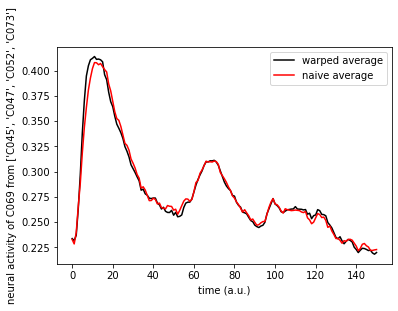

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 582.96it/s]


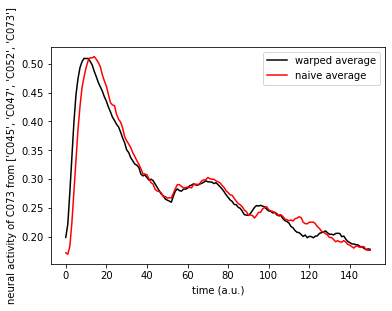

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


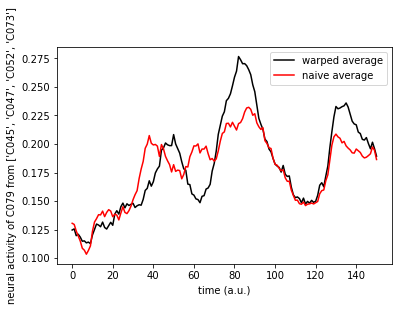

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 577.71it/s]


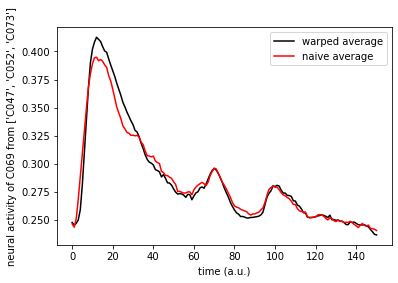

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 501.34it/s]


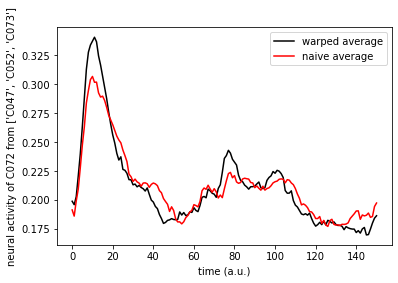

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 536.43it/s]


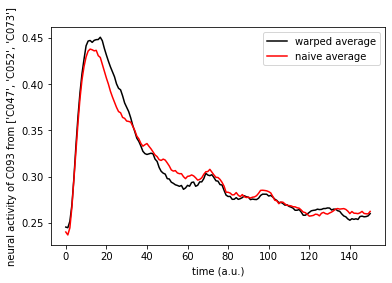

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 533.38it/s]


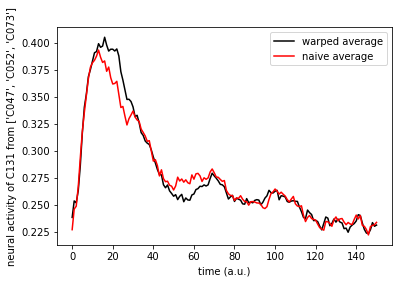

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


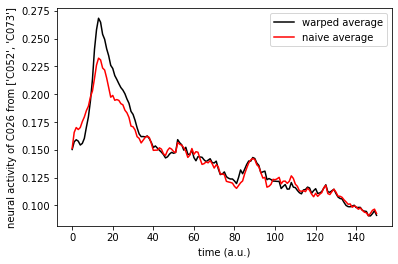

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 726.57it/s]


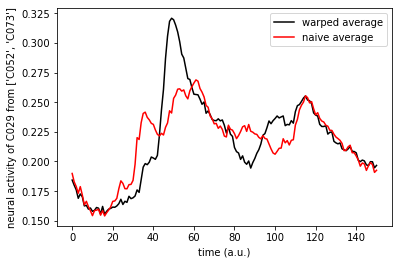

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 726.56it/s]


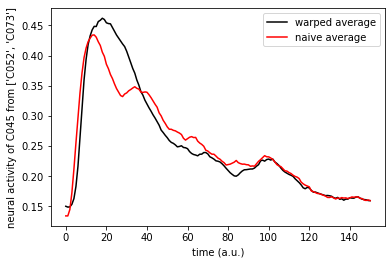

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 696.30it/s]


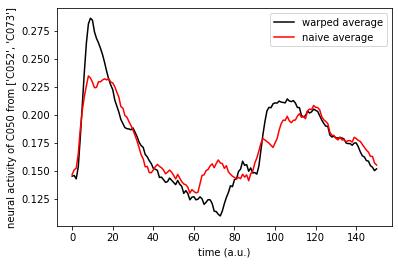

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 718.97it/s]


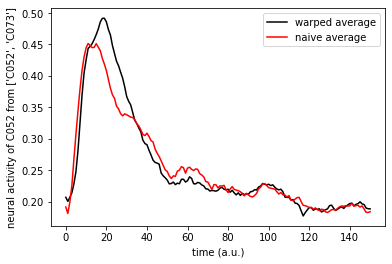

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.37it/s]


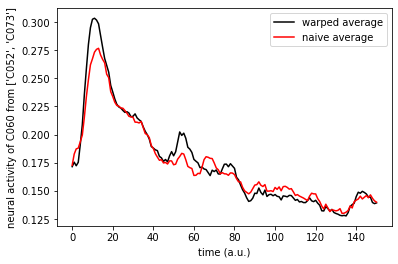

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.01it/s]


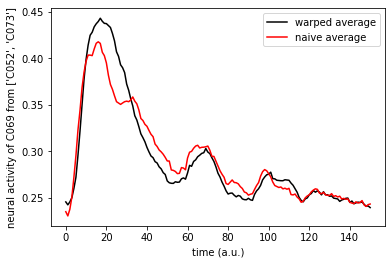

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


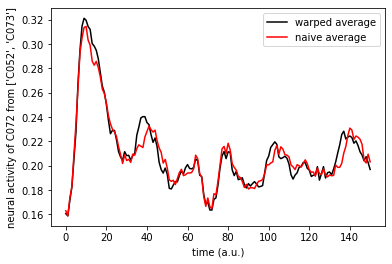

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.57it/s]


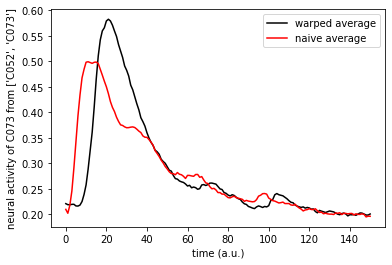

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 700.31it/s]


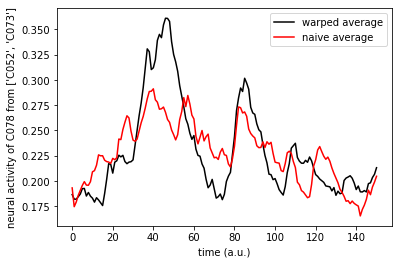

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 714.42it/s]


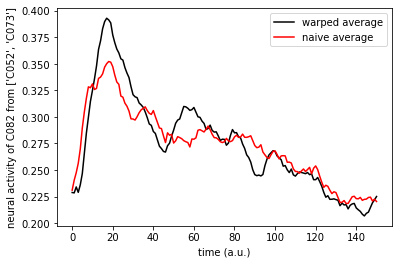

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.27it/s]


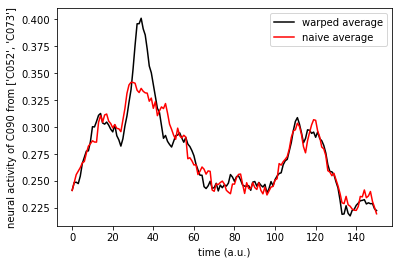

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.47it/s]


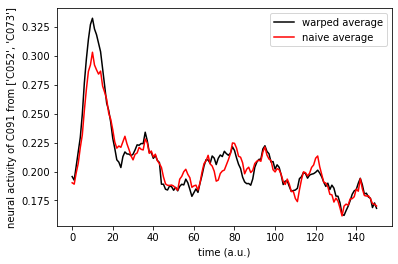

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


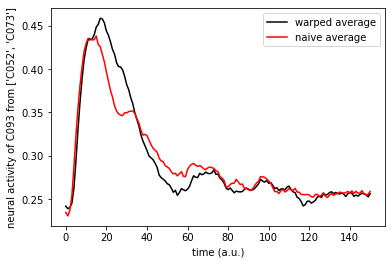

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.20it/s]


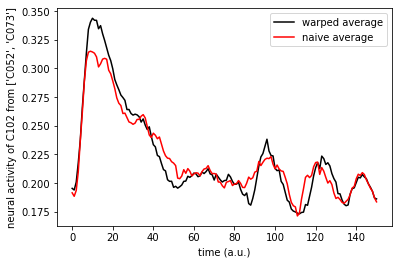

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 731.88it/s]


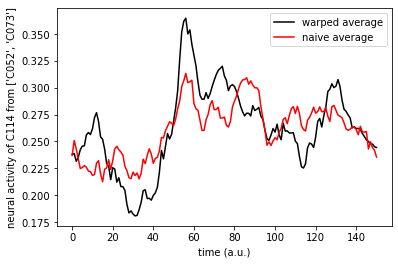

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.77it/s]


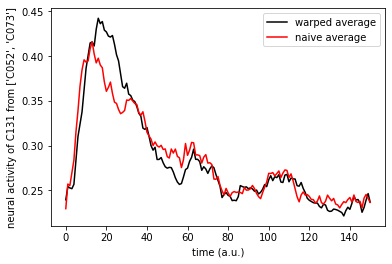

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.57it/s]


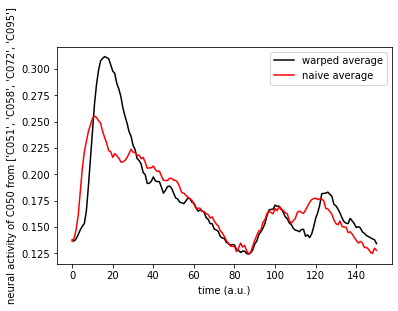

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.30it/s]


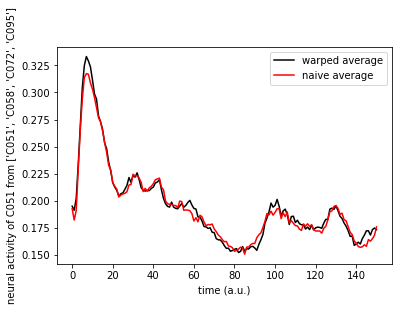

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.27it/s]


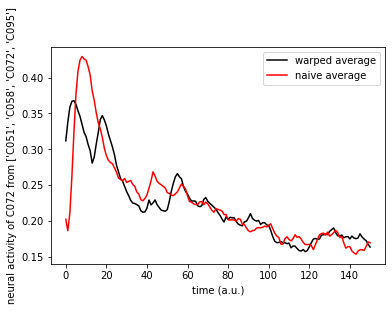

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.78it/s]


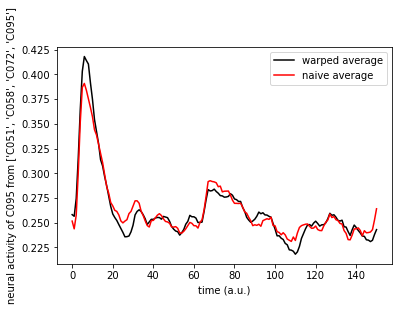

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.73it/s]


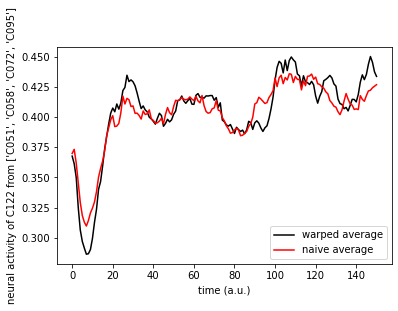

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 394.75it/s]


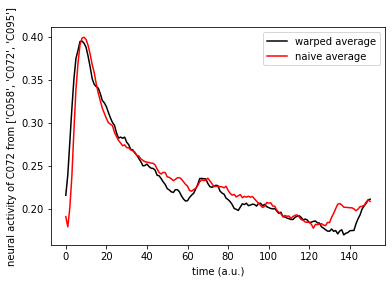

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 659.64it/s]


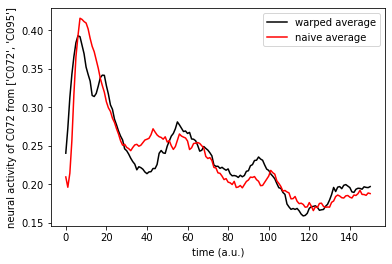

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 715.96it/s]


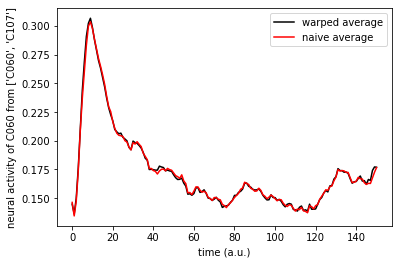

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 677.48it/s]


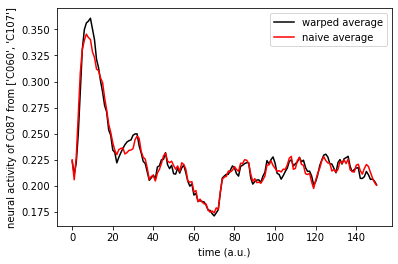

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.11it/s]


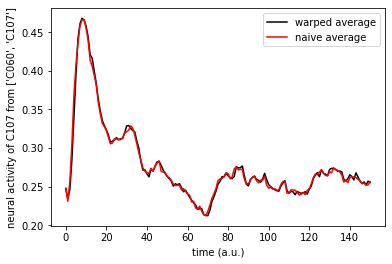

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 686.75it/s]


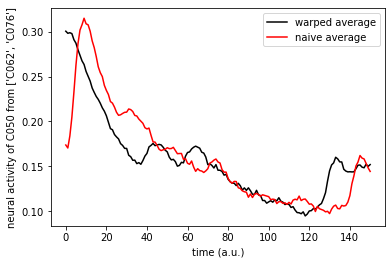

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 726.73it/s]


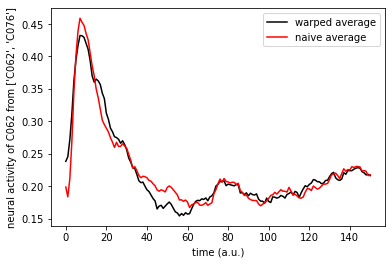

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 777.78it/s]


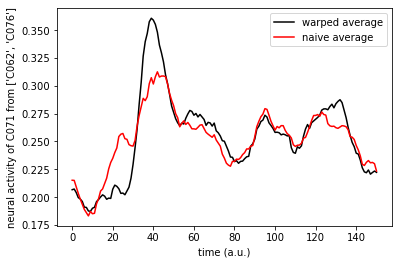

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 718.11it/s]


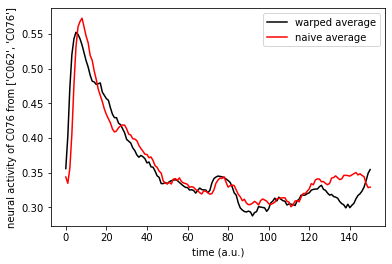

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 486.74it/s]


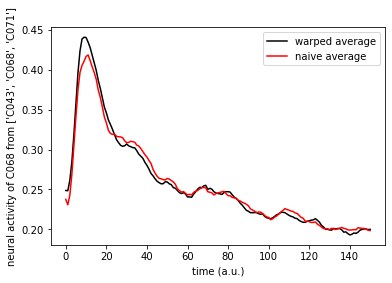

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 621.82it/s]


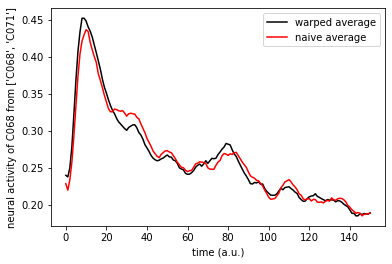

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 491.51it/s]


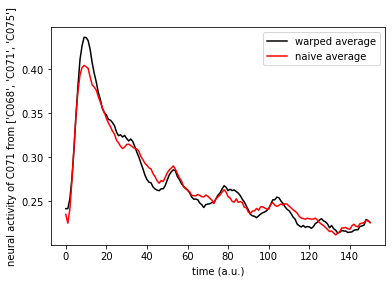

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 634.81it/s]


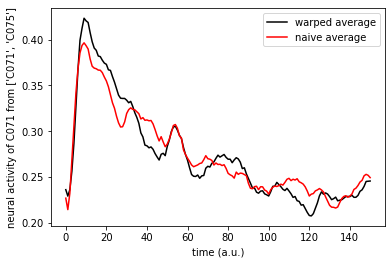

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 611.39it/s]


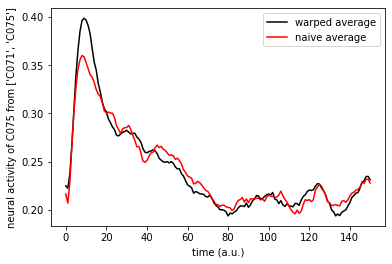

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 376.89it/s]


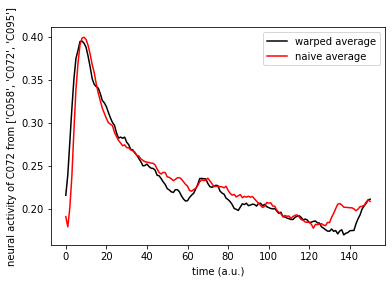

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.09it/s]


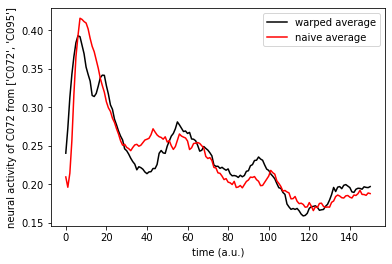

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 576.45it/s]


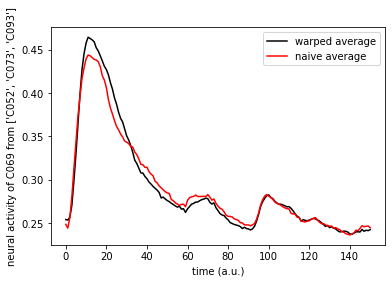

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 556.98it/s]


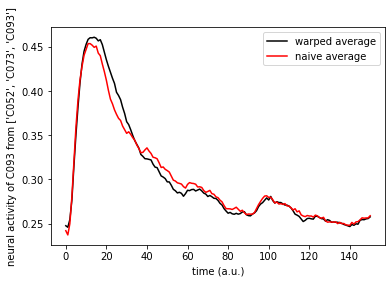

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 775.49it/s]


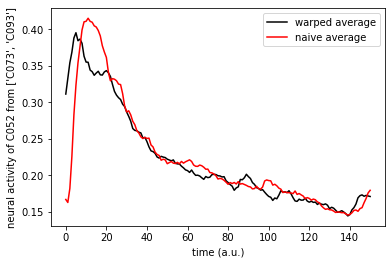

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.78it/s]


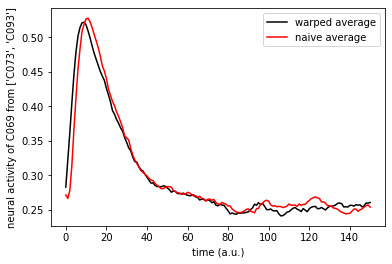

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 808.62it/s]


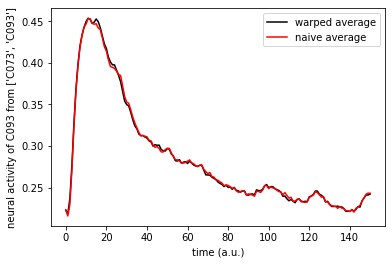

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.79it/s]


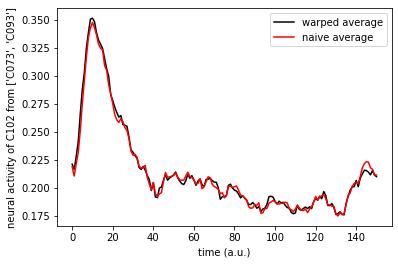

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 789.39it/s]


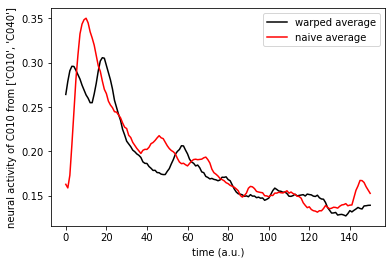

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.56it/s]


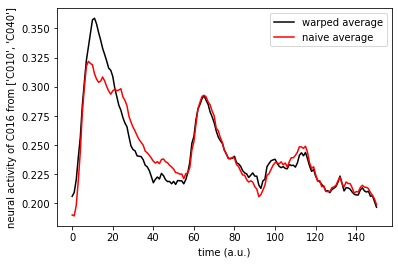

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 771.16it/s]


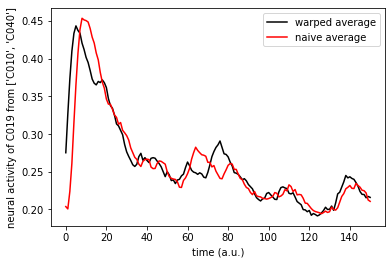

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 759.75it/s]


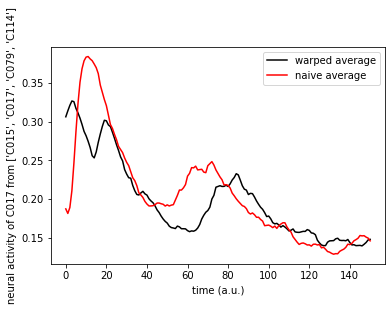

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 742.60it/s]


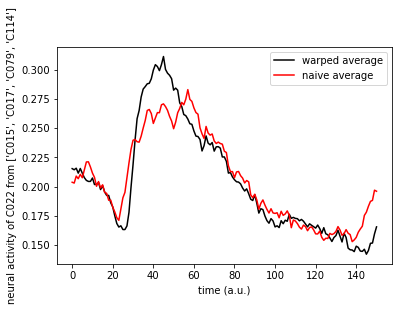

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.23it/s]


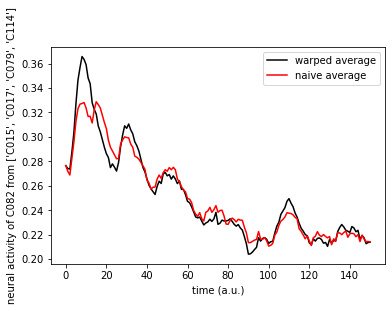

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


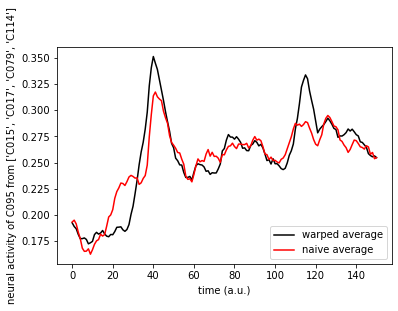

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


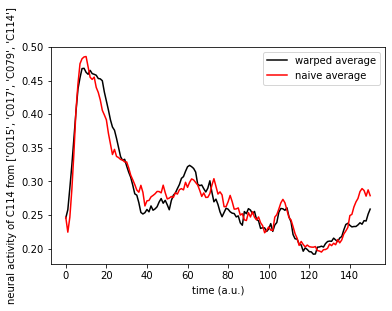

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 421.29it/s]


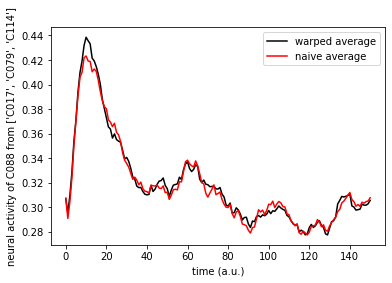

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 516.84it/s]


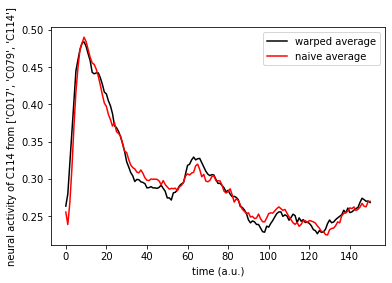

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.09it/s]


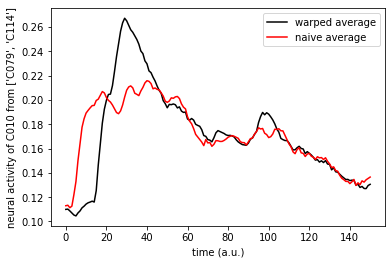

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 714.72it/s]


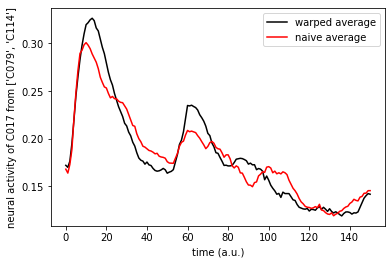

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 706.10it/s]


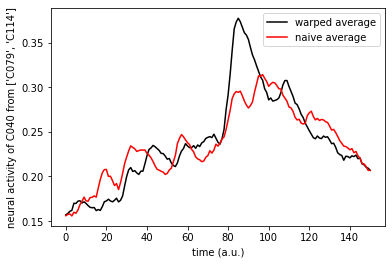

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.77it/s]


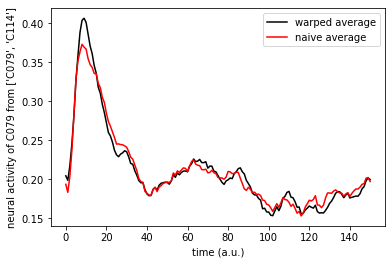

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 864.40it/s]


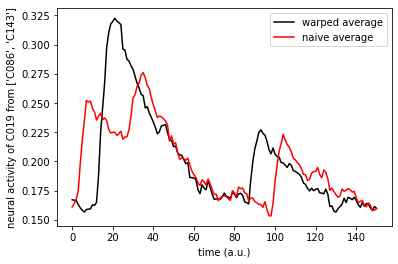

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.31it/s]


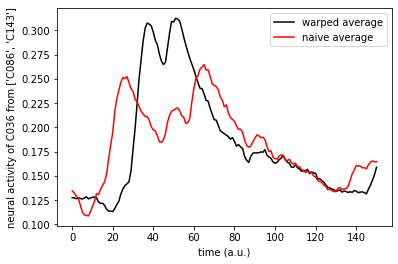

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 828.48it/s]


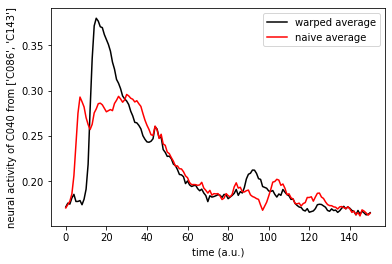

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 864.40it/s]


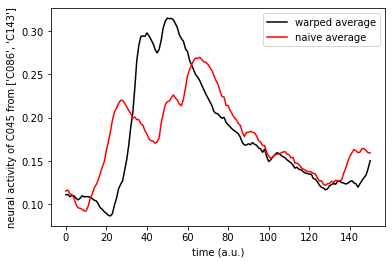

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 822.11it/s]


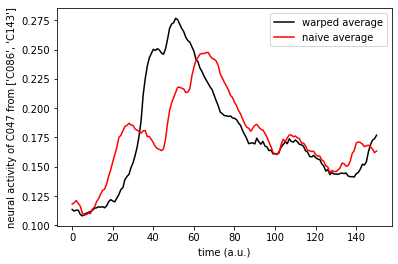

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 764.05it/s]


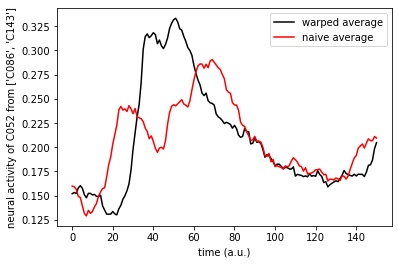

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 821.86it/s]


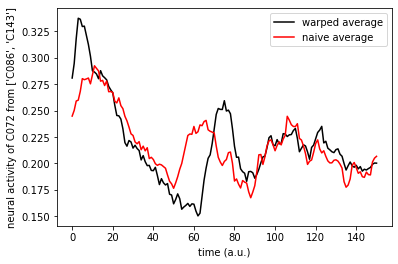

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.60it/s]


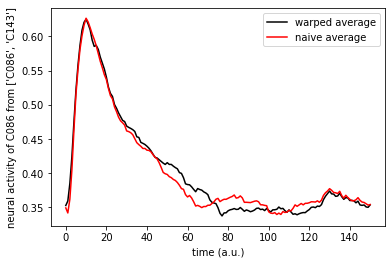

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 864.38it/s]


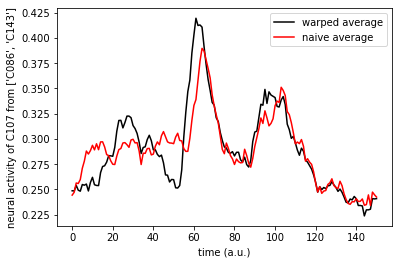

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.54it/s]


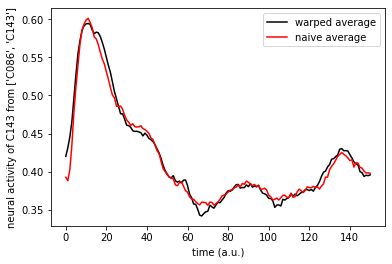

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 615.90it/s]


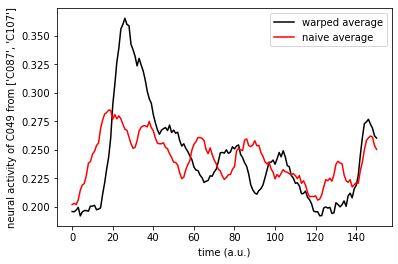

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 611.38it/s]


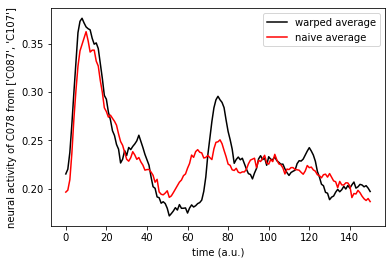

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 603.96it/s]


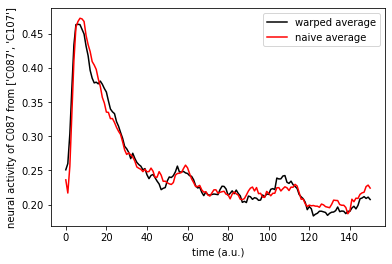

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 634.59it/s]


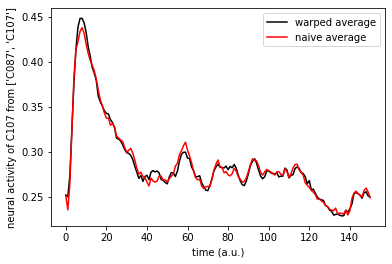

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 789.39it/s]


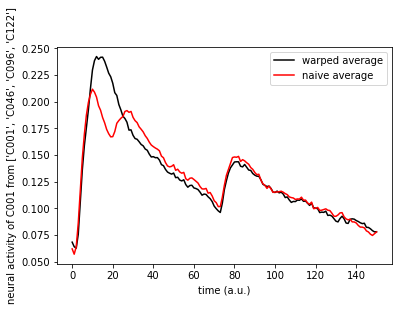

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 833.40it/s]


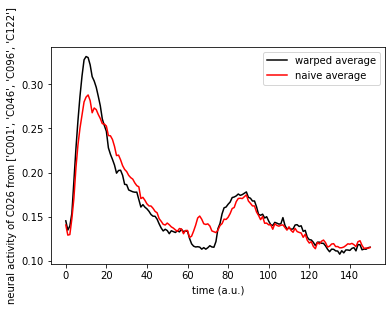

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 879.54it/s]


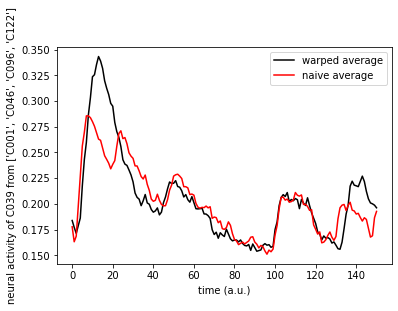

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 808.58it/s]


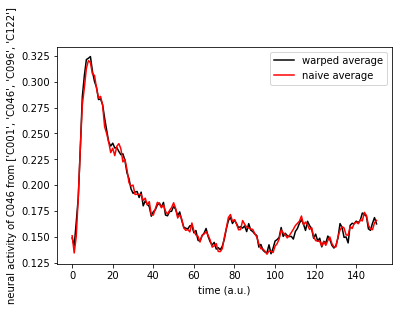

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


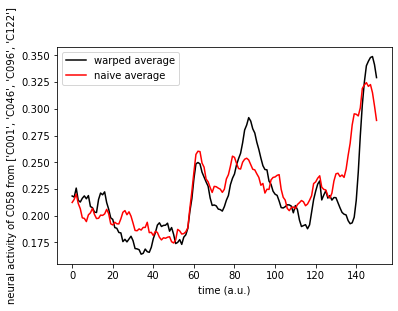

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 771.29it/s]


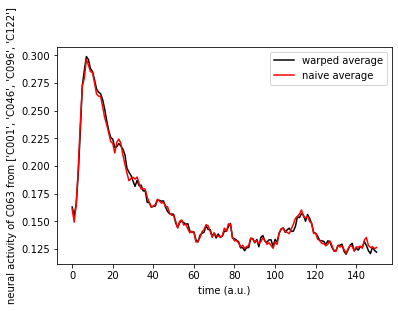

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 808.61it/s]


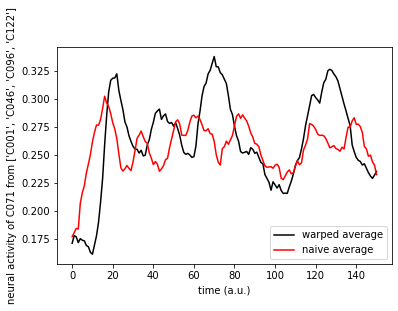

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.75it/s]


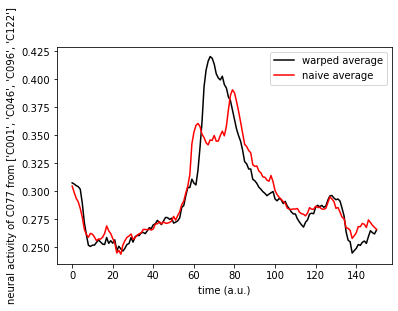

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.97it/s]


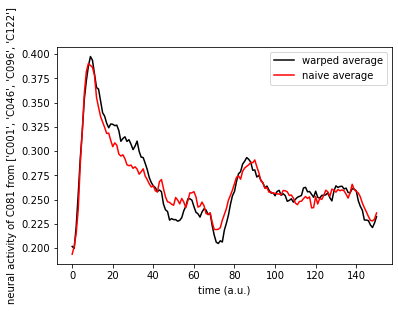

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 849.72it/s]


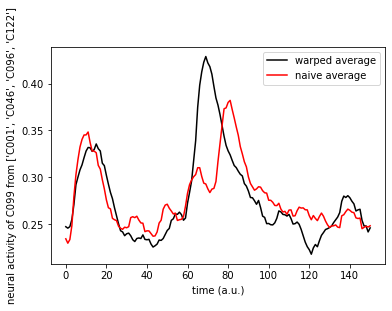

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 795.77it/s]


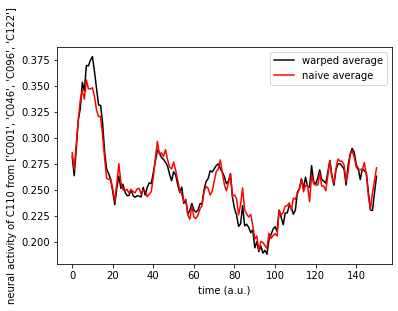

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.26it/s]


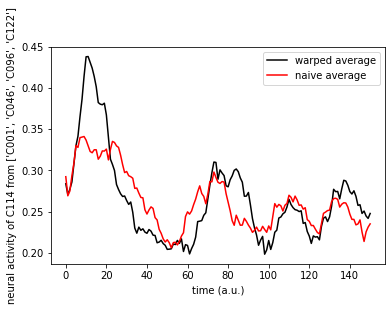

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.33it/s]


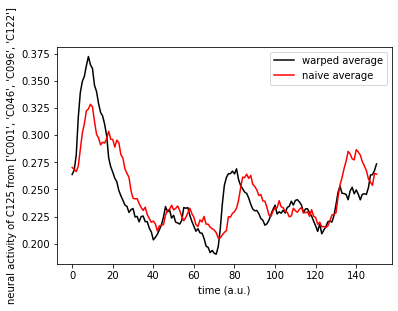

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 726.67it/s]


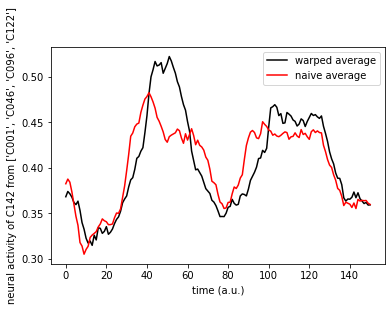

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 490.86it/s]


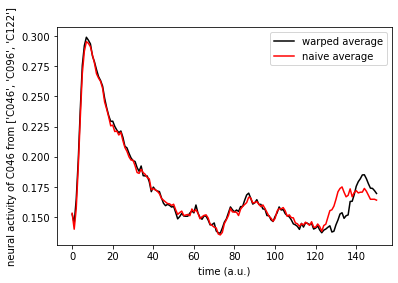

Loss: 0.00: 100%|██████████| 50/50 [00:00<00:00, 527.67it/s]


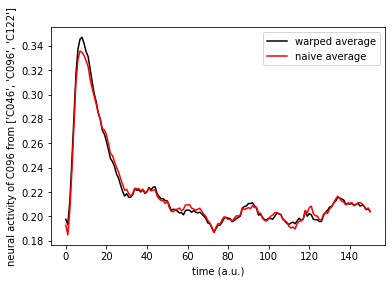

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 731.11it/s]


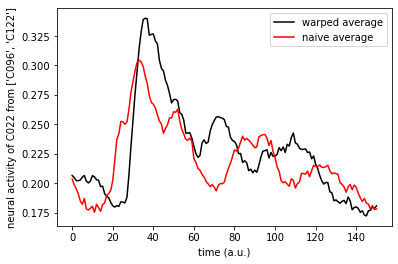

Loss: 0.02: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


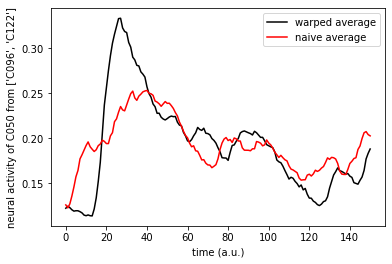

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 706.12it/s]


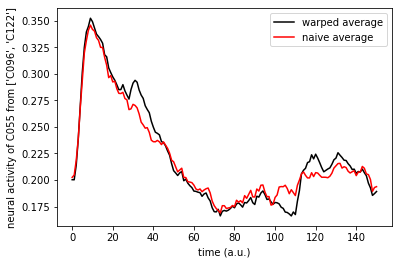

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.08it/s]


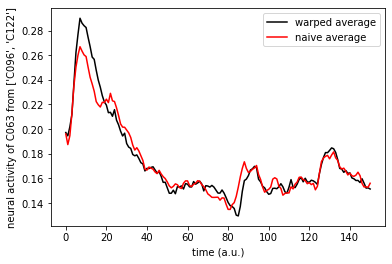

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 716.19it/s]


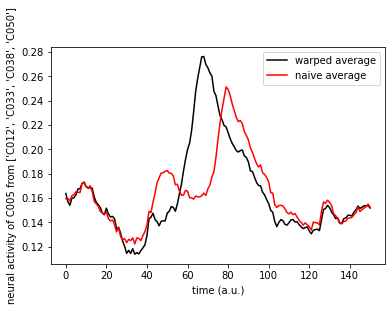

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.62it/s]


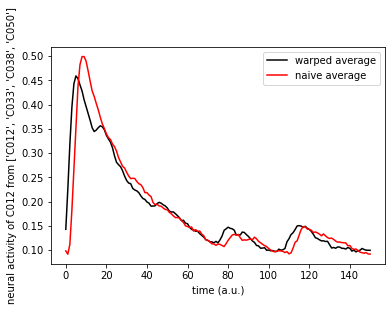

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.49it/s]


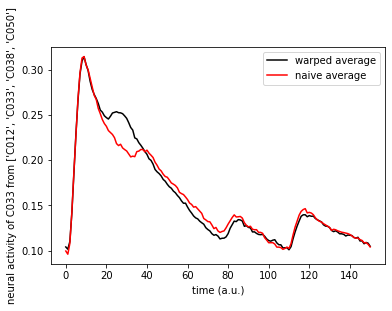

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 737.25it/s]


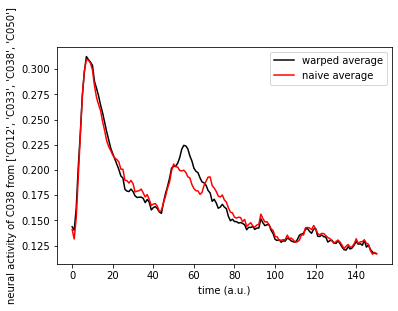

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 759.62it/s]


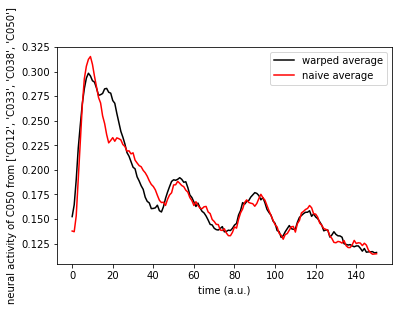

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 783.36it/s]


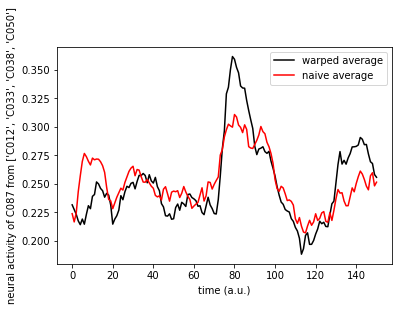

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 771.29it/s]


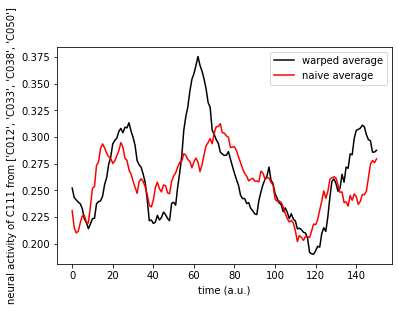

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 748.30it/s]


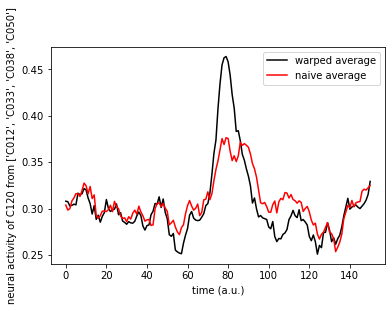

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 544.93it/s]


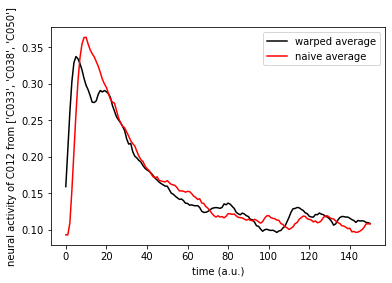

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 551.08it/s]


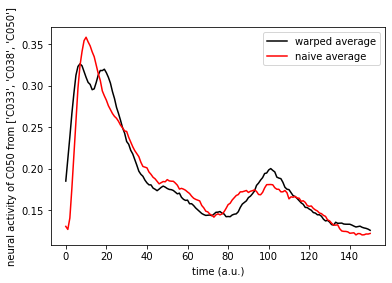

Loss: 0.03: 100%|██████████| 50/50 [00:00<00:00, 706.09it/s]


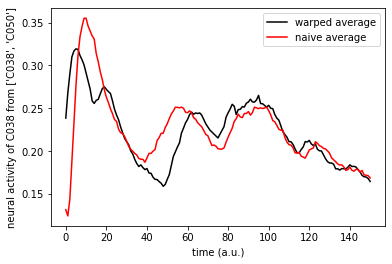

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 651.07it/s]


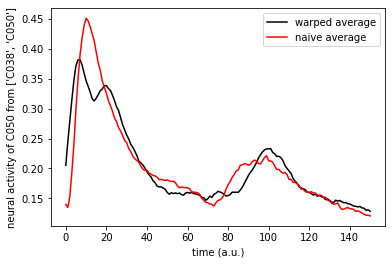

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 659.65it/s]


Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 568.95it/s]


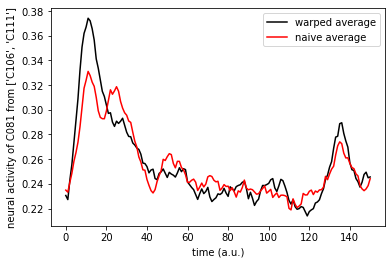

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 642.74it/s]


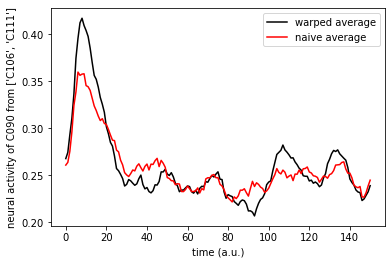

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 634.60it/s]


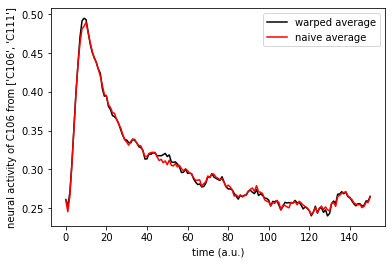

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 642.73it/s]


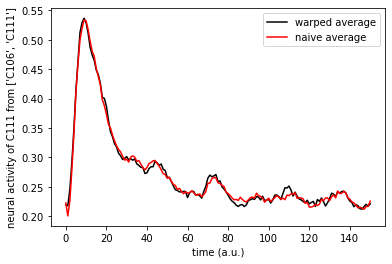

Loss: 0.01: 100%|██████████| 50/50 [00:00<00:00, 611.38it/s]


In [6]:
patternsEx = wrapped.findPatternsEx([wrapped.getAft(partialGroups[i]) for i in range(len(partialGroups))], partialGroups)

In [9]:
patternsEx

{'C001 C026 C046 C096': [(['C019', 'C022', 'C026', 'C039', 'C114'], 13),
  (['C026', 'C039', 'C046', 'C055', 'C063', 'C111', 'C114', 'C125'], 9),
  (['C046', 'C055', 'C063', 'C111', 'C114', 'C125'], 7)],
 'C046 C096': [(['C026', 'C039', 'C114'], 13), (['C039', 'C046', 'C096'], 9)],
 'C037 C070': [(['C032', 'C037', 'C052', 'C090', 'C102'], 13),
  (['C028', 'C032', 'C036', 'C037', 'C052', 'C070', 'C090', 'C115'], 9),
  (['C028', 'C032', 'C036', 'C037', 'C052', 'C070', 'C090', 'C115'], 7),
  (['C028', 'C032', 'C036', 'C037', 'C052', 'C070', 'C090', 'C102', 'C115'],
   11),
  (['C028', 'C036', 'C069', 'C120'], 98),
  (['C049', 'C080', 'C095'], 86)],
 'C014 C016 C019 C108': [(['C022', 'C102', 'C142'], 13),
  (['C022', 'C102', 'C142'], 17),
  (['C014', 'C016', 'C040', 'C102', 'C108', 'C144'], 9),
  (['C014', 'C016', 'C040', 'C108', 'C144'], 7),
  (['C014', 'C016', 'C040', 'C102', 'C108', 'C142', 'C144'], 11),
  (['C022', 'C102', 'C142'], 15)],
 'C018 C022': [(['C022', 'C041', 'C075', 'C078',

In [21]:
test = df.loc[df['C002'] == 1].index + 17
df['C004'] = 0
df['C004'].loc[[15285, 20741]] = 1

In [ ]:
'C106 C111 C114'.split()

In [ ]:
np.array([1,34,2]) + 3

In [ ]:
def nPr(n, r = 2):
    f = math.factorial
    return f(n)/f(n-r)

def avgDist(groups, loc):
    dist = 0
    for group in groups:
        groupDist = 0
        for i in range(len(group)):
            mins = []
            for j in range(len(group)):
                if i != j:
                    e1 = loc[loc['Name'] == group[i]][["CentroidX", "CentroidY"]].values
                    e2 = loc[loc['Name'] == group[j]][["CentroidX", "CentroidY"]].values
                    dif = e1-e2
                    mins.append(math.sqrt(dif.dot(dif.T)))
            groupDist += min(mins)/len(group)
        dist += groupDist/len(groups)
    return dist

def avgDistance(patterns, loc):
    myDic = {}
    for key, val in patterns.items():
        size = len(key.split())
        if size not in myDic:
            myDic[size] = []
        myDic[size].append(avgDist(val, loc))
        
    for k, v in myDic.items():
        myDic[k] = np.mean(v)
    return myDic

def bestClustering(patterns, loc):
    myDic = {}
    counts = {}
    for val in patterns.values():
        for group in val:
            groupDist = []
            for i in range(len(group)):
                for j in range(len(group)):
                    if i != j:
                        e1 = loc[loc['Name'] == group[i]][["CentroidX", "CentroidY"]].values
                        e2 = loc[loc['Name'] == group[j]][["CentroidX", "CentroidY"]].values
                        dif = e1-e2
                        groupDist.append(math.sqrt(dif.dot(dif.T)))
            groupDist = np.mean(sorted(groupDist[:int(len(group)/1.61)]))
            if len(group) not in myDic:
                myDic[len(group)] = []
                counts[len(group)] = 0
            myDic[len(group)].append(groupDist)
            counts[len(group)] +=1
            
    print(counts)    
    for k, v in myDic.items():
        myDic[k] = np.mean(v)
    return myDic

In [12]:
test = df.iloc[save]

In [ ]:
test['C002']

In [ ]:
df['C011 C019 C026 C027 C029 C061 C075 C088 C099 C105 C106 C111 C122'].value_counts()

In [ ]:
bestClustering(patterns, loc)

In [ ]:
avgDistance(patterns, loc)

In [ ]:
loc[loc['Name'] == "C000"][["CentroidX", "CentroidY"]].values

In [ ]:
chowliu = ChowLiu.ChowLiu(df)
model, groups = chowliu.run("kruskal", loc)

In [ ]:
print(cellGroups)
print(reducedGroupsInfo)
print(groups)

In [ ]:
loss(df, reducedGroups, 0, 24000)

In [ ]:
loss(df, reducedGroupsInfo, 0, 24000)

In [ ]:
loss(df, groups, 0, 24000)

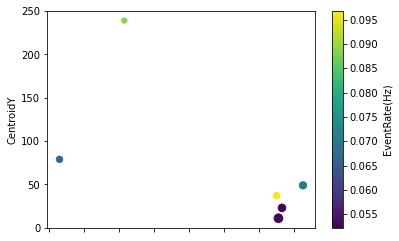

<Figure size 432x288 with 0 Axes>

In [7]:
simplePrint(["data/04042014_2/CellTracing.csv", "data/04042014_2/CellTracing-props.csv"],['C012', 'C013', 'C028', 'C036', 'C070', 'C115'], ['data/04042014_2/events.csv', 'data/04042014_2/events-props.csv'])

simplePrint(["data/03312014_2/Traces_03312014_2.csv", "data/03312014_2/Traces_03312014_2-props.csv"], ['C098', 'C100', 'C103'], ['data/03312014_2/Events_03312014_2.csv', 'data/03312014_2/Events_03312014_2-props.csv'])

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3338: DtypeWarning: Columns (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


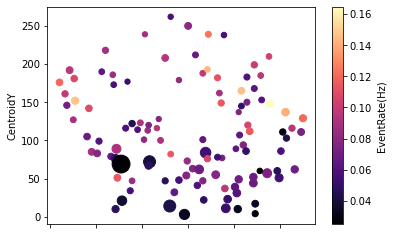

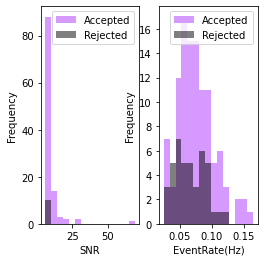

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3338: DtypeWarning: Columns (2,3,5,6,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,56,57,58,59,61,62,63,64,65,67,68,69,70,71,72,73,74,76,77,78,79,80,81,82,83,84,86,87,88,89,90,91,92,94,95,96,97,98,100,102,103,104,106,107,108,109,110,111,112,114,115,116,121,123,126,132,133,143,144,145) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):
C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3338: DtypeWarning: Columns (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,1

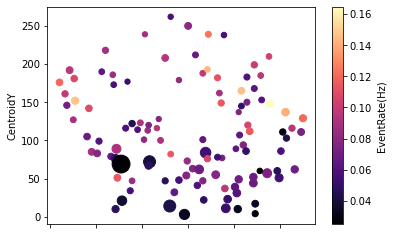

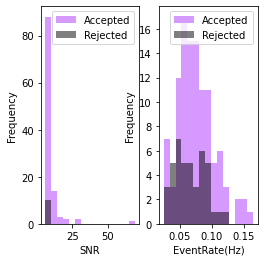

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3338: DtypeWarning: Columns (2,3,5,6,8,9,10,11,12,13,14,15,16,17,18,19,20,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,56,57,58,59,61,62,63,64,65,67,68,69,70,71,72,73,74,76,77,78,79,80,81,82,83,84,86,87,88,89,90,91,92,94,95,96,97,98,100,102,103,104,106,107,108,109,110,111,112,114,115,116,121,123,126,132,133,143,144,145) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


In [161]:
dfE, loc = preprocessed_df(["data/04042014_2/CellTracing.csv", "data/04042014_2/CellTracing-props.csv"], ['data/04042014_2/events.csv', 'data/04042014_2/events-props.csv'], loc = True)
df, loc = preprocessed_df(["data/04042014_2/CellTracing.csv", "data/04042014_2/CellTracing-props.csv"], ['data/04042014_2/events.csv', 'data/04042014_2/events-props.csv'], loc = True, simplify = False)

In [48]:
df

,C001,C002,C004,C005,C007,C008,C009,C010,C011,C012,...,C114,C115,C120,C122,C125,C131,C132,C142,C143,C144
1,0.082161,0.053731,0.292409,0.260783,0.186770,0.195182,0.191978,0.111073,0.224653,0.071212,...,0.425979,0.274934,0.229764,0.428996,0.249734,0.215003,0.328998,0.398510,0.350477,0.485579
2,0.070684,0.052615,0.293982,0.247864,0.177631,0.193441,0.196677,0.112246,0.218285,0.086790,...,0.446425,0.301605,0.284424,0.454458,0.244497,0.245778,0.318663,0.400263,0.353196,0.471431
3,0.082194,0.045597,0.297700,0.265438,0.172773,0.193407,0.181185,0.105931,0.210987,0.086182,...,0.429979,0.296873,0.319821,0.476353,0.222688,0.242172,0.333849,0.409436,0.359729,0.451800
4,0.081374,0.039780,0.277786,0.252733,0.176921,0.193213,0.176027,0.106390,0.217450,0.092400,...,0.421880,0.289502,0.326019,0.465209,0.231806,0.240068,0.314775,0.391720,0.373077,0.415703
5,0.080706,0.042824,0.273521,0.271688,0.172581,0.190728,0.185488,0.114592,0.217567,0.080484,...,0.384529,0.265490,0.333300,0.473204,0.218517,0.219119,0.323411,0.421328,0.374014,0.413034
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24167,0.055882,0.066995,0.263945,0.191573,0.196684,0.139797,0.101340,0.105900,0.158820,0.060328,...,0.151892,0.228737,0.389861,0.424167,0.138151,0.082045,0.569712,0.439020,0.405687,0.512254
24168,0.065876,0.111058,0.257574,0.213668,0.191969,0.151368,0.113069,0.111244,0.171070,0.059262,...,0.168638,0.243408,0.411101,0.466448,0.185216,0.096730,0.500281,0.428433,0.433879,0.511832
24169,0.078145,0.137978,0.262115,0.235983,0.174365,0.145097,0.101339,0.116754,0.162177,0.047920,...,0.143689,0.249195,0.418130,0.518684,0.217847,0.090352,0.476666,0.435797,0.461837,0.503403
24170,0.065322,0.157526,0.237004,0.263161,0.161722,0.137276,0.105737,0.122959,0.137020,0.053089,...,0.123826,0.229160,0.381390,0.526789,0.219187,0.040685,0.477737,0.468717,0.483101,0.509048


In [ ]:
def extendDf(df, dfe, patterns):    
    for k, v in patterns.items():
        activeCells = k.split()
        dfT = {}
        for e in activeCells:
            for index in dfe.loc[(dfe[e] == 1)].index.tolist():
                if index not in dfT:
                    dfT[index] = 0
                dfT[index] += 1

        ts = []
        for key, val in dfT.items():
            if val >= len(group)*2/3:
                ts.append(key)
        for tup in v:
            indexes = []
            for i in np.array(ts) + tup[1]:
                if i < len(df) - 2:
                    indexes.extend(range(i-2, i+3))
            name = ' '.join([str(elem) for elem in tup[0]])
            df[name] = 0
            df[name].loc[indexes] = 1
    return df
df = extendDf(df, dfE, patternsEx)

In [162]:
import LSTM_CNN

In [164]:
annots = [88,114, 143,149,164,191, 198,201, 209,212, 224,233, 243,278, 385,393, 1067,1070, 1075,1107, 1116,1126, 1151,1159, 1168,1171, 1201,1208]
#n = LSTM_CNN.LSTM_CNN(annots, df)
nn = LSTM_CNN.LSTM_CNN(an, df, baseCase = False)
#nn = LSTM_CNN.LSTM_CNN(np.insert(clustering.labels_, 0, [0,0,0,0,0,0,0,0,0]).reshape(-1,1), df, baseCase = False)

In [78]:
nn.rearrangeCols(loc)

In [27]:
len(nn.df)

24171

In [163]:
from sklearn.preprocessing import OneHotEncoder
enc = OneHotEncoder(handle_unknown='ignore').fit(np.insert(labels, 0, [0,0,0,0,0,0,0,0,0]).reshape(-1,1))
an = enc.transform(np.insert(labels, 0, [0,0,0,0,0,0,0,0,0]).reshape(-1,1)).toarray()

In [28]:
an

array([[0., 1., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       ...,
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.]])

In [165]:
X_train, X_test, y_train, y_test = nn.dataPrep(dfE)

(4586, 20, 110)


In [171]:
X_trainN = []
y_trainN = []
X_testN = []
y_testN = []
for i in range(len(X_train)):
    if y_train[i,1] == 0:
        X_trainN.append(X_train[i])
        y_trainN.append(y_train[i])
for i in range(len(X_test)):
    if y_test[i,1] == 0:
        X_testN.append(X_test[i])
        y_testN.append(y_test[i])
        
X_trainN = np.array(X_trainN)
y_trainN = np.array(y_trainN)
X_testN = np.array(X_testN)
y_testN = np.array(y_testN)

In [57]:
X_trainN.shape

(495, 20, 11, 10, 1)

In [24]:
nn.annots.shape

(24170,)

In [166]:
model = nn.build()

In [ ]:
model.fit(X_train,  y_train, validation_data = (X_test,y_test), epochs=100, batch_size=10)

Epoch 1/100
367/367 [==============================] - 13s 29ms/step - loss: 0.4126 - accuracy: 0.3055 - val_loss: 0.0207 - val_accuracy: 0.5174
Epoch 2/100
367/367 [==============================] - 10s 27ms/step - loss: 0.0211 - accuracy: 0.5049 - val_loss: 0.0111 - val_accuracy: 0.5174
Epoch 3/100
367/367 [==============================] - 10s 27ms/step - loss: 0.0129 - accuracy: 0.5090 - val_loss: 0.0099 - val_accuracy: 0.4651
Epoch 4/100
367/367 [==============================] - 10s 28ms/step - loss: 0.0113 - accuracy: 0.4716 - val_loss: 0.0096 - val_accuracy: 0.5174
Epoch 5/100
367/367 [==============================] - 10s 27ms/step - loss: 0.0105 - accuracy: 0.4784 - val_loss: 0.0095 - val_accuracy: 0.5174
Epoch 6/100
367/367 [==============================] - 10s 27ms/step - loss: 0.0102 - accuracy: 0.4851 - val_loss: 0.0094 - val_accuracy: 0.5174
Epoch 7/100
367/367 [==============================] - 10s 28ms/step - loss: 0.0102 - accuracy: 0.4858 - val_loss: 0.0094 - val_ac

In [ ]:
model.fit(X_train,  y_train, validation_data = (X_test,y_test), epochs=100, batch_size=10)

In [ ]:
model.fit(X_train,  y_train, validation_data = (X_test,y_test), epochs=100, batch_size=10)

In [ ]:
model.fit(X_train,  y_train, validation_data = (X_test,y_test), epochs=100, batch_size=10)

In [82]:
AdvancedPrint(["data/04042014_2/CellTracing.csv", "data/04042014_2/CellTracing-props.csv"],patterns, ['data/04042014_2/events.csv', 'data/04042014_2/events-props.csv'], df)    
    

NameError: name 'patterns' is not defined

C:\Users\mathi\BeierLab\processTools.py:159: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, len(v) + 1)


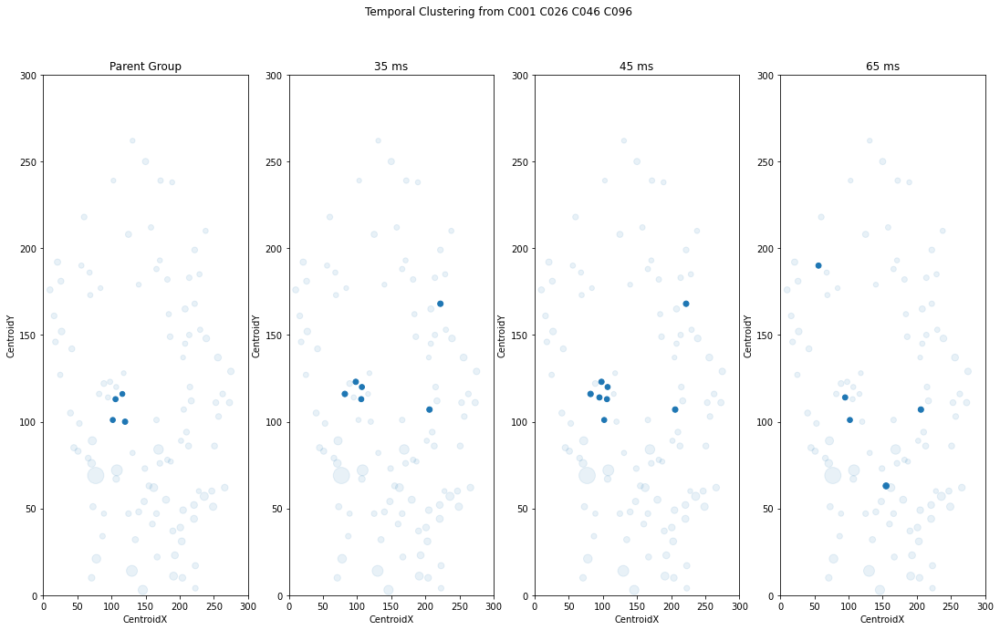

<Figure size 432x288 with 0 Axes>

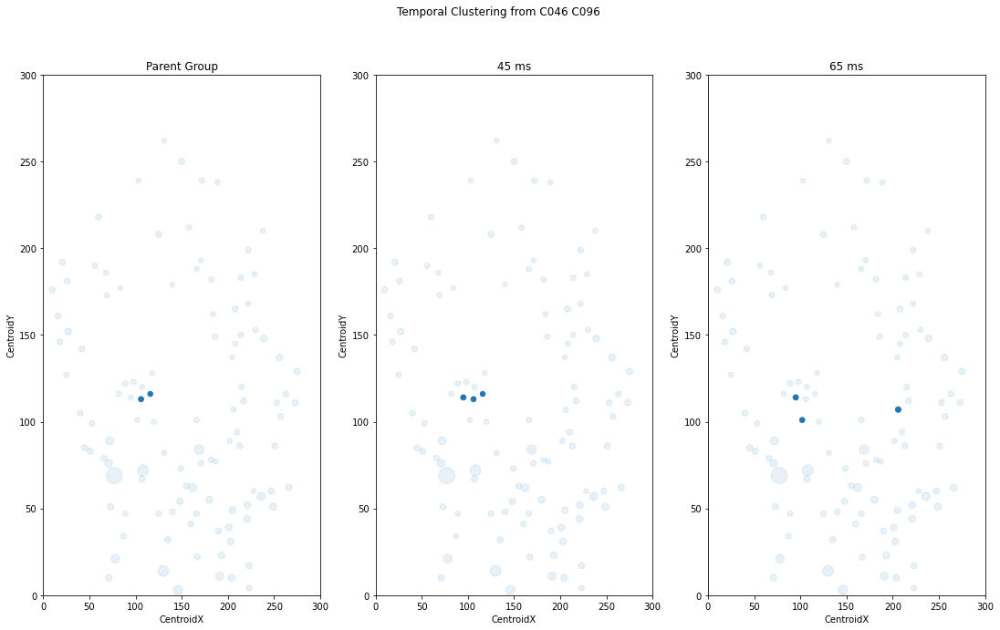

<Figure size 432x288 with 0 Axes>

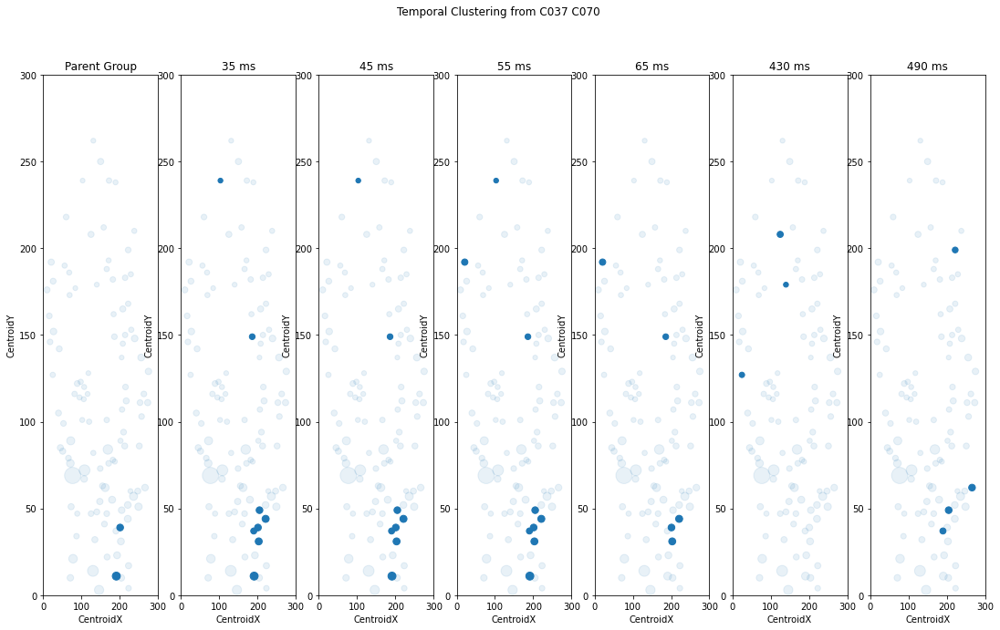

<Figure size 432x288 with 0 Axes>

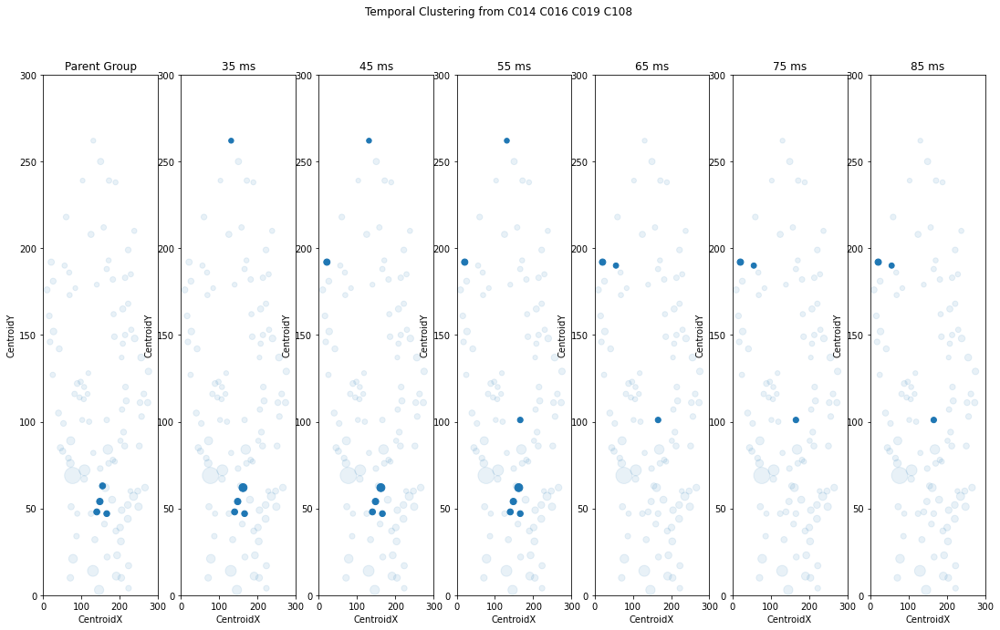

<Figure size 432x288 with 0 Axes>

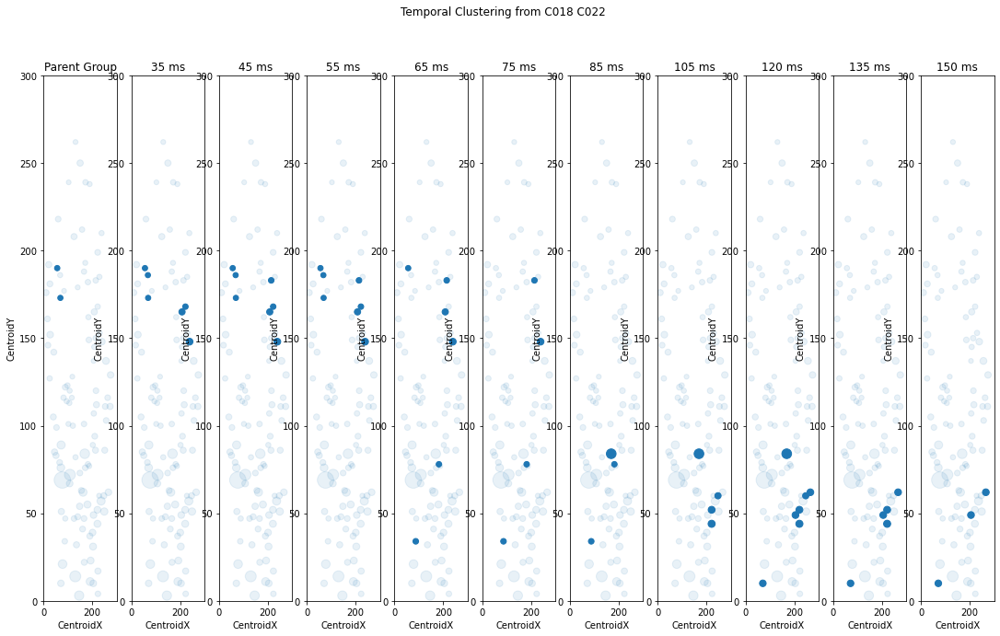

<Figure size 432x288 with 0 Axes>

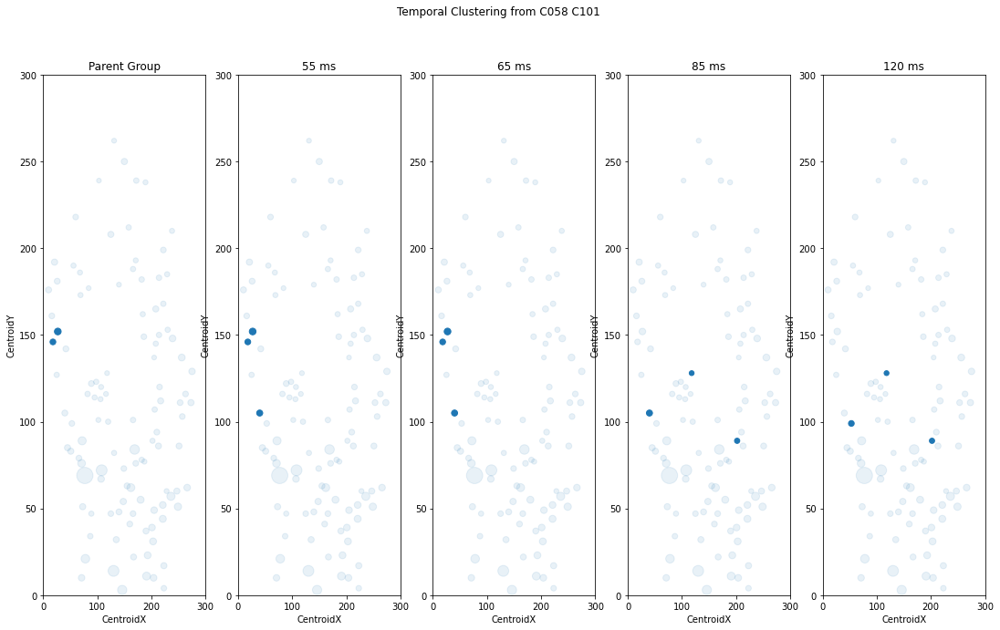

<Figure size 432x288 with 0 Axes>

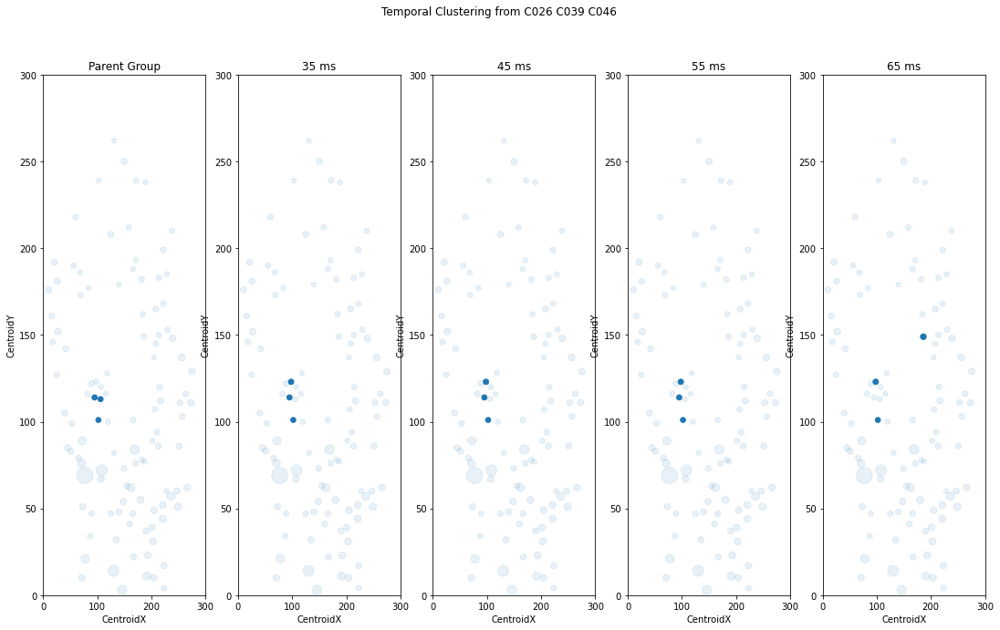

<Figure size 432x288 with 0 Axes>

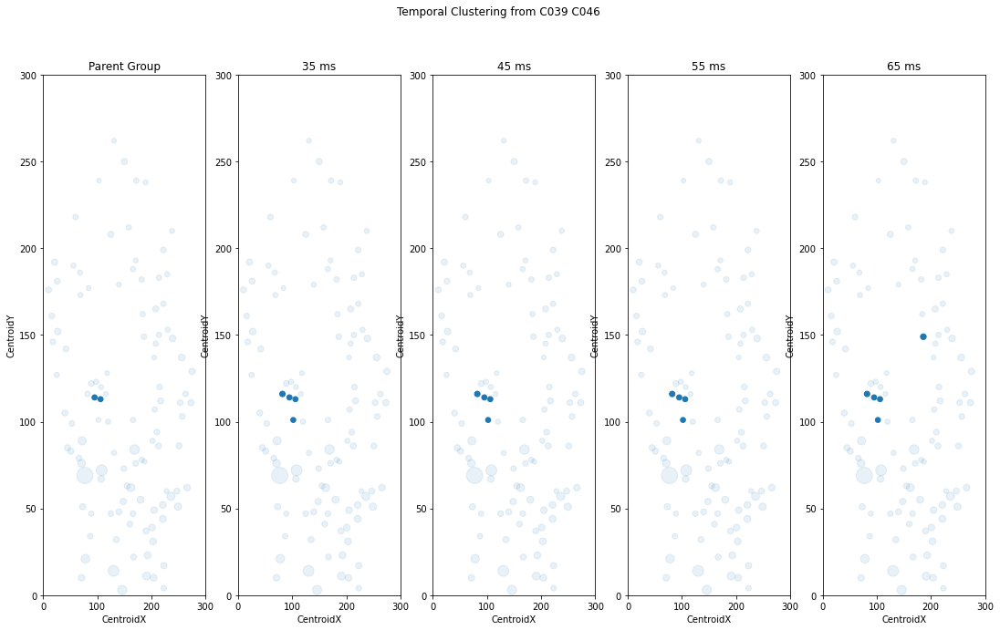

<Figure size 432x288 with 0 Axes>

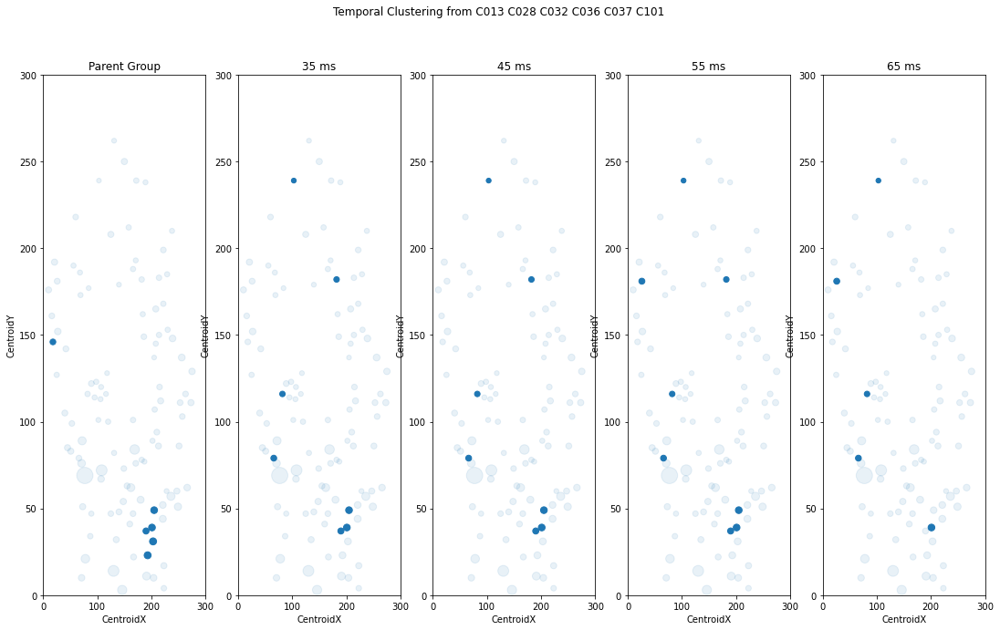

<Figure size 432x288 with 0 Axes>

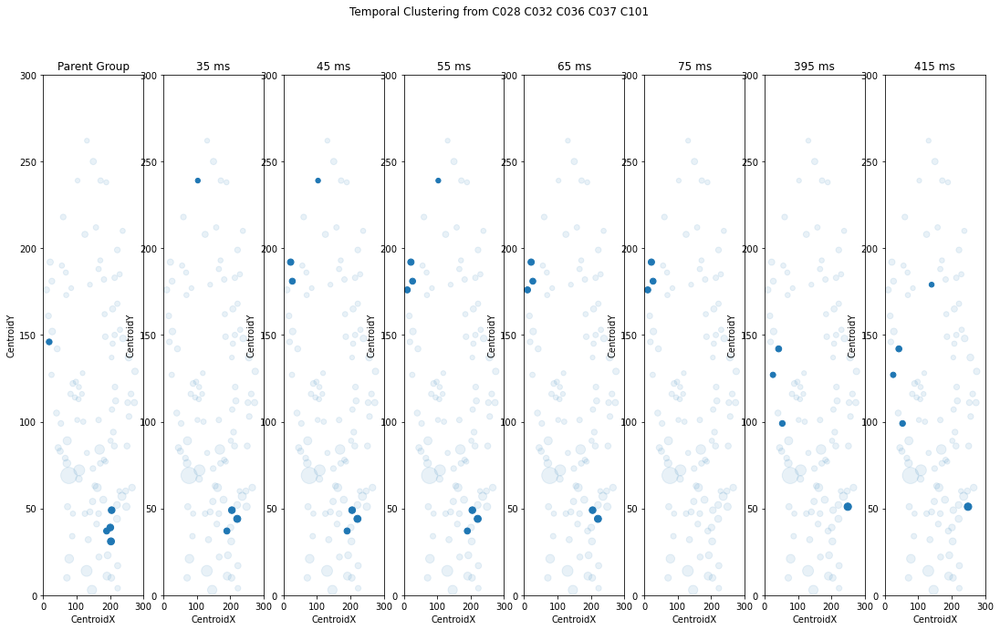

<Figure size 432x288 with 0 Axes>

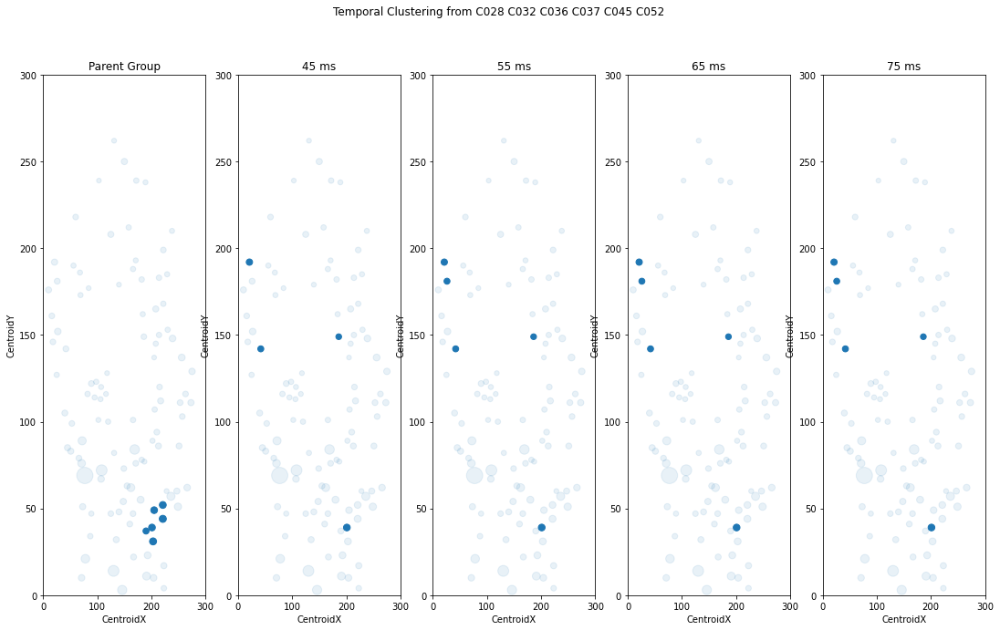

<Figure size 432x288 with 0 Axes>

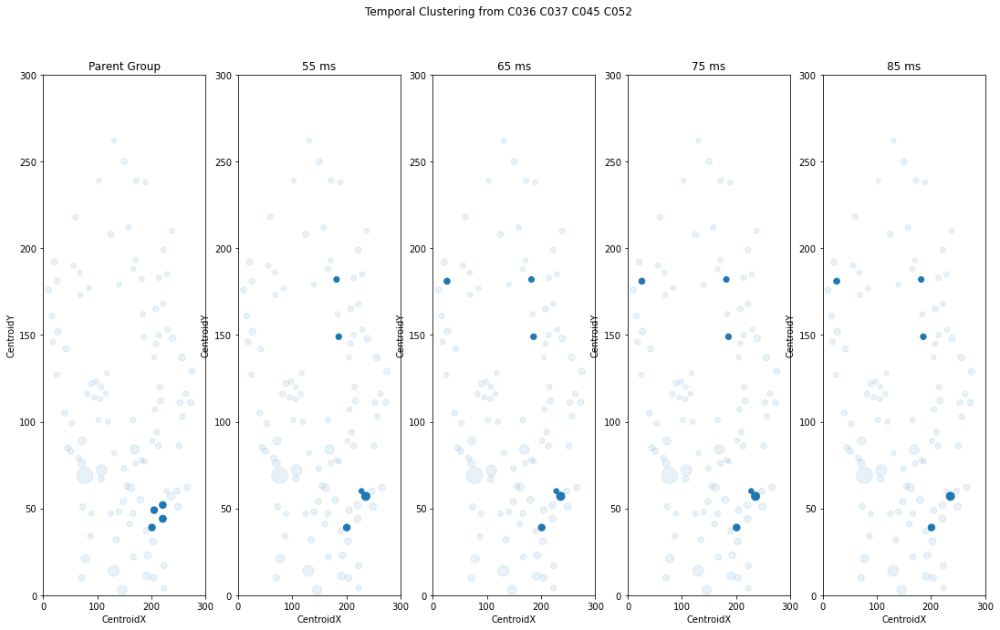

<Figure size 432x288 with 0 Axes>

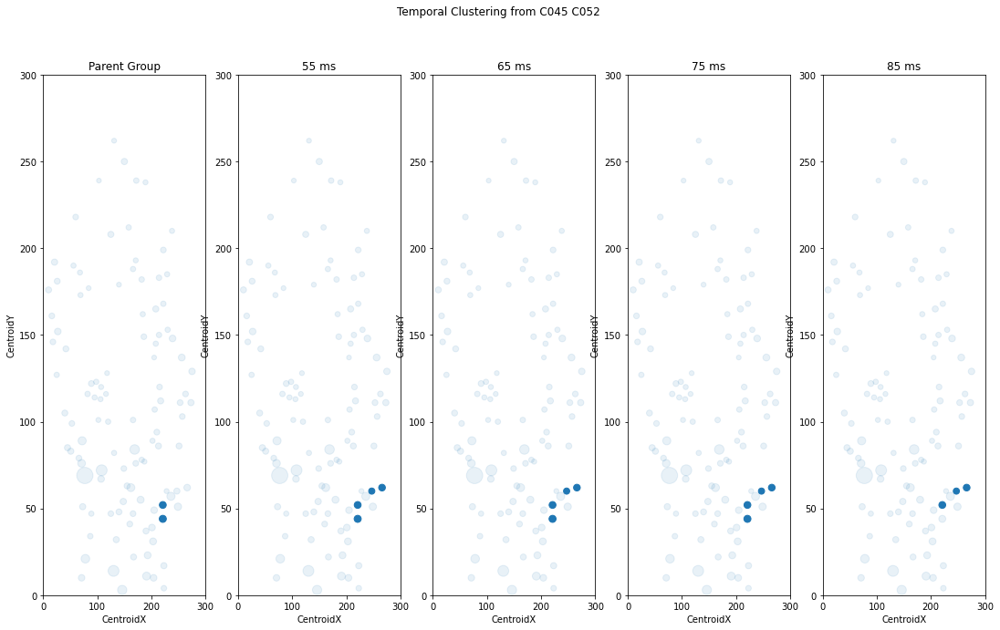

<Figure size 432x288 with 0 Axes>

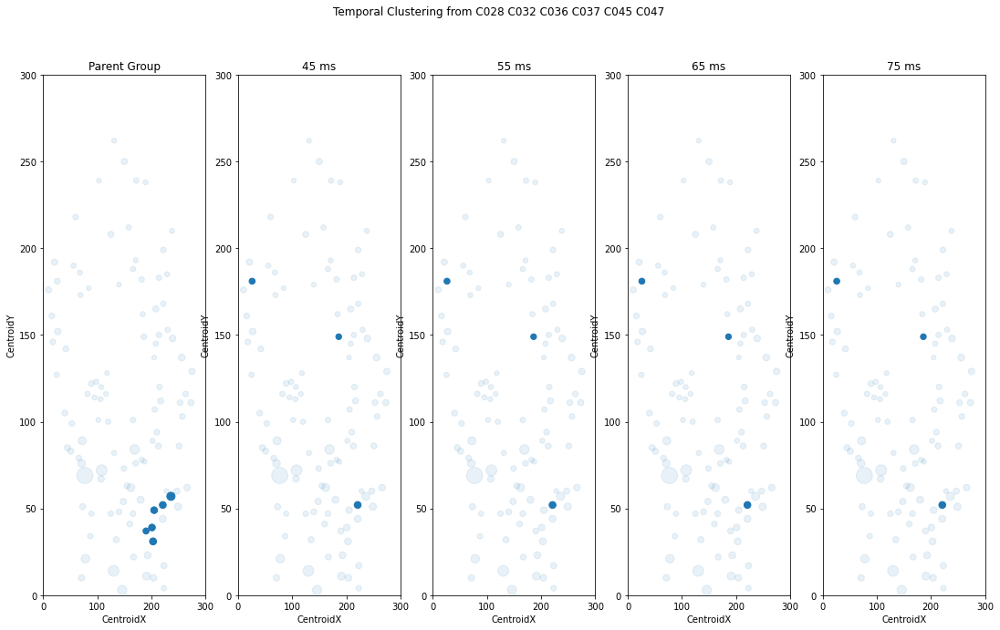

<Figure size 432x288 with 0 Axes>

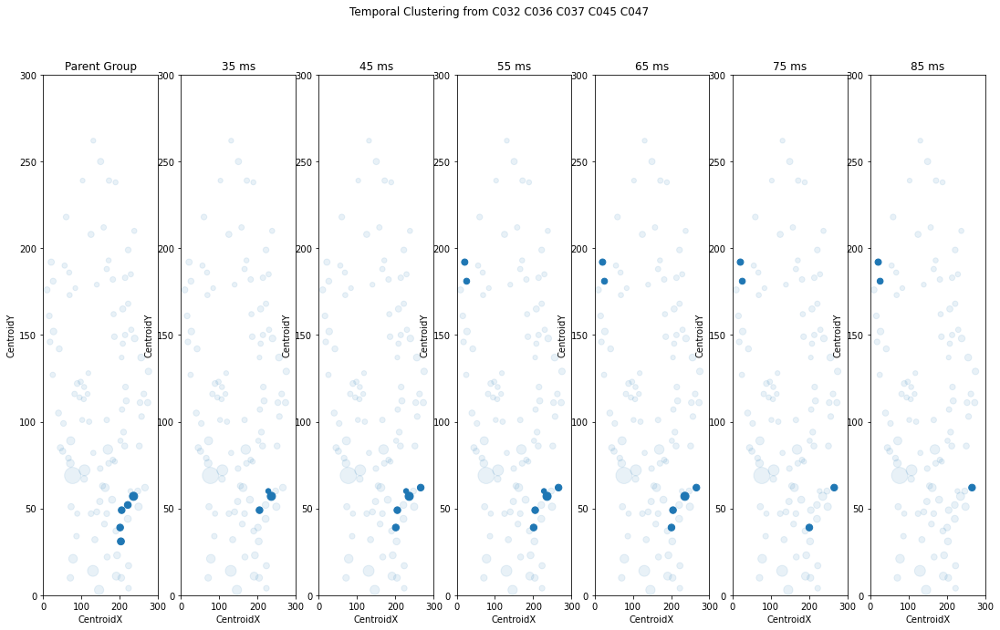

<Figure size 432x288 with 0 Axes>

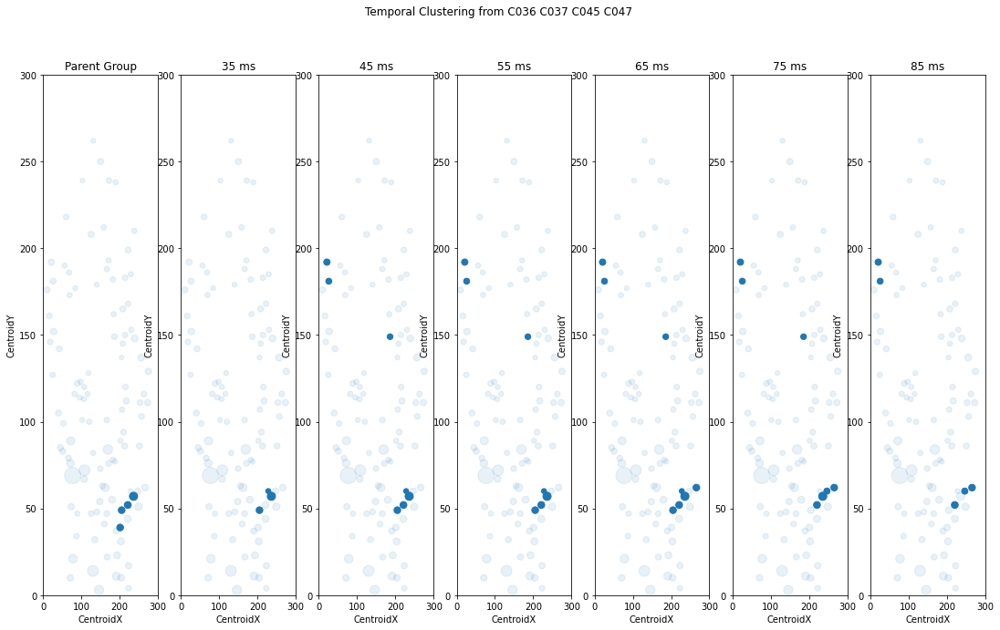

<Figure size 432x288 with 0 Axes>

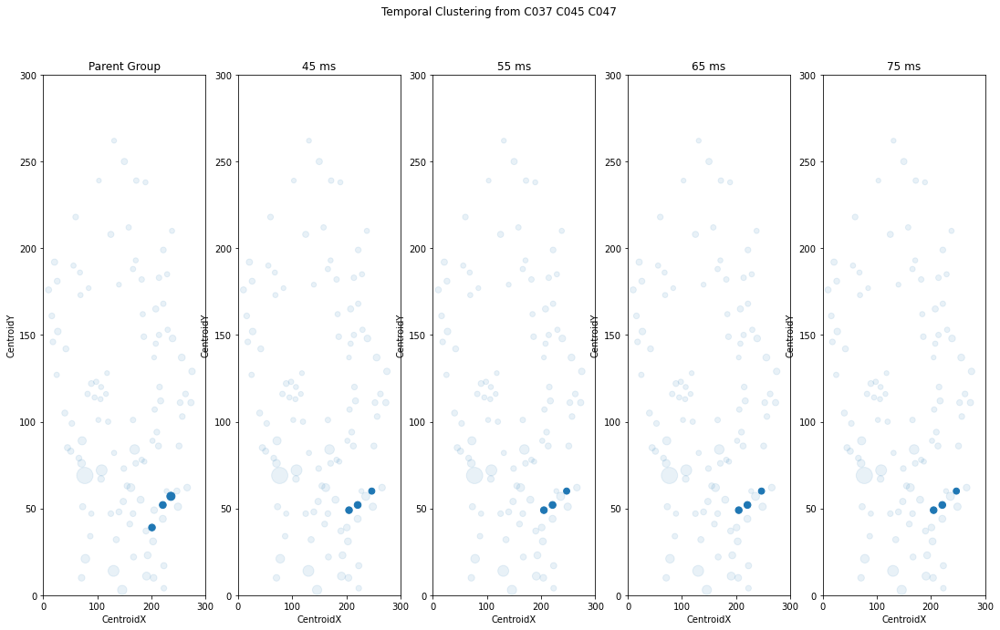

<Figure size 432x288 with 0 Axes>

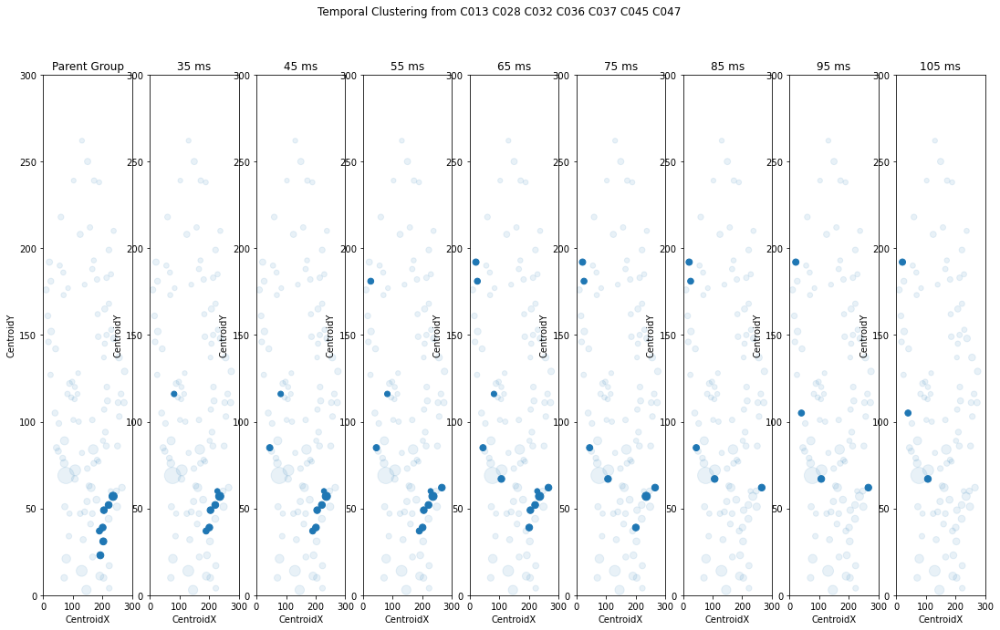

<Figure size 432x288 with 0 Axes>

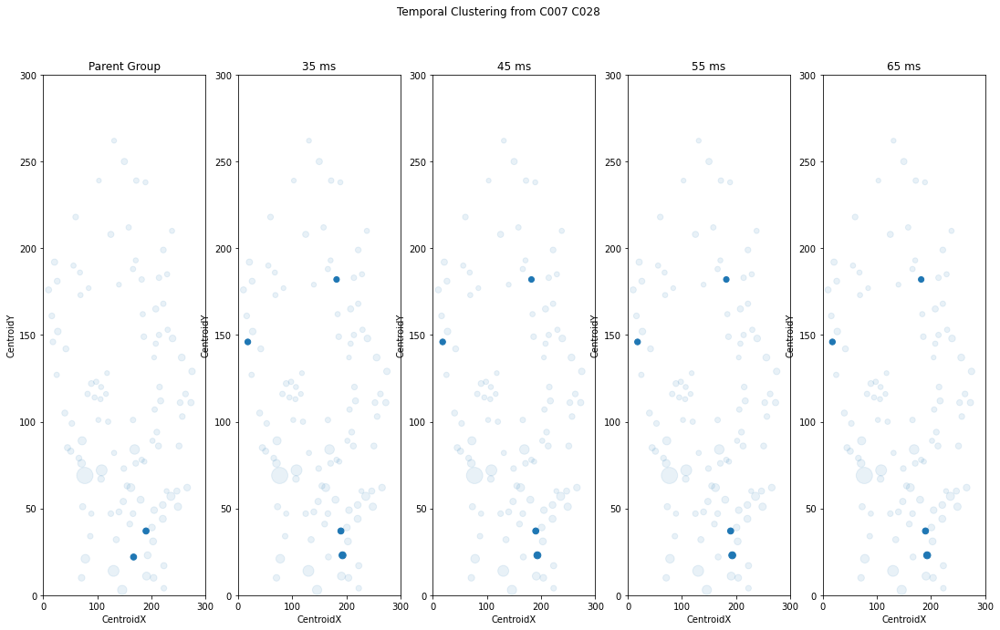

<Figure size 432x288 with 0 Axes>

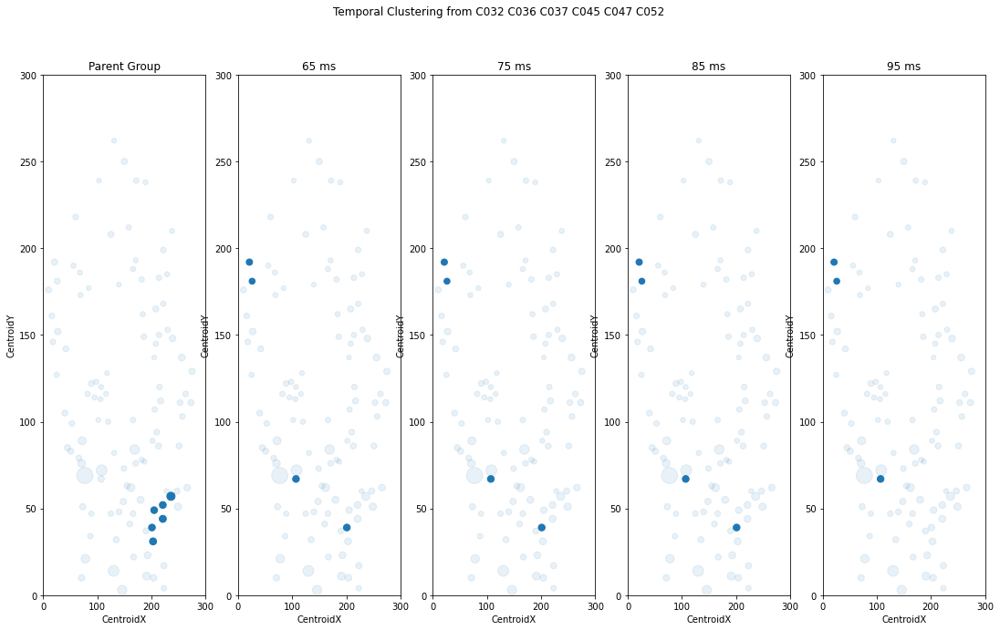

<Figure size 432x288 with 0 Axes>

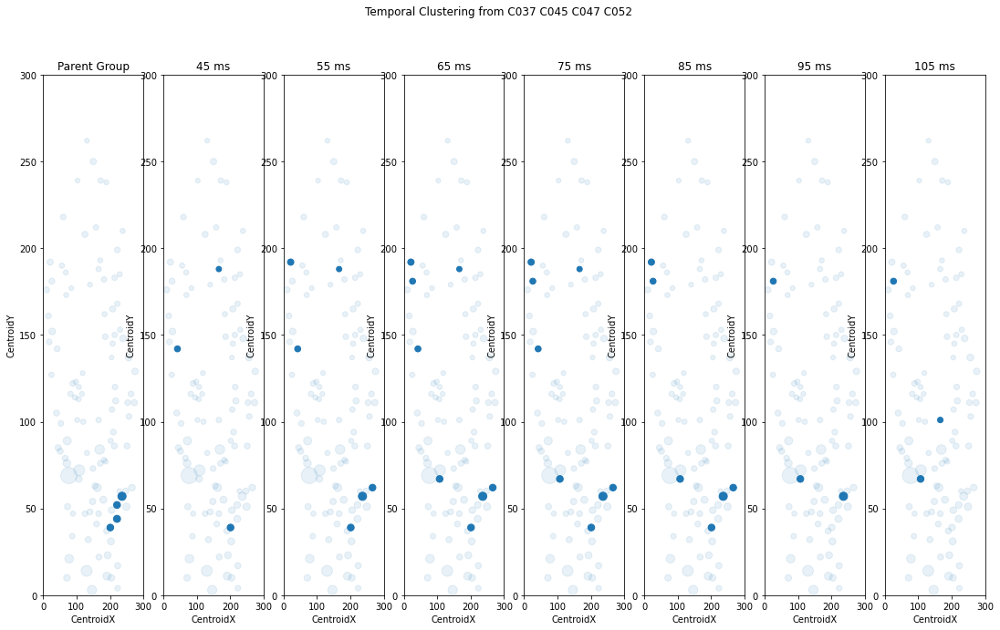

<Figure size 432x288 with 0 Axes>

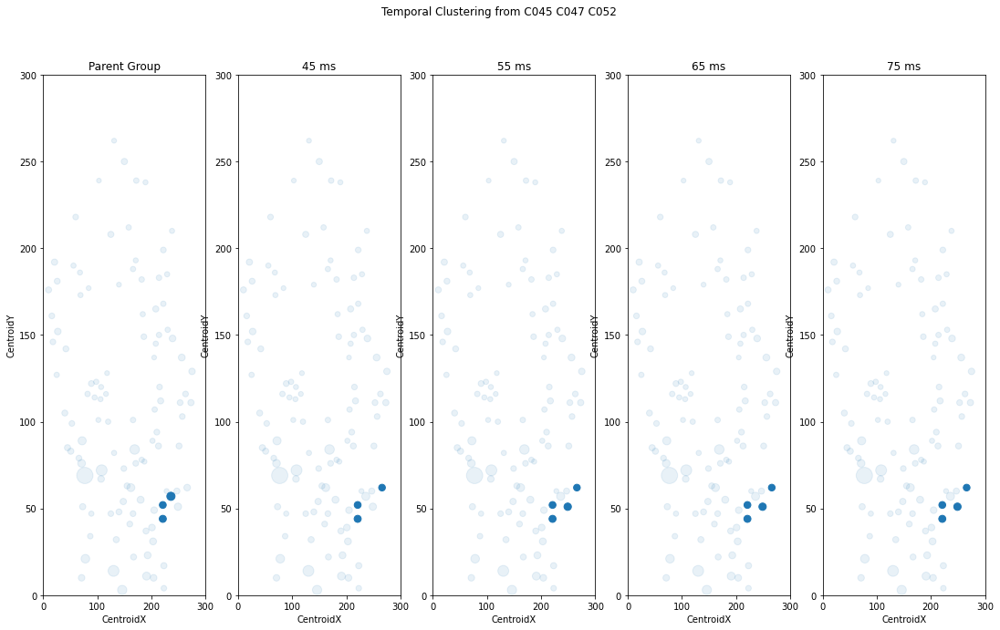

<Figure size 432x288 with 0 Axes>

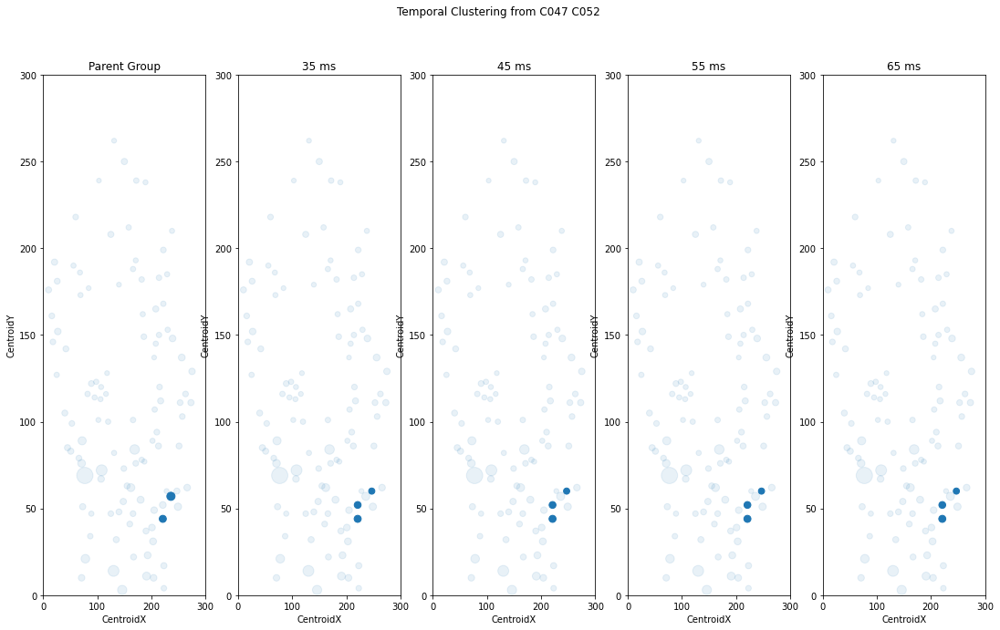

<Figure size 432x288 with 0 Axes>

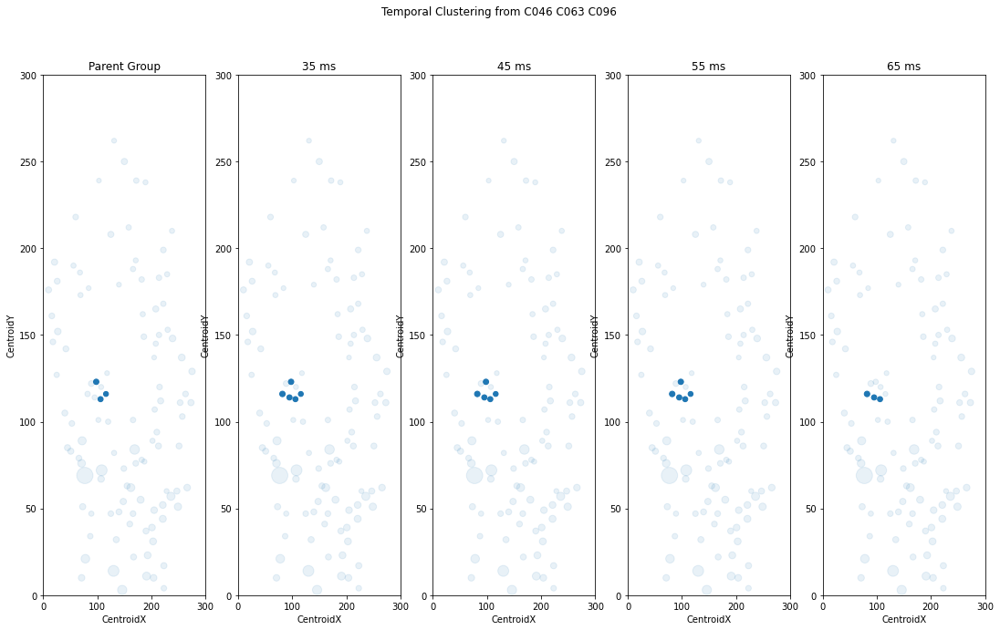

<Figure size 432x288 with 0 Axes>

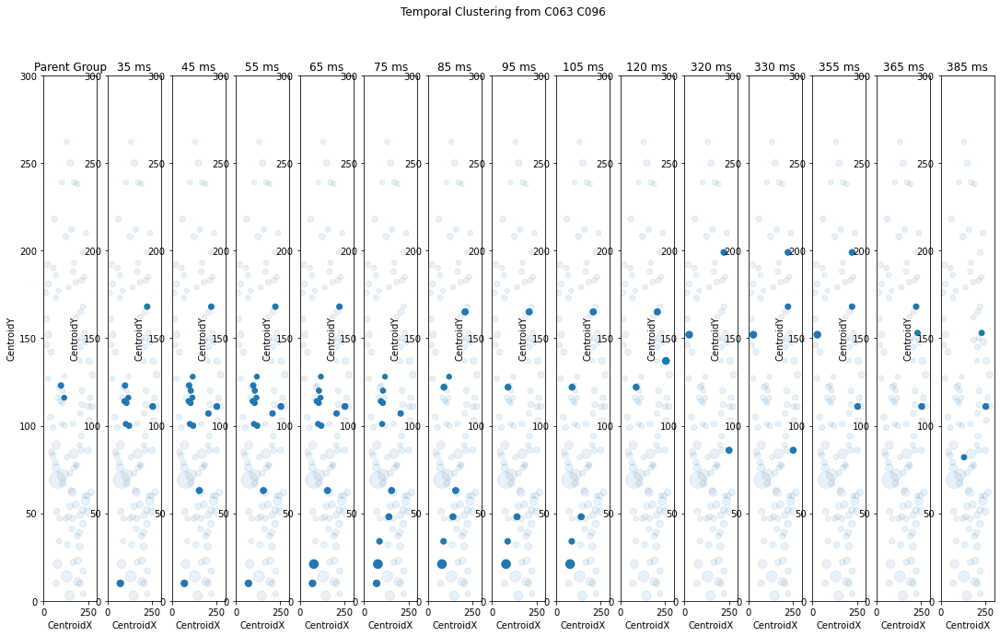

<Figure size 432x288 with 0 Axes>

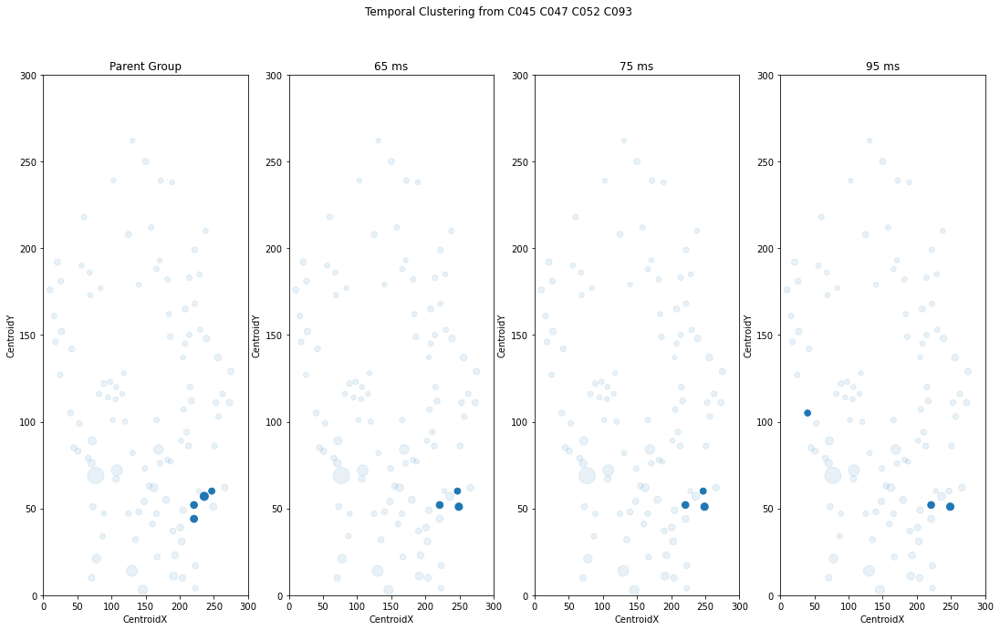

<Figure size 432x288 with 0 Axes>

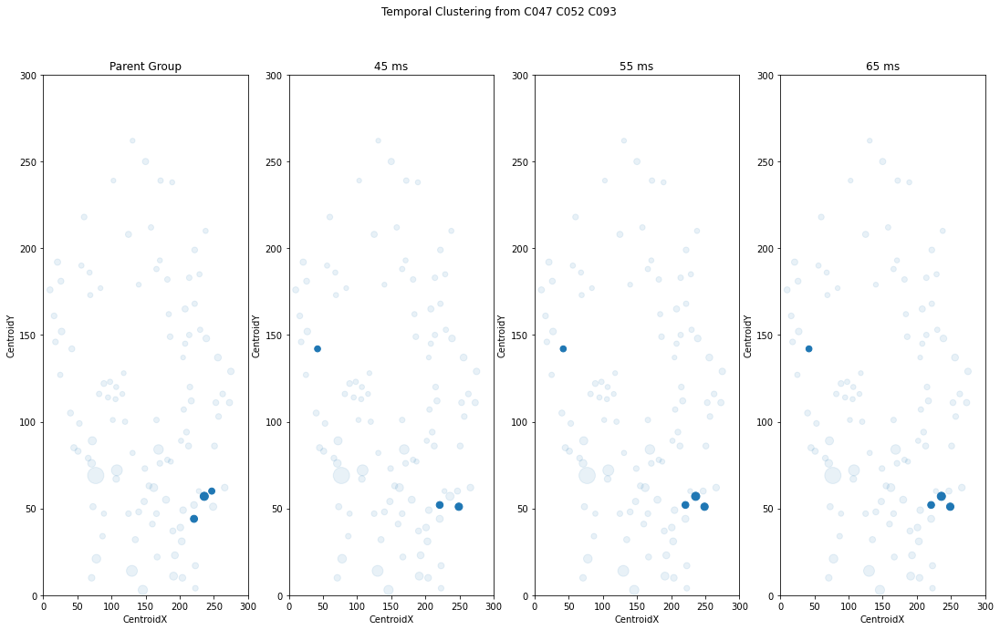

<Figure size 432x288 with 0 Axes>

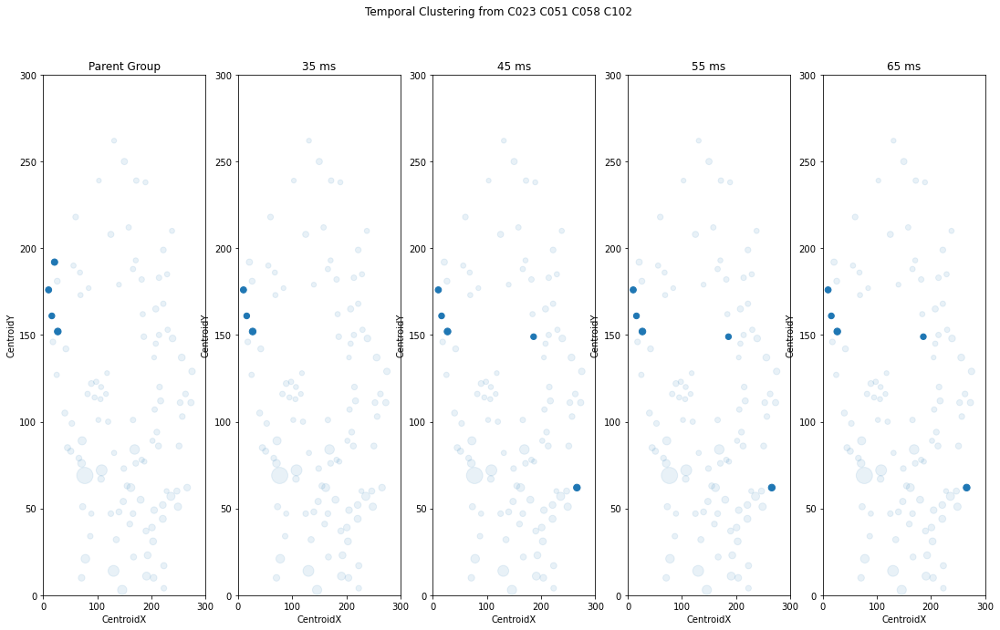

<Figure size 432x288 with 0 Axes>

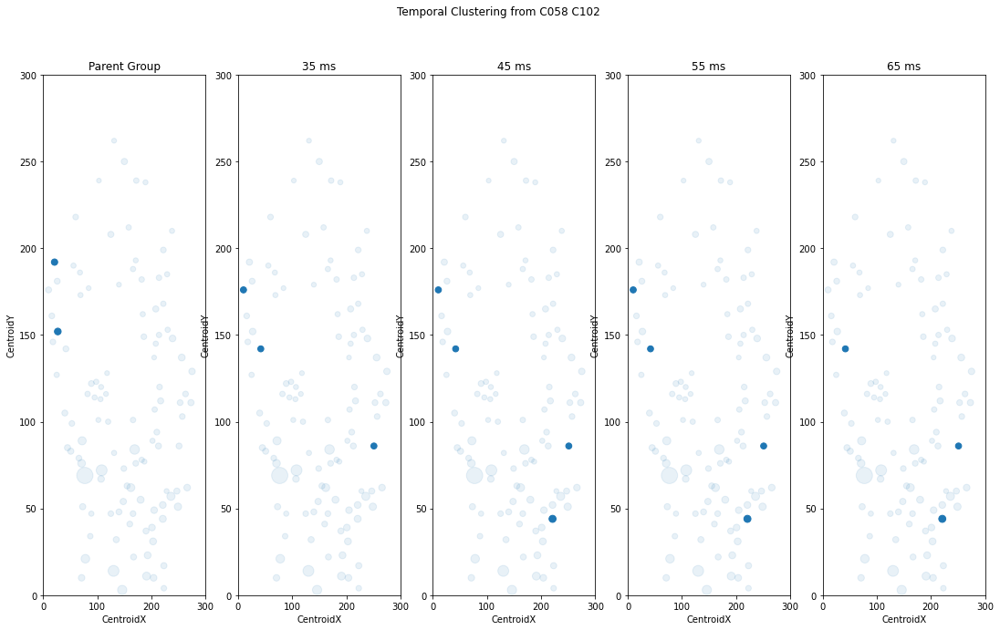

<Figure size 432x288 with 0 Axes>

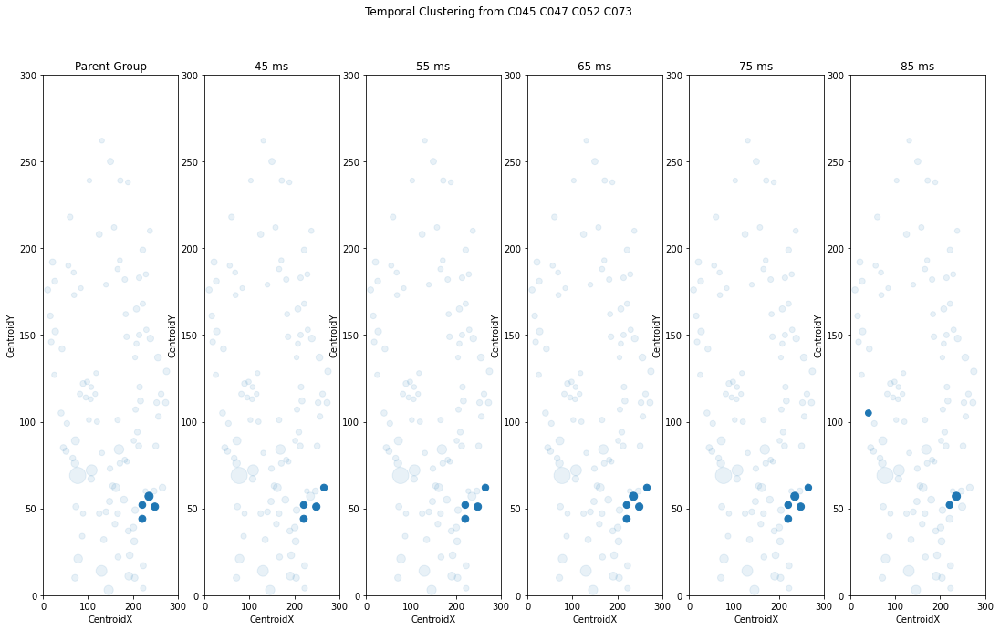

<Figure size 432x288 with 0 Axes>

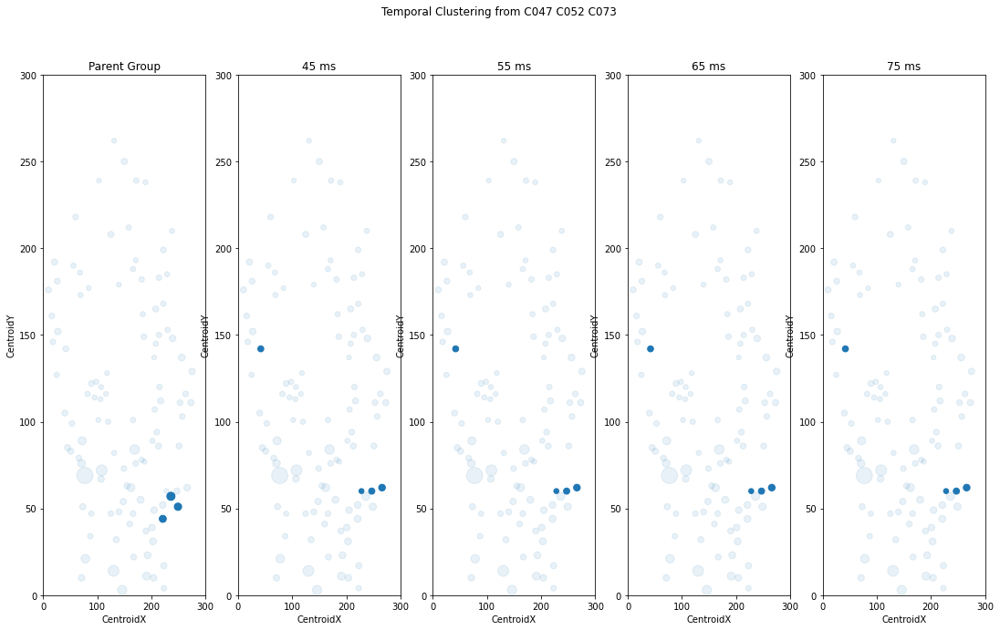

<Figure size 432x288 with 0 Axes>

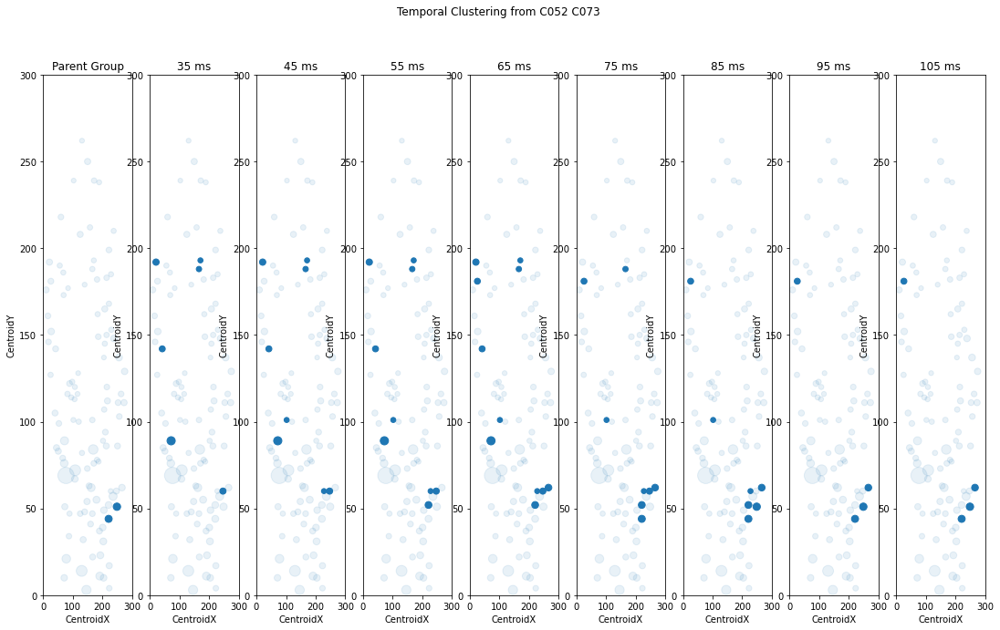

<Figure size 432x288 with 0 Axes>

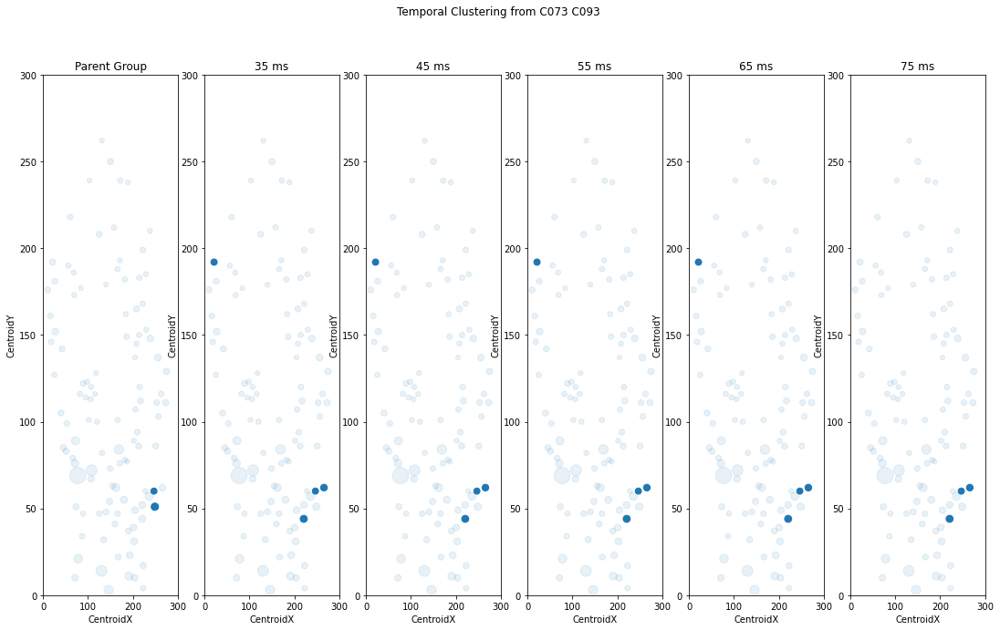

<Figure size 432x288 with 0 Axes>

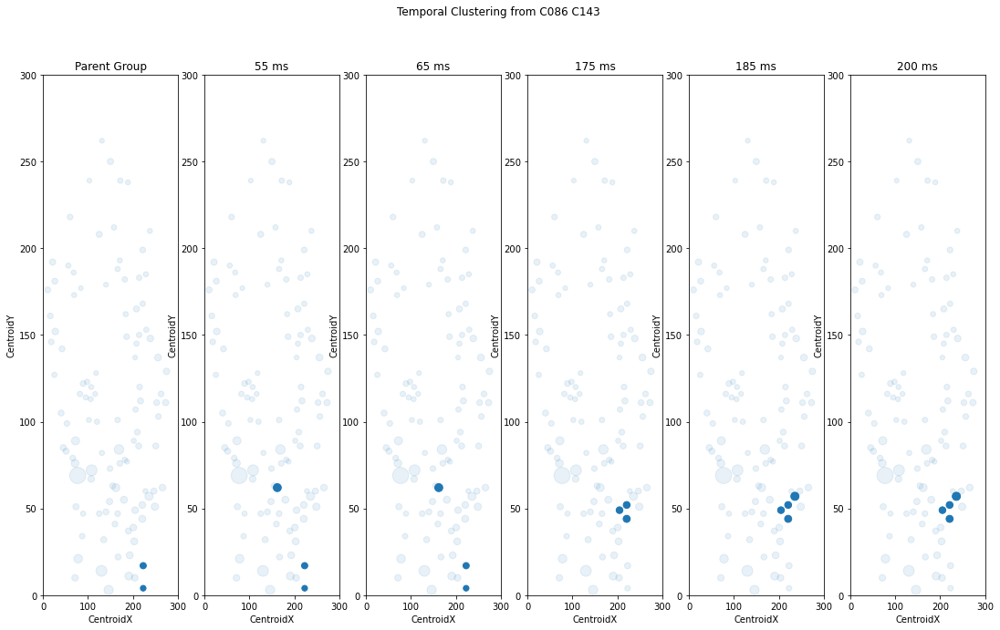

<Figure size 432x288 with 0 Axes>

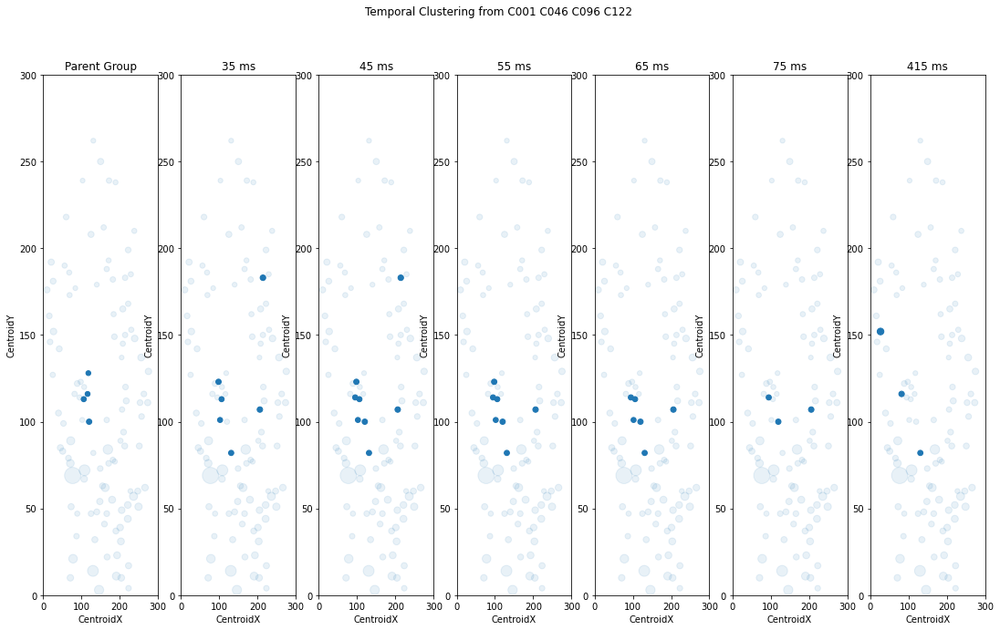

<Figure size 432x288 with 0 Axes>

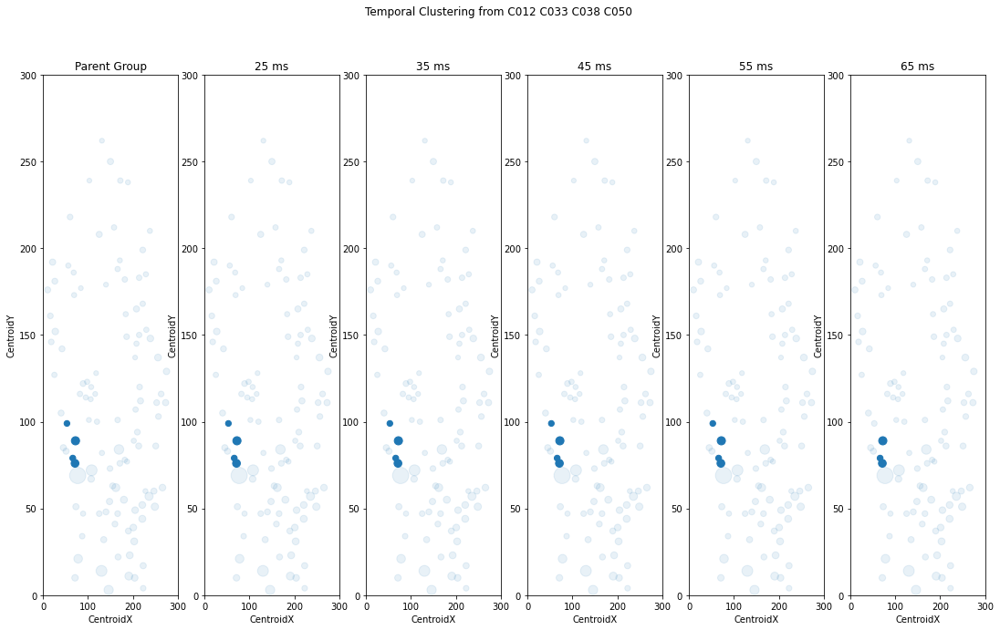

<Figure size 432x288 with 0 Axes>

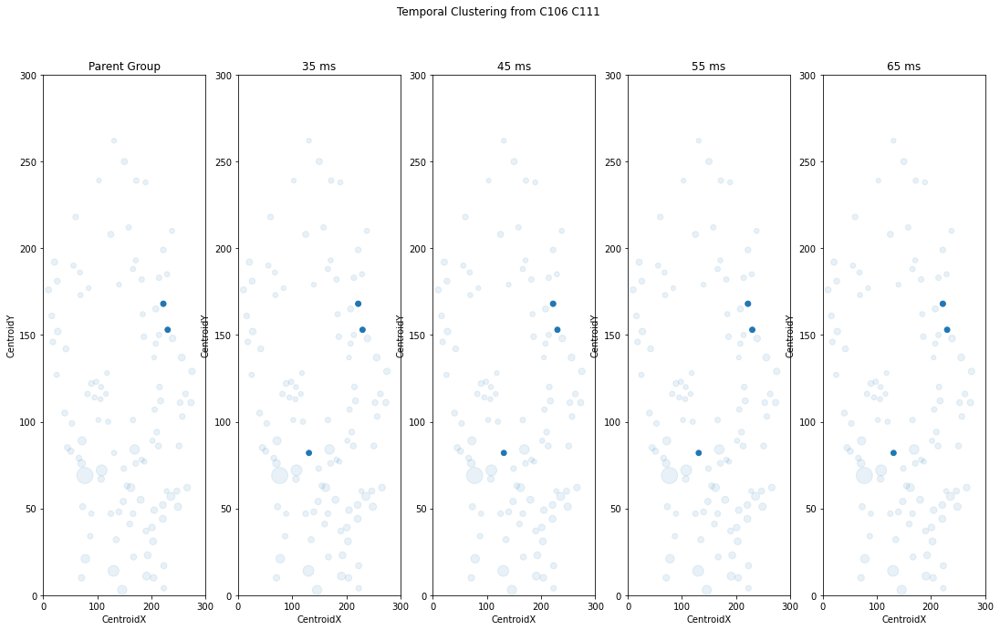

<Figure size 432x288 with 0 Axes>

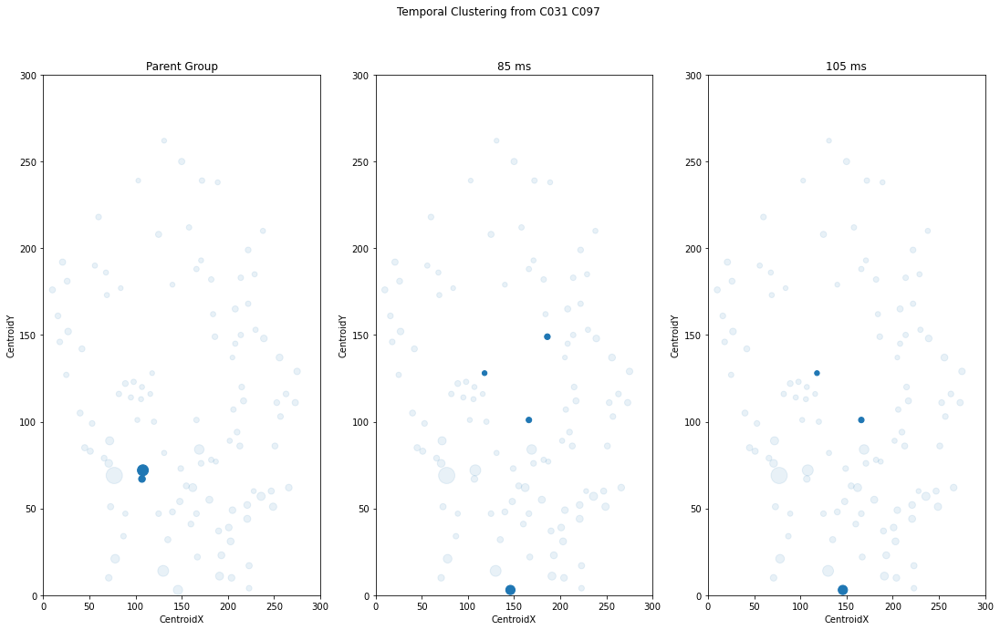

<Figure size 432x288 with 0 Axes>

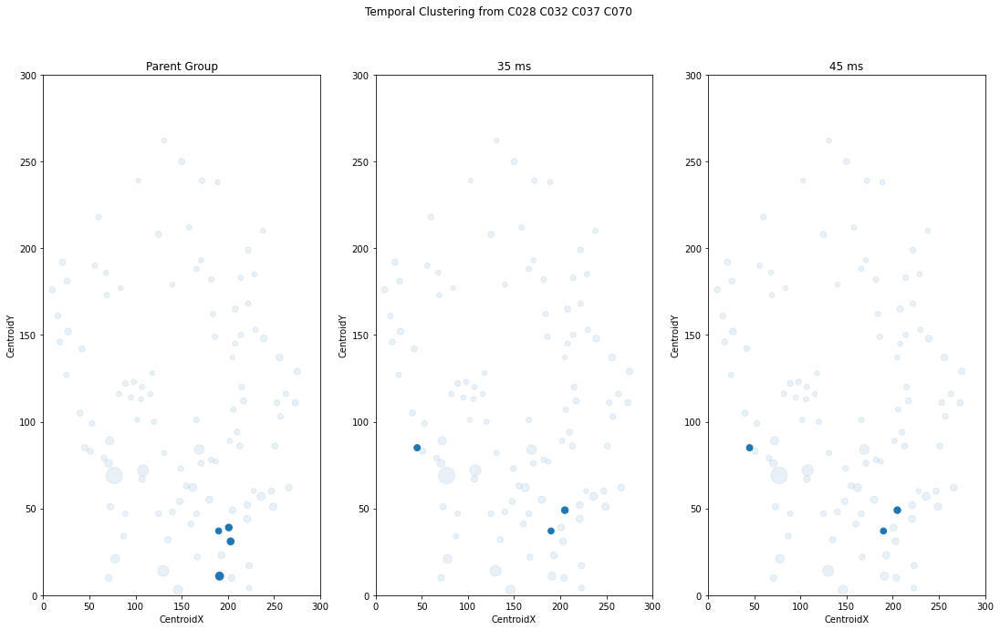

<Figure size 432x288 with 0 Axes>

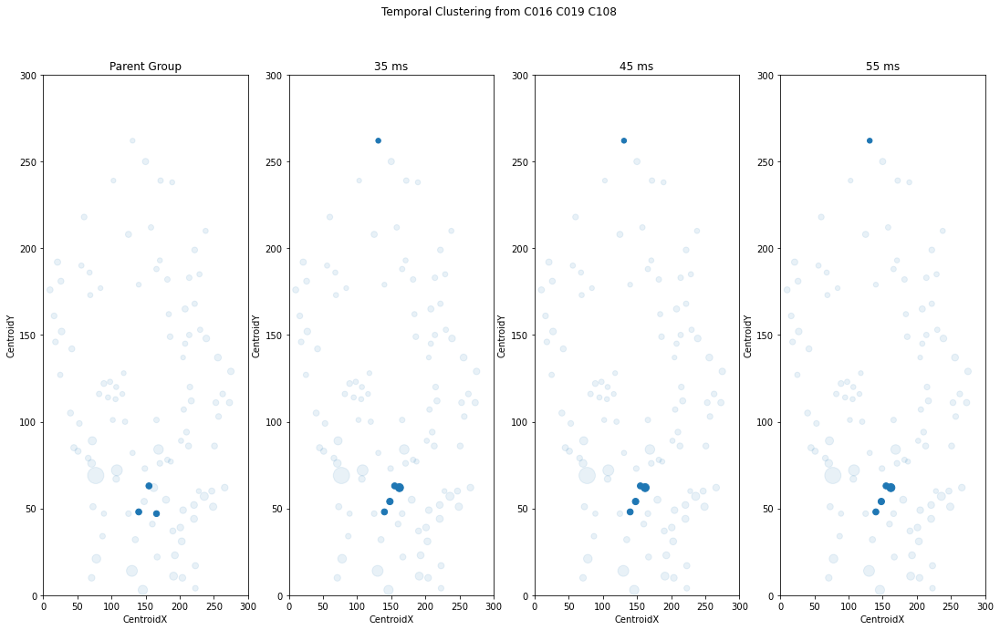

<Figure size 432x288 with 0 Axes>

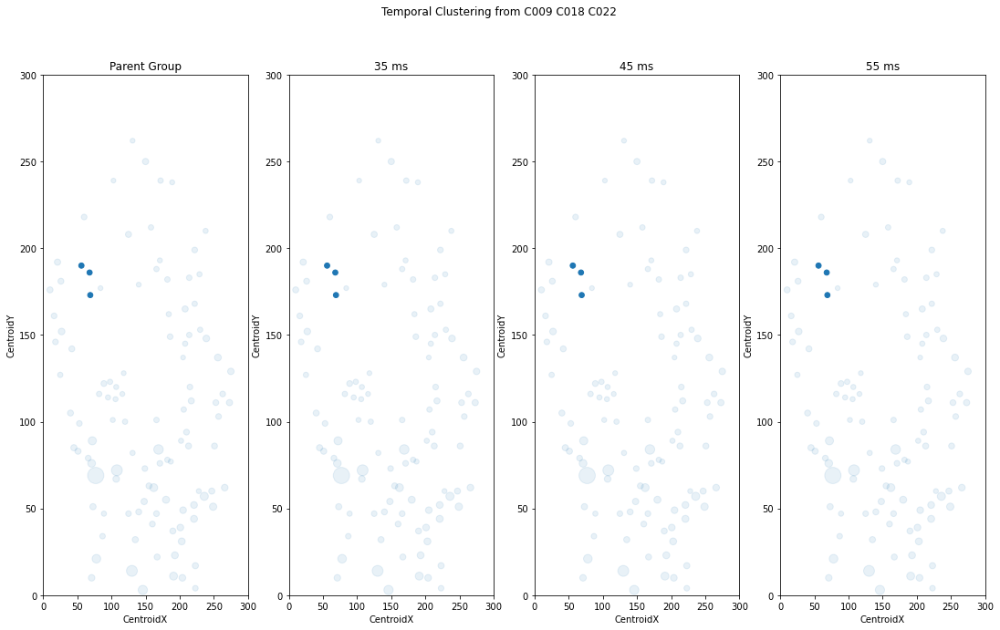

<Figure size 432x288 with 0 Axes>

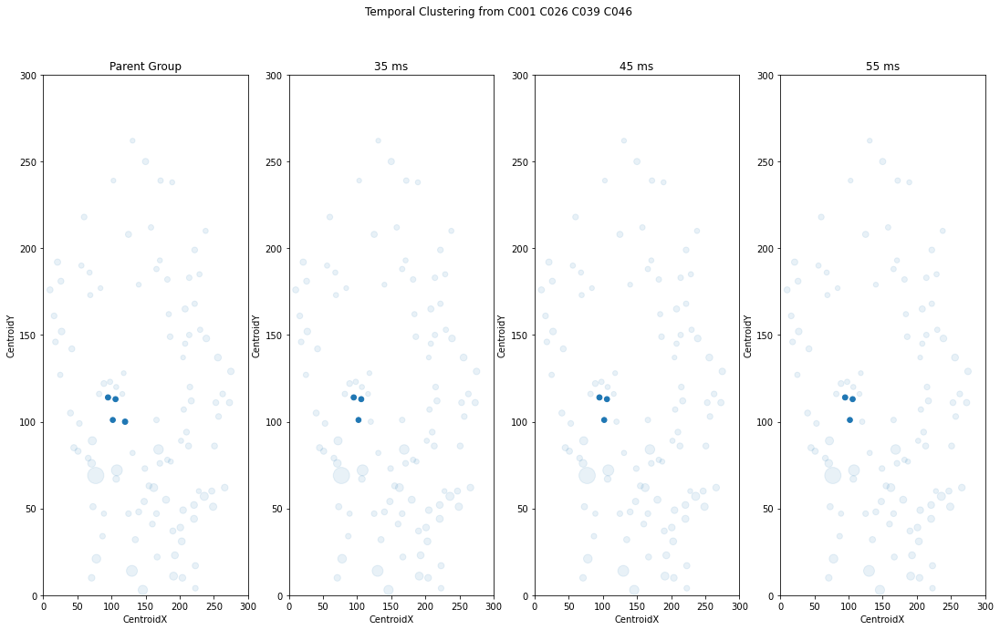

<Figure size 432x288 with 0 Axes>

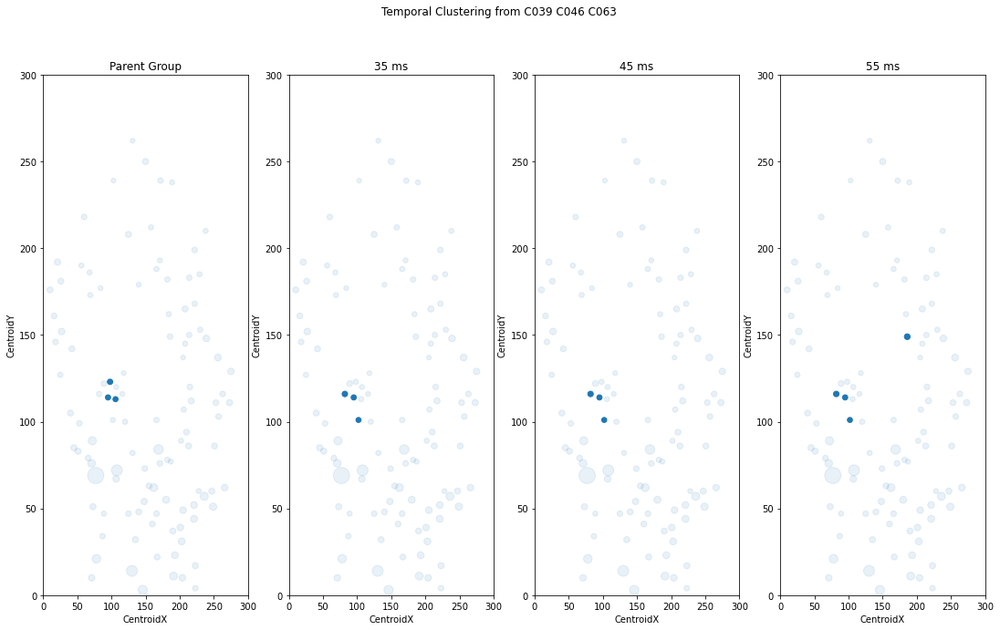

<Figure size 432x288 with 0 Axes>

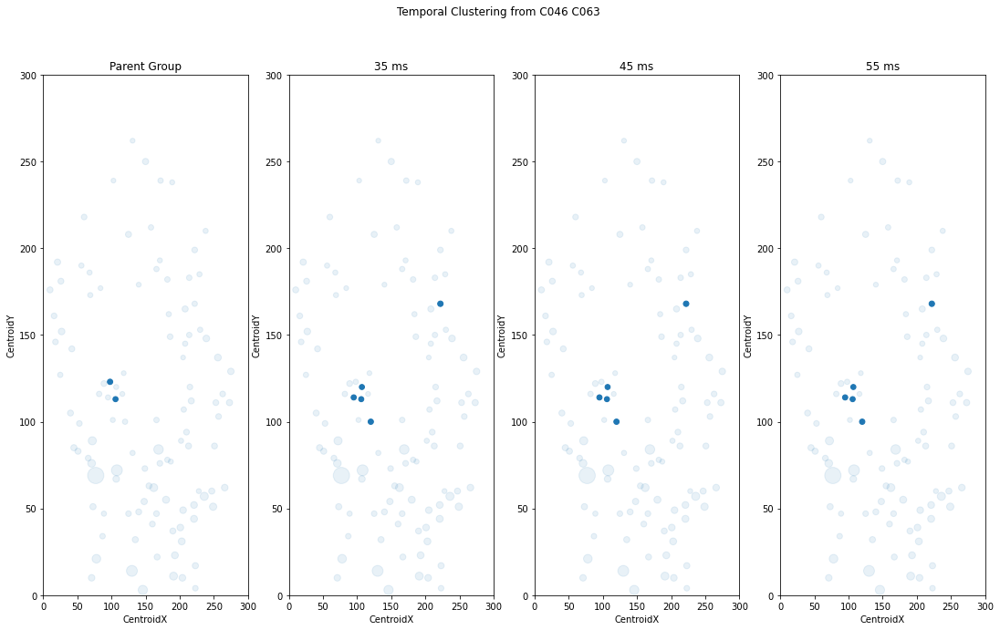

<Figure size 432x288 with 0 Axes>

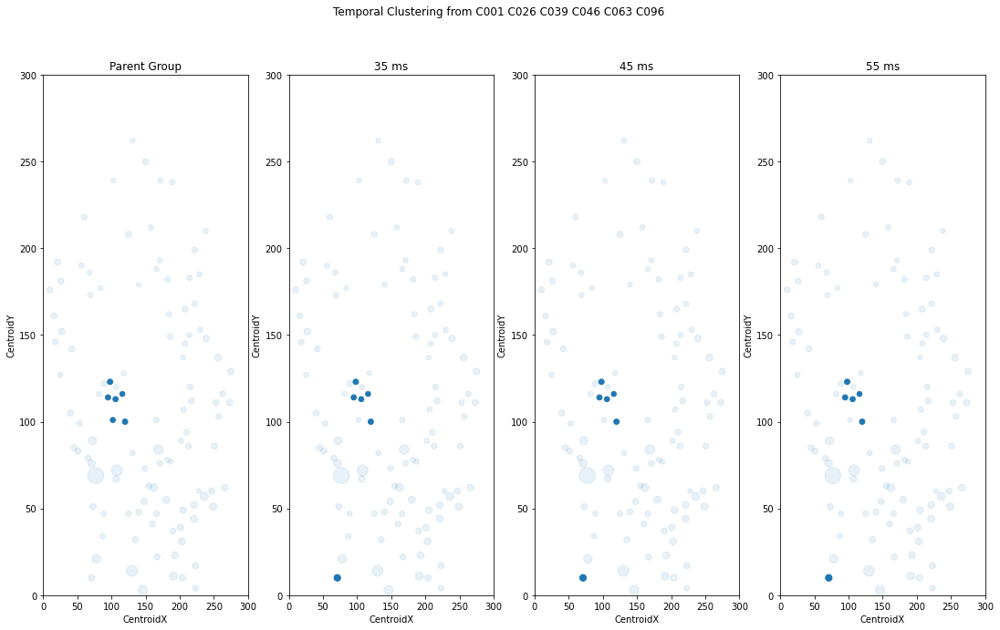

<Figure size 432x288 with 0 Axes>

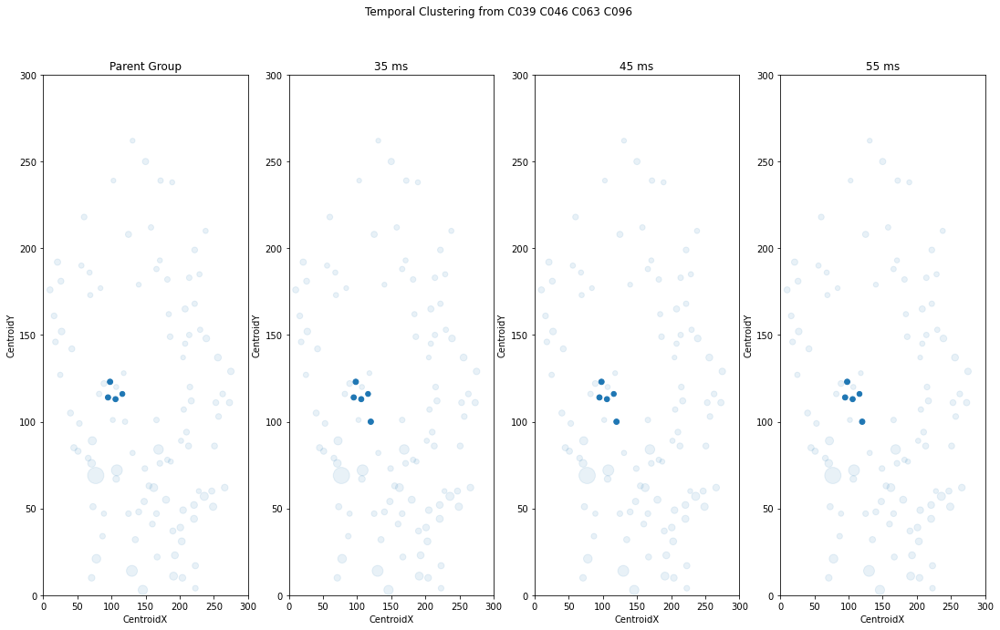

<Figure size 432x288 with 0 Axes>

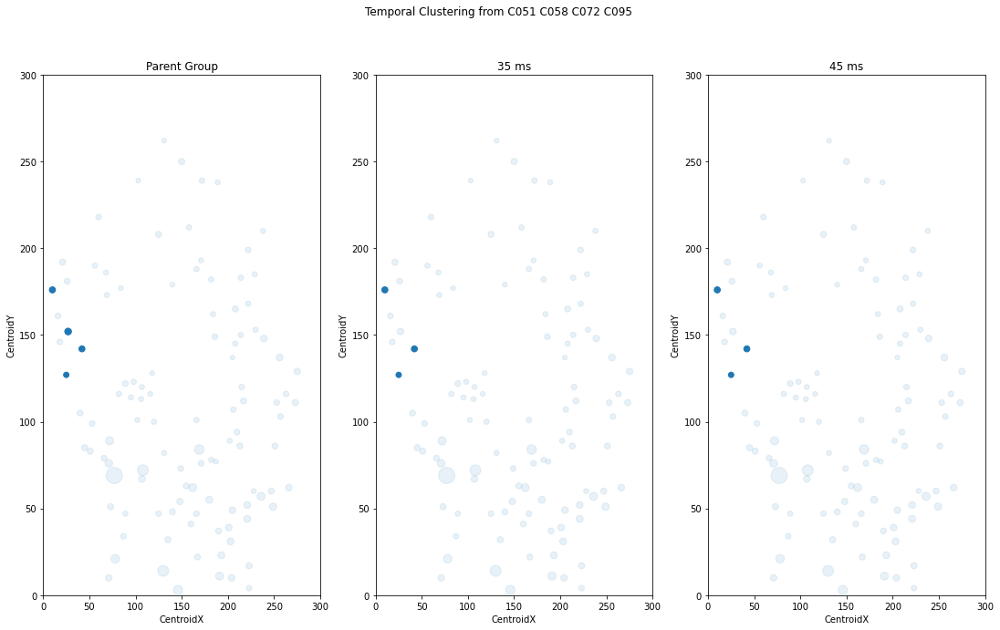

<Figure size 432x288 with 0 Axes>

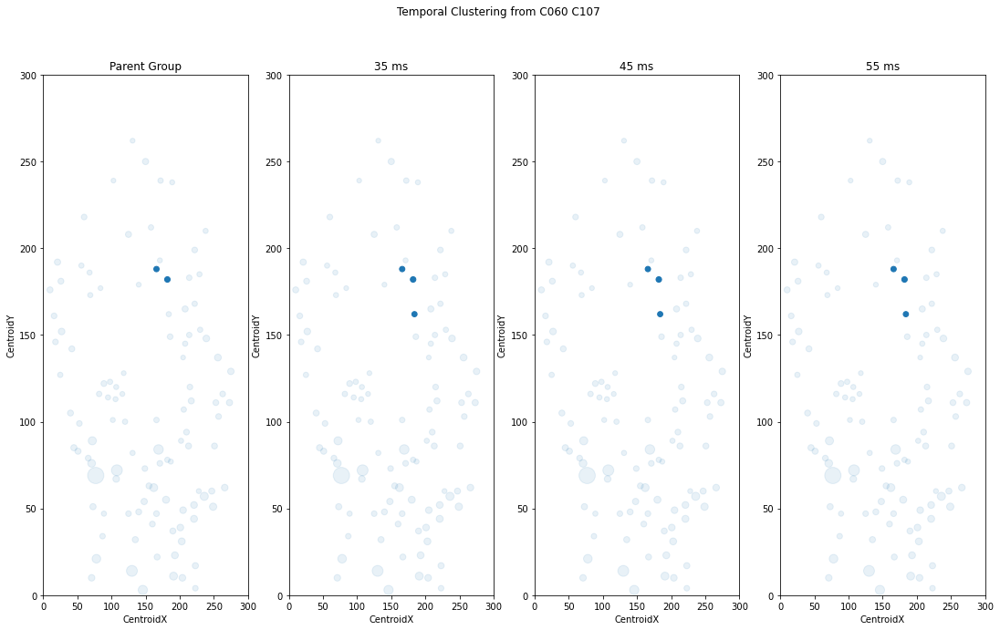

<Figure size 432x288 with 0 Axes>

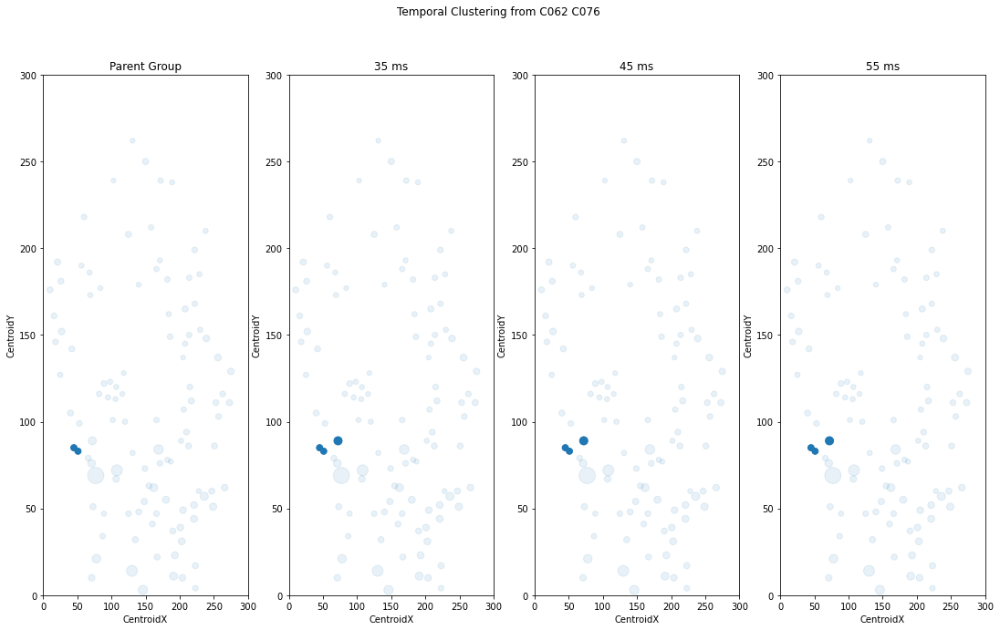

<Figure size 432x288 with 0 Axes>

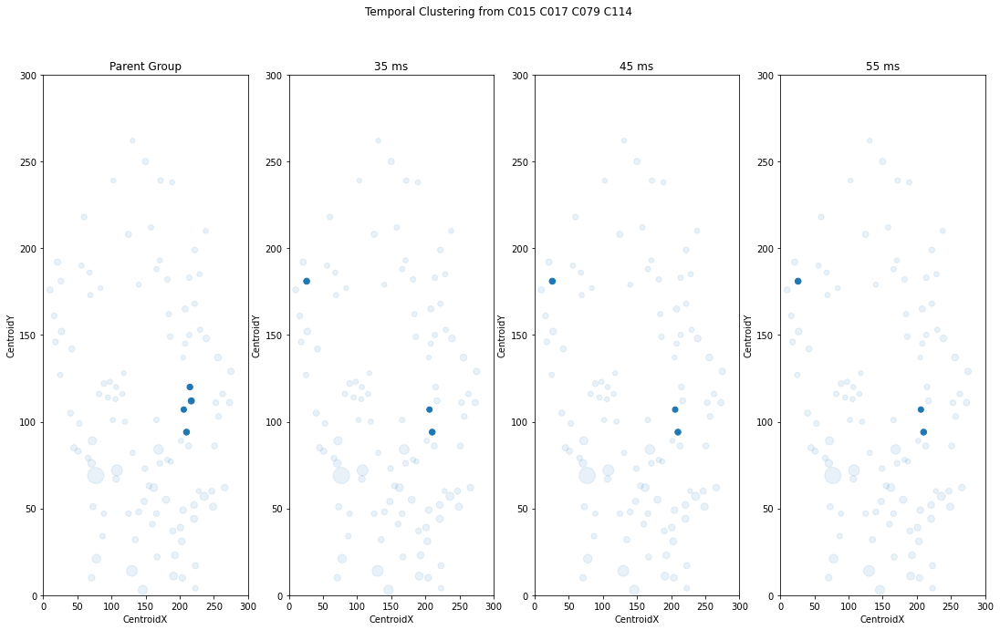

<Figure size 432x288 with 0 Axes>

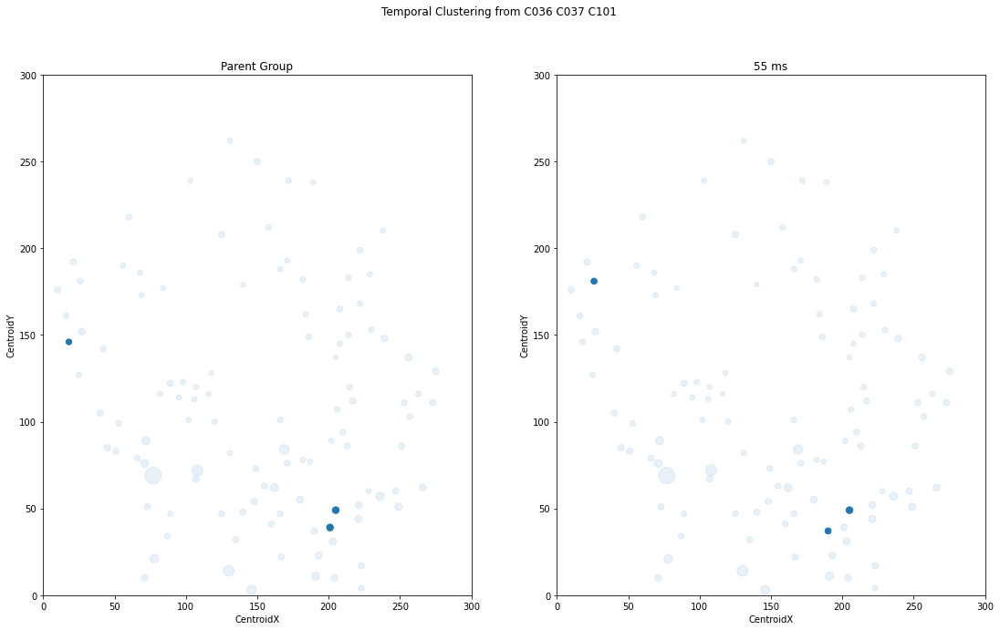

<Figure size 432x288 with 0 Axes>

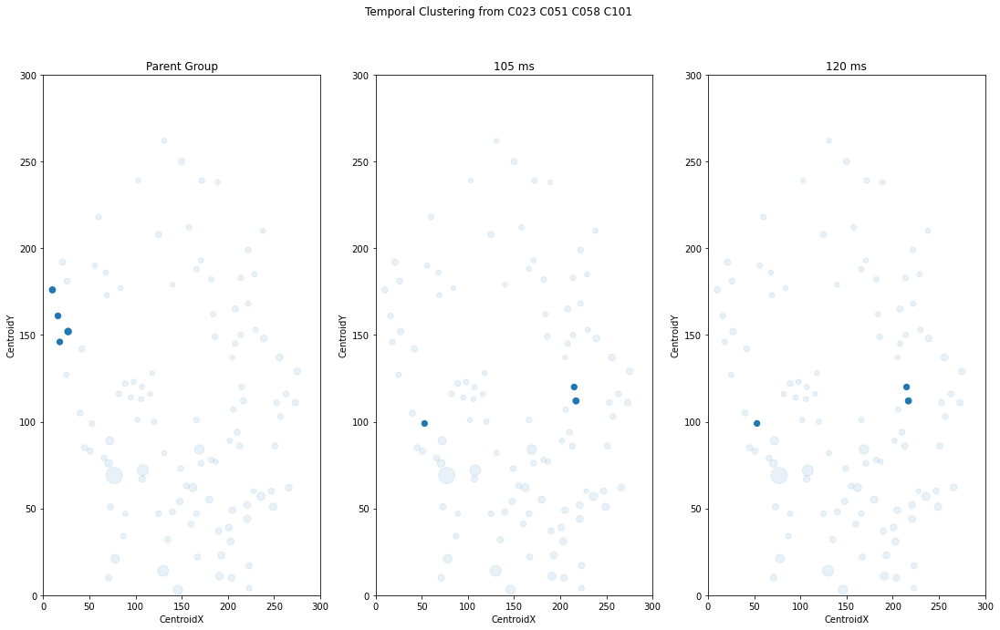

<Figure size 432x288 with 0 Axes>

In [8]:
AdvancedPrint(["data/04042014_2/CellTracing.csv", "data/04042014_2/CellTracing-props.csv"],patternsEx, ['data/04042014_2/events.csv', 'data/04042014_2/events-props.csv'], df)    

In [12]:
patternsEx = {'C046 C096': [(['C026', 'C039', 'C114'], 13)],
 'C028 C032 C036 C037 C045 C052': [(['C072', 'C082', 'C090', 'C102'], 13)],
 'C036 C037 C045 C047': [(['C045', 'C082', 'C090', 'C102'], 13),
  (['C047', 'C090', 'C131'], 11)],
 'C063 C096': [(['C019', 'C055', 'C114', 'C122'], 13),
  (['C001', 'C063', 'C096', 'C099', 'C111'], 9),
  (['C062', 'C070', 'C108', 'C144'], 1),
  (['C001', 'C026', 'C034', 'C055', 'C099', 'C114'], 11),
  (['C041', 'C078', 'C108'], 19)],
 'C047 C052 C073': [(['C069', 'C093', 'C131'], 13),
  (['C069', 'C072', 'C093'], 11)],
 'C052 C073': [(['C026', 'C045', 'C131'], 13),
  (['C050', 'C072', 'C091', 'C102'], 9),
  (['C060', 'C091', 'C093', 'C102'], 11)],
 'C001 C026 C046 C096': [(['C026', 'C055', 'C114'], 9),
  (['C046', 'C063', 'C111', 'C125'], 7)],
 'C037 C070': [(['C032', 'C036', 'C037', 'C052', 'C070', 'C090'], 9),
  (['C028', 'C036', 'C062', 'C070', 'C115'], 7),
  (['C028', 'C036', 'C070'], 98)],
 'C018 C022': [(['C009', 'C018', 'C078', 'C111'], 9),
  (['C009', 'C018', 'C111'], 7),
  (['C034', 'C036', 'C069'], 27),
  (['C075', 'C078', 'C110'], 11)],
 'C013 C028 C032 C036 C037 C101': [(['C028', 'C036', 'C107', 'C115', 'C125'],
   9),
  (['C028', 'C036', 'C107'], 7)],
 'C028 C032 C036 C037 C101': [(['C028', 'C036', 'C052', 'C115'], 9),
  (['C038', 'C072', 'C073', 'C095'], 79)],
 'C032 C036 C037 C045 C047': [(['C036', 'C047', 'C101', 'C131'], 9),
  (['C051', 'C101', 'C131'], 7)],
 'C013 C028 C032 C036 C037 C045 C047': [(['C028',
    'C036',
    'C045',
    'C125',
    'C131'],
   9)],
 'C046 C063': [(['C001', 'C055', 'C111'], 9),
  (['C046', 'C055', 'C063', 'C111'], 7)],
 'C001 C026 C039 C046 C063 C096': [(['C001', 'C034', 'C063'], 9),
  (['C046', 'C063', 'C096'], 7)],
 'C039 C046 C063 C096': [(['C001', 'C046', 'C063'], 9),
  (['C046', 'C063', 'C096'], 7)],
 'C046 C063 C096': [(['C046', 'C063', 'C096', 'C125'], 9)],
 'C060 C107': [(['C060', 'C087', 'C107'], 9)],
 'C001 C046 C096 C122': [(['C026', 'C046', 'C081', 'C122', 'C125'], 9),
  (['C063', 'C122', 'C125'], 7),
  (['C001', 'C026', 'C114'], 11)],
 'C106 C111': [(['C090', 'C106', 'C111'], 9)],
 'C037 C045 C047 C052': [(['C051', 'C085', 'C101'], 7),
  (['C028', 'C037', 'C051'], 5)],
 'C045 C047 C052 C093': [(['C058', 'C085', 'C101'], 7),
  (['C013', 'C028', 'C037'], 3)],
 'C052 C073 C093': [(['C051', 'C058', 'C091'], 7)],
 'C073 C093': [(['C051', 'C058', 'C091'], 7), (['C050', 'C052', 'C091'], 5)],
 'C045 C047 C052 C073': [(['C028', 'C032', 'C037'], 3)],
 'C014 C016 C019 C108': [(['C021', 'C029', 'C031', 'C040', 'C076', 'C142'],
   1)],
 'C031 C097': [(['C021', 'C022', 'C142'], 1)],
 'C023 C051 C058 C102': [(['C023', 'C045', 'C073'], 1),
  (['C058', 'C069', 'C090'], 11)],
 'C058 C102': [(['C036', 'C037', 'C045', 'C073', 'C142'], 1),
  (['C051', 'C052', 'C069', 'C093'], 5)],
 'C051 C058 C072 C095': [(['C045', 'C052', 'C073', 'C093', 'C122'], 1)],
 'C086 C143': [(['C036', 'C045', 'C052'], 37)]}

In [10]:
import pandas as pd

In [45]:
df = pd.read_csv('data/behavioral_targets/2014_04_04_2_behavioral_targets.csv')

C:\Users\mathi\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [12]:
df= df.drop(['scorer'], axis = 1)

In [13]:
df = df.drop([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10])


In [14]:
df = df.astype('float')

In [15]:
cols = df.columns
xC = df[cols[21]].copy()
yC = df[cols[22]].copy()
for i in range(0, len(cols), 3):
    df[cols[i]] -= xC
    df[cols[i+1]] -= yC

In [46]:
df

,scorer,DLC_resnet50_V1Jul12shuffle1_30000,DLC_resnet50_V1Jul12shuffle1_30000.1,DLC_resnet50_V1Jul12shuffle1_30000.2,DLC_resnet50_V1Jul12shuffle1_30000.3,DLC_resnet50_V1Jul12shuffle1_30000.4,DLC_resnet50_V1Jul12shuffle1_30000.5,DLC_resnet50_V1Jul12shuffle1_30000.6,DLC_resnet50_V1Jul12shuffle1_30000.7,DLC_resnet50_V1Jul12shuffle1_30000.8,...,DLC_resnet50_V1Jul12shuffle1_30000.23,DLC_resnet50_V1Jul12shuffle1_30000.24,DLC_resnet50_V1Jul12shuffle1_30000.25,DLC_resnet50_V1Jul12shuffle1_30000.26,DLC_resnet50_V1Jul12shuffle1_30000.27,DLC_resnet50_V1Jul12shuffle1_30000.28,DLC_resnet50_V1Jul12shuffle1_30000.29,DLC_resnet50_V1Jul12shuffle1_30000.30,DLC_resnet50_V1Jul12shuffle1_30000.31,DLC_resnet50_V1Jul12shuffle1_30000.32
0,bodyparts,Nose,Nose,Nose,EarRight,EarRight,EarRight,EarLeft,EarLeft,EarLeft,...,MTorso,TailB,TailB,TailB,TailM,TailM,TailM,TailT,TailT,TailT
1,coords,x,y,likelihood,x,y,likelihood,x,y,likelihood,...,likelihood,x,y,likelihood,x,y,likelihood,x,y,likelihood
2,0,95.20448303222656,196.2223358154297,0.2141166627407074,102.81169128417969,160.9171600341797,0.033929020166397095,94.56336975097656,173.2618408203125,0.20845192670822144,...,0.043337732553482056,98.709716796875,164.67799377441406,0.022908419370651245,97.55716705322266,164.9695281982422,0.18752345442771912,93.8178482055664,147.25498962402344,0.9370989799499512
3,1,0.9472658634185791,-0.5030770301818848,0.0014196932315826416,-1.0967211723327637,1.4160122871398926,0.007072329521179199,0.5037343502044678,0.30466771125793457,0.004468470811843872,...,0.0019758641719818115,-4.389507293701172,-3.888760566711426,0.0007179081439971924,-2.180685520172119,-0.4309425354003906,0.0011319518089294434,-2.1517333984375,-4.373862266540527,0.0008716285228729248
4,2,97.63058471679688,154.7960968017578,0.9546300172805786,103.6124267578125,168.98965454101562,0.7784866690635681,89.4521484375,171.20278930664062,0.7523787021636963,...,0.8919457197189331,92.86263275146484,208.25892639160156,0.32735657691955566,95.05638885498047,206.8205108642578,0.0358007550239563,100.49476623535156,236.74154663085938,0.22724735736846924
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24169,24167,200.449,619.137,0.991217,193.208,595.34,0.911152,208.263,603.974,0.992959,...,0.99882,226.632,529.338,0.998744,241.632,494.3,0.986148,251.515,456.706,0.990688
24170,24168,201.433,625.044,0.996318,191.75,603.351,0.841694,206.704,610.291,0.993753,...,0.996183,224.497,532.595,0.998696,239.478,496.902,0.982584,250.359,460.785,0.990434
24171,24169,199.77,625.571,0.997558,190.881,603.528,0.858599,207.513,610.869,0.995755,...,0.995914,222.899,533.017,0.998023,236.097,496.85,0.990064,245.649,461.377,0.995712
24172,24170,196.884,623.149,0.998212,190.404,602.275,0.889171,204.901,608.724,0.995157,...,0.995584,223.254,531.458,0.998558,235.491,495.33,0.987287,244.35,456.3,0.997845


In [17]:
def makeRotation(angle):
        theta = np.radians(angle)
        c, s = np.cos(theta), np.sin(theta)
        return np.array(((c, -s), (s, c)))

def wrapper(x):
    def makeRotation(angle):
        theta = np.radians(angle)
        c, s = np.cos(theta), np.sin(theta)
        return np.power(np.dot(np.array(((c, -s), (s, c))), x)[0], 2)
    return makeRotation

In [18]:
from scipy.optimize import minimize
from scipy.optimize import minimize_scalar


In [19]:
cols = df.columns
for index, row in df.iterrows():
    x = row[cols[24]]
    y = row[cols[25]]
    z = minimize_scalar(wrapper(np.array([x,y])))
    angle = z.x
    if x < 0:
        angle += 180
    for i in range(0, len(cols), 3):
        row[cols[i]], row[cols[i+1]] = np.dot(makeRotation(angle), np.array([row[cols[i]], row[cols[i+1]]]))

In [20]:
df

,DLC_resnet50_V1Jul12shuffle1_30000,DLC_resnet50_V1Jul12shuffle1_30000.1,DLC_resnet50_V1Jul12shuffle1_30000.2,DLC_resnet50_V1Jul12shuffle1_30000.3,DLC_resnet50_V1Jul12shuffle1_30000.4,DLC_resnet50_V1Jul12shuffle1_30000.5,DLC_resnet50_V1Jul12shuffle1_30000.6,DLC_resnet50_V1Jul12shuffle1_30000.7,DLC_resnet50_V1Jul12shuffle1_30000.8,DLC_resnet50_V1Jul12shuffle1_30000.9,...,DLC_resnet50_V1Jul12shuffle1_30000.23,DLC_resnet50_V1Jul12shuffle1_30000.24,DLC_resnet50_V1Jul12shuffle1_30000.25,DLC_resnet50_V1Jul12shuffle1_30000.26,DLC_resnet50_V1Jul12shuffle1_30000.27,DLC_resnet50_V1Jul12shuffle1_30000.28,DLC_resnet50_V1Jul12shuffle1_30000.29,DLC_resnet50_V1Jul12shuffle1_30000.30,DLC_resnet50_V1Jul12shuffle1_30000.31,DLC_resnet50_V1Jul12shuffle1_30000.32
11,-3.889556,47.938964,0.994259,-11.562958,27.189978,0.910974,3.876475,33.899180,0.990776,-4.919424,...,0.996498,6.354917e-13,-43.828491,0.968562,-11.830428,-73.605149,0.236794,-40.541247,-201.839137,0.980331
12,-3.131444,46.766049,0.997676,-10.631005,28.645094,0.932137,4.370772,35.558759,0.995511,-0.103803,...,0.998944,3.023715e-11,-43.705125,0.995684,-1.543323,-79.032158,0.823090,-9.758630,-114.773640,0.992933
13,-1.394241,44.779844,0.994453,-8.509188,25.571049,0.915909,4.883408,32.150895,0.996681,-1.063962,...,0.998540,2.999823e-12,-41.760687,0.995201,6.572568,-79.843853,0.967810,8.017219,-119.828948,0.998695
14,4.657274,44.109704,0.998033,-5.704447,26.421743,0.962797,8.775753,31.296552,0.998370,-11.407773,...,0.999493,2.871055e-09,-38.230710,0.994401,-1.610254,-77.069762,0.952275,-0.470851,-115.052969,0.999686
15,2.618398,47.478857,0.995001,-8.897012,25.199988,0.958663,7.640635,33.539572,0.996338,-4.309112,...,0.995042,3.068523e-11,-39.553239,0.991340,-9.412589,-80.637920,0.680441,-40.233820,-233.762279,0.979788
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24169,16.598816,50.953133,0.991217,-0.492185,32.880858,0.911152,16.833305,33.896686,0.992959,-12.160757,...,0.998820,-5.052082e-08,-41.100456,0.998744,-2.194367,-79.150355,0.986148,-10.108635,-117.207632,0.990688
24170,15.021365,51.555525,0.996318,-2.389485,35.394603,0.841694,14.087832,35.917525,0.993753,-6.939017,...,0.996183,6.693721e-10,-42.535750,0.998696,-0.209585,-81.243888,0.982584,-4.357136,-118.735660,0.990434
24171,13.449241,52.076782,0.997558,-3.090632,35.007518,0.858599,15.081237,35.540499,0.995755,-6.212618,...,0.995914,5.011991e-11,-42.370723,0.998023,-1.402326,-80.845127,0.990064,-5.919854,-117.302429,0.995712
24172,9.155561,52.858301,0.998212,-4.539391,35.824131,0.889171,11.313332,36.496982,0.995157,-4.734051,...,0.995584,4.151346e-12,-42.109357,0.998558,-1.889901,-80.205770,0.987287,-7.987248,-119.761572,0.997845


<AxesSubplot:>

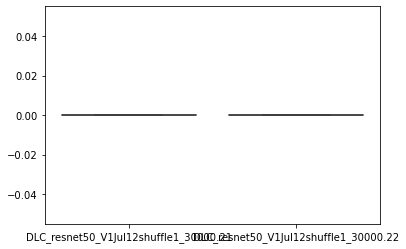

In [21]:
import seaborn as sns
sns.boxplot(data=df[[cols[21],cols[22]]].diff())

<AxesSubplot:>

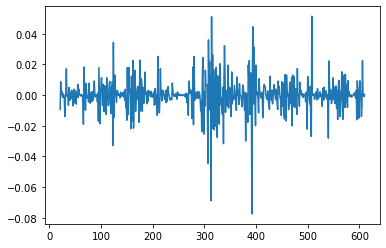

In [22]:
dfD = df.diff()
dfD[cols[23]].iloc[10:600].plot()

In [23]:
#Artificial data filling
from sklearn.impute import KNNImputer
imputer = KNNImputer()
mask = df[df > .1]
cols = df.columns.tolist()
for i in range(0,len(cols), 3):
    df[cols[i]] = df[cols[i]].mask(mask[cols[i+2]].isnull(), np.nan)
    df[cols[i]].interpolate(method='linear', inplace=True)
    df[cols[i+1]] = df[cols[i+1]].mask(mask[cols[i+2]].isnull(), np.nan)
    df[cols[i+1]].interpolate(method='linear', inplace=True)

df['x_speed'] = xC
df['y_speed'] = yC
df['sum_speed'] = 0
X = df.values
imputer = KNNImputer(n_neighbors=2)
df = pd.DataFrame(imputer.fit_transform(X), columns = df.columns)
cols = df.columns
for i in range(0, len(cols), 3):
    df[cols[i+2]] = np.sqrt(np.power(df[cols[i]], 2) + np.power(df[cols[i+1]], 2))


In [24]:
df

,DLC_resnet50_V1Jul12shuffle1_30000,DLC_resnet50_V1Jul12shuffle1_30000.1,DLC_resnet50_V1Jul12shuffle1_30000.2,DLC_resnet50_V1Jul12shuffle1_30000.3,DLC_resnet50_V1Jul12shuffle1_30000.4,DLC_resnet50_V1Jul12shuffle1_30000.5,DLC_resnet50_V1Jul12shuffle1_30000.6,DLC_resnet50_V1Jul12shuffle1_30000.7,DLC_resnet50_V1Jul12shuffle1_30000.8,DLC_resnet50_V1Jul12shuffle1_30000.9,...,DLC_resnet50_V1Jul12shuffle1_30000.26,DLC_resnet50_V1Jul12shuffle1_30000.27,DLC_resnet50_V1Jul12shuffle1_30000.28,DLC_resnet50_V1Jul12shuffle1_30000.29,DLC_resnet50_V1Jul12shuffle1_30000.30,DLC_resnet50_V1Jul12shuffle1_30000.31,DLC_resnet50_V1Jul12shuffle1_30000.32,x_speed,y_speed,sum_speed
0,-3.889556,47.938964,48.096496,-11.562958,27.189978,29.546521,3.876475,33.899180,34.120103,-4.919424,...,43.828491,-11.830428,-73.605149,74.549828,-40.541247,-201.839137,205.870421,87.704292,268.775879,282.723391
1,-3.131444,46.766049,46.870772,-10.631005,28.645094,30.554209,4.370772,35.558759,35.826373,-7.082207,...,43.705125,-1.543323,-79.032158,79.047225,-9.758630,-114.773640,115.187757,85.571030,279.332764,292.145844
2,-1.394241,44.779844,44.801544,-8.509188,25.571049,26.949672,4.883408,32.150895,32.519651,-9.244990,...,41.760687,6.572568,-79.843853,80.113915,8.017219,-119.828948,120.096847,81.870193,290.154419,301.483524
3,4.657274,44.109704,44.354889,-5.704447,26.421743,27.030523,8.775753,31.296552,32.503662,-11.407773,...,38.230710,-1.610254,-77.069762,77.086582,-0.470851,-115.052969,115.053932,79.338722,294.390839,304.894406
4,2.618398,47.478857,47.551002,-8.897012,25.199988,26.724450,7.640635,33.539572,34.398869,-4.309112,...,39.553239,-9.412589,-80.637920,81.185411,-40.233820,-233.762279,237.199417,78.174683,301.455170,311.426557
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24158,16.598816,50.953133,53.588641,-0.492185,32.880858,32.884541,16.833305,33.896686,37.846340,-12.160757,...,41.100456,-2.194367,-79.150355,79.180767,-10.108635,-117.207632,117.642737,208.308014,566.127319,603.234921
24159,15.021365,51.555525,53.699289,-2.389485,35.394603,35.475169,14.087832,35.917525,38.581545,-6.939017,...,42.535750,-0.209585,-81.243888,81.244159,-4.357136,-118.735660,118.815578,207.823288,571.726074,608.326576
24160,13.449241,52.076782,53.785438,-3.090632,35.007518,35.143681,15.081237,35.540499,38.607911,-6.212618,...,42.370723,-1.402326,-80.845127,80.857289,-5.919854,-117.302429,117.451711,206.934052,572.265015,608.530154
24161,9.155561,52.858301,53.645356,-4.539391,35.824131,36.110587,11.313332,36.496982,38.210224,-4.734051,...,42.109357,-1.889901,-80.205770,80.228033,-7.987248,-119.761572,120.027623,207.785660,570.622986,607.277097


In [12]:
from sklearn import preprocessing
x = df.abs().values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
df = pd.DataFrame(x_scaled)

In [116]:
df.diff()

,DLC_resnet50_V1Jul12shuffle1_30000,DLC_resnet50_V1Jul12shuffle1_30000.1,DLC_resnet50_V1Jul12shuffle1_30000.2,DLC_resnet50_V1Jul12shuffle1_30000.3,DLC_resnet50_V1Jul12shuffle1_30000.4,DLC_resnet50_V1Jul12shuffle1_30000.5,DLC_resnet50_V1Jul12shuffle1_30000.6,DLC_resnet50_V1Jul12shuffle1_30000.7,DLC_resnet50_V1Jul12shuffle1_30000.8,DLC_resnet50_V1Jul12shuffle1_30000.9,...,DLC_resnet50_V1Jul12shuffle1_30000.26,DLC_resnet50_V1Jul12shuffle1_30000.27,DLC_resnet50_V1Jul12shuffle1_30000.28,DLC_resnet50_V1Jul12shuffle1_30000.29,DLC_resnet50_V1Jul12shuffle1_30000.30,DLC_resnet50_V1Jul12shuffle1_30000.31,DLC_resnet50_V1Jul12shuffle1_30000.32,x_speed,y_speed,sum_speed
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.758112,-1.172915,-1.225724,0.931953,1.455116,1.007688,0.494297,1.659580,1.706270,-2.162783,...,-0.123366,10.287105,-5.427009,4.497397,30.782616,87.065497,-90.682663,-2.133263,10.556885,9.422452
2,1.737203,-1.986205,-2.069228,2.121817,-3.074045,-3.604536,0.512636,-3.407864,-3.306722,-2.162783,...,-1.944438,8.115891,-0.811695,1.066690,17.775849,-5.055308,4.909090,-3.700836,10.821655,9.337681
3,6.051515,-0.670141,-0.446655,2.804742,0.850693,0.080851,3.892345,-0.854343,-0.015989,-2.162783,...,-3.529977,-8.182823,2.774091,-3.027334,-8.488070,4.775979,-5.042914,-2.531471,4.236420,3.410882
4,-2.038876,3.369153,3.196114,-3.192565,-1.221755,-0.306074,-1.135119,2.243019,1.895207,7.098661,...,1.322529,-7.802335,-3.568158,4.098829,-39.762969,-118.709310,122.145484,-1.164040,7.064331,6.532151
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24158,5.798047,0.246332,1.744295,4.577911,-0.254518,-0.636482,5.494676,-1.030121,1.125142,2.466358,...,2.836539,-2.354371,-0.605576,0.635826,-3.496306,-4.794644,5.035443,-2.162598,5.783875,4.667753
24159,-1.577451,0.602392,0.110647,-1.897301,2.513746,2.590627,-2.745473,2.020839,0.735205,5.221741,...,1.435294,1.984781,-2.093534,2.063392,5.751499,-1.528028,1.172841,-0.484726,5.598755,5.091655
24160,-1.572124,0.521257,0.086149,-0.701146,-0.387085,-0.331487,0.993406,-0.377026,0.026367,0.726399,...,-0.165026,-1.192741,0.398761,-0.386870,-1.562718,1.433231,-1.363867,-0.889236,0.538940,0.203578
24161,-4.293680,0.781518,-0.140082,-1.448759,0.816613,0.966905,-3.767906,0.956483,-0.397688,1.478567,...,-0.261367,-0.487575,0.639357,-0.629255,-2.067394,-2.459144,2.575912,0.851608,-1.642029,-1.253057


In [88]:
xC

11        87.704292
12        85.571030
13        81.870193
14        79.338722
15        78.174683
            ...    
24169    208.308014
24170    207.823288
24171    206.934052
24172    207.785660
24173    207.186569
Name: DLC_resnet50_V1Jul12shuffle1_30000.21, Length: 24163, dtype: float64

In [25]:
dfC = (df.diff()).copy()
dfC = dfC.drop([0])
target = dfC.to_numpy()
target.shape

(24162, 36)

In [111]:
from sklearn.cluster import AgglomerativeClustering
clustering = AgglomerativeClustering(n_clusters = 50).fit(target)

In [134]:
len([i for i in range(len(clustering.labels_)) if clustering.labels_[i] == 25])/len(clustering.labels_)

0.00024832381425378696

In [86]:
from sklearn.cluster import KMeans
clusters = 69
  
kmeans = KMeans(n_clusters = clusters)
kmeans.fit(target)
  
print(len(kmeans.labels_))

24162


In [110]:
len([i for i in range(len(kmeans.labels_)) if kmeans.labels_[i] == 24])/len(kmeans.labels_)

0.6595480506580581

In [136]:
from sklearn import decomposition
pca = decomposition.PCA(n_components=3)
pca.fit(target)
pca_data = pd.DataFrame(pca.transform(target))
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


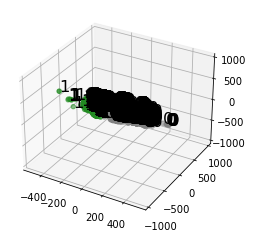

In [137]:

from matplotlib import colors as mcolors
import math
   
''' Generating different colors in ascending order 
                                of their hsv values '''
colors = list(zip(*sorted((
                    tuple(mcolors.rgb_to_hsv(
                          mcolors.to_rgba(color)[:3])), name)
                     for name, color in dict(
                            mcolors.BASE_COLORS, **mcolors.CSS4_COLORS
                                                      ).items())))[1]
   
   
# number of steps to taken generate n(clusters) colors 
skips = math.floor(len(colors[5 : -5])/clusters)
cluster_colors = colors[5 : -5 : skips]

from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
   
fig = plt.figure()
ax = fig.add_subplot(111, projection = '3d')
ax.scatter(pca_data[0], pca_data[1], pca_data[2], 
           c = list(map(lambda label : cluster_colors[label],
                                            kmeans.labels_)))
   
str_labels = list(map(lambda label:'% s' % label, kmeans.labels_))
   
list(map(lambda data1, data2, data3, str_label:
        ax.text(data1, data2, data3, s = str_label, size = 16.5,
        zorder = 20, color = 'k'), pca_data[0], pca_data[1],
        pca_data[2], str_labels))
   
plt.show()

In [14]:
dfC

,0,1,2,3,4,5,6,7,8,9,...,23,24,25,26,27,28,29,30,31,32
1,-0.013026,-0.017537,-0.019197,-0.024615,0.027418,0.018978,0.013641,0.035574,0.037316,0.051682,...,0.0,0.000002,-0.002585,-0.002585,-0.109193,0.059730,0.047336,-0.043500,-0.148194,-0.124708
2,-0.029848,-0.029697,-0.032408,-0.056042,-0.057922,-0.067886,0.014147,-0.073050,-0.072317,0.051682,...,0.0,-0.000002,-0.040738,-0.040738,0.053383,0.008934,0.011227,-0.002461,0.008605,0.006751
3,0.056065,-0.010020,-0.006996,-0.074079,0.016029,0.001523,0.107417,-0.018313,-0.000350,0.051682,...,0.0,0.000241,-0.073958,-0.073958,-0.052673,-0.030532,-0.031863,-0.010664,-0.008129,-0.006935
4,-0.035032,0.050374,0.050058,0.084323,-0.023021,-0.005764,-0.031326,0.048081,0.041448,-0.169631,...,0.0,-0.000238,0.027709,0.027709,0.082818,0.039271,0.043141,0.056190,0.202055,0.167976
5,0.080399,0.009612,0.017556,0.129062,0.044807,0.077334,-0.208635,0.015235,-0.003247,0.108502,...,0.0,0.000002,-0.050580,-0.050580,-0.079769,-0.135341,-0.134913,-0.037287,0.015329,0.008201
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24158,0.099621,0.003683,0.027319,-0.120913,-0.004796,-0.011987,0.151636,-0.022081,0.024607,-0.058937,...,0.0,0.003665,0.059429,0.059429,0.021594,0.006665,0.006692,0.004941,0.008161,0.006925
24159,-0.027103,0.009007,0.001733,0.050112,0.047365,0.048790,-0.075767,0.043318,0.016079,-0.124780,...,0.0,-0.004183,0.030071,0.030071,-0.021068,0.023041,0.021718,-0.008128,0.002601,0.001613
24160,-0.027012,0.007794,0.001349,0.018519,-0.007294,-0.006243,0.027415,-0.008082,0.000577,-0.017358,...,0.0,-0.000052,-0.003458,-0.003458,0.012660,-0.004389,-0.004072,0.002208,-0.002440,-0.001876
24161,-0.073773,0.011685,-0.002194,0.038265,0.015387,0.018210,-0.103983,0.020503,-0.008697,-0.035332,...,0.0,-0.000004,-0.005476,-0.005476,0.005175,-0.007037,-0.006623,0.002921,0.004186,0.003542


In [119]:
import numpy as np, pandas as pd
from tensorflow import losses, optimizers
from tensorflow.keras import Input, Model, models, layers
inputs = Input(shape=(target.shape[1]))
embeddings = layers.Dense(12)(inputs)
cnn_feat = layers.Dense(target.shape[1])(embeddings)
model = Model(inputs = inputs, outputs = cnn_feat)
model.compile(
    optimizer=optimizers.Adam(learning_rate=2e-4),
    loss="mse")

In [120]:
model.summary()

Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 36)]              0         
_________________________________________________________________
dense_8 (Dense)              (None, 12)                444       
_________________________________________________________________
dense_9 (Dense)              (None, 36)                468       
Total params: 912
Trainable params: 912
Non-trainable params: 0
_________________________________________________________________


In [121]:
model.fit(
    x=target,
    y=target,
    epochs=1000,
    batch_size=128,
)

Epoch 1/1000
189/189 [==============================] - 0s 713us/step - loss: 451.1095
Epoch 2/1000
189/189 [==============================] - 0s 714us/step - loss: 305.6653
Epoch 3/1000
189/189 [==============================] - 0s 707us/step - loss: 235.9900
Epoch 4/1000
189/189 [==============================] - 0s 668us/step - loss: 166.5014
Epoch 5/1000
189/189 [==============================] - 0s 690us/step - loss: 119.2654
Epoch 6/1000
189/189 [==============================] - 0s 701us/step - loss: 108.0189
Epoch 7/1000
189/189 [==============================] - 0s 694us/step - loss: 89.9569
Epoch 8/1000
189/189 [==============================] - 0s 691us/step - loss: 72.2590
Epoch 9/1000
189/189 [==============================] - 0s 718us/step - loss: 65.1327
Epoch 10/1000
189/189 [==============================] - 0s 712us/step - loss: 58.3629
Epoch 11/1000
189/189 [==============================] - 0s 684us/step - loss: 54.5901
Epoch 12/1000
189/189 [=======================

KeyboardInterrupt: 

In [108]:
dfC

,DLC_resnet50_V1Jul12shuffle1_30000,DLC_resnet50_V1Jul12shuffle1_30000.1,DLC_resnet50_V1Jul12shuffle1_30000.2,DLC_resnet50_V1Jul12shuffle1_30000.3,DLC_resnet50_V1Jul12shuffle1_30000.4,DLC_resnet50_V1Jul12shuffle1_30000.5,DLC_resnet50_V1Jul12shuffle1_30000.6,DLC_resnet50_V1Jul12shuffle1_30000.7,DLC_resnet50_V1Jul12shuffle1_30000.8,DLC_resnet50_V1Jul12shuffle1_30000.9,...,DLC_resnet50_V1Jul12shuffle1_30000.23,DLC_resnet50_V1Jul12shuffle1_30000.24,DLC_resnet50_V1Jul12shuffle1_30000.25,DLC_resnet50_V1Jul12shuffle1_30000.26,DLC_resnet50_V1Jul12shuffle1_30000.27,DLC_resnet50_V1Jul12shuffle1_30000.28,DLC_resnet50_V1Jul12shuffle1_30000.29,DLC_resnet50_V1Jul12shuffle1_30000.30,DLC_resnet50_V1Jul12shuffle1_30000.31,DLC_resnet50_V1Jul12shuffle1_30000.32
1,1.213051,-20.713120,-17.849419,-9.841484,-11.675453,-15.058130,-2.555611,-1.029526,-2.120177,-20.066933,...,2.419896,-7.892658,32.275105,25.573169,-3.955390,1.024565,-1.091025,3.338459,44.743279,40.578691
2,1.213051,-20.713120,-17.236943,1.160793,-6.872734,-5.303947,-2.555611,-1.029526,-2.104148,-0.416153,...,-5.621428,0.074883,-7.492294,-6.833068,-3.955390,1.024565,-1.009214,3.338459,44.743279,42.007594
3,-4.585190,12.820801,8.697914,-2.321587,13.745468,10.705797,1.669502,10.459244,10.071114,0.832306,...,11.313355,-0.149765,14.984589,13.705229,-3.955390,1.024565,-0.926090,-2.228973,14.131622,12.243657
4,3.528076,92.055038,85.338261,-1.226875,11.668259,9.714111,9.365044,62.221344,60.539444,-2.479416,...,9.770603,-1.018478,16.764343,15.197395,-3.955390,1.024565,-0.841735,-12.620848,-62.444665,-62.452710
5,2.269531,-70.454712,-63.570078,6.183037,10.376740,12.057182,-11.605629,-38.942734,-40.389690,4.470154,...,14.850779,0.380981,15.419983,14.589294,-3.955390,1.024565,-0.756242,-12.620848,-62.444665,-61.361658
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24167,0.991852,8.132080,8.040320,0.988754,6.879944,6.848040,1.824844,7.131042,7.336096,-0.376709,...,4.667753,0.421768,3.871033,3.723467,-1.293640,5.483032,4.346166,0.830795,1.544891,1.754025
24168,0.983932,5.907227,5.923686,-1.457397,8.011292,7.181941,-1.559174,6.317749,5.474060,0.374664,...,5.091655,-2.135056,3.256836,2.162747,-2.154343,2.601776,1.399904,-1.156570,4.078827,3.023394
24169,-1.662659,0.527466,-0.005640,-0.869675,0.176697,-0.094396,0.808502,0.577209,0.806329,0.106934,...,0.203578,-1.598343,0.422424,-0.229252,-3.381287,-0.052429,-1.506915,-4.710251,0.592041,-1.709822
24170,-2.886063,-2.422241,-3.182301,-0.476822,-1.252930,-1.338387,-2.611359,-2.144409,-2.867919,1.209351,...,-1.253057,0.355316,-1.559387,-1.300826,-0.605804,-1.519379,-1.632319,-1.298492,-5.076965,-5.090124


In [159]:
from sklearn.cluster import DBSCAN
test = dfC
X = test.to_numpy()
db = DBSCAN(eps = 10, min_samples = 3).fit(X)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_clusters_


165

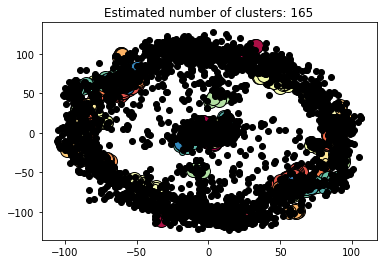

In [160]:
# Plot result
import matplotlib.pyplot as plt

# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    xy = X[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)

    xy = X[class_member_mask & ~core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=6)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

In [151]:
model2 = Model(inputs = inputs, outputs = embeddings)

NameError: name 'Model' is not defined

In [39]:
features = model2.predict(target)

In [67]:
features.shape

NameError: name 'features' is not defined

In [51]:
labels

array([-1, -1,  0, ...,  0,  0,  0], dtype=int64)

In [158]:
len([i/20 for i in range(len(labels)) if labels[i] == 0])/len(df)

0.6914898018286376

In [234]:
features

array([[ -9.596012  , -29.296429  ,  12.854545  ,  25.928444  ],
       [-13.253345  , -27.188915  ,  16.354427  ,  26.362343  ],
       [  2.3405247 ,  -0.39566314,  -4.0521545 ,   2.5259316 ],
       ...,
       [ -2.9803178 ,   0.3541828 ,  -2.1943178 ,  -0.1925367 ],
       [ -2.1530206 ,   2.5970538 ,  -0.06188293,  -4.1148014 ],
       [  1.7440201 ,  -0.53088474,   6.6305594 ,   4.7130303 ]],
      dtype=float32)